In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import itertools
from sklearn import ensemble
from sklearn import linear_model
from sklearn import metrics
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import train_test_split
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.model_selection import validation_curve
from sklearn.model_selection import learning_curve

Table of Contents
    1. Data Preprocessing
    2. Linear Regression
        1. Standard Linear Regression
        2. ElasticNet
        3. Lasso
        4. Comparison of Methods
    3. Classification
        1. Setup
        2. Classifier Evaluation (With 3 bins and 4 bins)
        3. Learning Curves
        4. Feature Importance Rankings

In [2]:
sns.set_style()
path = 'Pickles/output_df.pkl'
df = pd.read_pickle(path)
df.columns

Index(['artists', 'date', 'TM_id', 'event_title', 'presale_date_end',
       'presale_date_start', 'promoter', 'TM_sale_date_start',
       'span multiple days', 'venue', 'TM_venue _lat', 'venue_city',
       'TM_venue_long', 'venue_state', 'TM_max', 'TM_min', 'genre', 'subGenre',
       'event_type', 'SG_artists_score', 'SG_average_price',
       'SG_listing_count', 'SG_max_price', 'SG_min_price', 'SG_venue_score',
       'SH_max_price', 'SH_min_price', 'SH_total_postings', 'SH_total_tickets',
       'spotify_followers', 'spotify_popularity', 'spotify_avg_followers',
       'spotify_avg_popularity', 'spotify_null_count', 'days_until_show',
       'day_of_week', 'presale_length', 'days_on_sale', 'artist_count',
       'avg_resale_min', 'avg_resale_max', 'min_source', 'max_source',
       'min_markup%', 'max_markup%', 'avg_ticket_listings'],
      dtype='object')

## 1. Data Preprocessing
Drop extra columns and one hot encode categorical features (Dropping the first category to avoid collinearity)

In [3]:
##Drop excess columns 
df = df[['min_markup%','promoter','venue_state','TM_min','genre','subGenre','spotify_avg_followers',
         'spotify_avg_popularity','spotify_null_count','days_until_show','day_of_week',
         'presale_length','days_on_sale','artist_count','min_source','avg_ticket_listings']]

In [4]:
#One Hot Encode categorical variables
df_onehot = pd.get_dummies(columns=['promoter','venue_state','genre','min_source','subGenre','day_of_week'],
                           data=df,drop_first=True)

#Seperate into X and Y matrices
X = df_onehot.iloc[:,1:]
Y = df_onehot['min_markup%']

#Split into training and test set
X,X_test,Y,Y_test =  train_test_split(X,Y,test_size=.2,random_state=1)

#Scale numerical data
cont_features = ['TM_min','spotify_avg_followers',
'spotify_avg_popularity','days_until_show','presale_length','days_on_sale',
 'artist_count','avg_ticket_listings']
Xscaler = StandardScaler()
X[cont_features] = Xscaler.fit_transform(X[cont_features])
X_test[cont_features] = Xscaler.transform(X_test[cont_features])

#Create log scaled Y data for train and test data sets
Y_log = Y.copy()
Y_log[Y_log <= 0] = .01
Y_log = np.log(Y_log)

Y_testlog = Y_test.copy()
Y_testlog[Y_testlog <= 0] = .01
Y_testlog = np.log(Y_testlog)

## 2. Linear Regression
    1. Model Comparison
    2. Residual Plots
    
### 2.1 Model Comparison

In [5]:
# Make MSE and R squared CV scorers
cv_mse = metrics.make_scorer(score_func=metrics.mean_squared_error)
cv_mae = metrics.make_scorer(score_func=metrics.mean_absolute_error)
cv_r = metrics.make_scorer(score_func=metrics.r2_score)
kfold = KFold(n_splits=5,shuffle=True,random_state=1)

#Initialize regression objects
lr = linear_model.LinearRegression()
en = linear_model.ElasticNetCV(alphas=np.logspace(-6,.5,30,base=2),cv=kfold,max_iter=10000,random_state=1)
lasso = linear_model.LassoCV(alphas=np.logspace(-6,.5,30,base=2),cv=kfold,max_iter=10000,random_state=1)
abr = ensemble.AdaBoostRegressor(random_state=1)
gbr = ensemble.GradientBoostingRegressor(random_state=1)
rfr = ensemble.RandomForestRegressor(random_state=1)

#Initialize regression objects to train with log transformed Y data
lr_log = linear_model.LinearRegression()
en_log = linear_model.ElasticNetCV(alphas=np.logspace(-6,.5,30,base=2),cv=kfold,max_iter=10000,random_state=1)
lasso_log = linear_model.LassoCV(alphas=np.logspace(-6,.5,30,base=2),cv=kfold,max_iter=10000,random_state=1)
abr_log = ensemble.AdaBoostRegressor(random_state=1)
gbr_log = ensemble.GradientBoostingRegressor(random_state=1)
rfr_log = ensemble.RandomForestRegressor(random_state=1)

lin_models = {'Standard': lr,
             'ElasticNet' : en,
             'Lasso' : lasso,
             'Ada Boosting' : abr,
             'Gradient Boosting': gbr,
             'Random Forest': rfr}
lin_models_log = {'Standard Log': lr_log,
             'ElasticNet Log' : lr_log,
             'Lasso Log' : lasso_log,
             'Ada Boosting Log' : abr_log,
             'Gradient Boosting Log': gbr_log,
             'Random Forest Log': rfr_log}

def fit_lin_regression(model,name,Y=Y):
    #Calculate R Values
    r_values = cross_val_score(estimator=model,X=X,y=Y,cv=kfold,scoring=cv_r)
    #Calculate MSE Values
    mse_values = cross_val_score(estimator=model,X=X,y=Y,cv=kfold,scoring=cv_mse)
    #Calculate Mean Absolute Values
    mae_values = cross_val_score(estimator=model,X=X,y=Y,cv=kfold,scoring=cv_mae)
    model.fit(X,Y)
    #Create dataframe of coefficients and weights
    try:
        coef_df = pd.DataFrame({'Feature': X.columns,'Coefficient': model.coef_})
        # Find number of coefficients
        coef_total = len(coef_df['Coefficient'].loc[coef_df['Coefficient'] != 0])
    except AttributeError:
        coef_df = np.nan
        coef_total = np.nan
    
    #Append R^2 and MSE metrics to lists
    avg_r2_train.append(r_values.mean())
    std_r2_train.append(r_values.std())
    avg_mse_train.append(mse_values.mean())
    std_mse_train.append(mse_values.std())
    avg_mae_train.append(mae_values.mean())
    std_mae_train.append(mae_values.std())
    coef_count.append(coef_total)
    coef_weights[name] = coef_df

def predict_lin_regression(model,name,Y_test=Y_test):
    y_pred = model.predict(X_test)
    mse_test.append(metrics.mean_squared_error(Y_test,y_pred))
    r2_test.append(metrics.r2_score(Y_test,y_pred))
    mae_test.append(metrics.mean_absolute_error(Y_test,y_pred))
    
def plot_residuals(model,name,X=X,Y=Y):
    Y_fitted= model.predict(X=X)
    residuals = np.subtract(Y_fitted,Y)
    g = plt.scatter(Y_fitted,residuals,alpha=.4)
    return g

In [6]:
#Create lists of model metrics for train data
avg_r2_train = []
std_r2_train = []
avg_mse_train = []
std_mse_train = []
avg_mae_train = []
std_mae_train = []
coef_count = []
coef_weights = dict()

#Evaluate models
for key in lin_models.keys():
    fit_lin_regression(lin_models[key],key)
    
#Evaluate models (With Log Transformed Y)
for key in lin_models_log.keys():
    fit_lin_regression(lin_models_log[key],key,Y=Y_log)

reg_models = [key for key in lin_models.keys()] + [key for key in lin_models_log.keys()]

#Create dataframe of models and metrics
results_df = pd.DataFrame({'Model' : reg_models,
                           'R2 Mean' : avg_r2_train,
                           'R2 Std' : std_r2_train,
                           'MSE Mean' : avg_mse_train,
                           'MSE Std' : std_mse_train,
                           'MAE Mean' : avg_mae_train,
                           'MAE Std' : std_mae_train,
                           'Coefficients Count' : coef_count})

results_df[['Model','R2 Mean','R2 Std','MSE Mean','MSE Std','MAE Mean','MAE Std','Coefficients Count']]

/usr/local/lib/python3.6/site-packages/scipy/linalg/basic.py:1226: RuntimeWarning: internal gelsd driver lwork query error, required iwork dimension not returned. This is likely the result of LAPACK bug 0038, fixed in LAPACK 3.2.2 (released July 21, 2010). Falling back to 'gelss' driver.
  warnings.warn(mesg, RuntimeWarning)


,Model,R2 Mean,R2 Std,MSE Mean,MSE Std,MAE Mean,MAE Std,Coefficients Count
0,Standard,0.189592,0.094146,84555.486480,22199.238489,136.241328,3.967828,74.0
1,ElasticNet,0.161507,0.058729,87752.332366,22725.831103,134.383189,4.206807,73.0
2,Lasso,0.190991,0.089336,84493.909526,22226.669894,135.846668,3.969057,65.0
3,Ada Boosting,0.007987,0.591914,107593.552671,80899.270100,260.600104,96.396219,NaN
4,Gradient Boosting,0.635514,0.172276,39072.182636,23130.587541,71.879618,5.280961,NaN
5,Random Forest,0.587575,0.197062,43085.135319,23121.945424,71.983109,5.145900,NaN
6,Standard Log,0.167218,0.046321,1.756009,0.408149,0.693996,0.038214,74.0
7,ElasticNet Log,0.167218,0.046321,1.756009,0.408149,0.693996,0.038214,74.0
8,Lasso Log,0.140746,0.030420,1.806866,0.387574,0.674113,0.035656,14.0
9,Ada Boosting Log,-0.570153,0.571515,3.250107,1.222295,1.241363,0.331347,NaN


In [7]:
#Create lists of metrics on test data
r2_test = []
mse_test = []
mae_test = []

#Evaluate models on the test data
for key in lin_models.keys():
    predict_lin_regression(lin_models[key],key)
    
#Evaluate models (With Log Transformed Y)
for key in lin_models_log.keys():
    predict_lin_regression(lin_models_log[key],key,Y_test=Y_testlog)

#Create dataframe of models and metrics
test_results_df = pd.DataFrame({'Model' : reg_models,
                                'R2' : r2_test,
                                'MSE' : mse_test,
                               'MAE' : mae_test})
                 
test_results_df[['Model','R2','MSE','MAE']]

,Model,R2,MSE,MAE
0,Standard,0.307016,78229.274482,138.304788
1,ElasticNet,0.248492,84835.865052,136.676658
2,Lasso,0.302703,78716.149068,138.612961
3,Ada Boosting,0.226271,87344.358584,238.497308
4,Gradient Boosting,0.680441,36074.203149,74.683969
5,Random Forest,0.739273,29432.817013,67.118022
6,Standard Log,0.081162,1.978125,0.718111
7,ElasticNet Log,0.081162,1.978125,0.718111
8,Lasso Log,0.067036,2.008537,0.702283
9,Ada Boosting Log,0.003004,2.146389,0.787146


### Analysis:
MSE and $R^2$ values are similar on the train and test data, suggesting the models are not particularly overfitting

In [8]:
#Create a CSV of predicted values vs actual for analysis
fitted_values = dict()
fitted_values['Face Value'] = X['TM_min'].values
fitted_values['Actual Markup'] = Y.values
for key, model in lin_models.items():
    fitted_values[key] = model.predict(X)
    
for key, model in lin_models_log.items():
    fitted_values[key] = np.exp(model.predict(X))
    
fitted_df = pd.DataFrame(fitted_values)
fitted_df.to_csv("Data/Fitted Values.csv")

## 2.2 Residual Plots

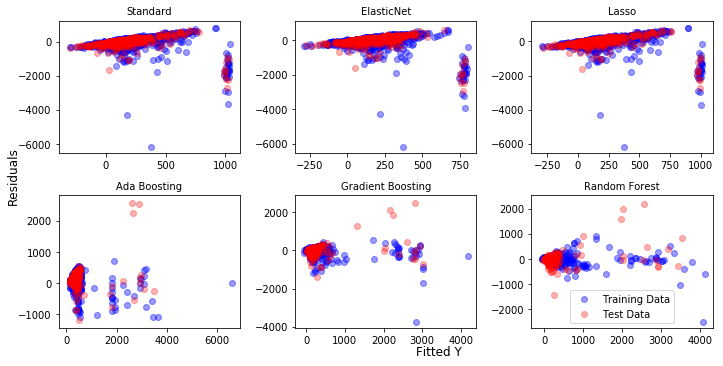

In [9]:
#Residual plots

subplt = 1
f, ax = plt.subplots(2,3, sharex=True, sharey=True, figsize=[10,5])

for key in lin_models.keys():
    plt.subplot(2,3,subplt)
    plt.title(key,size='medium')
    trainplot = plot_residuals(lin_models[key],key,X=X)
    testplot = plot_residuals(lin_models[key],key,X=X_test,Y=Y_test)
    trainplot.set_color('b')
    testplot.set_color('r')
    testplot.set_alpha(.3)
    subplt +=1
f.text(0.6, 0, 'Fitted Y', ha='center',size='large')
f.text(0, 0.5, 'Residuals', va='center', rotation='vertical',size='large')
plt.tight_layout()
plt.legend([trainplot,testplot],['Training Data','Test Data'],loc='best')
plt.show()

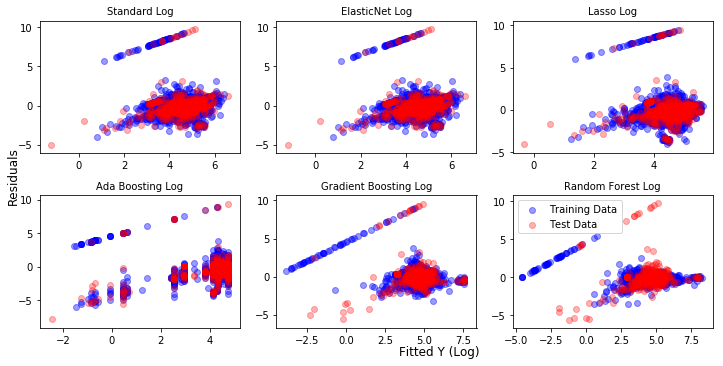

In [10]:
# Residuals with Y log transformation
subplt = 1
f, ax = plt.subplots(2,3, sharex=True, sharey=True, figsize=[10,5])

for key in lin_models_log.keys():
    plt.subplot(2,3,subplt)
    plt.title(key,size='medium')
    trainplot = plot_residuals(lin_models_log[key],key,Y=Y_log)
    trainplot.set_color('b')
    testplot = plot_residuals(lin_models_log[key],key,X=X_test,Y=Y_testlog)
    testplot.set_color('r')
    testplot.set_alpha(.3)
    subplt +=1
f.text(0.6, 0, 'Fitted Y (Log)', ha='center',size='large')
f.text(0, 0.5, 'Residuals', va='center', rotation='vertical',size='large')
plt.legend([trainplot,testplot],['Training Data','Test Data'],loc='best')
plt.tight_layout()
plt.show()

### Analysis
How to interpret MSE vs R squared?

## 3. MultiClass Classification
    1. Variable & Function Setup
    2. Classifier Evaluation with 3 & 4 Bins
    3. Learning Curves
    4. Feature Importance Rankings

In [11]:
#Setup stratified KFold
cv = StratifiedKFold(n_splits=5,shuffle=True,random_state=1)

#Initialize classifier objects
lgr = linear_model.LogisticRegression(penalty="l1",solver='saga',max_iter=10000,multi_class='multinomial')
rfc = RandomForestClassifier(random_state=1)
gbc = GradientBoostingClassifier(random_state=1)
abc = AdaBoostClassifier(random_state=1)
classifiers = [lgr,rfc,gbc,abc]
algo_list = ["Logistic Regression","Random Forest",
             "Gradient Boosting",'Ada Boosting']

In [12]:
def classifier_eval(classifiers,bins):
   # Classify Y values into bins
    Y_bins, bins = pd.qcut(Y,q=bins,retbins=True,labels=list(range(bins)))
    
    cv_results = []
    cv_means = []
    cv_std = []
    
    #Evaluate each classifier
    for classifier in classifiers:
        cv_results.append(cross_val_score(classifier, X, Y_bins, 
                                      scoring = 'accuracy',cv = cv))
    #Split into result means and standard deviations
    for cv_result in cv_results:
        cv_means.append(cv_result.mean())
        cv_std.append(cv_result.std())
    
    #Draw dataframe of results
    cv_res = pd.DataFrame(
        {"CrossValMeans":cv_means,
         "CrossValerrors": cv_std,
         "Algorithm":algo_list})
    
    g = sns.barplot("CrossValMeans","Algorithm",data = cv_res,orient = "h",**{'xerr':cv_std})
   
    return Y_bins, bins, cv_res, g

def plot_learning_curve(estimator, title, X, y, ylim=None, cv=None,
                        n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5)):
    plt.figure()
    plt.title(title)
    if ylim is not None:
        plt.ylim(*ylim)
    plt.xlabel("Training examples")
    plt.ylabel("Score")
    train_sizes, train_scores, test_scores = learning_curve(
        estimator, X, y, cv=cv, n_jobs=n_jobs, train_sizes=train_sizes)
    train_scores_mean = np.mean(train_scores, axis=1)
    train_scores_std = np.std(train_scores, axis=1)
    test_scores_mean = np.mean(test_scores, axis=1)
    test_scores_std = np.std(test_scores, axis=1)
    plt.grid()

    plt.fill_between(train_sizes, train_scores_mean - train_scores_std,
                     train_scores_mean + train_scores_std, alpha=0.1,
                     color="r")
    plt.fill_between(train_sizes, test_scores_mean - test_scores_std,
                     test_scores_mean + test_scores_std, alpha=0.1, color="g")
    plt.plot(train_sizes, train_scores_mean, 'o-', color="r",
             label="Training score")
    plt.plot(train_sizes, test_scores_mean, 'o-', color="g",
             label="Cross-validation score")

    plt.legend(loc="best")
    return plt

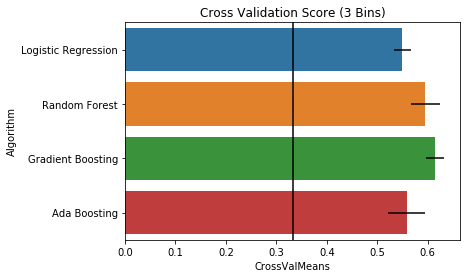

In [13]:
#Evaluate with 3 bins
Y_bins3, bins3_labels, cv_res3, g3 = classifier_eval(classifiers,bins=3)
g3.set_title("Cross Validation Score (3 Bins)")
plt.axvline(np.divide(1,3), color="black")
plt.show()

In [14]:
print("Markup Percentage Bins:\n [{} - {}), \n [{} - {}), \n [{} - {})".format(bins3_labels[0],bins3_labels[1],
                                                                 bins3_labels[1],bins3_labels[2],
                                                                 bins3_labels[2],bins3_labels[3]))

Markup Percentage Bins:
 [-72.53731343283583 - 84.32735042735041), 
 [84.32735042735041 - 125.0), 
 [125.0 - 6578.999999999999)


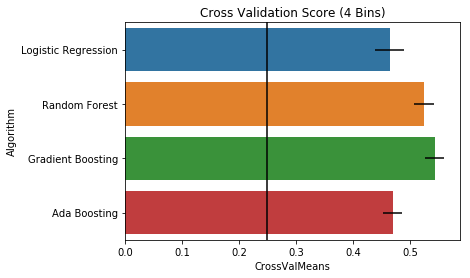

In [15]:
#Evaluate with 4 bins
Y_bins4, bins4_labels, cv_res4, g4 = classifier_eval(classifiers,bins=4)
g4.set_title("Cross Validation Score (4 Bins)")
plt.axvline(np.divide(1,4), color="black")
plt.show()

In [16]:
print("Markup Percentage Bins:\n [{} - {}), \n [{} - {}), \n [{} - {}), \n [{} - {}]".format(bins4_labels[0],bins4_labels[1],
                                                                 bins4_labels[1],bins4_labels[2],
                                                                 bins4_labels[2],bins4_labels[3],
                                                                 bins4_labels[3],bins4_labels[4]))

Markup Percentage Bins:
 [-72.53731343283583 - 75.65390969162995), 
 [75.65390969162995 - 101.55714285714285), 
 [101.55714285714285 - 146.66666666666666), 
 [146.66666666666666 - 6578.999999999999]


## 3.3 Learning Curves

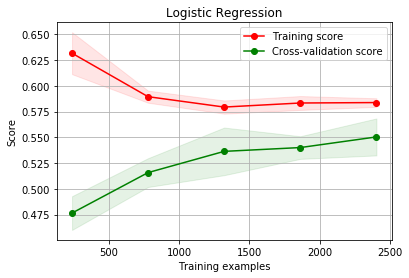

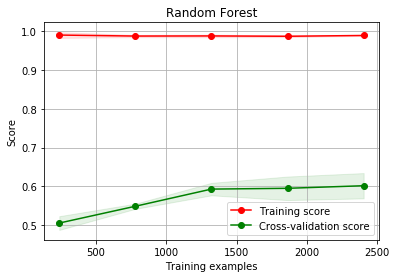

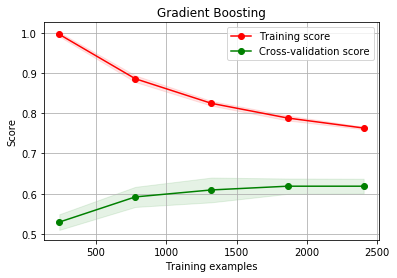

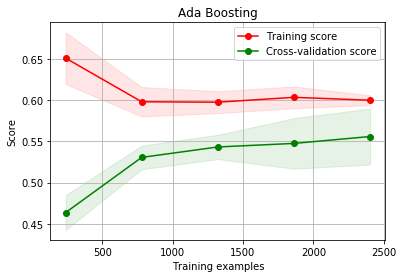

In [17]:

g1=plot_learning_curve(lgr, 'Logistic Regression', X, Y_bins3, ylim=None, cv=cv,
                       n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5))

g2=plot_learning_curve(rfc, 'Random Forest', X, Y_bins3, ylim=None, cv=cv,
                        n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5))

g3=plot_learning_curve(gbc, 'Gradient Boosting', X, Y_bins3, ylim=None, cv=cv,
                        n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5))

g4=plot_learning_curve(abc, 'Ada Boosting', X, Y_bins3, ylim=None, cv=cv,
                        n_jobs=1, train_sizes=np.linspace(.1, 1.0, 5))

plt.show()

## 3.4 Tree Classifiers Feature Importance (With Three Bins)

In [18]:
#Fit each classifier
for classifier in classifiers[1:]:
    classifier.fit(X,Y_bins3)

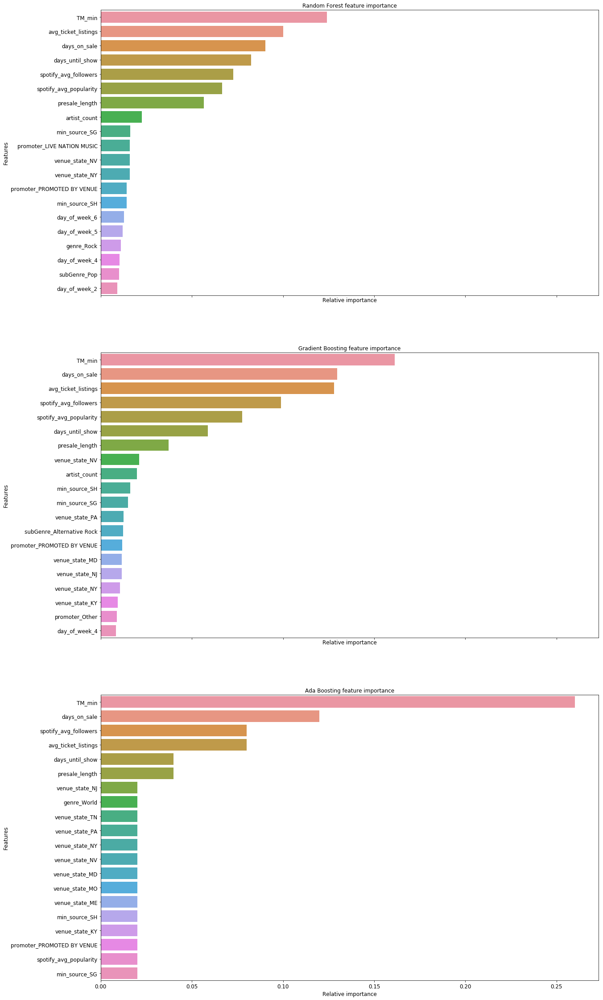

In [19]:
nrows = 3
ncols = 1
fig, axes = plt.subplots(nrows = nrows, ncols = ncols, sharex="all", figsize=(20,40),squeeze=False)

names_classifiers = [("Random Forest", rfc),("Gradient Boosting",gbc),("Ada Boosting",abc)]

nclassifier = 0
for row in range(nrows):
    for col in range(ncols):
        name = names_classifiers[nclassifier][0]
        classifier = names_classifiers[nclassifier][1]
        indices = np.argsort(classifier.feature_importances_)[::-1][:20]
        g = sns.barplot(y=X.columns[indices][:20],x = classifier.feature_importances_[indices][:20] , orient='h',ax=axes[row][col])
        g.set_xlabel("Relative importance",fontsize=12)
        g.set_ylabel("Features",fontsize=12)
        g.tick_params(labelsize=12)
        g.set_title(name + " feature importance")
        nclassifier += 1

### Analysis:
Feature importance varies by classifier. However, the top seven features of each classifier (In varying orders) are TM min, Days on Sale, Spotify Average Followers, Average Ticket Listings, Days until Show, and Presale Length

## 3.5 Hyperparameter Tuning
I tune the hyperparameters of Logistic Regression, Random Forest, and Gradient Boosting classifiers using the training data (Target data is in 3 bins). Then, I combine the the three optimized models into a voting classifier and compare the results on the test data that was set aside earlier.

In [20]:
#Split Y test data into the same three bins
Y_test3bins = pd.cut(x=Y_test,bins=bins3_labels,right=True,labels=[0,1,2])

In [21]:
#Setup Logistic Regression GridSearchCV
lgr_params = {'C' : np.logspace(-3,1,10)}
lgr_gs = GridSearchCV(lgr,param_grid=lgr_params,cv=cv,verbose=1,scoring='accuracy',n_jobs=1)

#Setup Random Forest GridSearchCV
rfc_params = {'criterion': ['gini','entropy'],
              'max_features': ['auto','sqrt','log2'],
              'min_samples_split': [.001,.005,.01]}
rfc_gs = GridSearchCV(rfc,param_grid=rfc_params,cv=cv,verbose=1,scoring='accuracy',n_jobs=1)

#Setup Gradient Boosting GridSearchCV
gbc_params = {'learning_rate': np.logspace(-3,0,5),
              'n_estimators' : [100,200,300,400,500],
              'max_depth': np.logspace(0,1,5),
              'max_features' : ['auto','sqrt','log2']}
gbc_gs = GridSearchCV(gbc,param_grid=gbc_params,cv=cv,verbose=1,scoring='accuracy',n_jobs=1)

#Tune each GridSearchCV object
gs_list = [lgr_gs,rfc_gs,gbc_gs]
best_score = []
for gs in gs_list:
    gs.fit(X,Y_bins3)
    best_score.append(gs.score(X_test,Y_test3bins))

Fitting 5 folds for each of 10 candidates, totalling 50 fits


[Parallel(n_jobs=1)]: Done  50 out of  50 | elapsed:  2.2min finished


Fitting 5 folds for each of 18 candidates, totalling 90 fits


[Parallel(n_jobs=1)]: Done  90 out of  90 | elapsed:    5.6s finished


Fitting 5 folds for each of 375 candidates, totalling 1875 fits


[Parallel(n_jobs=1)]: Done 1875 out of 1875 | elapsed: 215.1min finished


## 3.6 Model Ensembling and Comparison on Test Set

/usr/local/lib/python3.6/site-packages/sklearn/preprocessing/label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:


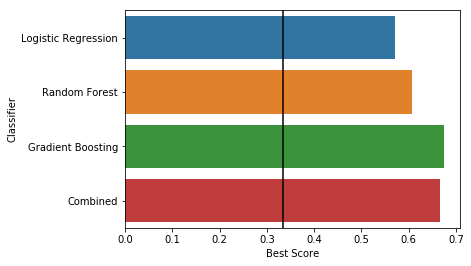

In [22]:
#Create list of clfs with best parameters and their labels
best_clf = []
for gs in gs_list:
    best_clf.append(gs.best_estimator_)
estimators = list(zip(['Logistic Regression','Random Forest','Gradient Boosting'],best_clf))

#Initialize Voting Classifier
votingClf = ensemble.VotingClassifier(estimators=estimators,voting='soft')
votingClf.fit(X=X,y=Y_bins3)
best_score.append(votingClf.score(X=X_test,y=Y_test3bins))

#Wrap results into a dataframe    
clf_test_results = pd.DataFrame({'Classifier' : ['Logistic Regression','Random Forest','Gradient Boosting','Combined'],
                                'Best Score' : best_score})
#Plot results
sns.barplot(x='Best Score',y='Classifier',data=clf_test_results)
plt.axvline(np.divide(1,3), color="black")
plt.show()

### 3.7 Confusion Matrix

In [23]:
class_names = ['to 84.3%','84.3% to 125%','125%+']

def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')


Normalized confusion matrix
[[0.58 0.27 0.15]
 [0.17 0.51 0.32]
 [0.11 0.27 0.63]]
Normalized confusion matrix
[[0.67 0.21 0.12]
 [0.2  0.54 0.27]
 [0.14 0.24 0.62]]
Normalized confusion matrix
[[0.64 0.29 0.07]
 [0.17 0.67 0.16]
 [0.1  0.19 0.71]]
Normalized confusion matrix
[[0.64 0.22 0.14]
 [0.27 0.56 0.16]
 [0.12 0.3  0.58]]


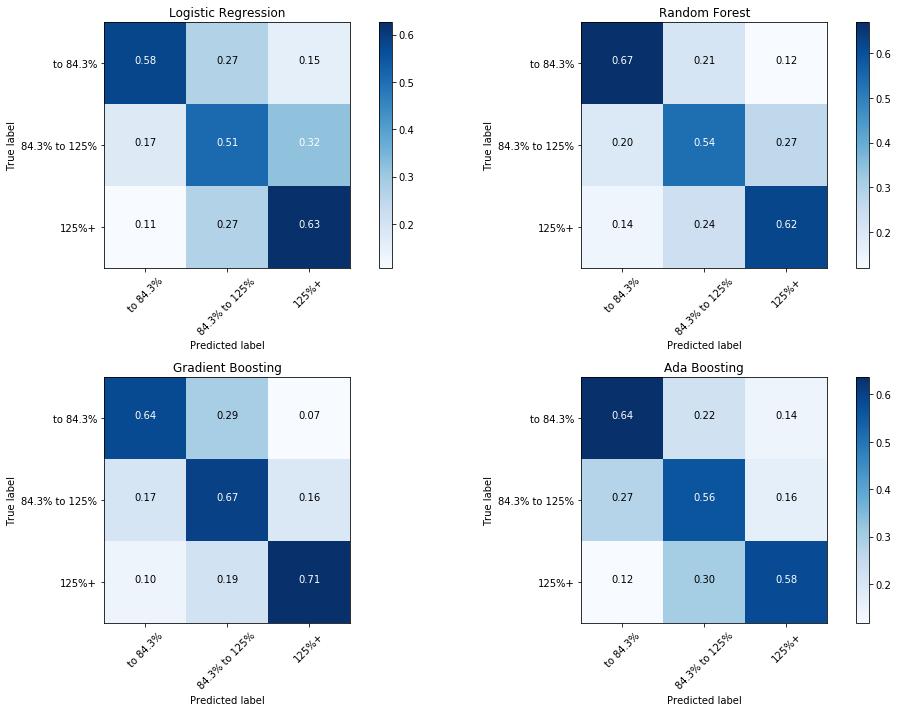

In [24]:
pltnum = 1
plt.subplots(nrows=2,ncols=2,figsize=[15,10])
estimators.append(('Ada Boosting',abc))
for clfname, classifier in estimators:
    y_pred = classifier.fit(X,Y_bins3).predict(X_test)
    cnf_matrix = metrics.confusion_matrix(Y_test3bins, y_pred)
    np.set_printoptions(precision=2)
    # Plot normalized confusion matrix
    plt.subplot(2,2,pltnum)
    plot_confusion_matrix(cnf_matrix, classes=class_names, normalize=True, 
                          title=clfname)
    pltnum +=1
    if pltnum ==5:
        break
plt.show()

## 4. Neural Net with Keras & Tensorflow

In [25]:
# Keras
from keras.layers import Dense
from keras.models import Sequential, load_model
from keras.utils import np_utils
from keras.layers import Dense, Dropout, BatchNormalization, Activation
from keras.wrappers.scikit_learn import KerasClassifier
import keras.regularizers

/usr/local/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.
/usr/local/Cellar/python3/3.6.3/Frameworks/Python.framework/Versions/3.6/lib/python3.6/importlib/_bootstrap.py:219: RuntimeWarning: compiletime version 3.5 of module 'tensorflow.python.framework.fast_tensor_util' does not match runtime version 3.6
  return f(*args, **kwds)


In [26]:
def build_base_model(hidden_units=65,first_activation='relu',hidden_activation='sigmoid'):
    model = Sequential()
    #input layer
    model.add(Dense(units=74,input_dim=74,activation=first_activation))
    model.add(BatchNormalization())
    model.add(Dropout(0.4))
    
    #hidden layers
    model.add(Dense(hidden_units,activation=hidden_activation))
    model.add(BatchNormalization())
    model.add(Dropout(0.4))
    
#     model.add(Dense(15,activation='sigmoid'))
#     model.add(BatchNormalization())
#     model.add(Dropout(0.4))

    # output layer
    model.add(Dense(3, activation='softmax'))
    model.compile(loss='categorical_crossentropy', optimizer='adam', metrics=['accuracy'])
    return model

In [30]:
kfold = StratifiedKFold(n_splits=5, shuffle=True, random_state=1)
estimator = KerasClassifier(build_fn=build_base_model,epochs=1000, batch_size=1000)
#score = cross_val_score(estimator,X=X,y=Y_bins3,cv=kfold,scoring='accuracy')
#score.mean()

In [ ]:
param_grid = {"hidden_units" : np.arange(15,70,5),
             "first_activation" : ["relu","sigmoid","tanh"],
             "hidden_activation" : ["relu","sigmoid","tanh"]}
nn_gs = GridSearchCV(estimator,param_grid,cv=kfold,verbose=1,n_jobs=1)
nn_gs.fit(X,Y_bins3)
nn_gs.best_score_

Fitting 5 folds for each of 99 candidates, totalling 495 fits
Epoch 1/1000
2403/2403 [==============================] - 105s 44ms/step - loss: 1.6903 - acc: 0.3408
Epoch 2/1000
2403/2403 [==============================] - 0s 34us/step - loss: 1.5771 - acc: 0.3496
Epoch 3/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.5286 - acc: 0.3700
Epoch 4/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.4870 - acc: 0.3571
Epoch 5/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.4272 - acc: 0.3874
Epoch 6/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.3875 - acc: 0.4024
Epoch 7/1000
2403/2403 [==============================] - 0s 34us/step - loss: 1.3267 - acc: 0.4078
Epoch 8/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.3037 - acc: 0.4132
Epoch 9/1000
2403/2403 [==============================] - 0s 26us/step - loss: 1.2850 - acc: 0.4203
Epoch 10/1000
2403/2403 [===========

2403/2403 [==============================] - 0s 29us/step - loss: 0.7606 - acc: 0.6475
Epoch 162/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7603 - acc: 0.6513
Epoch 163/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7682 - acc: 0.6450
Epoch 164/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7600 - acc: 0.6471
Epoch 165/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7577 - acc: 0.6583
Epoch 166/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7574 - acc: 0.6479
Epoch 167/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7520 - acc: 0.6567
Epoch 168/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7545 - acc: 0.6613
Epoch 169/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7676 - acc: 0.6484
Epoch 170/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7582 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.6116 - acc: 0.7333
Epoch 322/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5996 - acc: 0.7382
Epoch 323/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5984 - acc: 0.7370
Epoch 324/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5987 - acc: 0.7270
Epoch 325/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5920 - acc: 0.7399
Epoch 326/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6043 - acc: 0.7449
Epoch 327/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5949 - acc: 0.7403
Epoch 328/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6039 - acc: 0.7428
Epoch 329/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6000 - acc: 0.7403
Epoch 330/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5913 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.5000 - acc: 0.7898
Epoch 482/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4918 - acc: 0.8019
Epoch 483/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4886 - acc: 0.7965
Epoch 484/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4988 - acc: 0.7898
Epoch 485/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4828 - acc: 0.7969
Epoch 486/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4898 - acc: 0.7940
Epoch 487/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4762 - acc: 0.8032
Epoch 488/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4914 - acc: 0.7965
Epoch 489/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4884 - acc: 0.7911
Epoch 490/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4738 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4173 - acc: 0.8269
Epoch 642/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4105 - acc: 0.8373
Epoch 643/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4365 - acc: 0.8261
Epoch 644/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4164 - acc: 0.8281
Epoch 645/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4051 - acc: 0.8385
Epoch 646/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4263 - acc: 0.8348
Epoch 647/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4254 - acc: 0.8223
Epoch 648/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4173 - acc: 0.8306
Epoch 649/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4033 - acc: 0.8419
Epoch 650/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3956 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3672 - acc: 0.8498
Epoch 802/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3723 - acc: 0.8556
Epoch 803/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3628 - acc: 0.8568
Epoch 804/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3729 - acc: 0.8556
Epoch 805/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3792 - acc: 0.8510
Epoch 806/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3970 - acc: 0.8485
Epoch 807/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3606 - acc: 0.8577
Epoch 808/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3619 - acc: 0.8577
Epoch 809/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3706 - acc: 0.8581
Epoch 810/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3794 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3201 - acc: 0.8714
Epoch 962/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3442 - acc: 0.8668
Epoch 963/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3451 - acc: 0.8731
Epoch 964/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3268 - acc: 0.8735
Epoch 965/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3538 - acc: 0.8635
Epoch 966/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3424 - acc: 0.8672
Epoch 967/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3610 - acc: 0.8606
Epoch 968/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3370 - acc: 0.8660
Epoch 969/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3460 - acc: 0.8589
Epoch 970/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3364 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.8337 - acc: 0.6026
Epoch 122/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8375 - acc: 0.5976
Epoch 123/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8368 - acc: 0.6159
Epoch 124/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.8380 - acc: 0.6059
Epoch 125/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.8242 - acc: 0.6138
Epoch 126/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8237 - acc: 0.6163
Epoch 127/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.8376 - acc: 0.6022
Epoch 128/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8355 - acc: 0.6167
Epoch 129/1000
2403/2403 [==============================] - 0s 63us/step - loss: 0.8224 - acc: 0.6163
Epoch 130/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.8331 - acc: 0.

2403/2403 [==============================] - 0s 95us/step - loss: 0.6597 - acc: 0.7083
Epoch 282/1000
2403/2403 [==============================] - 0s 58us/step - loss: 0.6525 - acc: 0.7187
Epoch 283/1000
2403/2403 [==============================] - 0s 87us/step - loss: 0.6525 - acc: 0.7166
Epoch 284/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6618 - acc: 0.7058
Epoch 285/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.6379 - acc: 0.7203
Epoch 286/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.6486 - acc: 0.7087
Epoch 287/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.6619 - acc: 0.7054
Epoch 288/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.6579 - acc: 0.7158
Epoch 289/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6478 - acc: 0.7149
Epoch 290/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6364 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.5259 - acc: 0.7844
Epoch 442/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5205 - acc: 0.7811
Epoch 443/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.5457 - acc: 0.7724
Epoch 444/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5268 - acc: 0.7753
Epoch 445/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5272 - acc: 0.7882
Epoch 446/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.5064 - acc: 0.7940
Epoch 447/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5241 - acc: 0.7886
Epoch 448/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5435 - acc: 0.7794
Epoch 449/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5413 - acc: 0.7724
Epoch 450/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5224 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4378 - acc: 0.8206
Epoch 602/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4712 - acc: 0.8048
Epoch 603/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4423 - acc: 0.8169
Epoch 604/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4703 - acc: 0.8048
Epoch 605/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4308 - acc: 0.8244
Epoch 606/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4565 - acc: 0.8090
Epoch 607/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4521 - acc: 0.8202
Epoch 608/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4502 - acc: 0.8190
Epoch 609/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4424 - acc: 0.8261
Epoch 610/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4346 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4116 - acc: 0.8323
Epoch 762/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3912 - acc: 0.8481
Epoch 763/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4131 - acc: 0.8310
Epoch 764/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4159 - acc: 0.8256
Epoch 765/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3957 - acc: 0.8377
Epoch 766/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3892 - acc: 0.8435
Epoch 767/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3922 - acc: 0.8435
Epoch 768/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4050 - acc: 0.8402
Epoch 769/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4009 - acc: 0.8373
Epoch 770/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3928 - acc: 0.

2403/2403 [==============================] - 0s 24us/step - loss: 0.3726 - acc: 0.8514
Epoch 922/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3502 - acc: 0.8631
Epoch 923/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3681 - acc: 0.8585
Epoch 924/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3667 - acc: 0.8568
Epoch 925/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3750 - acc: 0.8535
Epoch 926/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.3646 - acc: 0.8581
Epoch 927/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3538 - acc: 0.8635
Epoch 928/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.3687 - acc: 0.8543
Epoch 929/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.3608 - acc: 0.8618
Epoch 930/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3611 - acc: 0.

2403/2403 [==============================] - 0s 128us/step
Epoch 1/1000
2404/2404 [==============================] - 84s 35ms/step - loss: 2.0283 - acc: 0.3057
Epoch 2/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.8858 - acc: 0.3170
Epoch 3/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.7612 - acc: 0.3523
Epoch 4/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.6961 - acc: 0.3573
Epoch 5/1000
2404/2404 [==============================] - 0s 46us/step - loss: 1.5647 - acc: 0.3719
Epoch 6/1000
2404/2404 [==============================] - 0s 54us/step - loss: 1.5387 - acc: 0.3931
Epoch 7/1000
2404/2404 [==============================] - 0s 44us/step - loss: 1.4769 - acc: 0.3935
Epoch 8/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.4580 - acc: 0.4077
Epoch 9/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.4571 - acc: 0.4189
Epoch 10/1000
2404/2404 [===============

2404/2404 [==============================] - 0s 27us/step - loss: 0.8073 - acc: 0.6273
Epoch 162/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7985 - acc: 0.6235
Epoch 163/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8104 - acc: 0.6331
Epoch 164/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7952 - acc: 0.6265
Epoch 165/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7896 - acc: 0.6294
Epoch 166/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7829 - acc: 0.6439
Epoch 167/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7916 - acc: 0.6319
Epoch 168/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7736 - acc: 0.6443
Epoch 169/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7889 - acc: 0.6302
Epoch 170/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7975 - acc: 0.

2404/2404 [==============================] - 0s 71us/step - loss: 0.7257 - acc: 0.6718
Epoch 242/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7262 - acc: 0.6705
Epoch 243/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7163 - acc: 0.6743
Epoch 244/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6997 - acc: 0.6785
Epoch 245/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7226 - acc: 0.6780
Epoch 246/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7150 - acc: 0.6760
Epoch 247/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7118 - acc: 0.6755
Epoch 248/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7150 - acc: 0.6726
Epoch 249/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7170 - acc: 0.6656
Epoch 250/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7298 - acc: 0.

2404/2404 [==============================] - 0s 51us/step - loss: 0.6081 - acc: 0.7325
Epoch 402/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.5936 - acc: 0.7321
Epoch 403/1000
2404/2404 [==============================] - 0s 75us/step - loss: 0.6006 - acc: 0.7367
Epoch 404/1000
2404/2404 [==============================] - 0s 78us/step - loss: 0.5936 - acc: 0.7425
Epoch 405/1000
2404/2404 [==============================] - 0s 81us/step - loss: 0.5833 - acc: 0.7396
Epoch 406/1000
2404/2404 [==============================] - 0s 67us/step - loss: 0.5708 - acc: 0.7492
Epoch 407/1000
2404/2404 [==============================] - 0s 106us/step - loss: 0.5834 - acc: 0.7354
Epoch 408/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.5952 - acc: 0.7384
Epoch 409/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.5879 - acc: 0.7442
Epoch 410/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5862 - acc: 0

2404/2404 [==============================] - 0s 33us/step - loss: 0.4686 - acc: 0.8057
Epoch 562/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4936 - acc: 0.7949
Epoch 563/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4759 - acc: 0.8003
Epoch 564/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4825 - acc: 0.8032
Epoch 565/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5009 - acc: 0.7879
Epoch 566/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4949 - acc: 0.7916
Epoch 567/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4748 - acc: 0.8041
Epoch 568/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4817 - acc: 0.8020
Epoch 569/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4940 - acc: 0.7928
Epoch 570/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4573 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.4037 - acc: 0.8340
Epoch 722/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3998 - acc: 0.8428
Epoch 723/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4221 - acc: 0.8374
Epoch 724/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4273 - acc: 0.8315
Epoch 725/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4199 - acc: 0.8270
Epoch 726/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4160 - acc: 0.8411
Epoch 727/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4169 - acc: 0.8336
Epoch 728/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4041 - acc: 0.8357
Epoch 729/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4180 - acc: 0.8403
Epoch 730/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4214 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3717 - acc: 0.8490
Epoch 882/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3701 - acc: 0.8565
Epoch 883/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3634 - acc: 0.8594
Epoch 884/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3801 - acc: 0.8482
Epoch 885/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3630 - acc: 0.8590
Epoch 886/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3602 - acc: 0.8594
Epoch 887/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3888 - acc: 0.8465
Epoch 888/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3680 - acc: 0.8519
Epoch 889/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3556 - acc: 0.8557
Epoch 890/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3500 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.9963 - acc: 0.5212
Epoch 41/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9887 - acc: 0.5262
Epoch 42/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0039 - acc: 0.5212
Epoch 43/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9950 - acc: 0.5287
Epoch 44/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9887 - acc: 0.5262
Epoch 45/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9922 - acc: 0.5308
Epoch 46/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9523 - acc: 0.5341
Epoch 47/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.9800 - acc: 0.5287
Epoch 48/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9422 - acc: 0.5453
Epoch 49/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9667 - acc: 0.5329
Epoc

2404/2404 [==============================] - 0s 28us/step - loss: 0.6942 - acc: 0.6805
Epoch 201/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.7073 - acc: 0.6739
Epoch 202/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7081 - acc: 0.6859
Epoch 203/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7035 - acc: 0.6760
Epoch 204/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7029 - acc: 0.6872
Epoch 205/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6898 - acc: 0.6801
Epoch 206/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6970 - acc: 0.6930
Epoch 207/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6979 - acc: 0.6872
Epoch 208/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6911 - acc: 0.6926
Epoch 209/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6895 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.5387 - acc: 0.7604
Epoch 361/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5362 - acc: 0.7687
Epoch 362/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5424 - acc: 0.7646
Epoch 363/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5419 - acc: 0.7600
Epoch 364/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5420 - acc: 0.7700
Epoch 365/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5569 - acc: 0.7517
Epoch 366/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5402 - acc: 0.7675
Epoch 367/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5437 - acc: 0.7625
Epoch 368/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5594 - acc: 0.7600
Epoch 369/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5443 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.4365 - acc: 0.8228
Epoch 521/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4306 - acc: 0.8116
Epoch 522/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4488 - acc: 0.8141
Epoch 523/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.4416 - acc: 0.8091
Epoch 524/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4457 - acc: 0.8174
Epoch 525/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4268 - acc: 0.8232
Epoch 526/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4673 - acc: 0.8041
Epoch 527/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4512 - acc: 0.8149
Epoch 528/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4495 - acc: 0.8149
Epoch 529/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4399 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4304 - acc: 0.8303
Epoch 601/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4114 - acc: 0.8324
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4294 - acc: 0.8128
Epoch 603/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4129 - acc: 0.8315
Epoch 604/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4042 - acc: 0.8399
Epoch 605/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4276 - acc: 0.8278
Epoch 606/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4406 - acc: 0.8253
Epoch 607/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3970 - acc: 0.8432
Epoch 608/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4269 - acc: 0.8249
Epoch 609/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4035 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3648 - acc: 0.8507
Epoch 761/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3628 - acc: 0.8507
Epoch 762/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3737 - acc: 0.8511
Epoch 763/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3806 - acc: 0.8432
Epoch 764/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3688 - acc: 0.8507
Epoch 765/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3819 - acc: 0.8536
Epoch 766/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3802 - acc: 0.8473
Epoch 767/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3795 - acc: 0.8461
Epoch 768/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3712 - acc: 0.8515
Epoch 769/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3893 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3615 - acc: 0.8544
Epoch 841/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3376 - acc: 0.8648
Epoch 842/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3380 - acc: 0.8627
Epoch 843/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3507 - acc: 0.8540
Epoch 844/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3516 - acc: 0.8677
Epoch 845/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3626 - acc: 0.8606
Epoch 846/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3377 - acc: 0.8698
Epoch 847/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3435 - acc: 0.8606
Epoch 848/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3532 - acc: 0.8590
Epoch 849/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3432 - acc: 0.

2404/2404 [==============================] - 1s 233us/step
Epoch 1/1000
2406/2406 [==============================] - 51s 21ms/step - loss: 1.7513 - acc: 0.3254
Epoch 2/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.6204 - acc: 0.3545
Epoch 3/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.5438 - acc: 0.3703
Epoch 4/1000
2406/2406 [==============================] - 0s 41us/step - loss: 1.5526 - acc: 0.3874
Epoch 5/1000
2406/2406 [==============================] - 0s 47us/step - loss: 1.4872 - acc: 0.3736
Epoch 6/1000
2406/2406 [==============================] - 0s 48us/step - loss: 1.4386 - acc: 0.3807
Epoch 7/1000
2406/2406 [==============================] - 0s 49us/step - loss: 1.4268 - acc: 0.3874
Epoch 8/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.3581 - acc: 0.4094
Epoch 9/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.3410 - acc: 0.4135
Epoch 10/1000
2406/2406 [===============

2406/2406 [==============================] - 0s 31us/step - loss: 0.7766 - acc: 0.6388
Epoch 161/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7921 - acc: 0.6280
Epoch 162/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7721 - acc: 0.6401
Epoch 163/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7730 - acc: 0.6384
Epoch 164/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7790 - acc: 0.6247
Epoch 165/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7685 - acc: 0.6492
Epoch 166/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7750 - acc: 0.6359
Epoch 167/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7590 - acc: 0.6388
Epoch 168/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7620 - acc: 0.6430
Epoch 169/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7610 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.6312 - acc: 0.7303
Epoch 321/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6026 - acc: 0.7340
Epoch 322/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6208 - acc: 0.7386
Epoch 323/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6087 - acc: 0.7394
Epoch 324/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6135 - acc: 0.7261
Epoch 325/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5964 - acc: 0.7336
Epoch 326/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.5943 - acc: 0.7502
Epoch 327/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6013 - acc: 0.7394
Epoch 328/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6090 - acc: 0.7273
Epoch 329/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5984 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.4914 - acc: 0.7955
Epoch 481/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4947 - acc: 0.8022
Epoch 482/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4818 - acc: 0.8005
Epoch 483/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4893 - acc: 0.7860
Epoch 484/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4878 - acc: 0.7926
Epoch 485/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4875 - acc: 0.7951
Epoch 486/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4666 - acc: 0.8009
Epoch 487/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.4707 - acc: 0.8038
Epoch 488/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.4695 - acc: 0.8055
Epoch 489/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4872 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.4098 - acc: 0.8329
Epoch 641/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.4164 - acc: 0.8379
Epoch 642/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4174 - acc: 0.8367
Epoch 643/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4094 - acc: 0.8392
Epoch 644/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4073 - acc: 0.8425
Epoch 645/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3899 - acc: 0.8441
Epoch 646/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3971 - acc: 0.8400
Epoch 647/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4118 - acc: 0.8288
Epoch 648/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4200 - acc: 0.8350
Epoch 649/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4095 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.3637 - acc: 0.8504
Epoch 799/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3540 - acc: 0.8500
Epoch 800/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3744 - acc: 0.8525
Epoch 801/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3619 - acc: 0.8504
Epoch 802/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3755 - acc: 0.8495
Epoch 803/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3811 - acc: 0.8421
Epoch 804/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3627 - acc: 0.8628
Epoch 805/1000
2406/2406 [==============================] - 0s 58us/step - loss: 0.3621 - acc: 0.8587
Epoch 806/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.3669 - acc: 0.8500
Epoch 807/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3609 - acc: 0.

2406/2406 [==============================] - 0s 25us/step - loss: 0.3282 - acc: 0.8720
Epoch 959/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3188 - acc: 0.8728
Epoch 960/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3405 - acc: 0.8716
Epoch 961/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3301 - acc: 0.8745
Epoch 962/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3385 - acc: 0.8637
Epoch 963/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3309 - acc: 0.8741
Epoch 964/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3610 - acc: 0.8583
Epoch 965/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3263 - acc: 0.8687
Epoch 966/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3240 - acc: 0.8699
Epoch 967/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3509 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.8182 - acc: 0.6113
Epoch 118/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7989 - acc: 0.6209
Epoch 119/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8090 - acc: 0.6146
Epoch 120/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8013 - acc: 0.6201
Epoch 121/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8137 - acc: 0.6205
Epoch 122/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.8071 - acc: 0.6230
Epoch 123/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8188 - acc: 0.6113
Epoch 124/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8032 - acc: 0.6251
Epoch 125/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7940 - acc: 0.6267
Epoch 126/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8138 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.6341 - acc: 0.7141
Epoch 278/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6222 - acc: 0.7291
Epoch 279/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6032 - acc: 0.7474
Epoch 280/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6340 - acc: 0.7224
Epoch 281/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6306 - acc: 0.7249
Epoch 282/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6274 - acc: 0.7228
Epoch 283/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6172 - acc: 0.7391
Epoch 284/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.6169 - acc: 0.7295
Epoch 285/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6243 - acc: 0.7308
Epoch 286/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6081 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.4937 - acc: 0.7865
Epoch 438/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4831 - acc: 0.7982
Epoch 439/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4934 - acc: 0.7928
Epoch 440/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5173 - acc: 0.7836
Epoch 441/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4832 - acc: 0.7903
Epoch 442/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5091 - acc: 0.7873
Epoch 443/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4928 - acc: 0.7932
Epoch 444/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5090 - acc: 0.7807
Epoch 445/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4977 - acc: 0.7790
Epoch 446/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5034 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.4030 - acc: 0.8406
Epoch 598/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4094 - acc: 0.8335
Epoch 599/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4232 - acc: 0.8240
Epoch 600/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4239 - acc: 0.8269
Epoch 601/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4046 - acc: 0.8427
Epoch 602/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3928 - acc: 0.8423
Epoch 603/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4238 - acc: 0.8290
Epoch 604/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4198 - acc: 0.8269
Epoch 605/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4241 - acc: 0.8223
Epoch 606/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4119 - acc: 0.

Epoch 757/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3566 - acc: 0.8543
Epoch 758/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3639 - acc: 0.8527
Epoch 759/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3637 - acc: 0.8585
Epoch 760/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3515 - acc: 0.8560
Epoch 761/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3571 - acc: 0.8510
Epoch 762/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3699 - acc: 0.8477
Epoch 763/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3867 - acc: 0.8444
Epoch 764/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3440 - acc: 0.8610
Epoch 765/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3828 - acc: 0.8564
Epoch 766/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0

2403/2403 [==============================] - 0s 26us/step - loss: 0.3098 - acc: 0.8793
Epoch 918/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3318 - acc: 0.8664
Epoch 919/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3234 - acc: 0.8681
Epoch 920/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3018 - acc: 0.8814
Epoch 921/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3117 - acc: 0.8777
Epoch 922/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3242 - acc: 0.8710
Epoch 923/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3078 - acc: 0.8722
Epoch 924/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3306 - acc: 0.8660
Epoch 925/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3264 - acc: 0.8702
Epoch 926/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3198 - acc: 0.

2403/2403 [==============================] - 0s 25us/step - loss: 0.3076 - acc: 0.8793
Epoch 998/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3167 - acc: 0.8789
Epoch 999/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3312 - acc: 0.8664
Epoch 1000/1000
2403/2403 [==============================] - 0s 138us/step
Epoch 1/1000
2403/2403 [==============================] - 38s 16ms/step - loss: 1.6802 - acc: 0.3317
Epoch 2/1000
2403/2403 [==============================] - 0s 34us/step - loss: 1.5630 - acc: 0.3529
Epoch 3/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.5188 - acc: 0.3729
Epoch 4/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.4435 - acc: 0.3774
Epoch 5/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.4392 - acc: 0.3749
Epoch 6/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.3878 - acc: 0.4124
Epoch 7/1000
2403/2403 [=========

2403/2403 [==============================] - 0s 31us/step - loss: 0.7644 - acc: 0.6367
Epoch 158/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7549 - acc: 0.6459
Epoch 159/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7514 - acc: 0.6479
Epoch 160/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.7618 - acc: 0.6438
Epoch 161/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7458 - acc: 0.6563
Epoch 162/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7492 - acc: 0.6500
Epoch 163/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7502 - acc: 0.6513
Epoch 164/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7436 - acc: 0.6529
Epoch 165/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7433 - acc: 0.6492
Epoch 166/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7466 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.6572 - acc: 0.7087
Epoch 238/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6526 - acc: 0.7074
Epoch 239/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6566 - acc: 0.7070
Epoch 240/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6717 - acc: 0.6937
Epoch 241/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6845 - acc: 0.6854
Epoch 242/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6698 - acc: 0.6983
Epoch 243/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6683 - acc: 0.6995
Epoch 244/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6569 - acc: 0.7058
Epoch 245/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6591 - acc: 0.7099
Epoch 246/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.6567 - acc: 0.

2403/2403 [==============================] - 0s 62us/step - loss: 0.5177 - acc: 0.7774
Epoch 398/1000
2403/2403 [==============================] - 0s 193us/step - loss: 0.5239 - acc: 0.7740
Epoch 399/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5325 - acc: 0.7690
Epoch 400/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5329 - acc: 0.7749
Epoch 401/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5264 - acc: 0.7753
Epoch 402/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5197 - acc: 0.7769
Epoch 403/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5570 - acc: 0.7599
Epoch 404/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5327 - acc: 0.7724
Epoch 405/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5098 - acc: 0.7815
Epoch 406/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5133 - acc: 0

/usr/local/lib/python3.6/site-packages/keras/callbacks.py:116: UserWarning: Method on_batch_end() is slow compared to the batch update (0.384116). Check your callbacks.
  % delta_t_median)


Epoch 435/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.5111 - acc: 0.7790
Epoch 436/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5149 - acc: 0.7882
Epoch 437/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5116 - acc: 0.7720
Epoch 438/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5129 - acc: 0.7869
Epoch 439/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4916 - acc: 0.7973
Epoch 440/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5116 - acc: 0.7736
Epoch 441/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5124 - acc: 0.7736
Epoch 442/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4826 - acc: 0.7994
Epoch 443/1000
2403/2403 [==============================] - 0s 78us/step - loss: 0.4808 - acc: 0.8019
Epoch 444/1000
2403/2403 [==============================] - 0s 101us/step - loss: 

2403/2403 [==============================] - 0s 51us/step - loss: 0.4179 - acc: 0.8219
Epoch 595/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3979 - acc: 0.8344
Epoch 596/1000
2403/2403 [==============================] - 0s 118us/step - loss: 0.4211 - acc: 0.8256
Epoch 597/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.4133 - acc: 0.8277
Epoch 598/1000
2403/2403 [==============================] - 0s 67us/step - loss: 0.4246 - acc: 0.8261
Epoch 599/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.4173 - acc: 0.8261
Epoch 600/1000
2403/2403 [==============================] - 0s 67us/step - loss: 0.4086 - acc: 0.8390
Epoch 601/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.4101 - acc: 0.8281
Epoch 602/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4138 - acc: 0.8327
Epoch 603/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4099 - acc: 0

2403/2403 [==============================] - 0s 56us/step - loss: 0.4109 - acc: 0.8290
Epoch 675/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3857 - acc: 0.8431
Epoch 676/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4037 - acc: 0.8344
Epoch 677/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4007 - acc: 0.8369
Epoch 678/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4074 - acc: 0.8352
Epoch 679/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3850 - acc: 0.8481
Epoch 680/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3814 - acc: 0.8402
Epoch 681/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3742 - acc: 0.8469
Epoch 682/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3795 - acc: 0.8498
Epoch 683/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4086 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.3302 - acc: 0.8623
Epoch 835/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3705 - acc: 0.8485
Epoch 836/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3613 - acc: 0.8652
Epoch 837/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3381 - acc: 0.8593
Epoch 838/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3518 - acc: 0.8589
Epoch 839/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3401 - acc: 0.8656
Epoch 840/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3536 - acc: 0.8560
Epoch 841/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3612 - acc: 0.8577
Epoch 842/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3532 - acc: 0.8627
Epoch 843/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3228 - acc: 0.

2403/2403 [==============================] - 0s 50us/step - loss: 0.3155 - acc: 0.8697
Epoch 995/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3212 - acc: 0.8756
Epoch 996/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3172 - acc: 0.8835
Epoch 997/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3360 - acc: 0.8660
Epoch 998/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3272 - acc: 0.8685
Epoch 999/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3051 - acc: 0.8801
Epoch 1000/1000
2403/2403 [==============================] - 1s 350us/step
Epoch 1/1000
2404/2404 [==============================] - 87s 36ms/step - loss: 1.6677 - acc: 0.3332
Epoch 2/1000
2404/2404 [==============================] - 0s 40us/step - loss: 1.6247 - acc: 0.3573
Epoch 3/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.6061 - acc: 0.3490
Epoch 4/1000
2404/2404 [===

2404/2404 [==============================] - 0s 33us/step - loss: 0.7796 - acc: 0.6369
Epoch 154/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7818 - acc: 0.6260
Epoch 155/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7895 - acc: 0.6394
Epoch 156/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7753 - acc: 0.6477
Epoch 157/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7801 - acc: 0.6389
Epoch 158/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7835 - acc: 0.6406
Epoch 159/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7659 - acc: 0.6522
Epoch 160/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7601 - acc: 0.6468
Epoch 161/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7591 - acc: 0.6543
Epoch 162/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7695 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.6957 - acc: 0.6959
Epoch 234/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6790 - acc: 0.7063
Epoch 235/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6803 - acc: 0.6980
Epoch 236/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6792 - acc: 0.6943
Epoch 237/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6886 - acc: 0.6963
Epoch 238/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6864 - acc: 0.6880
Epoch 239/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6832 - acc: 0.6988
Epoch 240/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6773 - acc: 0.6984
Epoch 241/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6788 - acc: 0.6922
Epoch 242/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6810 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.5669 - acc: 0.7525
Epoch 394/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5614 - acc: 0.7558
Epoch 395/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5527 - acc: 0.7641
Epoch 396/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5440 - acc: 0.7720
Epoch 397/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5400 - acc: 0.7800
Epoch 398/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5371 - acc: 0.7691
Epoch 399/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5349 - acc: 0.7637
Epoch 400/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5386 - acc: 0.7720
Epoch 401/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5350 - acc: 0.7633
Epoch 402/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5339 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4666 - acc: 0.8028
Epoch 553/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4506 - acc: 0.8236
Epoch 554/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4640 - acc: 0.8041
Epoch 555/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4651 - acc: 0.8091
Epoch 556/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4508 - acc: 0.8178
Epoch 557/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4637 - acc: 0.8095
Epoch 558/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4484 - acc: 0.8145
Epoch 559/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4412 - acc: 0.8145
Epoch 560/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4626 - acc: 0.8012
Epoch 561/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4550 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3930 - acc: 0.8378
Epoch 713/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3959 - acc: 0.8328
Epoch 714/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4149 - acc: 0.8295
Epoch 715/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4052 - acc: 0.8265
Epoch 716/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3946 - acc: 0.8411
Epoch 717/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3847 - acc: 0.8436
Epoch 718/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4039 - acc: 0.8340
Epoch 719/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3989 - acc: 0.8340
Epoch 720/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3989 - acc: 0.8419
Epoch 721/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4113 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3557 - acc: 0.8552
Epoch 873/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3663 - acc: 0.8507
Epoch 874/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3567 - acc: 0.8561
Epoch 875/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3414 - acc: 0.8636
Epoch 876/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3602 - acc: 0.8490
Epoch 877/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3654 - acc: 0.8565
Epoch 878/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3548 - acc: 0.8515
Epoch 879/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3430 - acc: 0.8665
Epoch 880/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3586 - acc: 0.8557
Epoch 881/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3605 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 1.0589 - acc: 0.4971
Epoch 32/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0364 - acc: 0.5191
Epoch 33/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0511 - acc: 0.5004
Epoch 34/1000
2404/2404 [==============================] - 0s 25us/step - loss: 1.0331 - acc: 0.5033
Epoch 35/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0424 - acc: 0.5062
Epoch 36/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0328 - acc: 0.5017
Epoch 37/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0151 - acc: 0.5200
Epoch 38/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0548 - acc: 0.5017
Epoch 39/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0209 - acc: 0.5104
Epoch 40/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9889 - acc: 0.5279
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.7178 - acc: 0.6718
Epoch 192/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7235 - acc: 0.6685
Epoch 193/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7259 - acc: 0.6701
Epoch 194/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7366 - acc: 0.6710
Epoch 195/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7296 - acc: 0.6597
Epoch 196/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6970 - acc: 0.6801
Epoch 197/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7091 - acc: 0.6872
Epoch 198/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7147 - acc: 0.6814
Epoch 199/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7266 - acc: 0.6697
Epoch 200/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7122 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5525 - acc: 0.7662
Epoch 352/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5695 - acc: 0.7512
Epoch 353/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5638 - acc: 0.7583
Epoch 354/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5587 - acc: 0.7529
Epoch 355/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5747 - acc: 0.7458
Epoch 356/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5612 - acc: 0.7512
Epoch 357/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5686 - acc: 0.7483
Epoch 358/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5523 - acc: 0.7542
Epoch 359/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.5801 - acc: 0.7483
Epoch 360/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5537 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4535 - acc: 0.8120
Epoch 512/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4656 - acc: 0.8074
Epoch 513/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4541 - acc: 0.8053
Epoch 514/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4715 - acc: 0.7974
Epoch 515/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4682 - acc: 0.8016
Epoch 516/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4640 - acc: 0.8003
Epoch 517/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4428 - acc: 0.8161
Epoch 518/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4767 - acc: 0.7941
Epoch 519/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4574 - acc: 0.8078
Epoch 520/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4617 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3936 - acc: 0.8394
Epoch 672/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3827 - acc: 0.8498
Epoch 673/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3944 - acc: 0.8407
Epoch 674/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.3861 - acc: 0.8386
Epoch 675/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3888 - acc: 0.8428
Epoch 676/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4072 - acc: 0.8432
Epoch 677/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3848 - acc: 0.8478
Epoch 678/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3788 - acc: 0.8423
Epoch 679/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.3819 - acc: 0.8428
Epoch 680/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.3877 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.3611 - acc: 0.8536
Epoch 832/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3620 - acc: 0.8561
Epoch 833/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3453 - acc: 0.8606
Epoch 834/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3656 - acc: 0.8644
Epoch 835/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3408 - acc: 0.8706
Epoch 836/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3361 - acc: 0.8661
Epoch 837/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3642 - acc: 0.8527
Epoch 838/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3676 - acc: 0.8486
Epoch 839/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3508 - acc: 0.8557
Epoch 840/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3429 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.2950 - acc: 0.8760
Epoch 992/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.3175 - acc: 0.8710
Epoch 993/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3220 - acc: 0.8744
Epoch 994/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3382 - acc: 0.8652
Epoch 995/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3026 - acc: 0.8823
Epoch 996/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3286 - acc: 0.8777
Epoch 997/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3246 - acc: 0.8669
Epoch 998/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2966 - acc: 0.8885
Epoch 999/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3196 - acc: 0.8785
Epoch 1000/1000
2404/2404 [==============================] - 0s 193us/step
Epoch 1/1000
2406/2406

2406/2406 [==============================] - 0s 27us/step - loss: 0.8877 - acc: 0.5719
Epoch 72/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.9098 - acc: 0.5698
Epoch 73/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.9038 - acc: 0.5615
Epoch 74/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8882 - acc: 0.5835
Epoch 75/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.8984 - acc: 0.5856
Epoch 76/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8750 - acc: 0.5844
Epoch 77/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.8959 - acc: 0.5719
Epoch 78/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.8891 - acc: 0.5740
Epoch 79/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.8630 - acc: 0.5786
Epoch 80/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8645 - acc: 0.5914
Epoc

2406/2406 [==============================] - 0s 25us/step - loss: 0.6984 - acc: 0.6858
Epoch 232/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.6903 - acc: 0.6949
Epoch 233/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.6892 - acc: 0.6899
Epoch 234/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.6839 - acc: 0.6858
Epoch 235/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.6897 - acc: 0.6775
Epoch 236/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.6874 - acc: 0.6887
Epoch 237/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.6950 - acc: 0.6820
Epoch 238/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6934 - acc: 0.6912
Epoch 239/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.6870 - acc: 0.6883
Epoch 240/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6806 - acc: 0.

2406/2406 [==============================] - 0s 111us/step - loss: 0.5488 - acc: 0.7639
Epoch 392/1000
2406/2406 [==============================] - 0s 84us/step - loss: 0.5724 - acc: 0.7573
Epoch 393/1000
2406/2406 [==============================] - 0s 58us/step - loss: 0.5601 - acc: 0.7643
Epoch 394/1000
2406/2406 [==============================] - 0s 83us/step - loss: 0.5470 - acc: 0.7685
Epoch 395/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5585 - acc: 0.7606
Epoch 396/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.5683 - acc: 0.7544
Epoch 397/1000
2406/2406 [==============================] - 0s 69us/step - loss: 0.5657 - acc: 0.7627
Epoch 398/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.5675 - acc: 0.7648
Epoch 399/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5463 - acc: 0.7664
Epoch 400/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5749 - acc: 0

2406/2406 [==============================] - 0s 30us/step - loss: 0.4580 - acc: 0.8109
Epoch 552/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4663 - acc: 0.8080
Epoch 553/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4768 - acc: 0.8017
Epoch 554/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4580 - acc: 0.8076
Epoch 555/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4636 - acc: 0.8059
Epoch 556/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4549 - acc: 0.8150
Epoch 557/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.4573 - acc: 0.8071
Epoch 558/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.4577 - acc: 0.8092
Epoch 559/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4659 - acc: 0.8117
Epoch 560/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4531 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4061 - acc: 0.8317
Epoch 712/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3925 - acc: 0.8462
Epoch 713/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4084 - acc: 0.8387
Epoch 714/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4177 - acc: 0.8275
Epoch 715/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3979 - acc: 0.8408
Epoch 716/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4125 - acc: 0.8383
Epoch 717/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3993 - acc: 0.8333
Epoch 718/1000
2406/2406 [==============================] - 0s 56us/step - loss: 0.4020 - acc: 0.8367
Epoch 719/1000
2406/2406 [==============================] - 0s 93us/step - loss: 0.3842 - acc: 0.8458
Epoch 720/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3850 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.3623 - acc: 0.8533
Epoch 872/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3618 - acc: 0.8637
Epoch 873/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3641 - acc: 0.8529
Epoch 874/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3651 - acc: 0.8512
Epoch 875/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3535 - acc: 0.8570
Epoch 876/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3729 - acc: 0.8554
Epoch 877/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3686 - acc: 0.8495
Epoch 878/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3812 - acc: 0.8429
Epoch 879/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3609 - acc: 0.8599
Epoch 880/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3633 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 1.0402 - acc: 0.5114
Epoch 31/1000
2403/2403 [==============================] - 0s 55us/step - loss: 1.0081 - acc: 0.5298
Epoch 32/1000
2403/2403 [==============================] - 0s 35us/step - loss: 1.0194 - acc: 0.5056
Epoch 33/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.9946 - acc: 0.5281
Epoch 34/1000
2403/2403 [==============================] - 0s 25us/step - loss: 1.0052 - acc: 0.5181
Epoch 35/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9846 - acc: 0.5360
Epoch 36/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.9800 - acc: 0.5372
Epoch 37/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9929 - acc: 0.5347
Epoch 38/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.9765 - acc: 0.5364
Epoch 39/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.9769 - acc: 0.5331
Epoc

2403/2403 [==============================] - 0s 27us/step - loss: 0.7988 - acc: 0.6259
Epoch 112/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7938 - acc: 0.6217
Epoch 113/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.8101 - acc: 0.6251
Epoch 114/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7808 - acc: 0.6367
Epoch 115/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8033 - acc: 0.6142
Epoch 116/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7946 - acc: 0.6267
Epoch 117/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7921 - acc: 0.6313
Epoch 118/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7982 - acc: 0.6201
Epoch 119/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7809 - acc: 0.6417
Epoch 120/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7902 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.6145 - acc: 0.7316
Epoch 272/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6003 - acc: 0.7353
Epoch 273/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6045 - acc: 0.7220
Epoch 274/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6106 - acc: 0.7403
Epoch 275/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6108 - acc: 0.7287
Epoch 276/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6083 - acc: 0.7308
Epoch 277/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5932 - acc: 0.7432
Epoch 278/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6176 - acc: 0.7266
Epoch 279/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6029 - acc: 0.7303
Epoch 280/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6024 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.4761 - acc: 0.8032
Epoch 432/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4782 - acc: 0.7903
Epoch 433/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4917 - acc: 0.7873
Epoch 434/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4764 - acc: 0.8007
Epoch 435/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4799 - acc: 0.7986
Epoch 436/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4931 - acc: 0.7849
Epoch 437/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4893 - acc: 0.7919
Epoch 438/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4903 - acc: 0.7986
Epoch 439/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4939 - acc: 0.7928
Epoch 440/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4903 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4140 - acc: 0.8294
Epoch 592/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4104 - acc: 0.8302
Epoch 593/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3976 - acc: 0.8369
Epoch 594/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3981 - acc: 0.8406
Epoch 595/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4179 - acc: 0.8277
Epoch 596/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4156 - acc: 0.8331
Epoch 597/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4058 - acc: 0.8344
Epoch 598/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4282 - acc: 0.8206
Epoch 599/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4138 - acc: 0.8227
Epoch 600/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4234 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.3695 - acc: 0.8506
Epoch 752/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3683 - acc: 0.8494
Epoch 753/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3716 - acc: 0.8519
Epoch 754/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3682 - acc: 0.8510
Epoch 755/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3644 - acc: 0.8485
Epoch 756/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3495 - acc: 0.8648
Epoch 757/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3622 - acc: 0.8552
Epoch 758/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3726 - acc: 0.8390
Epoch 759/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3775 - acc: 0.8489
Epoch 760/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3556 - acc: 0.

2403/2403 [==============================] - 0s 48us/step - loss: 0.3166 - acc: 0.8739
Epoch 912/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3328 - acc: 0.8685
Epoch 913/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.3403 - acc: 0.8631
Epoch 914/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.3287 - acc: 0.8693
Epoch 915/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3249 - acc: 0.8747
Epoch 916/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3368 - acc: 0.8685
Epoch 917/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3271 - acc: 0.8722
Epoch 918/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3174 - acc: 0.8772
Epoch 919/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3066 - acc: 0.8814
Epoch 920/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3222 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.9045 - acc: 0.5539
Epoch 71/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.9075 - acc: 0.5730
Epoch 72/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.9034 - acc: 0.5605
Epoch 73/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.8920 - acc: 0.5747
Epoch 74/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.9123 - acc: 0.5551
Epoch 75/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8906 - acc: 0.5685
Epoch 76/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8736 - acc: 0.5809
Epoch 77/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8692 - acc: 0.5718
Epoch 78/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.9033 - acc: 0.5734
Epoch 79/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8809 - acc: 0.5926
Epoc

2403/2403 [==============================] - 0s 26us/step - loss: 0.6797 - acc: 0.7012
Epoch 231/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6756 - acc: 0.7020
Epoch 232/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6776 - acc: 0.6912
Epoch 233/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6624 - acc: 0.7074
Epoch 234/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6781 - acc: 0.6979
Epoch 235/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6752 - acc: 0.6995
Epoch 236/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6812 - acc: 0.6950
Epoch 237/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6811 - acc: 0.6879
Epoch 238/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6677 - acc: 0.6950
Epoch 239/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6626 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.5430 - acc: 0.7640
Epoch 391/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5353 - acc: 0.7686
Epoch 392/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5306 - acc: 0.7686
Epoch 393/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5234 - acc: 0.7774
Epoch 394/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5213 - acc: 0.7811
Epoch 395/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.5169 - acc: 0.7782
Epoch 396/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.5467 - acc: 0.7549
Epoch 397/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.5242 - acc: 0.7703
Epoch 398/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.5162 - acc: 0.7690
Epoch 399/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5172 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4542 - acc: 0.8127
Epoch 550/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4179 - acc: 0.8236
Epoch 551/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4213 - acc: 0.8211
Epoch 552/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4286 - acc: 0.8327
Epoch 553/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4426 - acc: 0.8161
Epoch 554/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4381 - acc: 0.8156
Epoch 555/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4388 - acc: 0.8119
Epoch 556/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4332 - acc: 0.8161
Epoch 557/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4341 - acc: 0.8177
Epoch 558/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4305 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3668 - acc: 0.8469
Epoch 710/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3697 - acc: 0.8485
Epoch 711/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3788 - acc: 0.8456
Epoch 712/1000
2403/2403 [==============================] - 0s 73us/step - loss: 0.3656 - acc: 0.8464
Epoch 713/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3659 - acc: 0.8498
Epoch 714/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3760 - acc: 0.8485
Epoch 715/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.3639 - acc: 0.858 - 0s 31us/step - loss: 0.3538 - acc: 0.8568
Epoch 716/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3827 - acc: 0.8402
Epoch 717/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3658 - acc: 0.8535
Epoch 718/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 29us/step - loss: 0.3581 - acc: 0.8589
Epoch 790/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3689 - acc: 0.8543
Epoch 791/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3426 - acc: 0.8648
Epoch 792/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3507 - acc: 0.8606
Epoch 793/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3507 - acc: 0.8623
Epoch 794/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3339 - acc: 0.8685
Epoch 795/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3411 - acc: 0.8627
Epoch 796/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3660 - acc: 0.8506
Epoch 797/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3725 - acc: 0.8531
Epoch 798/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3469 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3195 - acc: 0.8722
Epoch 950/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3162 - acc: 0.8789
Epoch 951/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3069 - acc: 0.8772
Epoch 952/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.2929 - acc: 0.8856
Epoch 953/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3086 - acc: 0.8760
Epoch 954/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3122 - acc: 0.8781
Epoch 955/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3126 - acc: 0.8760
Epoch 956/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3210 - acc: 0.8777
Epoch 957/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3105 - acc: 0.8810
Epoch 958/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3031 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.8566 - acc: 0.5832
Epoch 110/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8506 - acc: 0.5936
Epoch 111/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8470 - acc: 0.5965
Epoch 112/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8429 - acc: 0.5998
Epoch 113/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8490 - acc: 0.5990
Epoch 114/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8349 - acc: 0.5965
Epoch 115/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8467 - acc: 0.5890
Epoch 116/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8440 - acc: 0.5940
Epoch 117/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8437 - acc: 0.5928
Epoch 118/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8192 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.6645 - acc: 0.7063
Epoch 270/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6767 - acc: 0.6934
Epoch 271/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6772 - acc: 0.7092
Epoch 272/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6536 - acc: 0.7042
Epoch 273/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6488 - acc: 0.7196
Epoch 274/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6609 - acc: 0.7184
Epoch 275/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6646 - acc: 0.7130
Epoch 276/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6690 - acc: 0.6976
Epoch 277/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6626 - acc: 0.7001
Epoch 278/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6619 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.5833 - acc: 0.7475
Epoch 350/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6135 - acc: 0.7296
Epoch 351/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5902 - acc: 0.7392
Epoch 352/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6089 - acc: 0.7242
Epoch 353/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5877 - acc: 0.7404
Epoch 354/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5893 - acc: 0.7475
Epoch 355/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6044 - acc: 0.7342
Epoch 356/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6159 - acc: 0.7246
Epoch 357/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5892 - acc: 0.7450
Epoch 358/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5822 - acc: 0.

2404/2404 [==============================] - 0s 25us/step - loss: 0.4773 - acc: 0.8053
Epoch 510/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4942 - acc: 0.7883
Epoch 511/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4836 - acc: 0.7891
Epoch 512/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4975 - acc: 0.7953
Epoch 513/1000
2404/2404 [==============================] - ETA: 0s - loss: 0.4970 - acc: 0.796 - 0s 26us/step - loss: 0.5046 - acc: 0.7891
Epoch 514/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4709 - acc: 0.7937
Epoch 515/1000
2404/2404 [==============================] - 0s 65us/step - loss: 0.4820 - acc: 0.7999
Epoch 516/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4944 - acc: 0.7908
Epoch 517/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4828 - acc: 0.8045
Epoch 518/1000
2404/2404 [==============================] -

2404/2404 [==============================] - 0s 29us/step - loss: 0.4339 - acc: 0.8191
Epoch 590/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4321 - acc: 0.8220
Epoch 591/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4826 - acc: 0.7999
Epoch 592/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4401 - acc: 0.8136
Epoch 593/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4511 - acc: 0.8099
Epoch 594/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4480 - acc: 0.8099
Epoch 595/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4489 - acc: 0.8041
Epoch 596/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4269 - acc: 0.8203
Epoch 597/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4593 - acc: 0.8091
Epoch 598/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4379 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4076 - acc: 0.8303
Epoch 750/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3820 - acc: 0.8374
Epoch 751/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3894 - acc: 0.8361
Epoch 752/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3865 - acc: 0.8444
Epoch 753/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3739 - acc: 0.8465
Epoch 754/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3933 - acc: 0.8332
Epoch 755/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3944 - acc: 0.8303
Epoch 756/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3868 - acc: 0.8403
Epoch 757/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3754 - acc: 0.8444
Epoch 758/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3813 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3358 - acc: 0.8582
Epoch 910/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3492 - acc: 0.8536
Epoch 911/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3281 - acc: 0.8648
Epoch 912/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3490 - acc: 0.8594
Epoch 913/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3495 - acc: 0.8544
Epoch 914/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3643 - acc: 0.8465
Epoch 915/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3286 - acc: 0.8669
Epoch 916/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3358 - acc: 0.8661
Epoch 917/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3360 - acc: 0.8652
Epoch 918/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3388 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.8607 - acc: 0.5940
Epoch 69/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8483 - acc: 0.5928
Epoch 70/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8300 - acc: 0.6057
Epoch 71/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8432 - acc: 0.5932
Epoch 72/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8487 - acc: 0.5948
Epoch 73/1000
2404/2404 [==============================] - 0s 62us/step - loss: 0.8414 - acc: 0.5944
Epoch 74/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8370 - acc: 0.6073
Epoch 75/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8333 - acc: 0.5982
Epoch 76/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8295 - acc: 0.6002
Epoch 77/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8387 - acc: 0.6106
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.6277 - acc: 0.7072
Epoch 229/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6103 - acc: 0.7342
Epoch 230/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5957 - acc: 0.7367
Epoch 231/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6208 - acc: 0.7255
Epoch 232/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6101 - acc: 0.7250
Epoch 233/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6165 - acc: 0.7242
Epoch 234/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6205 - acc: 0.7151
Epoch 235/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6080 - acc: 0.7238
Epoch 236/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6000 - acc: 0.7413
Epoch 237/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5955 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4946 - acc: 0.7970
Epoch 389/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4851 - acc: 0.7941
Epoch 390/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4665 - acc: 0.8045
Epoch 391/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4676 - acc: 0.8020
Epoch 392/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5102 - acc: 0.7779
Epoch 393/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4819 - acc: 0.7899
Epoch 394/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4716 - acc: 0.7895
Epoch 395/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4779 - acc: 0.7995
Epoch 396/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4801 - acc: 0.8003
Epoch 397/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4867 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.4148 - acc: 0.8265
Epoch 549/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4179 - acc: 0.8336
Epoch 550/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3943 - acc: 0.8253
Epoch 551/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4054 - acc: 0.8344
Epoch 552/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4065 - acc: 0.8286
Epoch 553/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4089 - acc: 0.8311
Epoch 554/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3972 - acc: 0.8378
Epoch 555/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3999 - acc: 0.8419
Epoch 556/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4005 - acc: 0.8403
Epoch 557/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4214 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3565 - acc: 0.8557
Epoch 709/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3535 - acc: 0.8557
Epoch 710/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3565 - acc: 0.8569
Epoch 711/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3297 - acc: 0.8719
Epoch 712/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3554 - acc: 0.8561
Epoch 713/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3548 - acc: 0.8457
Epoch 714/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3233 - acc: 0.8656
Epoch 715/1000
2404/2404 [==============================] - 0s 76us/step - loss: 0.3638 - acc: 0.8469
Epoch 716/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3566 - acc: 0.8532
Epoch 717/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3562 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3114 - acc: 0.8839
Epoch 869/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3424 - acc: 0.8636
Epoch 870/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3127 - acc: 0.8719
Epoch 871/1000
2404/2404 [==============================] - 0s 69us/step - loss: 0.3158 - acc: 0.8877
Epoch 872/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3030 - acc: 0.8835
Epoch 873/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3211 - acc: 0.8756
Epoch 874/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3044 - acc: 0.8706
Epoch 875/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3223 - acc: 0.8740
Epoch 876/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3051 - acc: 0.8744
Epoch 877/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3241 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 1.0484 - acc: 0.4904
Epoch 28/1000
2406/2406 [==============================] - 0s 40us/step - loss: 1.0765 - acc: 0.4871
Epoch 29/1000
2406/2406 [==============================] - 0s 41us/step - loss: 1.0606 - acc: 0.4846
Epoch 30/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.0510 - acc: 0.4896
Epoch 31/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.0451 - acc: 0.4942
Epoch 32/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0429 - acc: 0.5054
Epoch 33/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0109 - acc: 0.5004
Epoch 34/1000
2406/2406 [==============================] - 0s 31us/step - loss: 1.0193 - acc: 0.5154
Epoch 35/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.0228 - acc: 0.5087
Epoch 36/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0132 - acc: 0.5108
Epoc

2406/2406 [==============================] - 0s 29us/step - loss: 0.7028 - acc: 0.6866
Epoch 189/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7080 - acc: 0.6704
Epoch 190/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.7104 - acc: 0.6858
Epoch 191/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7084 - acc: 0.6775
Epoch 192/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7009 - acc: 0.6804
Epoch 193/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6957 - acc: 0.6895
Epoch 194/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6909 - acc: 0.6721
Epoch 195/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6977 - acc: 0.6887
Epoch 196/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6939 - acc: 0.6841
Epoch 197/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6918 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.5722 - acc: 0.7498
Epoch 348/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5495 - acc: 0.7693
Epoch 349/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5570 - acc: 0.7494
Epoch 350/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5563 - acc: 0.7589
Epoch 351/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5560 - acc: 0.7643
Epoch 352/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5560 - acc: 0.7531
Epoch 353/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5456 - acc: 0.7623
Epoch 354/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5373 - acc: 0.7689
Epoch 355/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5575 - acc: 0.7548
Epoch 356/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5560 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 0.4633 - acc: 0.7988
Epoch 508/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4530 - acc: 0.8101
Epoch 509/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4548 - acc: 0.8155
Epoch 510/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4650 - acc: 0.8096
Epoch 511/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4429 - acc: 0.8180
Epoch 512/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4625 - acc: 0.7993
Epoch 513/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4659 - acc: 0.8080
Epoch 514/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4456 - acc: 0.8076
Epoch 515/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4695 - acc: 0.8076
Epoch 516/1000
2406/2406 [==============================] - 0s 69us/step - loss: 0.4672 - acc: 0.

2406/2406 [==============================] - 0s 43us/step - loss: 0.4018 - acc: 0.8283
Epoch 668/1000
2406/2406 [==============================] - ETA: 0s - loss: 0.3821 - acc: 0.846 - 0s 39us/step - loss: 0.3935 - acc: 0.8404
Epoch 669/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4063 - acc: 0.8362
Epoch 670/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.4063 - acc: 0.8379
Epoch 671/1000
2406/2406 [==============================] - 0s 51us/step - loss: 0.3832 - acc: 0.8421
Epoch 672/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3850 - acc: 0.8458
Epoch 673/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4008 - acc: 0.8396
Epoch 674/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3978 - acc: 0.8371
Epoch 675/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3894 - acc: 0.8354
Epoch 676/1000
2406/2406 [==============================] -

2406/2406 [==============================] - 0s 47us/step - loss: 0.3506 - acc: 0.8603
Epoch 827/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3589 - acc: 0.8562
Epoch 828/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3574 - acc: 0.8603
Epoch 829/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3620 - acc: 0.8545
Epoch 830/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3514 - acc: 0.8500
Epoch 831/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3477 - acc: 0.8558
Epoch 832/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3597 - acc: 0.8595
Epoch 833/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3474 - acc: 0.8616
Epoch 834/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3661 - acc: 0.8487
Epoch 835/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3488 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3340 - acc: 0.8620
Epoch 987/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3206 - acc: 0.8774
Epoch 988/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3186 - acc: 0.8670
Epoch 989/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3262 - acc: 0.8716
Epoch 990/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3276 - acc: 0.8699
Epoch 991/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3203 - acc: 0.8749
Epoch 992/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3193 - acc: 0.8724
Epoch 993/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3271 - acc: 0.8712
Epoch 994/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3421 - acc: 0.8566
Epoch 995/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3133 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.8818 - acc: 0.5793
Epoch 67/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8747 - acc: 0.5818
Epoch 68/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8619 - acc: 0.5801
Epoch 69/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8702 - acc: 0.5789
Epoch 70/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8675 - acc: 0.5726
Epoch 71/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8773 - acc: 0.5676
Epoch 72/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8753 - acc: 0.5768
Epoch 73/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8581 - acc: 0.5905
Epoch 74/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8553 - acc: 0.6009
Epoch 75/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.8477 - acc: 0.5897
Epoc

2403/2403 [==============================] - 0s 37us/step - loss: 0.6498 - acc: 0.7133
Epoch 227/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6369 - acc: 0.7137
Epoch 228/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6411 - acc: 0.7191
Epoch 229/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6479 - acc: 0.7145
Epoch 230/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6355 - acc: 0.7166
Epoch 231/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6448 - acc: 0.7191
Epoch 232/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6397 - acc: 0.7166
Epoch 233/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6328 - acc: 0.7208
Epoch 234/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6489 - acc: 0.7299
Epoch 235/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6511 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.5205 - acc: 0.7807
Epoch 387/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5076 - acc: 0.7911
Epoch 388/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5025 - acc: 0.7853
Epoch 389/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5116 - acc: 0.7828
Epoch 390/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5062 - acc: 0.7873
Epoch 391/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5208 - acc: 0.7836
Epoch 392/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5257 - acc: 0.7786
Epoch 393/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4980 - acc: 0.7903
Epoch 394/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5092 - acc: 0.7828
Epoch 395/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5228 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4763 - acc: 0.8086
Epoch 467/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4579 - acc: 0.8090
Epoch 468/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4686 - acc: 0.8069
Epoch 469/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4741 - acc: 0.7973
Epoch 470/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4526 - acc: 0.8119
Epoch 471/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4749 - acc: 0.8036
Epoch 472/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4793 - acc: 0.7990
Epoch 473/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4653 - acc: 0.8123
Epoch 474/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4636 - acc: 0.8065
Epoch 475/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4671 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.3868 - acc: 0.8494
Epoch 627/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4011 - acc: 0.8352
Epoch 628/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3903 - acc: 0.8390
Epoch 629/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3955 - acc: 0.8385
Epoch 630/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3824 - acc: 0.8431
Epoch 631/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4115 - acc: 0.8360
Epoch 632/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3955 - acc: 0.8352
Epoch 633/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4014 - acc: 0.8365
Epoch 634/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3950 - acc: 0.8398
Epoch 635/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3965 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3628 - acc: 0.8581
Epoch 787/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3602 - acc: 0.8577
Epoch 788/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3663 - acc: 0.8581
Epoch 789/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3472 - acc: 0.8672
Epoch 790/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3638 - acc: 0.8573
Epoch 791/1000
2403/2403 [==============================] - 0s 24us/step - loss: 0.3633 - acc: 0.8564
Epoch 792/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3655 - acc: 0.8539
Epoch 793/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3485 - acc: 0.8585
Epoch 794/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3623 - acc: 0.8618
Epoch 795/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3500 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3370 - acc: 0.8722
Epoch 947/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3282 - acc: 0.8727
Epoch 948/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3166 - acc: 0.8643
Epoch 949/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3202 - acc: 0.8739
Epoch 950/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3305 - acc: 0.8706
Epoch 951/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3260 - acc: 0.8777
Epoch 952/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3301 - acc: 0.8689
Epoch 953/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3380 - acc: 0.8635
Epoch 954/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3337 - acc: 0.8656
Epoch 955/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3295 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.8260 - acc: 0.6163
Epoch 107/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.8344 - acc: 0.6013
Epoch 108/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8245 - acc: 0.6059
Epoch 109/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8321 - acc: 0.6192
Epoch 110/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8224 - acc: 0.6138
Epoch 111/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8307 - acc: 0.5988
Epoch 112/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8164 - acc: 0.6088
Epoch 113/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8376 - acc: 0.5984
Epoch 114/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8282 - acc: 0.6042
Epoch 115/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8211 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.6250 - acc: 0.7183
Epoch 267/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6373 - acc: 0.7258
Epoch 268/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6263 - acc: 0.7295
Epoch 269/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6257 - acc: 0.7174
Epoch 270/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6389 - acc: 0.7158
Epoch 271/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6355 - acc: 0.7133
Epoch 272/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6328 - acc: 0.7149
Epoch 273/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6392 - acc: 0.7012
Epoch 274/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.6480 - acc: 0.715 - 0s 26us/step - loss: 0.6283 - acc: 0.7179
Epoch 275/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 33us/step - loss: 0.5682 - acc: 0.7532
Epoch 347/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5556 - acc: 0.7566
Epoch 348/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5617 - acc: 0.7611
Epoch 349/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5704 - acc: 0.7524
Epoch 350/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5597 - acc: 0.7549
Epoch 351/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5729 - acc: 0.7553
Epoch 352/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5587 - acc: 0.7607
Epoch 353/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5554 - acc: 0.7561
Epoch 354/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5634 - acc: 0.7499
Epoch 355/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5512 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4689 - acc: 0.8044
Epoch 507/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4398 - acc: 0.8136
Epoch 508/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4743 - acc: 0.8094
Epoch 509/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4540 - acc: 0.8073
Epoch 510/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4571 - acc: 0.8061
Epoch 511/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4512 - acc: 0.8065
Epoch 512/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4693 - acc: 0.8123
Epoch 513/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4731 - acc: 0.8011
Epoch 514/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4399 - acc: 0.8181
Epoch 515/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4684 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3757 - acc: 0.8460
Epoch 667/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3870 - acc: 0.8448
Epoch 668/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3956 - acc: 0.8360
Epoch 669/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3831 - acc: 0.8469
Epoch 670/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3969 - acc: 0.8373
Epoch 671/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3981 - acc: 0.8315
Epoch 672/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3900 - acc: 0.8402
Epoch 673/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3830 - acc: 0.8456
Epoch 674/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3806 - acc: 0.8485
Epoch 675/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3866 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.3367 - acc: 0.8648
Epoch 827/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3581 - acc: 0.8485
Epoch 828/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3381 - acc: 0.8693
Epoch 829/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3331 - acc: 0.8618
Epoch 830/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3449 - acc: 0.8593
Epoch 831/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3329 - acc: 0.8735
Epoch 832/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3470 - acc: 0.8652
Epoch 833/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3370 - acc: 0.8631
Epoch 834/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3578 - acc: 0.8602
Epoch 835/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3430 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3216 - acc: 0.8714
Epoch 987/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3245 - acc: 0.8714
Epoch 988/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3101 - acc: 0.8756
Epoch 989/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3040 - acc: 0.8843
Epoch 990/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3097 - acc: 0.8797
Epoch 991/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3143 - acc: 0.8818
Epoch 992/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3034 - acc: 0.8789
Epoch 993/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3102 - acc: 0.8764
Epoch 994/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.2978 - acc: 0.8777
Epoch 995/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3196 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.8763 - acc: 0.5732
Epoch 67/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.8827 - acc: 0.5661
Epoch 68/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8690 - acc: 0.5770
Epoch 69/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8763 - acc: 0.5765
Epoch 70/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8765 - acc: 0.5782
Epoch 71/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8581 - acc: 0.5869
Epoch 72/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8555 - acc: 0.5890
Epoch 73/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8668 - acc: 0.5811
Epoch 74/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8630 - acc: 0.5786
Epoch 75/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.8494 - acc: 0.5923
Epoc

2404/2404 [==============================] - 0s 26us/step - loss: 0.6366 - acc: 0.7205
Epoch 227/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6600 - acc: 0.7022
Epoch 228/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6447 - acc: 0.7113
Epoch 229/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6482 - acc: 0.7117
Epoch 230/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6408 - acc: 0.7230
Epoch 231/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6356 - acc: 0.7180
Epoch 232/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6420 - acc: 0.7221
Epoch 233/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6360 - acc: 0.7225
Epoch 234/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6268 - acc: 0.7188
Epoch 235/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6184 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5120 - acc: 0.7704
Epoch 387/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5220 - acc: 0.7845
Epoch 388/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5030 - acc: 0.7845
Epoch 389/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4911 - acc: 0.8024
Epoch 390/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4995 - acc: 0.7829
Epoch 391/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5084 - acc: 0.7829
Epoch 392/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4846 - acc: 0.7858
Epoch 393/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4884 - acc: 0.7862
Epoch 394/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4937 - acc: 0.7874
Epoch 395/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5046 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.4310 - acc: 0.8274
Epoch 547/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4207 - acc: 0.8232
Epoch 548/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4183 - acc: 0.8199
Epoch 549/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4024 - acc: 0.8369
Epoch 550/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4300 - acc: 0.8299
Epoch 551/1000
2404/2404 [==============================] - ETA: 0s - loss: 0.4097 - acc: 0.843 - 0s 59us/step - loss: 0.4126 - acc: 0.8357
Epoch 552/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.4304 - acc: 0.8228
Epoch 553/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.4179 - acc: 0.8278
Epoch 554/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4161 - acc: 0.8253
Epoch 555/1000
2404/2404 [==============================] -

2404/2404 [==============================] - 0s 36us/step - loss: 0.3918 - acc: 0.8423
Epoch 627/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3861 - acc: 0.8361
Epoch 628/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4091 - acc: 0.8290
Epoch 629/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3782 - acc: 0.8432
Epoch 630/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3940 - acc: 0.8361
Epoch 631/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4027 - acc: 0.8332
Epoch 632/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4134 - acc: 0.8353
Epoch 633/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4114 - acc: 0.8315
Epoch 634/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3929 - acc: 0.8399
Epoch 635/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3932 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3521 - acc: 0.8644
Epoch 787/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3664 - acc: 0.8536
Epoch 788/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3603 - acc: 0.8573
Epoch 789/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3469 - acc: 0.8636
Epoch 790/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3456 - acc: 0.8615
Epoch 791/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3699 - acc: 0.8536
Epoch 792/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3528 - acc: 0.8573
Epoch 793/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3557 - acc: 0.8548
Epoch 794/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3666 - acc: 0.8498
Epoch 795/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3476 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.3331 - acc: 0.8702
Epoch 947/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3305 - acc: 0.8765
Epoch 948/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3253 - acc: 0.8781
Epoch 949/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3108 - acc: 0.8760
Epoch 950/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3262 - acc: 0.8686
Epoch 951/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3103 - acc: 0.8752
Epoch 952/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3019 - acc: 0.8814
Epoch 953/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3113 - acc: 0.8715
Epoch 954/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3213 - acc: 0.8719
Epoch 955/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3296 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.8060 - acc: 0.6111
Epoch 106/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8032 - acc: 0.6215
Epoch 107/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7955 - acc: 0.6169
Epoch 108/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8155 - acc: 0.6169
Epoch 109/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7910 - acc: 0.6310
Epoch 110/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.7943 - acc: 0.6252
Epoch 111/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.7966 - acc: 0.6252
Epoch 112/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7996 - acc: 0.6227
Epoch 113/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.7874 - acc: 0.6244
Epoch 114/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8038 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.6192 - acc: 0.7271
Epoch 266/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6224 - acc: 0.7217
Epoch 267/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6298 - acc: 0.7192
Epoch 268/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6082 - acc: 0.7371
Epoch 269/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6181 - acc: 0.7259
Epoch 270/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6213 - acc: 0.7329
Epoch 271/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5986 - acc: 0.7321
Epoch 272/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6129 - acc: 0.7255
Epoch 273/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5976 - acc: 0.7367
Epoch 274/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6169 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.4765 - acc: 0.7953
Epoch 426/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5021 - acc: 0.7883
Epoch 427/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4757 - acc: 0.7945
Epoch 428/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4786 - acc: 0.8003
Epoch 429/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4796 - acc: 0.7978
Epoch 430/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4855 - acc: 0.7941
Epoch 431/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4782 - acc: 0.7974
Epoch 432/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4849 - acc: 0.7849
Epoch 433/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4967 - acc: 0.7912
Epoch 434/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4746 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.4276 - acc: 0.8199
Epoch 586/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4166 - acc: 0.8236
Epoch 587/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4180 - acc: 0.8207
Epoch 588/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4038 - acc: 0.8299
Epoch 589/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4155 - acc: 0.8311
Epoch 590/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4154 - acc: 0.8332
Epoch 591/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4188 - acc: 0.8265
Epoch 592/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3941 - acc: 0.8365
Epoch 593/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3961 - acc: 0.8365
Epoch 594/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4117 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3716 - acc: 0.8478
Epoch 666/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3787 - acc: 0.8432
Epoch 667/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3730 - acc: 0.8498
Epoch 668/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3810 - acc: 0.8428
Epoch 669/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3913 - acc: 0.8394
Epoch 670/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3987 - acc: 0.8415
Epoch 671/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3959 - acc: 0.8353
Epoch 672/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3852 - acc: 0.8419
Epoch 673/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3897 - acc: 0.8349
Epoch 674/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3885 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.3341 - acc: 0.8719
Epoch 826/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3455 - acc: 0.8606
Epoch 827/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3360 - acc: 0.8573
Epoch 828/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3415 - acc: 0.8619
Epoch 829/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3356 - acc: 0.8590
Epoch 830/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3511 - acc: 0.8619
Epoch 831/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3371 - acc: 0.8598
Epoch 832/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3309 - acc: 0.8698
Epoch 833/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3314 - acc: 0.8694
Epoch 834/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3245 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3301 - acc: 0.8681
Epoch 986/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3330 - acc: 0.8706
Epoch 987/1000
2404/2404 [==============================] - 0s 24us/step - loss: 0.3122 - acc: 0.8831
Epoch 988/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3275 - acc: 0.8710
Epoch 989/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3027 - acc: 0.8773
Epoch 990/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3078 - acc: 0.8740
Epoch 991/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3089 - acc: 0.8673
Epoch 992/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3222 - acc: 0.8665
Epoch 993/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3319 - acc: 0.8710
Epoch 994/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3091 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.9056 - acc: 0.5615
Epoch 66/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8929 - acc: 0.5669
Epoch 67/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.9096 - acc: 0.5719
Epoch 68/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8883 - acc: 0.5686
Epoch 69/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8748 - acc: 0.5856
Epoch 70/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.9006 - acc: 0.5574
Epoch 71/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.9026 - acc: 0.5669
Epoch 72/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8759 - acc: 0.5740
Epoch 73/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8870 - acc: 0.5769
Epoch 74/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8820 - acc: 0.5669
Epoc

2406/2406 [==============================] - 0s 28us/step - loss: 0.6679 - acc: 0.7053
Epoch 226/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.6759 - acc: 0.6978
Epoch 227/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.6764 - acc: 0.6995
Epoch 228/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6642 - acc: 0.7003
Epoch 229/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6643 - acc: 0.7161
Epoch 230/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6636 - acc: 0.7066
Epoch 231/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6751 - acc: 0.7057
Epoch 232/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6605 - acc: 0.7070
Epoch 233/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6694 - acc: 0.7003
Epoch 234/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6540 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.5195 - acc: 0.7847
Epoch 386/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5178 - acc: 0.7860
Epoch 387/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5353 - acc: 0.7722
Epoch 388/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5205 - acc: 0.7814
Epoch 389/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5274 - acc: 0.7797
Epoch 390/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4909 - acc: 0.7914
Epoch 391/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5137 - acc: 0.7801
Epoch 392/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.5267 - acc: 0.7830
Epoch 393/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5099 - acc: 0.7814
Epoch 394/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5048 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.4358 - acc: 0.8275
Epoch 546/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4366 - acc: 0.8234
Epoch 547/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4225 - acc: 0.8271
Epoch 548/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4429 - acc: 0.8159
Epoch 549/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4467 - acc: 0.8167
Epoch 550/1000
2406/2406 [==============================] - 0s 24us/step - loss: 0.4332 - acc: 0.8288
Epoch 551/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.4257 - acc: 0.8292
Epoch 552/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.4295 - acc: 0.8321
Epoch 553/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.4271 - acc: 0.8242
Epoch 554/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4209 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3670 - acc: 0.8545
Epoch 706/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3694 - acc: 0.8537
Epoch 707/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3577 - acc: 0.8570
Epoch 708/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3595 - acc: 0.8562
Epoch 709/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3614 - acc: 0.8554
Epoch 710/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3919 - acc: 0.8416
Epoch 711/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3784 - acc: 0.8475
Epoch 712/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3818 - acc: 0.8412
Epoch 713/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3549 - acc: 0.8570
Epoch 714/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3772 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3492 - acc: 0.8687
Epoch 866/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3324 - acc: 0.8720
Epoch 867/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3447 - acc: 0.8633
Epoch 868/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3367 - acc: 0.8761
Epoch 869/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3343 - acc: 0.8753
Epoch 870/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3398 - acc: 0.8687
Epoch 871/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3245 - acc: 0.8712
Epoch 872/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3306 - acc: 0.8624
Epoch 873/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3183 - acc: 0.8791
Epoch 874/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3177 - acc: 0.

2403/2403 [==============================] - 0s 25us/step - loss: 1.0765 - acc: 0.4869
Epoch 24/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.0976 - acc: 0.4931
Epoch 25/1000
2403/2403 [==============================] - 0s 25us/step - loss: 1.0323 - acc: 0.5231
Epoch 26/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0409 - acc: 0.5169
Epoch 27/1000
2403/2403 [==============================] - 0s 35us/step - loss: 1.0310 - acc: 0.5260
Epoch 28/1000
2403/2403 [==============================] - 0s 26us/step - loss: 1.0267 - acc: 0.5135
Epoch 29/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0267 - acc: 0.5077
Epoch 30/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9893 - acc: 0.5393
Epoch 31/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0149 - acc: 0.5293
Epoch 32/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0004 - acc: 0.5281
Epoc

2403/2403 [==============================] - 0s 26us/step - loss: 0.7090 - acc: 0.6746
Epoch 185/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6882 - acc: 0.6941
Epoch 186/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7099 - acc: 0.6667
Epoch 187/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7049 - acc: 0.6850
Epoch 188/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6764 - acc: 0.6975
Epoch 189/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7023 - acc: 0.6871
Epoch 190/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6929 - acc: 0.6871
Epoch 191/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6965 - acc: 0.6775
Epoch 192/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6788 - acc: 0.7045
Epoch 193/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6935 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.5558 - acc: 0.7507
Epoch 345/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5208 - acc: 0.7790
Epoch 346/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5427 - acc: 0.7695
Epoch 347/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5632 - acc: 0.7640
Epoch 348/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5402 - acc: 0.7649
Epoch 349/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5573 - acc: 0.7620
Epoch 350/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5452 - acc: 0.7720
Epoch 351/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5374 - acc: 0.7724
Epoch 352/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5604 - acc: 0.7545
Epoch 353/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5549 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4412 - acc: 0.8165
Epoch 505/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4501 - acc: 0.8057
Epoch 506/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4384 - acc: 0.8186
Epoch 507/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4566 - acc: 0.8119
Epoch 508/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4374 - acc: 0.8252
Epoch 509/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4449 - acc: 0.8169
Epoch 510/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4381 - acc: 0.8244
Epoch 511/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4371 - acc: 0.8115
Epoch 512/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4463 - acc: 0.8190
Epoch 513/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4442 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3682 - acc: 0.8485
Epoch 665/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3967 - acc: 0.8310
Epoch 666/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3752 - acc: 0.8444
Epoch 667/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3945 - acc: 0.8439
Epoch 668/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3778 - acc: 0.8423
Epoch 669/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3803 - acc: 0.8498
Epoch 670/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3617 - acc: 0.8581
Epoch 671/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3769 - acc: 0.8485
Epoch 672/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3836 - acc: 0.8448
Epoch 673/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3898 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3638 - acc: 0.8577
Epoch 745/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3582 - acc: 0.8585
Epoch 746/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3782 - acc: 0.8498
Epoch 747/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3618 - acc: 0.8556
Epoch 748/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3361 - acc: 0.8652
Epoch 749/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3528 - acc: 0.8602
Epoch 750/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3618 - acc: 0.8510
Epoch 751/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3586 - acc: 0.8510
Epoch 752/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3501 - acc: 0.8560
Epoch 753/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3625 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3621 - acc: 0.8610
Epoch 905/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3183 - acc: 0.8806
Epoch 906/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3376 - acc: 0.8593
Epoch 907/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3284 - acc: 0.8706
Epoch 908/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3280 - acc: 0.8664
Epoch 909/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3324 - acc: 0.8718
Epoch 910/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3285 - acc: 0.8610
Epoch 911/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3380 - acc: 0.8652
Epoch 912/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3498 - acc: 0.8585
Epoch 913/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3175 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.8913 - acc: 0.5901
Epoch 65/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8893 - acc: 0.5651
Epoch 66/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8905 - acc: 0.5685
Epoch 67/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9028 - acc: 0.5643
Epoch 68/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8819 - acc: 0.5826
Epoch 69/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8877 - acc: 0.5743
Epoch 70/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8842 - acc: 0.5697
Epoch 71/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8845 - acc: 0.5747
Epoch 72/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8934 - acc: 0.5660
Epoch 73/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8862 - acc: 0.5834
Epoc

2403/2403 [==============================] - 0s 28us/step - loss: 0.6413 - acc: 0.7228
Epoch 225/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6430 - acc: 0.7162
Epoch 226/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6309 - acc: 0.7249
Epoch 227/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6529 - acc: 0.7054
Epoch 228/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6385 - acc: 0.7237
Epoch 229/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6256 - acc: 0.7249
Epoch 230/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6405 - acc: 0.7066
Epoch 231/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6289 - acc: 0.7124
Epoch 232/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6272 - acc: 0.7253
Epoch 233/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6450 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.5042 - acc: 0.7861
Epoch 385/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5083 - acc: 0.7778
Epoch 386/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4987 - acc: 0.7911
Epoch 387/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4909 - acc: 0.7873
Epoch 388/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4924 - acc: 0.7911
Epoch 389/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4924 - acc: 0.7853
Epoch 390/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4873 - acc: 0.7882
Epoch 391/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4895 - acc: 0.7923
Epoch 392/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4977 - acc: 0.7865
Epoch 393/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4947 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.4247 - acc: 0.8265
Epoch 545/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4038 - acc: 0.8294
Epoch 546/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4240 - acc: 0.8261
Epoch 547/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4173 - acc: 0.8285
Epoch 548/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4277 - acc: 0.8127
Epoch 549/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4138 - acc: 0.8360
Epoch 550/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4223 - acc: 0.8215
Epoch 551/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4126 - acc: 0.8265
Epoch 552/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3999 - acc: 0.8281
Epoch 553/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4383 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3499 - acc: 0.8639
Epoch 705/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3379 - acc: 0.8548
Epoch 706/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3809 - acc: 0.8402
Epoch 707/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3614 - acc: 0.8543
Epoch 708/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3690 - acc: 0.8527
Epoch 709/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3639 - acc: 0.8531
Epoch 710/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3766 - acc: 0.8481
Epoch 711/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3711 - acc: 0.8539
Epoch 712/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3684 - acc: 0.8469
Epoch 713/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3655 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3204 - acc: 0.8756
Epoch 865/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3250 - acc: 0.8593
Epoch 866/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3370 - acc: 0.8706
Epoch 867/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3239 - acc: 0.8672
Epoch 868/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3184 - acc: 0.8747
Epoch 869/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3381 - acc: 0.8747
Epoch 870/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3172 - acc: 0.8702
Epoch 871/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3117 - acc: 0.8822
Epoch 872/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3225 - acc: 0.8689
Epoch 873/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3198 - acc: 0.

2404/2404 [==============================] - 0s 25us/step - loss: 1.0939 - acc: 0.4834
Epoch 24/1000
2404/2404 [==============================] - 0s 40us/step - loss: 1.0863 - acc: 0.4992
Epoch 25/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.0627 - acc: 0.5029
Epoch 26/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.0447 - acc: 0.5137
Epoch 27/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0512 - acc: 0.5121
Epoch 28/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0040 - acc: 0.5254
Epoch 29/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.9857 - acc: 0.5433
Epoch 30/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0367 - acc: 0.5108
Epoch 31/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0208 - acc: 0.5062
Epoch 32/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0192 - acc: 0.5216
Epoc

2404/2404 [==============================] - 0s 33us/step - loss: 0.6920 - acc: 0.6909
Epoch 185/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7142 - acc: 0.6639
Epoch 186/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7098 - acc: 0.6809
Epoch 187/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6871 - acc: 0.6889
Epoch 188/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7094 - acc: 0.6826
Epoch 189/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7035 - acc: 0.6872
Epoch 190/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7122 - acc: 0.6834
Epoch 191/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6910 - acc: 0.6913
Epoch 192/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6963 - acc: 0.6772
Epoch 193/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7037 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5386 - acc: 0.7704
Epoch 345/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5639 - acc: 0.7587
Epoch 346/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5395 - acc: 0.7654
Epoch 347/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5512 - acc: 0.7625
Epoch 348/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5318 - acc: 0.7696
Epoch 349/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5673 - acc: 0.7537
Epoch 350/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5607 - acc: 0.7529
Epoch 351/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5318 - acc: 0.7737
Epoch 352/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5374 - acc: 0.7625
Epoch 353/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5584 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4775 - acc: 0.7920
Epoch 425/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5188 - acc: 0.7750
Epoch 426/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4759 - acc: 0.7983
Epoch 427/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5048 - acc: 0.7903
Epoch 428/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4785 - acc: 0.7987
Epoch 429/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4798 - acc: 0.7953
Epoch 430/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4955 - acc: 0.7945
Epoch 431/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4959 - acc: 0.7958
Epoch 432/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4958 - acc: 0.7924
Epoch 433/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4783 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.4092 - acc: 0.8328
Epoch 585/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4073 - acc: 0.8311
Epoch 586/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4166 - acc: 0.8319
Epoch 587/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4014 - acc: 0.8386
Epoch 588/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4091 - acc: 0.8324
Epoch 589/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4145 - acc: 0.8336
Epoch 590/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3968 - acc: 0.8415
Epoch 591/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3897 - acc: 0.8319
Epoch 592/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3865 - acc: 0.8465
Epoch 593/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4041 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3851 - acc: 0.8444
Epoch 744/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3544 - acc: 0.8519
Epoch 745/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3556 - acc: 0.8507
Epoch 746/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3500 - acc: 0.8615
Epoch 747/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3522 - acc: 0.8540
Epoch 748/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3365 - acc: 0.8627
Epoch 749/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3676 - acc: 0.8548
Epoch 750/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3680 - acc: 0.8519
Epoch 751/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3496 - acc: 0.8569
Epoch 752/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3580 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3389 - acc: 0.8652
Epoch 904/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3087 - acc: 0.8839
Epoch 905/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3048 - acc: 0.8769
Epoch 906/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3249 - acc: 0.8706
Epoch 907/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3258 - acc: 0.8723
Epoch 908/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3128 - acc: 0.8773
Epoch 909/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2970 - acc: 0.8848
Epoch 910/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3306 - acc: 0.8710
Epoch 911/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3239 - acc: 0.8706
Epoch 912/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3167 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.8856 - acc: 0.5770
Epoch 64/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8670 - acc: 0.5894
Epoch 65/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8914 - acc: 0.5745
Epoch 66/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9097 - acc: 0.5661
Epoch 67/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8813 - acc: 0.5790
Epoch 68/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8737 - acc: 0.5728
Epoch 69/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8752 - acc: 0.5940
Epoch 70/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8681 - acc: 0.5828
Epoch 71/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8826 - acc: 0.5824
Epoch 72/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8740 - acc: 0.5774
Epoc

2404/2404 [==============================] - 0s 36us/step - loss: 0.6622 - acc: 0.7042
Epoch 224/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6434 - acc: 0.7234
Epoch 225/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6510 - acc: 0.7084
Epoch 226/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6601 - acc: 0.7001
Epoch 227/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6625 - acc: 0.7030
Epoch 228/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6482 - acc: 0.7092
Epoch 229/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6465 - acc: 0.7176
Epoch 230/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6535 - acc: 0.7067
Epoch 231/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6467 - acc: 0.7155
Epoch 232/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6500 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.5692 - acc: 0.7554
Epoch 304/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5643 - acc: 0.7525
Epoch 305/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5633 - acc: 0.7575
Epoch 306/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5681 - acc: 0.7542
Epoch 307/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5511 - acc: 0.7600
Epoch 308/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5690 - acc: 0.7600
Epoch 309/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5593 - acc: 0.7483
Epoch 310/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5537 - acc: 0.7587
Epoch 311/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5585 - acc: 0.7558
Epoch 312/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5672 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4535 - acc: 0.8066
Epoch 464/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4383 - acc: 0.8166
Epoch 465/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4552 - acc: 0.8070
Epoch 466/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4536 - acc: 0.8124
Epoch 467/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4462 - acc: 0.8157
Epoch 468/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4489 - acc: 0.8136
Epoch 469/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4454 - acc: 0.8078
Epoch 470/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4303 - acc: 0.8253
Epoch 471/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4240 - acc: 0.8236
Epoch 472/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4263 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3649 - acc: 0.8448
Epoch 624/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4001 - acc: 0.8369
Epoch 625/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3613 - acc: 0.8511
Epoch 626/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3656 - acc: 0.8494
Epoch 627/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3778 - acc: 0.8436
Epoch 628/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3702 - acc: 0.8511
Epoch 629/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3575 - acc: 0.8415
Epoch 630/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3641 - acc: 0.8502
Epoch 631/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3687 - acc: 0.8540
Epoch 632/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3628 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3237 - acc: 0.8744
Epoch 784/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3144 - acc: 0.8760
Epoch 785/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3285 - acc: 0.8744
Epoch 786/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3182 - acc: 0.8752
Epoch 787/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3354 - acc: 0.8702
Epoch 788/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3151 - acc: 0.8698
Epoch 789/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3137 - acc: 0.8719
Epoch 790/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3180 - acc: 0.8727
Epoch 791/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3227 - acc: 0.8731
Epoch 792/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3069 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.2920 - acc: 0.8852
Epoch 944/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2794 - acc: 0.8923
Epoch 945/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2800 - acc: 0.8889
Epoch 946/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.2763 - acc: 0.8885
Epoch 947/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2795 - acc: 0.8931
Epoch 948/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.2968 - acc: 0.8819
Epoch 949/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2853 - acc: 0.8823
Epoch 950/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.2811 - acc: 0.8819
Epoch 951/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2820 - acc: 0.8918
Epoch 952/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2949 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.8144 - acc: 0.6280
Epoch 104/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8211 - acc: 0.6176
Epoch 105/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8272 - acc: 0.5998
Epoch 106/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.8155 - acc: 0.6176
Epoch 107/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8111 - acc: 0.6234
Epoch 108/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7952 - acc: 0.6288
Epoch 109/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8177 - acc: 0.6185
Epoch 110/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8057 - acc: 0.6309
Epoch 111/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8061 - acc: 0.6185
Epoch 112/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8206 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.5833 - acc: 0.7415
Epoch 264/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5948 - acc: 0.7249
Epoch 265/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.5975 - acc: 0.7336
Epoch 266/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6009 - acc: 0.7294
Epoch 267/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5875 - acc: 0.7419
Epoch 268/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6069 - acc: 0.7398
Epoch 269/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6055 - acc: 0.7298
Epoch 270/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5825 - acc: 0.7436
Epoch 271/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5990 - acc: 0.7315
Epoch 272/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5979 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4779 - acc: 0.7926
Epoch 424/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4593 - acc: 0.8155
Epoch 425/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4671 - acc: 0.8063
Epoch 426/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4707 - acc: 0.8030
Epoch 427/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4430 - acc: 0.8063
Epoch 428/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4595 - acc: 0.8121
Epoch 429/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4482 - acc: 0.8092
Epoch 430/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4362 - acc: 0.8180
Epoch 431/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4492 - acc: 0.8142
Epoch 432/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4530 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3700 - acc: 0.8416
Epoch 584/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3743 - acc: 0.8466
Epoch 585/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3763 - acc: 0.8437
Epoch 586/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3856 - acc: 0.8458
Epoch 587/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3815 - acc: 0.8446
Epoch 588/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3784 - acc: 0.8466
Epoch 589/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3603 - acc: 0.8574
Epoch 590/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3683 - acc: 0.8533
Epoch 591/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3709 - acc: 0.8425
Epoch 592/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3650 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.3298 - acc: 0.8699
Epoch 744/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3173 - acc: 0.8761
Epoch 745/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3318 - acc: 0.8682
Epoch 746/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3125 - acc: 0.8853
Epoch 747/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3201 - acc: 0.8658
Epoch 748/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3328 - acc: 0.8691
Epoch 749/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3171 - acc: 0.8732
Epoch 750/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3224 - acc: 0.8728
Epoch 751/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3405 - acc: 0.8612
Epoch 752/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3248 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.2895 - acc: 0.8886
Epoch 904/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3045 - acc: 0.8824
Epoch 905/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.2928 - acc: 0.8845
Epoch 906/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2841 - acc: 0.8878
Epoch 907/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2924 - acc: 0.8874
Epoch 908/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2948 - acc: 0.8807
Epoch 909/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.2833 - acc: 0.8894
Epoch 910/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2874 - acc: 0.8886
Epoch 911/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2985 - acc: 0.8786
Epoch 912/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2826 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.8773 - acc: 0.5739
Epoch 64/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8744 - acc: 0.5680
Epoch 65/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8835 - acc: 0.5764
Epoch 66/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8694 - acc: 0.5809
Epoch 67/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8755 - acc: 0.5864
Epoch 68/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8681 - acc: 0.5834
Epoch 69/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8612 - acc: 0.5901
Epoch 70/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8743 - acc: 0.5759
Epoch 71/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8768 - acc: 0.5755
Epoch 72/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8826 - acc: 0.5855
Epoc

2403/2403 [==============================] - 0s 27us/step - loss: 0.6381 - acc: 0.7149
Epoch 224/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6408 - acc: 0.7145
Epoch 225/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6387 - acc: 0.7149
Epoch 226/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6418 - acc: 0.7154
Epoch 227/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6533 - acc: 0.7020
Epoch 228/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6696 - acc: 0.7120
Epoch 229/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6365 - acc: 0.7233
Epoch 230/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6414 - acc: 0.7216
Epoch 231/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6383 - acc: 0.7104
Epoch 232/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6413 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4996 - acc: 0.7803
Epoch 384/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5138 - acc: 0.7815
Epoch 385/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5121 - acc: 0.7799
Epoch 386/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4777 - acc: 0.7969
Epoch 387/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4888 - acc: 0.7923
Epoch 388/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4938 - acc: 0.7932
Epoch 389/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4711 - acc: 0.8052
Epoch 390/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4618 - acc: 0.8002
Epoch 391/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4755 - acc: 0.7911
Epoch 392/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4818 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4220 - acc: 0.8202
Epoch 464/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4365 - acc: 0.8048
Epoch 465/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4246 - acc: 0.8206
Epoch 466/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4415 - acc: 0.8181
Epoch 467/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4520 - acc: 0.8069
Epoch 468/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4314 - acc: 0.8136
Epoch 469/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4251 - acc: 0.8252
Epoch 470/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4133 - acc: 0.8215
Epoch 471/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4343 - acc: 0.8190
Epoch 472/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4309 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3687 - acc: 0.8485
Epoch 624/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3598 - acc: 0.8506
Epoch 625/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3805 - acc: 0.8448
Epoch 626/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3592 - acc: 0.8506
Epoch 627/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3657 - acc: 0.8531
Epoch 628/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3662 - acc: 0.8560
Epoch 629/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3706 - acc: 0.8410
Epoch 630/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3588 - acc: 0.8431
Epoch 631/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3772 - acc: 0.8498
Epoch 632/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3674 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.3067 - acc: 0.8826
Epoch 784/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3185 - acc: 0.8643
Epoch 785/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3330 - acc: 0.8689
Epoch 786/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3049 - acc: 0.8822
Epoch 787/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3125 - acc: 0.8631
Epoch 788/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2998 - acc: 0.8860
Epoch 789/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3185 - acc: 0.8652
Epoch 790/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3003 - acc: 0.8785
Epoch 791/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3327 - acc: 0.8631
Epoch 792/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3476 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.2984 - acc: 0.8868
Epoch 944/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3021 - acc: 0.8764
Epoch 945/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2809 - acc: 0.8885
Epoch 946/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2820 - acc: 0.8818
Epoch 947/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2887 - acc: 0.8831
Epoch 948/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2953 - acc: 0.8872
Epoch 949/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2786 - acc: 0.8910
Epoch 950/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2886 - acc: 0.8918
Epoch 951/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2832 - acc: 0.8872
Epoch 952/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2705 - acc: 0.

Epoch 22/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.0929 - acc: 0.4915
Epoch 23/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0997 - acc: 0.4915
Epoch 24/1000
2403/2403 [==============================] - 0s 26us/step - loss: 1.1075 - acc: 0.4985
Epoch 25/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.0674 - acc: 0.5173
Epoch 26/1000
2403/2403 [==============================] - 0s 26us/step - loss: 1.0837 - acc: 0.4873
Epoch 27/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0888 - acc: 0.4927
Epoch 28/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0493 - acc: 0.5060
Epoch 29/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0557 - acc: 0.5069
Epoch 30/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0773 - acc: 0.5098
Epoch 31/1000
2403/2403 [==============================] - 0s 25us/step - loss: 1.0288 - ac

2403/2403 [==============================] - 0s 28us/step - loss: 0.8176 - acc: 0.6063
Epoch 104/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8224 - acc: 0.6130
Epoch 105/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8239 - acc: 0.6105
Epoch 106/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8182 - acc: 0.6117
Epoch 107/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8199 - acc: 0.6205
Epoch 108/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7935 - acc: 0.6201
Epoch 109/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8167 - acc: 0.6130
Epoch 110/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8060 - acc: 0.6271
Epoch 111/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7922 - acc: 0.6300
Epoch 112/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7906 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.6362 - acc: 0.7162
Epoch 263/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6143 - acc: 0.7357
Epoch 264/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6199 - acc: 0.7283
Epoch 265/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6336 - acc: 0.7303
Epoch 266/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6330 - acc: 0.7278
Epoch 267/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6031 - acc: 0.7337
Epoch 268/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6195 - acc: 0.7241
Epoch 269/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6175 - acc: 0.7266
Epoch 270/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6029 - acc: 0.7362
Epoch 271/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5947 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.5037 - acc: 0.7790
Epoch 423/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4950 - acc: 0.7894
Epoch 424/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4871 - acc: 0.7973
Epoch 425/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4948 - acc: 0.7886
Epoch 426/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5145 - acc: 0.7857
Epoch 427/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5063 - acc: 0.7844
Epoch 428/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4775 - acc: 0.7969
Epoch 429/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4926 - acc: 0.7915
Epoch 430/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4968 - acc: 0.7894
Epoch 431/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4745 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.4119 - acc: 0.8306
Epoch 583/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4211 - acc: 0.8181
Epoch 584/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4099 - acc: 0.8344
Epoch 585/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4133 - acc: 0.8252
Epoch 586/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4404 - acc: 0.8165
Epoch 587/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4105 - acc: 0.8315
Epoch 588/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4294 - acc: 0.8302
Epoch 589/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4279 - acc: 0.8273
Epoch 590/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4102 - acc: 0.8219
Epoch 591/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4033 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3679 - acc: 0.8527
Epoch 743/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3590 - acc: 0.8543
Epoch 744/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3513 - acc: 0.8548
Epoch 745/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3777 - acc: 0.8406
Epoch 746/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3470 - acc: 0.8602
Epoch 747/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3563 - acc: 0.8510
Epoch 748/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3508 - acc: 0.8514
Epoch 749/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3584 - acc: 0.8527
Epoch 750/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3738 - acc: 0.8448
Epoch 751/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3679 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3328 - acc: 0.8656
Epoch 823/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3533 - acc: 0.8623
Epoch 824/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3475 - acc: 0.8573
Epoch 825/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3571 - acc: 0.8506
Epoch 826/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3523 - acc: 0.8610
Epoch 827/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3555 - acc: 0.8581
Epoch 828/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3432 - acc: 0.8693
Epoch 829/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3286 - acc: 0.8702
Epoch 830/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3498 - acc: 0.8552
Epoch 831/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3490 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3163 - acc: 0.8668
Epoch 983/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3083 - acc: 0.8735
Epoch 984/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3079 - acc: 0.8868
Epoch 985/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3171 - acc: 0.8710
Epoch 986/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3232 - acc: 0.8702
Epoch 987/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3086 - acc: 0.8735
Epoch 988/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2977 - acc: 0.8847
Epoch 989/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3308 - acc: 0.8627
Epoch 990/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2964 - acc: 0.8818
Epoch 991/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3129 - acc: 0.

Epoch 62/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8874 - acc: 0.5770
Epoch 63/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8977 - acc: 0.5724
Epoch 64/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8899 - acc: 0.5678
Epoch 65/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8664 - acc: 0.5882
Epoch 66/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9006 - acc: 0.5661
Epoch 67/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8813 - acc: 0.5778
Epoch 68/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8823 - acc: 0.5844
Epoch 69/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8731 - acc: 0.5836
Epoch 70/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8646 - acc: 0.5869
Epoch 71/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8798 - ac

2404/2404 [==============================] - 0s 31us/step - loss: 0.6592 - acc: 0.6997
Epoch 223/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6704 - acc: 0.7047
Epoch 224/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6547 - acc: 0.7076
Epoch 225/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6611 - acc: 0.7055
Epoch 226/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6370 - acc: 0.7225
Epoch 227/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6434 - acc: 0.7126
Epoch 228/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6417 - acc: 0.7013
Epoch 229/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6557 - acc: 0.7034
Epoch 230/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6403 - acc: 0.6988
Epoch 231/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6380 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.5000 - acc: 0.7870
Epoch 383/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5245 - acc: 0.7775
Epoch 384/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5131 - acc: 0.7775
Epoch 385/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5166 - acc: 0.7787
Epoch 386/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5008 - acc: 0.7862
Epoch 387/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4915 - acc: 0.7887
Epoch 388/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4816 - acc: 0.7958
Epoch 389/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5097 - acc: 0.7779
Epoch 390/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4912 - acc: 0.7891
Epoch 391/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5031 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4192 - acc: 0.8128
Epoch 543/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4223 - acc: 0.8286
Epoch 544/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4206 - acc: 0.8257
Epoch 545/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4345 - acc: 0.8107
Epoch 546/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4073 - acc: 0.8290
Epoch 547/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4252 - acc: 0.8203
Epoch 548/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4093 - acc: 0.8324
Epoch 549/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4101 - acc: 0.8340
Epoch 550/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4091 - acc: 0.8336
Epoch 551/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4124 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3580 - acc: 0.8382
Epoch 703/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3609 - acc: 0.8502
Epoch 704/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3767 - acc: 0.8486
Epoch 705/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3775 - acc: 0.8469
Epoch 706/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3540 - acc: 0.8590
Epoch 707/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3697 - acc: 0.8457
Epoch 708/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3460 - acc: 0.8619
Epoch 709/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3637 - acc: 0.8507
Epoch 710/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3680 - acc: 0.8511
Epoch 711/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3788 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3604 - acc: 0.8590
Epoch 863/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3440 - acc: 0.8498
Epoch 864/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3117 - acc: 0.8698
Epoch 865/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3421 - acc: 0.8594
Epoch 866/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3269 - acc: 0.8640
Epoch 867/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3152 - acc: 0.8727
Epoch 868/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3281 - acc: 0.8661
Epoch 869/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3398 - acc: 0.8656
Epoch 870/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3269 - acc: 0.8715
Epoch 871/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3406 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 1.0909 - acc: 0.5108
Epoch 22/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0882 - acc: 0.5012
Epoch 23/1000
2404/2404 [==============================] - 0s 26us/step - loss: 1.0848 - acc: 0.4971
Epoch 24/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0695 - acc: 0.5021
Epoch 25/1000
2404/2404 [==============================] - 0s 26us/step - loss: 1.0573 - acc: 0.5029
Epoch 26/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.0784 - acc: 0.5050
Epoch 27/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0503 - acc: 0.5108
Epoch 28/1000
2404/2404 [==============================] - 0s 26us/step - loss: 1.0181 - acc: 0.5229
Epoch 29/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0353 - acc: 0.5241
Epoch 30/1000
2404/2404 [==============================] - 0s 26us/step - loss: 1.0361 - acc: 0.5021
Epoc

2404/2404 [==============================] - 0s 39us/step - loss: 0.6937 - acc: 0.6809
Epoch 183/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7049 - acc: 0.6730
Epoch 184/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6788 - acc: 0.6959
Epoch 185/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6919 - acc: 0.6830
Epoch 186/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6908 - acc: 0.6785
Epoch 187/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6766 - acc: 0.6818
Epoch 188/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6839 - acc: 0.6922
Epoch 189/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6899 - acc: 0.7042
Epoch 190/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6826 - acc: 0.6880
Epoch 191/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6977 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.5414 - acc: 0.7637
Epoch 343/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5134 - acc: 0.7683
Epoch 344/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.5246 - acc: 0.7720
Epoch 345/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5150 - acc: 0.7733
Epoch 346/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5146 - acc: 0.7874
Epoch 347/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5290 - acc: 0.7679
Epoch 348/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5442 - acc: 0.7575
Epoch 349/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5148 - acc: 0.7704
Epoch 350/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5270 - acc: 0.7671
Epoch 351/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5297 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4292 - acc: 0.8087
Epoch 503/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4319 - acc: 0.8232
Epoch 504/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4218 - acc: 0.8161
Epoch 505/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4359 - acc: 0.8124
Epoch 506/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4295 - acc: 0.8149
Epoch 507/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4157 - acc: 0.8257
Epoch 508/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4365 - acc: 0.8091
Epoch 509/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4368 - acc: 0.8070
Epoch 510/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4099 - acc: 0.8186
Epoch 511/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4291 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.4004 - acc: 0.8386
Epoch 663/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3820 - acc: 0.8390
Epoch 664/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3699 - acc: 0.8390
Epoch 665/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3654 - acc: 0.8502
Epoch 666/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3693 - acc: 0.8561
Epoch 667/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3752 - acc: 0.8436
Epoch 668/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3705 - acc: 0.8469
Epoch 669/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3647 - acc: 0.8415
Epoch 670/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3566 - acc: 0.8586
Epoch 671/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3774 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3334 - acc: 0.8731
Epoch 823/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3327 - acc: 0.8577
Epoch 824/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3189 - acc: 0.8615
Epoch 825/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3187 - acc: 0.8735
Epoch 826/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3185 - acc: 0.8686
Epoch 827/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3189 - acc: 0.8723
Epoch 828/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3374 - acc: 0.8590
Epoch 829/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3196 - acc: 0.8735
Epoch 830/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3498 - acc: 0.8552
Epoch 831/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3064 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3075 - acc: 0.8790
Epoch 983/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3236 - acc: 0.8669
Epoch 984/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3257 - acc: 0.8644
Epoch 985/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3158 - acc: 0.8760
Epoch 986/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3134 - acc: 0.8802
Epoch 987/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.2979 - acc: 0.8802
Epoch 988/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2992 - acc: 0.8765
Epoch 989/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2874 - acc: 0.8844
Epoch 990/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2922 - acc: 0.8802
Epoch 991/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.2943 - acc: 0.

Epoch 62/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.9040 - acc: 0.5748
Epoch 63/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8817 - acc: 0.5661
Epoch 64/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8960 - acc: 0.5628
Epoch 65/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8779 - acc: 0.5806
Epoch 66/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8872 - acc: 0.5723
Epoch 67/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8839 - acc: 0.5777
Epoch 68/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8687 - acc: 0.5906
Epoch 69/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8898 - acc: 0.5748
Epoch 70/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8681 - acc: 0.5889
Epoch 71/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8682 - ac

2406/2406 [==============================] - 0s 25us/step - loss: 0.6487 - acc: 0.7037
Epoch 223/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6416 - acc: 0.7178
Epoch 224/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6441 - acc: 0.7078
Epoch 225/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6454 - acc: 0.7037
Epoch 226/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6479 - acc: 0.7186
Epoch 227/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6434 - acc: 0.7053
Epoch 228/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6430 - acc: 0.7070
Epoch 229/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6493 - acc: 0.7020
Epoch 230/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6532 - acc: 0.7032
Epoch 231/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6538 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.5616 - acc: 0.7510
Epoch 303/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5780 - acc: 0.7452
Epoch 304/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5846 - acc: 0.7382
Epoch 305/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5730 - acc: 0.7485
Epoch 306/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5784 - acc: 0.7436
Epoch 307/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5564 - acc: 0.7589
Epoch 308/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5591 - acc: 0.7577
Epoch 309/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5666 - acc: 0.7515
Epoch 310/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5668 - acc: 0.7531
Epoch 311/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5539 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.4512 - acc: 0.8109
Epoch 463/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4643 - acc: 0.7876
Epoch 464/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4324 - acc: 0.8213
Epoch 465/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4796 - acc: 0.7918
Epoch 466/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4603 - acc: 0.8005
Epoch 467/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4547 - acc: 0.8034
Epoch 468/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4526 - acc: 0.8076
Epoch 469/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4544 - acc: 0.8047
Epoch 470/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4667 - acc: 0.8038
Epoch 471/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4500 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3684 - acc: 0.8491
Epoch 623/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3981 - acc: 0.8271
Epoch 624/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3957 - acc: 0.8308
Epoch 625/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4213 - acc: 0.8175
Epoch 626/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3771 - acc: 0.8433
Epoch 627/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3944 - acc: 0.8425
Epoch 628/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3845 - acc: 0.8408
Epoch 629/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3650 - acc: 0.8512
Epoch 630/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3762 - acc: 0.8350
Epoch 631/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3940 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.3401 - acc: 0.8637
Epoch 783/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3471 - acc: 0.8583
Epoch 784/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3400 - acc: 0.8554
Epoch 785/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3298 - acc: 0.8682
Epoch 786/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.3448 - acc: 0.8599
Epoch 787/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3386 - acc: 0.8628
Epoch 788/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3307 - acc: 0.8653
Epoch 789/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3275 - acc: 0.8766
Epoch 790/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3330 - acc: 0.8666
Epoch 791/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3668 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3053 - acc: 0.8724
Epoch 943/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3161 - acc: 0.8728
Epoch 944/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3024 - acc: 0.8840
Epoch 945/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3232 - acc: 0.8720
Epoch 946/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.3186 - acc: 0.8778
Epoch 947/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2968 - acc: 0.8807
Epoch 948/1000
2406/2406 [==============================] - 0s 60us/step - loss: 0.3243 - acc: 0.8678
Epoch 949/1000
2406/2406 [==============================] - 0s 51us/step - loss: 0.3167 - acc: 0.8774
Epoch 950/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.3048 - acc: 0.8815
Epoch 951/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.2957 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.7877 - acc: 0.6325
Epoch 103/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8116 - acc: 0.6217
Epoch 104/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7988 - acc: 0.6292
Epoch 105/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7932 - acc: 0.6263
Epoch 106/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7913 - acc: 0.6259
Epoch 107/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8061 - acc: 0.6217
Epoch 108/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8044 - acc: 0.6234
Epoch 109/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8101 - acc: 0.6209
Epoch 110/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7941 - acc: 0.6271
Epoch 111/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8055 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.5934 - acc: 0.7445
Epoch 263/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6070 - acc: 0.7270
Epoch 264/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5867 - acc: 0.7453
Epoch 265/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5974 - acc: 0.7462
Epoch 266/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6014 - acc: 0.7316
Epoch 267/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6037 - acc: 0.7366
Epoch 268/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5982 - acc: 0.7324
Epoch 269/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5957 - acc: 0.7353
Epoch 270/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5998 - acc: 0.7345
Epoch 271/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6021 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4820 - acc: 0.7957
Epoch 423/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4781 - acc: 0.7973
Epoch 424/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4684 - acc: 0.8019
Epoch 425/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4617 - acc: 0.7965
Epoch 426/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4746 - acc: 0.7919
Epoch 427/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4490 - acc: 0.8098
Epoch 428/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4545 - acc: 0.8161
Epoch 429/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4615 - acc: 0.8086
Epoch 430/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4706 - acc: 0.8144
Epoch 431/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4642 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4074 - acc: 0.8277
Epoch 583/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3810 - acc: 0.8489
Epoch 584/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3729 - acc: 0.8506
Epoch 585/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3990 - acc: 0.8394
Epoch 586/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3895 - acc: 0.8360
Epoch 587/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3944 - acc: 0.8365
Epoch 588/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3969 - acc: 0.8394
Epoch 589/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4027 - acc: 0.8315
Epoch 590/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4127 - acc: 0.8273
Epoch 591/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3744 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.3397 - acc: 0.8631
Epoch 743/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3360 - acc: 0.8714
Epoch 744/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3520 - acc: 0.8548
Epoch 745/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3302 - acc: 0.8664
Epoch 746/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3421 - acc: 0.8648
Epoch 747/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3385 - acc: 0.8577
Epoch 748/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3315 - acc: 0.8677
Epoch 749/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3335 - acc: 0.8635
Epoch 750/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3145 - acc: 0.8764
Epoch 751/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3322 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3109 - acc: 0.8781
Epoch 903/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3000 - acc: 0.8814
Epoch 904/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3201 - acc: 0.8760
Epoch 905/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3048 - acc: 0.8801
Epoch 906/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3081 - acc: 0.8801
Epoch 907/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2983 - acc: 0.8860
Epoch 908/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3169 - acc: 0.8785
Epoch 909/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2909 - acc: 0.8822
Epoch 910/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3174 - acc: 0.8747
Epoch 911/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3080 - acc: 0.

Epoch 62/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8524 - acc: 0.5926
Epoch 63/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8770 - acc: 0.5689
Epoch 64/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8861 - acc: 0.5751
Epoch 65/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8643 - acc: 0.5868
Epoch 66/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8768 - acc: 0.5734
Epoch 67/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8635 - acc: 0.5905
Epoch 68/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8641 - acc: 0.5905
Epoch 69/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8757 - acc: 0.5855
Epoch 70/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8580 - acc: 0.5934
Epoch 71/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8601 - ac

2403/2403 [==============================] - 0s 27us/step - loss: 0.6578 - acc: 0.7066
Epoch 223/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6480 - acc: 0.7045
Epoch 224/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6333 - acc: 0.7158
Epoch 225/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6442 - acc: 0.7149
Epoch 226/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6257 - acc: 0.7183
Epoch 227/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6313 - acc: 0.7253
Epoch 228/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6367 - acc: 0.7166
Epoch 229/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6329 - acc: 0.7129
Epoch 230/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6298 - acc: 0.7191
Epoch 231/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6348 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.5071 - acc: 0.7844
Epoch 383/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5111 - acc: 0.7815
Epoch 384/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5010 - acc: 0.7865
Epoch 385/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5091 - acc: 0.7853
Epoch 386/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5045 - acc: 0.7832
Epoch 387/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4779 - acc: 0.7961
Epoch 388/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5003 - acc: 0.7849
Epoch 389/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4866 - acc: 0.8027
Epoch 390/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4903 - acc: 0.7840
Epoch 391/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5035 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4171 - acc: 0.8219
Epoch 543/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4270 - acc: 0.8190
Epoch 544/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4086 - acc: 0.8302
Epoch 545/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4151 - acc: 0.8323
Epoch 546/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4005 - acc: 0.8348
Epoch 547/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4204 - acc: 0.8315
Epoch 548/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4525 - acc: 0.8061
Epoch 549/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4216 - acc: 0.8240
Epoch 550/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4023 - acc: 0.8285
Epoch 551/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3992 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3623 - acc: 0.8489
Epoch 703/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3590 - acc: 0.8514
Epoch 704/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3648 - acc: 0.8498
Epoch 705/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3492 - acc: 0.8593
Epoch 706/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3617 - acc: 0.8469
Epoch 707/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3637 - acc: 0.8581
Epoch 708/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3526 - acc: 0.8602
Epoch 709/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3630 - acc: 0.8585
Epoch 710/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3733 - acc: 0.8469
Epoch 711/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3642 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3055 - acc: 0.8760
Epoch 863/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3240 - acc: 0.8727
Epoch 864/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3330 - acc: 0.8648
Epoch 865/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3418 - acc: 0.8648
Epoch 866/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3332 - acc: 0.8623
Epoch 867/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3207 - acc: 0.8801
Epoch 868/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3271 - acc: 0.8764
Epoch 869/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3129 - acc: 0.8718
Epoch 870/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3174 - acc: 0.8635
Epoch 871/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3236 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 1.0618 - acc: 0.5087
Epoch 21/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0558 - acc: 0.5025
Epoch 22/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0467 - acc: 0.5054
Epoch 23/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.0395 - acc: 0.5042
Epoch 24/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0403 - acc: 0.5137
Epoch 25/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0512 - acc: 0.5025
Epoch 26/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0084 - acc: 0.5212
Epoch 27/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9937 - acc: 0.5233
Epoch 28/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0084 - acc: 0.5133
Epoch 29/1000
2404/2404 [==============================] - 0s 27us/step - loss: 1.0222 - acc: 0.5037
Epoc

2404/2404 [==============================] - 0s 29us/step - loss: 0.7168 - acc: 0.6818
Epoch 180/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7085 - acc: 0.6722
Epoch 181/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6970 - acc: 0.6868
Epoch 182/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7179 - acc: 0.6606
Epoch 183/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7034 - acc: 0.6847
Epoch 184/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7150 - acc: 0.6656
Epoch 185/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6949 - acc: 0.6859
Epoch 186/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7054 - acc: 0.6780
Epoch 187/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7161 - acc: 0.6693
Epoch 188/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7172 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.5594 - acc: 0.7575
Epoch 340/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5539 - acc: 0.7508
Epoch 341/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5623 - acc: 0.7433
Epoch 342/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5531 - acc: 0.7529
Epoch 343/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5430 - acc: 0.7600
Epoch 344/1000
2404/2404 [==============================] - 0s 63us/step - loss: 0.5331 - acc: 0.7725
Epoch 345/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5087 - acc: 0.7833
Epoch 346/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5389 - acc: 0.7625
Epoch 347/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5415 - acc: 0.7679
Epoch 348/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5323 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4345 - acc: 0.8103
Epoch 500/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4414 - acc: 0.8107
Epoch 501/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4377 - acc: 0.8095
Epoch 502/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4489 - acc: 0.8124
Epoch 503/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4181 - acc: 0.8369
Epoch 504/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4514 - acc: 0.8070
Epoch 505/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4243 - acc: 0.8232
Epoch 506/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4442 - acc: 0.8012
Epoch 507/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4142 - acc: 0.8220
Epoch 508/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4107 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.3889 - acc: 0.8340
Epoch 660/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3827 - acc: 0.8403
Epoch 661/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3684 - acc: 0.8502
Epoch 662/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3582 - acc: 0.8544
Epoch 663/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3681 - acc: 0.8498
Epoch 664/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.3907 - acc: 0.8444
Epoch 665/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3895 - acc: 0.8353
Epoch 666/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3667 - acc: 0.8440
Epoch 667/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3573 - acc: 0.8586
Epoch 668/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3783 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3162 - acc: 0.8819
Epoch 820/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3236 - acc: 0.8673
Epoch 821/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3148 - acc: 0.8640
Epoch 822/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3262 - acc: 0.8652
Epoch 823/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3135 - acc: 0.8644
Epoch 824/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3148 - acc: 0.8715
Epoch 825/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3294 - acc: 0.8656
Epoch 826/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3148 - acc: 0.8656
Epoch 827/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3083 - acc: 0.8710
Epoch 828/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3210 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.2893 - acc: 0.8856
Epoch 980/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3101 - acc: 0.8769
Epoch 981/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2946 - acc: 0.8781
Epoch 982/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3124 - acc: 0.8760
Epoch 983/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2726 - acc: 0.8802
Epoch 984/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3119 - acc: 0.8752
Epoch 985/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2894 - acc: 0.8885
Epoch 986/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2954 - acc: 0.8769
Epoch 987/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2844 - acc: 0.8906
Epoch 988/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3088 - acc: 0.

Epoch 59/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8933 - acc: 0.5740
Epoch 60/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8737 - acc: 0.5824
Epoch 61/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8752 - acc: 0.5894
Epoch 62/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8787 - acc: 0.5795
Epoch 63/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8836 - acc: 0.5786
Epoch 64/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8633 - acc: 0.5849
Epoch 65/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8666 - acc: 0.5782
Epoch 66/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8588 - acc: 0.5923
Epoch 67/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8630 - acc: 0.5865
Epoch 68/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8659 - ac

2404/2404 [==============================] - 0s 29us/step - loss: 0.6398 - acc: 0.7159
Epoch 220/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6579 - acc: 0.7067
Epoch 221/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6413 - acc: 0.7142
Epoch 222/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6454 - acc: 0.6984
Epoch 223/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6283 - acc: 0.7221
Epoch 224/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6437 - acc: 0.7038
Epoch 225/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6439 - acc: 0.7026
Epoch 226/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6492 - acc: 0.7130
Epoch 227/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6380 - acc: 0.7163
Epoch 228/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6485 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5685 - acc: 0.7492
Epoch 300/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5732 - acc: 0.7400
Epoch 301/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5719 - acc: 0.7529
Epoch 302/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5773 - acc: 0.7404
Epoch 303/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5606 - acc: 0.7500
Epoch 304/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5517 - acc: 0.7496
Epoch 305/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5713 - acc: 0.7537
Epoch 306/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5487 - acc: 0.7529
Epoch 307/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5521 - acc: 0.7608
Epoch 308/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5567 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4523 - acc: 0.8157
Epoch 460/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4690 - acc: 0.7933
Epoch 461/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4412 - acc: 0.8170
Epoch 462/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4514 - acc: 0.8091
Epoch 463/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4621 - acc: 0.8136
Epoch 464/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4516 - acc: 0.8066
Epoch 465/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4346 - acc: 0.8057
Epoch 466/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4561 - acc: 0.8057
Epoch 467/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4538 - acc: 0.8053
Epoch 468/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4660 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3663 - acc: 0.8573
Epoch 620/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4002 - acc: 0.8290
Epoch 621/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3685 - acc: 0.8432
Epoch 622/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3643 - acc: 0.8502
Epoch 623/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3737 - acc: 0.8374
Epoch 624/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3822 - acc: 0.8490
Epoch 625/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3673 - acc: 0.8473
Epoch 626/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3806 - acc: 0.8340
Epoch 627/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3940 - acc: 0.8349
Epoch 628/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3743 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3417 - acc: 0.8536
Epoch 780/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3206 - acc: 0.8706
Epoch 781/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3262 - acc: 0.8636
Epoch 782/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3181 - acc: 0.8677
Epoch 783/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3458 - acc: 0.8561
Epoch 784/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3278 - acc: 0.8710
Epoch 785/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3437 - acc: 0.8561
Epoch 786/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3202 - acc: 0.8715
Epoch 787/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3128 - acc: 0.8752
Epoch 788/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3371 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.2810 - acc: 0.8885
Epoch 940/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3027 - acc: 0.8785
Epoch 941/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2998 - acc: 0.8752
Epoch 942/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2993 - acc: 0.8823
Epoch 943/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2770 - acc: 0.8906
Epoch 944/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3095 - acc: 0.8710
Epoch 945/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3181 - acc: 0.8740
Epoch 946/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2884 - acc: 0.8844
Epoch 947/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2957 - acc: 0.8810
Epoch 948/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.2855 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.7875 - acc: 0.6293
Epoch 100/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7972 - acc: 0.6239
Epoch 101/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7953 - acc: 0.6305
Epoch 102/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8143 - acc: 0.6160
Epoch 103/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7925 - acc: 0.6280
Epoch 104/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7777 - acc: 0.6318
Epoch 105/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7772 - acc: 0.6417
Epoch 106/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7726 - acc: 0.6388
Epoch 107/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7843 - acc: 0.6272
Epoch 108/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7979 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.5917 - acc: 0.7352
Epoch 260/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5905 - acc: 0.7369
Epoch 261/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5828 - acc: 0.7456
Epoch 262/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5898 - acc: 0.7377
Epoch 263/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5877 - acc: 0.7348
Epoch 264/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5875 - acc: 0.7377
Epoch 265/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5796 - acc: 0.7365
Epoch 266/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5848 - acc: 0.7402
Epoch 267/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5826 - acc: 0.7448
Epoch 268/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5973 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.4592 - acc: 0.8042
Epoch 420/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4745 - acc: 0.8042
Epoch 421/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4704 - acc: 0.7972
Epoch 422/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4813 - acc: 0.7914
Epoch 423/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4748 - acc: 0.8059
Epoch 424/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4978 - acc: 0.7747
Epoch 425/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4754 - acc: 0.8017
Epoch 426/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4782 - acc: 0.7993
Epoch 427/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4709 - acc: 0.7963
Epoch 428/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4643 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.4020 - acc: 0.8371
Epoch 580/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3925 - acc: 0.8337
Epoch 581/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3979 - acc: 0.8296
Epoch 582/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3946 - acc: 0.8416
Epoch 583/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3882 - acc: 0.8416
Epoch 584/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3828 - acc: 0.8362
Epoch 585/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4181 - acc: 0.8238
Epoch 586/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4034 - acc: 0.8292
Epoch 587/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4129 - acc: 0.8275
Epoch 588/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3883 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3555 - acc: 0.8549
Epoch 740/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3282 - acc: 0.8658
Epoch 741/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3530 - acc: 0.8516
Epoch 742/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3779 - acc: 0.8475
Epoch 743/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3608 - acc: 0.8491
Epoch 744/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3582 - acc: 0.8554
Epoch 745/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3452 - acc: 0.8653
Epoch 746/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3408 - acc: 0.8570
Epoch 747/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3564 - acc: 0.8500
Epoch 748/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3510 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3132 - acc: 0.8761
Epoch 900/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3189 - acc: 0.8757
Epoch 901/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3272 - acc: 0.8707
Epoch 902/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3054 - acc: 0.8824
Epoch 903/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3118 - acc: 0.8753
Epoch 904/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3254 - acc: 0.8736
Epoch 905/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3272 - acc: 0.8653
Epoch 906/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3167 - acc: 0.8732
Epoch 907/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3175 - acc: 0.8761
Epoch 908/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3319 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.9057 - acc: 0.5518
Epoch 59/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8987 - acc: 0.5672
Epoch 60/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8847 - acc: 0.5768
Epoch 61/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8922 - acc: 0.5789
Epoch 62/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8929 - acc: 0.5809
Epoch 63/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8728 - acc: 0.5826
Epoch 64/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8881 - acc: 0.5839
Epoch 65/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8669 - acc: 0.5947
Epoch 66/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8684 - acc: 0.5926
Epoch 67/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8857 - acc: 0.5805
Epoc

2403/2403 [==============================] - 0s 42us/step - loss: 0.6454 - acc: 0.7058
Epoch 219/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6549 - acc: 0.7062
Epoch 220/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.6370 - acc: 0.7220
Epoch 221/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6446 - acc: 0.7133
Epoch 222/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6405 - acc: 0.7237
Epoch 223/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6317 - acc: 0.7141
Epoch 224/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6358 - acc: 0.7187
Epoch 225/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.6430 - acc: 0.7162
Epoch 226/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6436 - acc: 0.7079
Epoch 227/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6340 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4994 - acc: 0.7844
Epoch 379/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4963 - acc: 0.7869
Epoch 380/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5147 - acc: 0.7782
Epoch 381/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4984 - acc: 0.7861
Epoch 382/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4967 - acc: 0.7840
Epoch 383/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5095 - acc: 0.7857
Epoch 384/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4957 - acc: 0.7836
Epoch 385/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5006 - acc: 0.7882
Epoch 386/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5025 - acc: 0.7936
Epoch 387/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4888 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4073 - acc: 0.8273
Epoch 539/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3916 - acc: 0.8377
Epoch 540/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4208 - acc: 0.8211
Epoch 541/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4111 - acc: 0.8248
Epoch 542/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4070 - acc: 0.8273
Epoch 543/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3946 - acc: 0.8327
Epoch 544/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4123 - acc: 0.8294
Epoch 545/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.4166 - acc: 0.8323
Epoch 546/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4057 - acc: 0.8273
Epoch 547/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4145 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3600 - acc: 0.8502
Epoch 699/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3832 - acc: 0.8439
Epoch 700/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3529 - acc: 0.8560
Epoch 701/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3684 - acc: 0.8485
Epoch 702/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3626 - acc: 0.8510
Epoch 703/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.3624 - acc: 0.8552
Epoch 704/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3632 - acc: 0.8531
Epoch 705/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3473 - acc: 0.8564
Epoch 706/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3696 - acc: 0.8402
Epoch 707/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3531 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3318 - acc: 0.8677
Epoch 859/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3246 - acc: 0.8689
Epoch 860/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3292 - acc: 0.8602
Epoch 861/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3395 - acc: 0.8598
Epoch 862/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3338 - acc: 0.8614
Epoch 863/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3309 - acc: 0.8627
Epoch 864/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3275 - acc: 0.8677
Epoch 865/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3268 - acc: 0.8668
Epoch 866/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3172 - acc: 0.8756
Epoch 867/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3218 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 1.1273 - acc: 0.4723
Epoch 18/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.1445 - acc: 0.4744
Epoch 19/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.1277 - acc: 0.4723
Epoch 20/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0966 - acc: 0.4786
Epoch 21/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.1051 - acc: 0.4761
Epoch 22/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.1042 - acc: 0.4723
Epoch 23/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0608 - acc: 0.4965
Epoch 24/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.0485 - acc: 0.5077
Epoch 25/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.0887 - acc: 0.4890
Epoch 26/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.0362 - acc: 0.5077
Epoc

2403/2403 [==============================] - 0s 29us/step - loss: 0.6994 - acc: 0.6925
Epoch 179/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7035 - acc: 0.6721
Epoch 180/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6967 - acc: 0.6887
Epoch 181/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6935 - acc: 0.6846
Epoch 182/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6851 - acc: 0.6887
Epoch 183/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6926 - acc: 0.6846
Epoch 184/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6875 - acc: 0.6875
Epoch 185/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6925 - acc: 0.6808
Epoch 186/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6849 - acc: 0.6854
Epoch 187/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6891 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.5344 - acc: 0.7690
Epoch 338/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5500 - acc: 0.7578
Epoch 339/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5344 - acc: 0.7640
Epoch 340/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5360 - acc: 0.7749
Epoch 341/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5312 - acc: 0.7670
Epoch 342/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5443 - acc: 0.7657
Epoch 343/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5232 - acc: 0.7786
Epoch 344/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5033 - acc: 0.7886
Epoch 345/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5345 - acc: 0.7690
Epoch 346/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5163 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4323 - acc: 0.8156
Epoch 498/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4067 - acc: 0.8252
Epoch 499/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4274 - acc: 0.8215
Epoch 500/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4387 - acc: 0.8190
Epoch 501/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4212 - acc: 0.8202
Epoch 502/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.4386 - acc: 0.821 - 0s 28us/step - loss: 0.4303 - acc: 0.8252
Epoch 503/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4105 - acc: 0.8352
Epoch 504/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4020 - acc: 0.8298
Epoch 505/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4242 - acc: 0.8206
Epoch 506/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 39us/step - loss: 0.3946 - acc: 0.8356
Epoch 578/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3719 - acc: 0.8514
Epoch 579/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.3868 - acc: 0.8423
Epoch 580/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4039 - acc: 0.8319
Epoch 581/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3779 - acc: 0.8469
Epoch 582/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3905 - acc: 0.8460
Epoch 583/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3810 - acc: 0.8510
Epoch 584/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3795 - acc: 0.8498
Epoch 585/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3767 - acc: 0.8489
Epoch 586/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3848 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3469 - acc: 0.8648
Epoch 738/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3502 - acc: 0.8539
Epoch 739/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3357 - acc: 0.8648
Epoch 740/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3345 - acc: 0.8689
Epoch 741/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3151 - acc: 0.8739
Epoch 742/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3417 - acc: 0.8573
Epoch 743/1000
2403/2403 [==============================] - 0s 61us/step - loss: 0.3428 - acc: 0.8627
Epoch 744/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3484 - acc: 0.8568
Epoch 745/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3310 - acc: 0.8697
Epoch 746/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3494 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.2923 - acc: 0.8889
Epoch 897/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3117 - acc: 0.8743
Epoch 898/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3100 - acc: 0.8806
Epoch 899/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3066 - acc: 0.8747
Epoch 900/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3135 - acc: 0.8727
Epoch 901/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3090 - acc: 0.8702
Epoch 902/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3018 - acc: 0.8826
Epoch 903/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2941 - acc: 0.8818
Epoch 904/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3162 - acc: 0.8722
Epoch 905/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3021 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.9097 - acc: 0.5811
Epoch 56/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9105 - acc: 0.5674
Epoch 57/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9009 - acc: 0.5582
Epoch 58/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9055 - acc: 0.5636
Epoch 59/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9001 - acc: 0.5682
Epoch 60/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9096 - acc: 0.5562
Epoch 61/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9169 - acc: 0.5607
Epoch 62/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9053 - acc: 0.5632
Epoch 63/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8848 - acc: 0.5670
Epoch 64/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8910 - acc: 0.5711
Epoc

2404/2404 [==============================] - 0s 27us/step - loss: 0.6408 - acc: 0.7084
Epoch 216/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6612 - acc: 0.7009
Epoch 217/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6495 - acc: 0.7126
Epoch 218/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6591 - acc: 0.7067
Epoch 219/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6549 - acc: 0.6993
Epoch 220/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6433 - acc: 0.7176
Epoch 221/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6370 - acc: 0.7200
Epoch 222/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6516 - acc: 0.7088
Epoch 223/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6541 - acc: 0.7092
Epoch 224/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6528 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4927 - acc: 0.7879
Epoch 376/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4884 - acc: 0.7887
Epoch 377/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4905 - acc: 0.7903
Epoch 378/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4884 - acc: 0.7820
Epoch 379/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4881 - acc: 0.8012
Epoch 380/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4783 - acc: 0.7949
Epoch 381/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5253 - acc: 0.7720
Epoch 382/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4940 - acc: 0.7887
Epoch 383/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4851 - acc: 0.7991
Epoch 384/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4904 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4092 - acc: 0.8265
Epoch 536/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4023 - acc: 0.8407
Epoch 537/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4092 - acc: 0.8328
Epoch 538/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4116 - acc: 0.8270
Epoch 539/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4109 - acc: 0.8290
Epoch 540/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4260 - acc: 0.8195
Epoch 541/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4152 - acc: 0.8249
Epoch 542/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4273 - acc: 0.8290
Epoch 543/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3854 - acc: 0.8386
Epoch 544/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4112 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3552 - acc: 0.8461
Epoch 696/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3408 - acc: 0.8602
Epoch 697/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3638 - acc: 0.8519
Epoch 698/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3576 - acc: 0.8606
Epoch 699/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3650 - acc: 0.8515
Epoch 700/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3409 - acc: 0.8586
Epoch 701/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3412 - acc: 0.8511
Epoch 702/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3583 - acc: 0.8519
Epoch 703/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3449 - acc: 0.8602
Epoch 704/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3400 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3184 - acc: 0.8698
Epoch 856/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3208 - acc: 0.8681
Epoch 857/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3200 - acc: 0.8686
Epoch 858/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3266 - acc: 0.8648
Epoch 859/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3059 - acc: 0.8756
Epoch 860/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3120 - acc: 0.8790
Epoch 861/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3323 - acc: 0.8661
Epoch 862/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3199 - acc: 0.8706
Epoch 863/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3162 - acc: 0.8735
Epoch 864/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3242 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 1.1764 - acc: 0.4763
Epoch 15/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.1346 - acc: 0.4908
Epoch 16/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1077 - acc: 0.4933
Epoch 17/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0847 - acc: 0.5062
Epoch 18/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.1150 - acc: 0.4925
Epoch 19/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.1289 - acc: 0.4867
Epoch 20/1000
2404/2404 [==============================] - 0s 42us/step - loss: 1.0995 - acc: 0.5150
Epoch 21/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.1062 - acc: 0.4950
Epoch 22/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0926 - acc: 0.4971
Epoch 23/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0609 - acc: 0.5162
Epoc

2404/2404 [==============================] - 0s 29us/step - loss: 0.6833 - acc: 0.6901
Epoch 176/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6947 - acc: 0.6851
Epoch 177/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6734 - acc: 0.6976
Epoch 178/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6915 - acc: 0.6889
Epoch 179/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6916 - acc: 0.7038
Epoch 180/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6819 - acc: 0.6847
Epoch 181/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6744 - acc: 0.6968
Epoch 182/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6754 - acc: 0.6922
Epoch 183/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6668 - acc: 0.6943
Epoch 184/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6780 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.5439 - acc: 0.7708
Epoch 336/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.5357 - acc: 0.7608
Epoch 337/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5371 - acc: 0.7708
Epoch 338/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5152 - acc: 0.7758
Epoch 339/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5370 - acc: 0.7720
Epoch 340/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5330 - acc: 0.7745
Epoch 341/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5220 - acc: 0.7704
Epoch 342/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5278 - acc: 0.7700
Epoch 343/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5260 - acc: 0.7729
Epoch 344/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5188 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4848 - acc: 0.7916
Epoch 416/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4513 - acc: 0.8028
Epoch 417/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4770 - acc: 0.7978
Epoch 418/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4629 - acc: 0.8028
Epoch 419/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4777 - acc: 0.8062
Epoch 420/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4672 - acc: 0.7991
Epoch 421/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4495 - acc: 0.8041
Epoch 422/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4858 - acc: 0.7920
Epoch 423/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4712 - acc: 0.8007
Epoch 424/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4862 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3899 - acc: 0.8353
Epoch 576/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4191 - acc: 0.8270
Epoch 577/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3976 - acc: 0.8303
Epoch 578/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4251 - acc: 0.8270
Epoch 579/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4128 - acc: 0.8315
Epoch 580/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4025 - acc: 0.8274
Epoch 581/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3983 - acc: 0.8315
Epoch 582/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3970 - acc: 0.8378
Epoch 583/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3935 - acc: 0.8353
Epoch 584/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4013 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3473 - acc: 0.8623
Epoch 736/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3467 - acc: 0.8540
Epoch 737/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3638 - acc: 0.8465
Epoch 738/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3486 - acc: 0.8582
Epoch 739/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3287 - acc: 0.8582
Epoch 740/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3389 - acc: 0.8636
Epoch 741/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3643 - acc: 0.8448
Epoch 742/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3632 - acc: 0.8494
Epoch 743/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3670 - acc: 0.8490
Epoch 744/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3564 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3529 - acc: 0.8536
Epoch 816/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3278 - acc: 0.8698
Epoch 817/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3426 - acc: 0.8631
Epoch 818/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3372 - acc: 0.8573
Epoch 819/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3382 - acc: 0.8615
Epoch 820/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3575 - acc: 0.8436
Epoch 821/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3594 - acc: 0.8557
Epoch 822/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3332 - acc: 0.8673
Epoch 823/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3296 - acc: 0.8627
Epoch 824/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3280 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3050 - acc: 0.8810
Epoch 976/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2945 - acc: 0.8844
Epoch 977/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3090 - acc: 0.8723
Epoch 978/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3075 - acc: 0.8848
Epoch 979/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3037 - acc: 0.8827
Epoch 980/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3035 - acc: 0.8810
Epoch 981/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2950 - acc: 0.8823
Epoch 982/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3149 - acc: 0.8710
Epoch 983/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3111 - acc: 0.8844
Epoch 984/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3162 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.7488 - acc: 0.6608
Epoch 135/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7639 - acc: 0.6550
Epoch 136/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7559 - acc: 0.6613
Epoch 137/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7448 - acc: 0.6663
Epoch 138/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7589 - acc: 0.6455
Epoch 139/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7576 - acc: 0.6505
Epoch 140/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7598 - acc: 0.6467
Epoch 141/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7565 - acc: 0.6475
Epoch 142/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7458 - acc: 0.6708
Epoch 143/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7589 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.5522 - acc: 0.7548
Epoch 295/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5763 - acc: 0.7473
Epoch 296/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5788 - acc: 0.7444
Epoch 297/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5754 - acc: 0.7498
Epoch 298/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5766 - acc: 0.7594
Epoch 299/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5734 - acc: 0.7523
Epoch 300/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5762 - acc: 0.7485
Epoch 301/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5646 - acc: 0.7610
Epoch 302/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5678 - acc: 0.7523
Epoch 303/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5508 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.4622 - acc: 0.7997
Epoch 455/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4639 - acc: 0.8047
Epoch 456/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4434 - acc: 0.8167
Epoch 457/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4525 - acc: 0.8126
Epoch 458/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4549 - acc: 0.8121
Epoch 459/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4706 - acc: 0.7980
Epoch 460/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4604 - acc: 0.8076
Epoch 461/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4551 - acc: 0.8063
Epoch 462/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4458 - acc: 0.8071
Epoch 463/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4756 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3675 - acc: 0.8541
Epoch 615/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3890 - acc: 0.8416
Epoch 616/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3949 - acc: 0.8379
Epoch 617/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3735 - acc: 0.8454
Epoch 618/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3729 - acc: 0.8487
Epoch 619/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4052 - acc: 0.8317
Epoch 620/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3760 - acc: 0.8354
Epoch 621/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3953 - acc: 0.8300
Epoch 622/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3841 - acc: 0.8450
Epoch 623/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3881 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.3605 - acc: 0.8591
Epoch 775/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3222 - acc: 0.8691
Epoch 776/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3303 - acc: 0.8662
Epoch 777/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3234 - acc: 0.8782
Epoch 778/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3326 - acc: 0.8587
Epoch 779/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3244 - acc: 0.8620
Epoch 780/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3328 - acc: 0.8608
Epoch 781/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3226 - acc: 0.8707
Epoch 782/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3417 - acc: 0.8570
Epoch 783/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3305 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.2949 - acc: 0.8811
Epoch 935/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2901 - acc: 0.8861
Epoch 936/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3017 - acc: 0.8766
Epoch 937/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2979 - acc: 0.8824
Epoch 938/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3029 - acc: 0.8795
Epoch 939/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2992 - acc: 0.8840
Epoch 940/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2939 - acc: 0.8857
Epoch 941/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3214 - acc: 0.8761
Epoch 942/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2942 - acc: 0.8803
Epoch 943/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3154 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.8128 - acc: 0.6180
Epoch 95/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8395 - acc: 0.6084
Epoch 96/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8343 - acc: 0.6080
Epoch 97/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8345 - acc: 0.6047
Epoch 98/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8106 - acc: 0.6284
Epoch 99/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8232 - acc: 0.6130
Epoch 100/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8163 - acc: 0.6109
Epoch 101/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8160 - acc: 0.6296
Epoch 102/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8121 - acc: 0.6246
Epoch 103/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8076 - acc: 0.6251


2403/2403 [==============================] - 0s 28us/step - loss: 0.6165 - acc: 0.7253
Epoch 255/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6227 - acc: 0.7133
Epoch 256/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6035 - acc: 0.7353
Epoch 257/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6012 - acc: 0.7378
Epoch 258/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6165 - acc: 0.7191
Epoch 259/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6092 - acc: 0.7374
Epoch 260/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5876 - acc: 0.7445
Epoch 261/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6105 - acc: 0.7320
Epoch 262/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6070 - acc: 0.7328
Epoch 263/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5955 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4856 - acc: 0.7944
Epoch 415/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4808 - acc: 0.7915
Epoch 416/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5096 - acc: 0.7878
Epoch 417/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4817 - acc: 0.7944
Epoch 418/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4867 - acc: 0.7907
Epoch 419/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4914 - acc: 0.7998
Epoch 420/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4793 - acc: 0.8007
Epoch 421/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4691 - acc: 0.7936
Epoch 422/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4750 - acc: 0.7849
Epoch 423/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4963 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3863 - acc: 0.8390
Epoch 575/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3849 - acc: 0.8373
Epoch 576/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4041 - acc: 0.8298
Epoch 577/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4038 - acc: 0.8360
Epoch 578/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4325 - acc: 0.8194
Epoch 579/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3819 - acc: 0.8460
Epoch 580/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3811 - acc: 0.8419
Epoch 581/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3857 - acc: 0.8489
Epoch 582/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4033 - acc: 0.8327
Epoch 583/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4018 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3410 - acc: 0.8668
Epoch 735/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3595 - acc: 0.8531
Epoch 736/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3613 - acc: 0.8568
Epoch 737/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3700 - acc: 0.8398
Epoch 738/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3409 - acc: 0.8589
Epoch 739/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3467 - acc: 0.8535
Epoch 740/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3395 - acc: 0.8627
Epoch 741/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3459 - acc: 0.8510
Epoch 742/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3247 - acc: 0.8664
Epoch 743/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3243 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3091 - acc: 0.8810
Epoch 895/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3047 - acc: 0.8764
Epoch 896/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3059 - acc: 0.8693
Epoch 897/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3114 - acc: 0.8777
Epoch 898/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2937 - acc: 0.8822
Epoch 899/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2921 - acc: 0.8826
Epoch 900/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3151 - acc: 0.8756
Epoch 901/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3010 - acc: 0.8814
Epoch 902/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3314 - acc: 0.8693
Epoch 903/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3118 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.9204 - acc: 0.5626
Epoch 54/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9316 - acc: 0.5581
Epoch 55/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9030 - acc: 0.5597
Epoch 56/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.9073 - acc: 0.5605
Epoch 57/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9055 - acc: 0.5601
Epoch 58/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9164 - acc: 0.5776
Epoch 59/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.9066 - acc: 0.5747
Epoch 60/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8989 - acc: 0.5793
Epoch 61/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8867 - acc: 0.5864
Epoch 62/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8813 - acc: 0.5685
Epoc

2403/2403 [==============================] - 0s 28us/step - loss: 0.6541 - acc: 0.7187
Epoch 214/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6507 - acc: 0.7062
Epoch 215/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6559 - acc: 0.7070
Epoch 216/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6614 - acc: 0.7050
Epoch 217/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6438 - acc: 0.7228
Epoch 218/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6464 - acc: 0.7216
Epoch 219/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6461 - acc: 0.7149
Epoch 220/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6422 - acc: 0.7087
Epoch 221/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6470 - acc: 0.7224
Epoch 222/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6430 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5036 - acc: 0.7840
Epoch 374/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5205 - acc: 0.7753
Epoch 375/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5274 - acc: 0.7803
Epoch 376/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5312 - acc: 0.7724
Epoch 377/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5024 - acc: 0.7819
Epoch 378/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5067 - acc: 0.7832
Epoch 379/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4999 - acc: 0.7903
Epoch 380/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5200 - acc: 0.7761
Epoch 381/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5068 - acc: 0.7836
Epoch 382/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5026 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4042 - acc: 0.8290
Epoch 534/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4293 - acc: 0.8231
Epoch 535/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4077 - acc: 0.8298
Epoch 536/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4186 - acc: 0.8277
Epoch 537/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4229 - acc: 0.8248
Epoch 538/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4466 - acc: 0.8165
Epoch 539/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4151 - acc: 0.8248
Epoch 540/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4039 - acc: 0.8306
Epoch 541/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4353 - acc: 0.8181
Epoch 542/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4098 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3801 - acc: 0.8331
Epoch 694/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3748 - acc: 0.8410
Epoch 695/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3636 - acc: 0.8548
Epoch 696/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4002 - acc: 0.8377
Epoch 697/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3783 - acc: 0.8385
Epoch 698/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3614 - acc: 0.8523
Epoch 699/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3503 - acc: 0.8573
Epoch 700/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3627 - acc: 0.8444
Epoch 701/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3582 - acc: 0.8635
Epoch 702/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3519 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3320 - acc: 0.8697
Epoch 853/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3302 - acc: 0.8660
Epoch 854/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3379 - acc: 0.8610
Epoch 855/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3074 - acc: 0.8810
Epoch 856/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3407 - acc: 0.8614
Epoch 857/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3241 - acc: 0.8727
Epoch 858/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3312 - acc: 0.8668
Epoch 859/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3396 - acc: 0.8656
Epoch 860/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3356 - acc: 0.8710
Epoch 861/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3238 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 1.2426 - acc: 0.4463
Epoch 12/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.1821 - acc: 0.4680
Epoch 13/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.1967 - acc: 0.4663
Epoch 14/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.1950 - acc: 0.4684
Epoch 15/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.2169 - acc: 0.4738
Epoch 16/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.1747 - acc: 0.4796
Epoch 17/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1555 - acc: 0.4700
Epoch 18/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.1665 - acc: 0.4659
Epoch 19/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.1227 - acc: 0.4933
Epoch 20/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.1395 - acc: 0.4730
Epoc

2404/2404 [==============================] - 0s 33us/step - loss: 0.7200 - acc: 0.6685
Epoch 173/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7146 - acc: 0.6751
Epoch 174/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7053 - acc: 0.6718
Epoch 175/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7016 - acc: 0.6909
Epoch 176/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7055 - acc: 0.6805
Epoch 177/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7086 - acc: 0.6793
Epoch 178/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7002 - acc: 0.6751
Epoch 179/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7148 - acc: 0.6801
Epoch 180/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6988 - acc: 0.6855
Epoch 181/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6847 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.6319 - acc: 0.7271
Epoch 253/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6045 - acc: 0.7359
Epoch 254/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6179 - acc: 0.7292
Epoch 255/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6246 - acc: 0.7309
Epoch 256/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6485 - acc: 0.7105
Epoch 257/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6121 - acc: 0.7242
Epoch 258/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6037 - acc: 0.7338
Epoch 259/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6193 - acc: 0.7284
Epoch 260/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6022 - acc: 0.7371
Epoch 261/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6285 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4939 - acc: 0.7849
Epoch 413/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4851 - acc: 0.7999
Epoch 414/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4778 - acc: 0.7937
Epoch 415/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4971 - acc: 0.7812
Epoch 416/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4787 - acc: 0.7962
Epoch 417/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4747 - acc: 0.8012
Epoch 418/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4780 - acc: 0.7983
Epoch 419/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4797 - acc: 0.8012
Epoch 420/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4846 - acc: 0.7845
Epoch 421/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4691 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3986 - acc: 0.8361
Epoch 573/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3771 - acc: 0.8382
Epoch 574/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4028 - acc: 0.8332
Epoch 575/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3830 - acc: 0.8394
Epoch 576/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3795 - acc: 0.8419
Epoch 577/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3998 - acc: 0.8378
Epoch 578/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4080 - acc: 0.8261
Epoch 579/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3782 - acc: 0.8536
Epoch 580/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3705 - acc: 0.8490
Epoch 581/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3954 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3535 - acc: 0.8515
Epoch 733/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3362 - acc: 0.8636
Epoch 734/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3510 - acc: 0.8619
Epoch 735/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3509 - acc: 0.8594
Epoch 736/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3332 - acc: 0.8636
Epoch 737/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3547 - acc: 0.8573
Epoch 738/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3391 - acc: 0.8656
Epoch 739/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3264 - acc: 0.8669
Epoch 740/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3491 - acc: 0.8557
Epoch 741/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3290 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.2957 - acc: 0.8864
Epoch 893/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2987 - acc: 0.8765
Epoch 894/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2854 - acc: 0.8864
Epoch 895/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2984 - acc: 0.8806
Epoch 896/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2852 - acc: 0.8943
Epoch 897/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3029 - acc: 0.8810
Epoch 898/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2769 - acc: 0.8931
Epoch 899/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2956 - acc: 0.8864
Epoch 900/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3142 - acc: 0.8731
Epoch 901/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3026 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.9120 - acc: 0.5786
Epoch 52/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9186 - acc: 0.5703
Epoch 53/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9053 - acc: 0.5641
Epoch 54/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9085 - acc: 0.5819
Epoch 55/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8847 - acc: 0.5790
Epoch 56/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8809 - acc: 0.5790
Epoch 57/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9030 - acc: 0.5832
Epoch 58/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8989 - acc: 0.5657
Epoch 59/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9000 - acc: 0.5740
Epoch 60/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8815 - acc: 0.5815
Epoc

2404/2404 [==============================] - 0s 31us/step - loss: 0.6577 - acc: 0.7038
Epoch 212/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6448 - acc: 0.7121
Epoch 213/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6397 - acc: 0.7067
Epoch 214/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6402 - acc: 0.7192
Epoch 215/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6393 - acc: 0.7134
Epoch 216/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6289 - acc: 0.7234
Epoch 217/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6397 - acc: 0.7288
Epoch 218/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6355 - acc: 0.7213
Epoch 219/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6385 - acc: 0.7171
Epoch 220/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6447 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5529 - acc: 0.7604
Epoch 292/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5486 - acc: 0.7666
Epoch 293/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5621 - acc: 0.7512
Epoch 294/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5512 - acc: 0.7587
Epoch 295/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5524 - acc: 0.7592
Epoch 296/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5509 - acc: 0.7600
Epoch 297/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5544 - acc: 0.7633
Epoch 298/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5678 - acc: 0.7446
Epoch 299/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5499 - acc: 0.7533
Epoch 300/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5359 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4320 - acc: 0.8278
Epoch 452/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4361 - acc: 0.8186
Epoch 453/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4349 - acc: 0.8207
Epoch 454/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4462 - acc: 0.8174
Epoch 455/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4323 - acc: 0.8128
Epoch 456/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4377 - acc: 0.8195
Epoch 457/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4293 - acc: 0.8211
Epoch 458/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4417 - acc: 0.8178
Epoch 459/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4365 - acc: 0.8103
Epoch 460/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4162 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3534 - acc: 0.8669
Epoch 612/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3513 - acc: 0.8532
Epoch 613/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3630 - acc: 0.8527
Epoch 614/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3713 - acc: 0.8519
Epoch 615/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.3648 - acc: 0.8540
Epoch 616/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3609 - acc: 0.8582
Epoch 617/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3736 - acc: 0.8478
Epoch 618/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3535 - acc: 0.8478
Epoch 619/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3796 - acc: 0.8502
Epoch 620/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3519 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3012 - acc: 0.8827
Epoch 772/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3155 - acc: 0.8785
Epoch 773/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3174 - acc: 0.8702
Epoch 774/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3104 - acc: 0.8752
Epoch 775/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2999 - acc: 0.8810
Epoch 776/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3112 - acc: 0.8769
Epoch 777/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3152 - acc: 0.8756
Epoch 778/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3222 - acc: 0.8673
Epoch 779/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3154 - acc: 0.8723
Epoch 780/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3049 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.2898 - acc: 0.8814
Epoch 852/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2786 - acc: 0.8918
Epoch 853/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2987 - acc: 0.8748
Epoch 854/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2987 - acc: 0.8827
Epoch 855/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3090 - acc: 0.8744
Epoch 856/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2783 - acc: 0.8977
Epoch 857/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3021 - acc: 0.8765
Epoch 858/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2751 - acc: 0.8873
Epoch 859/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3135 - acc: 0.8706
Epoch 860/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3011 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 1.2455 - acc: 0.4451
Epoch 11/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.2607 - acc: 0.4318
Epoch 12/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.2165 - acc: 0.4476
Epoch 13/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.1882 - acc: 0.4514
Epoch 14/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.1704 - acc: 0.4618
Epoch 15/1000
2406/2406 [==============================] - 0s 28us/step - loss: 1.1391 - acc: 0.4738
Epoch 16/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.1541 - acc: 0.4618
Epoch 17/1000
2406/2406 [==============================] - 0s 28us/step - loss: 1.1188 - acc: 0.4717
Epoch 18/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.1223 - acc: 0.4722
Epoch 19/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.1135 - acc: 0.4850
Epoc

2406/2406 [==============================] - 0s 28us/step - loss: 0.7089 - acc: 0.6804
Epoch 172/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6870 - acc: 0.6870
Epoch 173/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7091 - acc: 0.6874
Epoch 174/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6990 - acc: 0.6833
Epoch 175/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7061 - acc: 0.6820
Epoch 176/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7035 - acc: 0.6854
Epoch 177/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6944 - acc: 0.6916
Epoch 178/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6948 - acc: 0.6812
Epoch 179/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6996 - acc: 0.6800
Epoch 180/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6855 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.5135 - acc: 0.7768
Epoch 332/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5079 - acc: 0.7789
Epoch 333/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5166 - acc: 0.7814
Epoch 334/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5048 - acc: 0.7847
Epoch 335/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5271 - acc: 0.7706
Epoch 336/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5061 - acc: 0.7735
Epoch 337/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5131 - acc: 0.7664
Epoch 338/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5081 - acc: 0.7785
Epoch 339/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5008 - acc: 0.7822
Epoch 340/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5189 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.4695 - acc: 0.8005
Epoch 412/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4647 - acc: 0.8030
Epoch 413/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4608 - acc: 0.8121
Epoch 414/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4513 - acc: 0.8022
Epoch 415/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4429 - acc: 0.8055
Epoch 416/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4724 - acc: 0.7872
Epoch 417/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4583 - acc: 0.8005
Epoch 418/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4618 - acc: 0.8034
Epoch 419/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4517 - acc: 0.7997
Epoch 420/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4744 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3776 - acc: 0.8433
Epoch 572/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3966 - acc: 0.8437
Epoch 573/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3796 - acc: 0.8396
Epoch 574/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3881 - acc: 0.8375
Epoch 575/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3842 - acc: 0.8416
Epoch 576/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4017 - acc: 0.8288
Epoch 577/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3873 - acc: 0.8367
Epoch 578/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3504 - acc: 0.8487
Epoch 579/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3670 - acc: 0.8558
Epoch 580/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3450 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.3314 - acc: 0.8612
Epoch 732/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3182 - acc: 0.8720
Epoch 733/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3452 - acc: 0.8637
Epoch 734/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3118 - acc: 0.8757
Epoch 735/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3214 - acc: 0.8687
Epoch 736/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3540 - acc: 0.8533
Epoch 737/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3454 - acc: 0.8570
Epoch 738/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3205 - acc: 0.8674
Epoch 739/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3260 - acc: 0.8695
Epoch 740/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3239 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.2966 - acc: 0.8832
Epoch 892/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3031 - acc: 0.8874
Epoch 893/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2914 - acc: 0.8836
Epoch 894/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2903 - acc: 0.8894
Epoch 895/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2940 - acc: 0.8757
Epoch 896/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2980 - acc: 0.8753
Epoch 897/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2896 - acc: 0.8828
Epoch 898/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3010 - acc: 0.8770
Epoch 899/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3031 - acc: 0.8799
Epoch 900/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.2934 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.8987 - acc: 0.5664
Epoch 51/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9196 - acc: 0.5660
Epoch 52/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8977 - acc: 0.5747
Epoch 53/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8961 - acc: 0.5755
Epoch 54/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.9069 - acc: 0.5759
Epoch 55/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9146 - acc: 0.5747
Epoch 56/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9114 - acc: 0.5626
Epoch 57/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9111 - acc: 0.5676
Epoch 58/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8971 - acc: 0.5605
Epoch 59/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8916 - acc: 0.5772
Epoc

Epoch 131/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7408 - acc: 0.6583
Epoch 132/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7356 - acc: 0.6608
Epoch 133/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7422 - acc: 0.6550
Epoch 134/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7431 - acc: 0.6517
Epoch 135/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7431 - acc: 0.6492
Epoch 136/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7302 - acc: 0.6638
Epoch 137/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7435 - acc: 0.6583
Epoch 138/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7206 - acc: 0.6700
Epoch 139/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7293 - acc: 0.6683
Epoch 140/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0

Epoch 211/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6247 - acc: 0.7212
Epoch 212/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6576 - acc: 0.7091
Epoch 213/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6274 - acc: 0.7253
Epoch 214/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6170 - acc: 0.7274
Epoch 215/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6283 - acc: 0.7191
Epoch 216/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6297 - acc: 0.7220
Epoch 217/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6345 - acc: 0.7149
Epoch 218/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6299 - acc: 0.7274
Epoch 219/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6166 - acc: 0.7262
Epoch 220/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0

2403/2403 [==============================] - 0s 28us/step - loss: 0.4849 - acc: 0.7998
Epoch 372/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4999 - acc: 0.7836
Epoch 373/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4849 - acc: 0.7907
Epoch 374/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5014 - acc: 0.7898
Epoch 375/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4943 - acc: 0.7944
Epoch 376/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4934 - acc: 0.7998
Epoch 377/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5069 - acc: 0.7811
Epoch 378/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4799 - acc: 0.7969
Epoch 379/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5018 - acc: 0.7794
Epoch 380/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4849 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4188 - acc: 0.8273
Epoch 532/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4271 - acc: 0.8181
Epoch 533/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3961 - acc: 0.8435
Epoch 534/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4066 - acc: 0.8294
Epoch 535/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4175 - acc: 0.8265
Epoch 536/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3954 - acc: 0.8381
Epoch 537/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4164 - acc: 0.8356
Epoch 538/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4198 - acc: 0.8302
Epoch 539/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4135 - acc: 0.8227
Epoch 540/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4102 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3442 - acc: 0.8648
Epoch 692/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3456 - acc: 0.8539
Epoch 693/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3508 - acc: 0.8602
Epoch 694/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3698 - acc: 0.8502
Epoch 695/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3333 - acc: 0.8660
Epoch 696/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3382 - acc: 0.8606
Epoch 697/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3619 - acc: 0.8552
Epoch 698/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3499 - acc: 0.8481
Epoch 699/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3299 - acc: 0.8664
Epoch 700/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3489 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3231 - acc: 0.8623
Epoch 852/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3097 - acc: 0.8835
Epoch 853/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3139 - acc: 0.8760
Epoch 854/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2825 - acc: 0.8876
Epoch 855/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3275 - acc: 0.8648
Epoch 856/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3311 - acc: 0.8706
Epoch 857/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3075 - acc: 0.8760
Epoch 858/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3277 - acc: 0.8668
Epoch 859/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3000 - acc: 0.8835
Epoch 860/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3293 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 1.2661 - acc: 0.4411
Epoch 11/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.2546 - acc: 0.4457
Epoch 12/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.2011 - acc: 0.4519
Epoch 13/1000
2403/2403 [==============================] - 0s 35us/step - loss: 1.1899 - acc: 0.4711
Epoch 14/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.1724 - acc: 0.4723
Epoch 15/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.1494 - acc: 0.4865
Epoch 16/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.1440 - acc: 0.4819
Epoch 17/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.1392 - acc: 0.4782
Epoch 18/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.1015 - acc: 0.4952
Epoch 19/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.1166 - acc: 0.4869
Epoc

2403/2403 [==============================] - 0s 30us/step - loss: 0.6983 - acc: 0.6833
Epoch 172/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7133 - acc: 0.6733
Epoch 173/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7088 - acc: 0.6771
Epoch 174/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6898 - acc: 0.6925
Epoch 175/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7036 - acc: 0.6841
Epoch 176/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6866 - acc: 0.6862
Epoch 177/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6891 - acc: 0.6900
Epoch 178/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6964 - acc: 0.6954
Epoch 179/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7008 - acc: 0.6804
Epoch 180/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7012 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.5415 - acc: 0.7620
Epoch 332/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5144 - acc: 0.7849
Epoch 333/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5605 - acc: 0.7665
Epoch 334/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5279 - acc: 0.7703
Epoch 335/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5552 - acc: 0.7545
Epoch 336/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5515 - acc: 0.7636
Epoch 337/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5239 - acc: 0.7749
Epoch 338/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5223 - acc: 0.7757
Epoch 339/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5463 - acc: 0.7720
Epoch 340/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5229 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4462 - acc: 0.8132
Epoch 492/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4310 - acc: 0.8144
Epoch 493/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4562 - acc: 0.8152
Epoch 494/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4220 - acc: 0.8352
Epoch 495/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4299 - acc: 0.8219
Epoch 496/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4522 - acc: 0.8065
Epoch 497/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4497 - acc: 0.8169
Epoch 498/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4422 - acc: 0.8156
Epoch 499/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4334 - acc: 0.8206
Epoch 500/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4275 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3817 - acc: 0.8402
Epoch 652/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3953 - acc: 0.8452
Epoch 653/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3546 - acc: 0.8535
Epoch 654/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3829 - acc: 0.8439
Epoch 655/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3798 - acc: 0.8448
Epoch 656/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3699 - acc: 0.8510
Epoch 657/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3840 - acc: 0.8365
Epoch 658/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3780 - acc: 0.8464
Epoch 659/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3813 - acc: 0.8344
Epoch 660/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3547 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3222 - acc: 0.8727
Epoch 812/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3481 - acc: 0.8718
Epoch 813/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3320 - acc: 0.8739
Epoch 814/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3413 - acc: 0.8702
Epoch 815/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3505 - acc: 0.8631
Epoch 816/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3394 - acc: 0.8635
Epoch 817/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3247 - acc: 0.8672
Epoch 818/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3424 - acc: 0.8593
Epoch 819/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3497 - acc: 0.8552
Epoch 820/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3363 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3192 - acc: 0.8735
Epoch 972/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3164 - acc: 0.8781
Epoch 973/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3012 - acc: 0.8789
Epoch 974/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2993 - acc: 0.8801
Epoch 975/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2948 - acc: 0.8897
Epoch 976/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3031 - acc: 0.8872
Epoch 977/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3043 - acc: 0.8714
Epoch 978/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3047 - acc: 0.8764
Epoch 979/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2967 - acc: 0.8851
Epoch 980/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3010 - acc: 0.

Epoch 131/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7584 - acc: 0.6364
Epoch 132/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7609 - acc: 0.6577
Epoch 133/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7663 - acc: 0.6626
Epoch 134/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7617 - acc: 0.6402
Epoch 135/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7443 - acc: 0.6572
Epoch 136/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7678 - acc: 0.6539
Epoch 137/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7551 - acc: 0.6506
Epoch 138/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7534 - acc: 0.6547
Epoch 139/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7729 - acc: 0.6356
Epoch 140/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0

2404/2404 [==============================] - 0s 28us/step - loss: 0.5927 - acc: 0.7413
Epoch 292/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5838 - acc: 0.7417
Epoch 293/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5880 - acc: 0.7404
Epoch 294/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5765 - acc: 0.7479
Epoch 295/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5737 - acc: 0.7433
Epoch 296/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5694 - acc: 0.7550
Epoch 297/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5519 - acc: 0.7675
Epoch 298/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5754 - acc: 0.7388
Epoch 299/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5739 - acc: 0.7504
Epoch 300/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5741 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4568 - acc: 0.8028
Epoch 452/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4705 - acc: 0.7999
Epoch 453/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4720 - acc: 0.7945
Epoch 454/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4688 - acc: 0.7949
Epoch 455/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4562 - acc: 0.8045
Epoch 456/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4521 - acc: 0.8082
Epoch 457/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4584 - acc: 0.8091
Epoch 458/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4622 - acc: 0.8082
Epoch 459/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4560 - acc: 0.8087
Epoch 460/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4501 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.3923 - acc: 0.8386
Epoch 612/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4027 - acc: 0.8382
Epoch 613/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3981 - acc: 0.8299
Epoch 614/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3953 - acc: 0.8361
Epoch 615/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3934 - acc: 0.8419
Epoch 616/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4126 - acc: 0.8290
Epoch 617/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4027 - acc: 0.8299
Epoch 618/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4101 - acc: 0.8274
Epoch 619/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4144 - acc: 0.8303
Epoch 620/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4129 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3386 - acc: 0.8602
Epoch 772/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3395 - acc: 0.8640
Epoch 773/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3339 - acc: 0.8698
Epoch 774/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3609 - acc: 0.8527
Epoch 775/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3715 - acc: 0.8461
Epoch 776/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3413 - acc: 0.8619
Epoch 777/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3300 - acc: 0.8656
Epoch 778/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3466 - acc: 0.8519
Epoch 779/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3328 - acc: 0.8673
Epoch 780/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3559 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3166 - acc: 0.8777
Epoch 932/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3032 - acc: 0.8835
Epoch 933/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.2997 - acc: 0.8790
Epoch 934/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3103 - acc: 0.8715
Epoch 935/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3201 - acc: 0.8681
Epoch 936/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3197 - acc: 0.8681
Epoch 937/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3177 - acc: 0.8769
Epoch 938/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3232 - acc: 0.8665
Epoch 939/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3262 - acc: 0.8623
Epoch 940/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3123 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.8098 - acc: 0.6364
Epoch 91/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8003 - acc: 0.6277
Epoch 92/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8239 - acc: 0.6061
Epoch 93/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8048 - acc: 0.6306
Epoch 94/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7885 - acc: 0.6356
Epoch 95/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7910 - acc: 0.6161
Epoch 96/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8040 - acc: 0.6269
Epoch 97/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7726 - acc: 0.6547
Epoch 98/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8037 - acc: 0.6240
Epoch 99/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7974 - acc: 0.6210
Epoc

2404/2404 [==============================] - 0s 31us/step - loss: 0.5917 - acc: 0.7334
Epoch 251/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5939 - acc: 0.7304
Epoch 252/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5953 - acc: 0.7304
Epoch 253/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6099 - acc: 0.7275
Epoch 254/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5900 - acc: 0.7408
Epoch 255/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5919 - acc: 0.7379
Epoch 256/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5719 - acc: 0.7463
Epoch 257/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5912 - acc: 0.7346
Epoch 258/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5725 - acc: 0.7417
Epoch 259/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5814 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4815 - acc: 0.7870
Epoch 411/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4639 - acc: 0.7870
Epoch 412/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4665 - acc: 0.7833
Epoch 413/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4751 - acc: 0.7978
Epoch 414/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4577 - acc: 0.8082
Epoch 415/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4677 - acc: 0.7974
Epoch 416/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4750 - acc: 0.7887
Epoch 417/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4715 - acc: 0.7953
Epoch 418/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4697 - acc: 0.7958
Epoch 419/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4873 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4522 - acc: 0.7999
Epoch 491/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4227 - acc: 0.8099
Epoch 492/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4441 - acc: 0.8095
Epoch 493/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4242 - acc: 0.8224
Epoch 494/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4136 - acc: 0.8182
Epoch 495/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4260 - acc: 0.8170
Epoch 496/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4285 - acc: 0.8207
Epoch 497/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4246 - acc: 0.8249
Epoch 498/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4143 - acc: 0.8307
Epoch 499/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4132 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.3635 - acc: 0.8515
Epoch 651/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3543 - acc: 0.8586
Epoch 652/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3683 - acc: 0.8519
Epoch 653/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3388 - acc: 0.8598
Epoch 654/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3799 - acc: 0.8286
Epoch 655/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3686 - acc: 0.8548
Epoch 656/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3592 - acc: 0.8536
Epoch 657/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3427 - acc: 0.8565
Epoch 658/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3681 - acc: 0.8411
Epoch 659/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3350 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3039 - acc: 0.8785
Epoch 811/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3348 - acc: 0.8694
Epoch 812/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3058 - acc: 0.8760
Epoch 813/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3023 - acc: 0.8760
Epoch 814/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3253 - acc: 0.8715
Epoch 815/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3260 - acc: 0.8648
Epoch 816/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3300 - acc: 0.8715
Epoch 817/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3224 - acc: 0.8710
Epoch 818/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3269 - acc: 0.8686
Epoch 819/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3099 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3014 - acc: 0.8806
Epoch 971/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2977 - acc: 0.8765
Epoch 972/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2793 - acc: 0.8802
Epoch 973/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2903 - acc: 0.8823
Epoch 974/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2826 - acc: 0.8839
Epoch 975/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2934 - acc: 0.8848
Epoch 976/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3060 - acc: 0.8802
Epoch 977/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2769 - acc: 0.8943
Epoch 978/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2861 - acc: 0.8827
Epoch 979/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2950 - acc: 0.

Epoch 130/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7432 - acc: 0.6505
Epoch 131/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7387 - acc: 0.6700
Epoch 132/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7361 - acc: 0.6683
Epoch 133/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7400 - acc: 0.6584
Epoch 134/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7418 - acc: 0.6638
Epoch 135/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7442 - acc: 0.6575
Epoch 136/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7256 - acc: 0.6604
Epoch 137/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7366 - acc: 0.6480
Epoch 138/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7428 - acc: 0.6617
Epoch 139/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0

2406/2406 [==============================] - 0s 31us/step - loss: 0.5421 - acc: 0.7610
Epoch 291/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5518 - acc: 0.7560
Epoch 292/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5395 - acc: 0.7639
Epoch 293/1000
2406/2406 [==============================] - 0s 53us/step - loss: 0.5523 - acc: 0.7585
Epoch 294/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5377 - acc: 0.7739
Epoch 295/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5390 - acc: 0.7702
Epoch 296/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5303 - acc: 0.7623
Epoch 297/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5428 - acc: 0.7639
Epoch 298/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5478 - acc: 0.7639
Epoch 299/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5261 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4229 - acc: 0.8126
Epoch 451/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4249 - acc: 0.8163
Epoch 452/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4333 - acc: 0.8196
Epoch 453/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4460 - acc: 0.8084
Epoch 454/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4571 - acc: 0.8042
Epoch 455/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4217 - acc: 0.8146
Epoch 456/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4375 - acc: 0.8126
Epoch 457/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4323 - acc: 0.8163
Epoch 458/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4321 - acc: 0.8180
Epoch 459/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4339 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3776 - acc: 0.8441
Epoch 611/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3740 - acc: 0.8504
Epoch 612/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3693 - acc: 0.8412
Epoch 613/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3699 - acc: 0.8437
Epoch 614/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3845 - acc: 0.8421
Epoch 615/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3771 - acc: 0.8421
Epoch 616/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3755 - acc: 0.8491
Epoch 617/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3653 - acc: 0.8504
Epoch 618/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3639 - acc: 0.8512
Epoch 619/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3435 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.3317 - acc: 0.8687
Epoch 771/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3084 - acc: 0.8766
Epoch 772/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3463 - acc: 0.8570
Epoch 773/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3358 - acc: 0.8641
Epoch 774/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.3409 - acc: 0.8658
Epoch 775/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3417 - acc: 0.8475
Epoch 776/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3346 - acc: 0.8516
Epoch 777/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3292 - acc: 0.8666
Epoch 778/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3429 - acc: 0.8587
Epoch 779/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3295 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.3081 - acc: 0.8682
Epoch 931/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2879 - acc: 0.8815
Epoch 932/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2818 - acc: 0.8857
Epoch 933/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2880 - acc: 0.8832
Epoch 934/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3064 - acc: 0.8732
Epoch 935/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.2905 - acc: 0.8907
Epoch 936/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2951 - acc: 0.8766
Epoch 937/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2990 - acc: 0.8828
Epoch 938/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.2861 - acc: 0.8832
Epoch 939/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3049 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.8096 - acc: 0.6188
Epoch 90/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8015 - acc: 0.6367
Epoch 91/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7810 - acc: 0.6396
Epoch 92/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7965 - acc: 0.6242
Epoch 93/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7888 - acc: 0.6330
Epoch 94/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7897 - acc: 0.6367
Epoch 95/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7951 - acc: 0.6305
Epoch 96/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8077 - acc: 0.6205
Epoch 97/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7915 - acc: 0.6255
Epoch 98/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7916 - acc: 0.6267
Epoc

2403/2403 [==============================] - 0s 29us/step - loss: 0.5917 - acc: 0.7382
Epoch 250/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6022 - acc: 0.7349
Epoch 251/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6190 - acc: 0.7308
Epoch 252/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5932 - acc: 0.7420
Epoch 253/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5915 - acc: 0.7337
Epoch 254/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5795 - acc: 0.7491
Epoch 255/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5868 - acc: 0.7428
Epoch 256/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5899 - acc: 0.7328
Epoch 257/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5789 - acc: 0.7466
Epoch 258/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5793 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4425 - acc: 0.8236
Epoch 410/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4527 - acc: 0.8027
Epoch 411/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4652 - acc: 0.7957
Epoch 412/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4599 - acc: 0.8007
Epoch 413/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4646 - acc: 0.7957
Epoch 414/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4500 - acc: 0.8019
Epoch 415/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4488 - acc: 0.8032
Epoch 416/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4495 - acc: 0.8052
Epoch 417/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4614 - acc: 0.8044
Epoch 418/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4649 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.3746 - acc: 0.8481
Epoch 570/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3771 - acc: 0.8435
Epoch 571/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3708 - acc: 0.8460
Epoch 572/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3893 - acc: 0.8360
Epoch 573/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3725 - acc: 0.8494
Epoch 574/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3816 - acc: 0.8390
Epoch 575/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3573 - acc: 0.8573
Epoch 576/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3645 - acc: 0.8527
Epoch 577/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3741 - acc: 0.8489
Epoch 578/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3738 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3184 - acc: 0.8702
Epoch 730/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3315 - acc: 0.8639
Epoch 731/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3248 - acc: 0.8702
Epoch 732/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3369 - acc: 0.8573
Epoch 733/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3271 - acc: 0.8710
Epoch 734/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3423 - acc: 0.8560
Epoch 735/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3160 - acc: 0.8693
Epoch 736/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3242 - acc: 0.8689
Epoch 737/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3182 - acc: 0.8747
Epoch 738/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3407 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.2852 - acc: 0.8901
Epoch 890/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2933 - acc: 0.8810
Epoch 891/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2993 - acc: 0.8810
Epoch 892/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2786 - acc: 0.8868
Epoch 893/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3333 - acc: 0.8631
Epoch 894/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2870 - acc: 0.8889
Epoch 895/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2970 - acc: 0.8839
Epoch 896/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3133 - acc: 0.8789
Epoch 897/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2741 - acc: 0.8876
Epoch 898/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3089 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.9407 - acc: 0.5476
Epoch 49/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9501 - acc: 0.5406
Epoch 50/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9414 - acc: 0.5406
Epoch 51/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9339 - acc: 0.5522
Epoch 52/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9273 - acc: 0.5639
Epoch 53/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9197 - acc: 0.5576
Epoch 54/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9171 - acc: 0.5551
Epoch 55/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8981 - acc: 0.5676
Epoch 56/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9107 - acc: 0.5743
Epoch 57/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8989 - acc: 0.5772
Epoc

Epoch 129/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7506 - acc: 0.6529
Epoch 130/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7473 - acc: 0.6546
Epoch 131/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7375 - acc: 0.6646
Epoch 132/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7585 - acc: 0.6579
Epoch 133/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7364 - acc: 0.6800
Epoch 134/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7299 - acc: 0.6629
Epoch 135/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7563 - acc: 0.6442
Epoch 136/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7327 - acc: 0.6733
Epoch 137/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7422 - acc: 0.6629
Epoch 138/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0

2403/2403 [==============================] - 0s 30us/step - loss: 0.5707 - acc: 0.7470
Epoch 290/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5549 - acc: 0.7661
Epoch 291/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5631 - acc: 0.7545
Epoch 292/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5659 - acc: 0.7607
Epoch 293/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5538 - acc: 0.7557
Epoch 294/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5502 - acc: 0.7611
Epoch 295/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5507 - acc: 0.7653
Epoch 296/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5563 - acc: 0.7607
Epoch 297/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5554 - acc: 0.7661
Epoch 298/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5472 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4559 - acc: 0.8123
Epoch 450/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4545 - acc: 0.7948
Epoch 451/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4486 - acc: 0.8144
Epoch 452/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4599 - acc: 0.8086
Epoch 453/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4434 - acc: 0.8156
Epoch 454/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4586 - acc: 0.8044
Epoch 455/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4494 - acc: 0.8094
Epoch 456/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4629 - acc: 0.8011
Epoch 457/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4498 - acc: 0.8140
Epoch 458/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4531 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4075 - acc: 0.8340
Epoch 530/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4216 - acc: 0.8231
Epoch 531/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3918 - acc: 0.8381
Epoch 532/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4143 - acc: 0.8340
Epoch 533/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4153 - acc: 0.8306
Epoch 534/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3885 - acc: 0.8444
Epoch 535/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3958 - acc: 0.8306
Epoch 536/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3938 - acc: 0.8385
Epoch 537/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3925 - acc: 0.8344
Epoch 538/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4256 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3417 - acc: 0.8618
Epoch 690/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3424 - acc: 0.8639
Epoch 691/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3511 - acc: 0.8639
Epoch 692/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3669 - acc: 0.8502
Epoch 693/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3568 - acc: 0.8531
Epoch 694/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3466 - acc: 0.8614
Epoch 695/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3398 - acc: 0.8643
Epoch 696/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3409 - acc: 0.8656
Epoch 697/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3505 - acc: 0.8614
Epoch 698/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3244 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3094 - acc: 0.8793
Epoch 850/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3114 - acc: 0.8722
Epoch 851/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2983 - acc: 0.8806
Epoch 852/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3251 - acc: 0.8731
Epoch 853/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3004 - acc: 0.8785
Epoch 854/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2975 - acc: 0.8735
Epoch 855/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3301 - acc: 0.8706
Epoch 856/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2977 - acc: 0.8801
Epoch 857/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3356 - acc: 0.8652
Epoch 858/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3190 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 1.3093 - acc: 0.4293
Epoch 9/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.2547 - acc: 0.4509
Epoch 10/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.2912 - acc: 0.4376
Epoch 11/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.2853 - acc: 0.4476
Epoch 12/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.2278 - acc: 0.4626
Epoch 13/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.2303 - acc: 0.4451
Epoch 14/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.2117 - acc: 0.4538
Epoch 15/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1962 - acc: 0.4746
Epoch 16/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1842 - acc: 0.4688
Epoch 17/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.1411 - acc: 0.4921
Epoch

2404/2404 [==============================] - 0s 34us/step - loss: 0.7142 - acc: 0.6730
Epoch 170/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7016 - acc: 0.6772
Epoch 171/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7095 - acc: 0.6793
Epoch 172/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6989 - acc: 0.6855
Epoch 173/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7032 - acc: 0.6726
Epoch 174/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6969 - acc: 0.6847
Epoch 175/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7007 - acc: 0.6751
Epoch 176/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6921 - acc: 0.6822
Epoch 177/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6965 - acc: 0.6889
Epoch 178/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6975 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.5227 - acc: 0.7745
Epoch 330/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5581 - acc: 0.7554
Epoch 331/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5408 - acc: 0.7616
Epoch 332/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5396 - acc: 0.7658
Epoch 333/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5273 - acc: 0.7662
Epoch 334/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5343 - acc: 0.7633
Epoch 335/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5276 - acc: 0.7816
Epoch 336/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5162 - acc: 0.7712
Epoch 337/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5208 - acc: 0.7858
Epoch 338/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5240 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.4222 - acc: 0.8290
Epoch 490/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4328 - acc: 0.8107
Epoch 491/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4503 - acc: 0.8141
Epoch 492/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.4423 - acc: 0.8132
Epoch 493/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4326 - acc: 0.8132
Epoch 494/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4254 - acc: 0.8170
Epoch 495/1000
2404/2404 [==============================] - 0s 57us/step - loss: 0.4241 - acc: 0.8253
Epoch 496/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4463 - acc: 0.8141
Epoch 497/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.4349 - acc: 0.8186
Epoch 498/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4251 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3803 - acc: 0.8453
Epoch 570/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4074 - acc: 0.8399
Epoch 571/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3856 - acc: 0.8419
Epoch 572/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3905 - acc: 0.8490
Epoch 573/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4148 - acc: 0.8257
Epoch 574/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4029 - acc: 0.8382
Epoch 575/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4000 - acc: 0.8278
Epoch 576/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3787 - acc: 0.8540
Epoch 577/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.3999 - acc: 0.8299
Epoch 578/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.3895 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3593 - acc: 0.8544
Epoch 730/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3551 - acc: 0.8619
Epoch 731/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3563 - acc: 0.8548
Epoch 732/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3396 - acc: 0.8673
Epoch 733/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3345 - acc: 0.8652
Epoch 734/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3508 - acc: 0.8594
Epoch 735/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3646 - acc: 0.8519
Epoch 736/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3392 - acc: 0.8561
Epoch 737/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3464 - acc: 0.8673
Epoch 738/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3350 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.2934 - acc: 0.8877
Epoch 890/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3045 - acc: 0.8894
Epoch 891/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3163 - acc: 0.8665
Epoch 892/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3440 - acc: 0.8673
Epoch 893/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3127 - acc: 0.8740
Epoch 894/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3054 - acc: 0.8740
Epoch 895/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3049 - acc: 0.8773
Epoch 896/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3286 - acc: 0.8627
Epoch 897/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2874 - acc: 0.8894
Epoch 898/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3128 - acc: 0.

2404/2404 [==============================] - 0s 46us/step - loss: 0.9186 - acc: 0.5707
Epoch 49/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8956 - acc: 0.5691
Epoch 50/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8880 - acc: 0.5828
Epoch 51/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8782 - acc: 0.5811
Epoch 52/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9145 - acc: 0.5724
Epoch 53/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8826 - acc: 0.5844
Epoch 54/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8867 - acc: 0.5824
Epoch 55/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9033 - acc: 0.5790
Epoch 56/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8722 - acc: 0.5778
Epoch 57/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8760 - acc: 0.5857
Epoc

Epoch 129/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7326 - acc: 0.6693
Epoch 130/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7495 - acc: 0.6502
Epoch 131/1000
2404/2404 [==============================] - ETA: 0s - loss: 0.7394 - acc: 0.664 - 0s 32us/step - loss: 0.7318 - acc: 0.6651
Epoch 132/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7244 - acc: 0.6722
Epoch 133/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7425 - acc: 0.6610
Epoch 134/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7386 - acc: 0.6543
Epoch 135/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7228 - acc: 0.6743
Epoch 136/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7211 - acc: 0.6814
Epoch 137/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7217 - acc: 0.6747
Epoch 138/1000
2404/2404 [==================

Epoch 209/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6333 - acc: 0.7163
Epoch 210/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6378 - acc: 0.7097
Epoch 211/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.6379 - acc: 0.7117
Epoch 212/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6187 - acc: 0.7192
Epoch 213/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.6265 - acc: 0.7205
Epoch 214/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6409 - acc: 0.7163
Epoch 215/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6502 - acc: 0.7088
Epoch 216/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.6243 - acc: 0.7200
Epoch 217/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6168 - acc: 0.7225
Epoch 218/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0

2404/2404 [==============================] - 0s 36us/step - loss: 0.5060 - acc: 0.7754
Epoch 370/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4966 - acc: 0.7874
Epoch 371/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4936 - acc: 0.7775
Epoch 372/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5031 - acc: 0.7720
Epoch 373/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4976 - acc: 0.7824
Epoch 374/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5027 - acc: 0.7800
Epoch 375/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5041 - acc: 0.7770
Epoch 376/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4864 - acc: 0.7924
Epoch 377/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4931 - acc: 0.7879
Epoch 378/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4895 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.4108 - acc: 0.8278
Epoch 530/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4311 - acc: 0.8099
Epoch 531/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4068 - acc: 0.8295
Epoch 532/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4254 - acc: 0.8265
Epoch 533/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4122 - acc: 0.8253
Epoch 534/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4012 - acc: 0.8349
Epoch 535/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4127 - acc: 0.8295
Epoch 536/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.4306 - acc: 0.8207
Epoch 537/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4039 - acc: 0.8315
Epoch 538/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4029 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3434 - acc: 0.8586
Epoch 690/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3583 - acc: 0.8565
Epoch 691/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3446 - acc: 0.8502
Epoch 692/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3515 - acc: 0.8532
Epoch 693/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3612 - acc: 0.8494
Epoch 694/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3400 - acc: 0.8636
Epoch 695/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3543 - acc: 0.8507
Epoch 696/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3556 - acc: 0.8598
Epoch 697/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3492 - acc: 0.8623
Epoch 698/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3348 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3365 - acc: 0.8606
Epoch 850/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3083 - acc: 0.8760
Epoch 851/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3226 - acc: 0.8719
Epoch 852/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3262 - acc: 0.8706
Epoch 853/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3244 - acc: 0.8702
Epoch 854/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3144 - acc: 0.8814
Epoch 855/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3090 - acc: 0.8769
Epoch 856/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3101 - acc: 0.8798
Epoch 857/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3231 - acc: 0.8644
Epoch 858/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3176 - acc: 0.

2406/2406 [==============================] - 0s 66us/step - loss: 1.2754 - acc: 0.4493
Epoch 9/1000
2406/2406 [==============================] - 0s 58us/step - loss: 1.2593 - acc: 0.4568
Epoch 10/1000
2406/2406 [==============================] - 0s 46us/step - loss: 1.2300 - acc: 0.4547
Epoch 11/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.2193 - acc: 0.4518
Epoch 12/1000
2406/2406 [==============================] - 0s 41us/step - loss: 1.1807 - acc: 0.4651
Epoch 13/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.1504 - acc: 0.4875
Epoch 14/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.1682 - acc: 0.4589
Epoch 15/1000
2406/2406 [==============================] - 0s 30us/step - loss: 1.1337 - acc: 0.4776
Epoch 16/1000
2406/2406 [==============================] - 0s 31us/step - loss: 1.0972 - acc: 0.4859
Epoch 17/1000
2406/2406 [==============================] - 0s 31us/step - loss: 1.1364 - acc: 0.4846
Epoch

2406/2406 [==============================] - 0s 36us/step - loss: 0.7043 - acc: 0.6899
Epoch 170/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6728 - acc: 0.6953
Epoch 171/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6966 - acc: 0.6858
Epoch 172/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7013 - acc: 0.6953
Epoch 173/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7031 - acc: 0.6850
Epoch 174/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7109 - acc: 0.6916
Epoch 175/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6957 - acc: 0.6812
Epoch 176/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6830 - acc: 0.6991
Epoch 177/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6921 - acc: 0.6924
Epoch 178/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6782 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.5237 - acc: 0.7743
Epoch 330/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5219 - acc: 0.7702
Epoch 331/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5366 - acc: 0.7751
Epoch 332/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.5128 - acc: 0.7880
Epoch 333/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5338 - acc: 0.7776
Epoch 334/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5109 - acc: 0.7801
Epoch 335/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5073 - acc: 0.7860
Epoch 336/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5195 - acc: 0.7710
Epoch 337/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5240 - acc: 0.7756
Epoch 338/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5184 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.4388 - acc: 0.8279
Epoch 490/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4433 - acc: 0.8130
Epoch 491/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4258 - acc: 0.8209
Epoch 492/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4202 - acc: 0.8221
Epoch 493/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4098 - acc: 0.8317
Epoch 494/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4217 - acc: 0.8321
Epoch 495/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4418 - acc: 0.8130
Epoch 496/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4097 - acc: 0.8254
Epoch 497/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4031 - acc: 0.8379
Epoch 498/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4098 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3656 - acc: 0.8525
Epoch 650/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3540 - acc: 0.8570
Epoch 651/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3534 - acc: 0.8525
Epoch 652/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3606 - acc: 0.8529
Epoch 653/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3635 - acc: 0.8491
Epoch 654/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3678 - acc: 0.8491
Epoch 655/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3826 - acc: 0.8487
Epoch 656/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3532 - acc: 0.8541
Epoch 657/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3673 - acc: 0.8529
Epoch 658/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3559 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3258 - acc: 0.8703
Epoch 810/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3367 - acc: 0.8612
Epoch 811/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3201 - acc: 0.8670
Epoch 812/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3188 - acc: 0.8720
Epoch 813/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3284 - acc: 0.8670
Epoch 814/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3139 - acc: 0.8795
Epoch 815/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3205 - acc: 0.8724
Epoch 816/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3152 - acc: 0.8786
Epoch 817/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3246 - acc: 0.8628
Epoch 818/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3192 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3313 - acc: 0.8728
Epoch 970/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2884 - acc: 0.8919
Epoch 971/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2902 - acc: 0.8807
Epoch 972/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2947 - acc: 0.8832
Epoch 973/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2886 - acc: 0.8857
Epoch 974/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2938 - acc: 0.8845
Epoch 975/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2995 - acc: 0.8770
Epoch 976/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3110 - acc: 0.8774
Epoch 977/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3014 - acc: 0.8795
Epoch 978/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2966 - acc: 0.

Epoch 129/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8126 - acc: 0.6167
Epoch 130/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8061 - acc: 0.6230
Epoch 131/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8192 - acc: 0.6196
Epoch 132/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8097 - acc: 0.6234
Epoch 133/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7983 - acc: 0.6400
Epoch 134/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8156 - acc: 0.6300
Epoch 135/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8089 - acc: 0.6205
Epoch 136/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7999 - acc: 0.6338
Epoch 137/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7872 - acc: 0.6321
Epoch 138/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0

2403/2403 [==============================] - 0s 27us/step - loss: 0.6343 - acc: 0.7237
Epoch 290/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6078 - acc: 0.7478
Epoch 291/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6258 - acc: 0.7220
Epoch 292/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6286 - acc: 0.7366
Epoch 293/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6471 - acc: 0.7270
Epoch 294/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6167 - acc: 0.7428
Epoch 295/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6246 - acc: 0.7312
Epoch 296/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6309 - acc: 0.7324
Epoch 297/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6271 - acc: 0.7274
Epoch 298/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6224 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4923 - acc: 0.8023
Epoch 450/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4926 - acc: 0.8027
Epoch 451/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4944 - acc: 0.8061
Epoch 452/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5168 - acc: 0.7973
Epoch 453/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4964 - acc: 0.7932
Epoch 454/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5039 - acc: 0.7907
Epoch 455/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4941 - acc: 0.7948
Epoch 456/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4983 - acc: 0.8073
Epoch 457/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4734 - acc: 0.8119
Epoch 458/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5054 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4010 - acc: 0.8402
Epoch 610/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4435 - acc: 0.8161
Epoch 611/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4076 - acc: 0.8377
Epoch 612/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4239 - acc: 0.8290
Epoch 613/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.4034 - acc: 0.836 - 0s 27us/step - loss: 0.4178 - acc: 0.8381
Epoch 614/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4305 - acc: 0.8294
Epoch 615/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4268 - acc: 0.8211
Epoch 616/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4180 - acc: 0.8439
Epoch 617/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4216 - acc: 0.8319
Epoch 618/1000
2403/2403 [==============================] -

Epoch 688/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4038 - acc: 0.8431
Epoch 689/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3930 - acc: 0.8406
Epoch 690/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3975 - acc: 0.8369
Epoch 691/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3938 - acc: 0.8494
Epoch 692/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3984 - acc: 0.8452
Epoch 693/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4082 - acc: 0.8452
Epoch 694/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4086 - acc: 0.8310
Epoch 695/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3942 - acc: 0.8381
Epoch 696/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3936 - acc: 0.8469
Epoch 697/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0

2403/2403 [==============================] - 0s 28us/step - loss: 0.3445 - acc: 0.8643
Epoch 849/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3651 - acc: 0.8560
Epoch 850/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3718 - acc: 0.8635
Epoch 851/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3429 - acc: 0.8681
Epoch 852/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3712 - acc: 0.8560
Epoch 853/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3514 - acc: 0.8606
Epoch 854/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3339 - acc: 0.8652
Epoch 855/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3365 - acc: 0.8764
Epoch 856/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3278 - acc: 0.8777
Epoch 857/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3604 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 1.1914 - acc: 0.4345
Epoch 8/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.1810 - acc: 0.4382
Epoch 9/1000
2403/2403 [==============================] - 0s 25us/step - loss: 1.2113 - acc: 0.4320
Epoch 10/1000
2403/2403 [==============================] - 0s 26us/step - loss: 1.1743 - acc: 0.4457
Epoch 11/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.1228 - acc: 0.4669
Epoch 12/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.1298 - acc: 0.4573
Epoch 13/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.1434 - acc: 0.4361
Epoch 14/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.0997 - acc: 0.4732
Epoch 15/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.1189 - acc: 0.4657
Epoch 16/1000
2403/2403 [==============================] - 0s 25us/step - loss: 1.1083 - acc: 0.4653
Epoch 

2403/2403 [==============================] - 0s 27us/step - loss: 0.6976 - acc: 0.6908
Epoch 169/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.7098 - acc: 0.6875
Epoch 170/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6991 - acc: 0.7029
Epoch 171/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7009 - acc: 0.7016
Epoch 172/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6980 - acc: 0.7020
Epoch 173/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7007 - acc: 0.6900
Epoch 174/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7045 - acc: 0.6937
Epoch 175/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6931 - acc: 0.6966
Epoch 176/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6992 - acc: 0.6958
Epoch 177/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7000 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.5340 - acc: 0.7815
Epoch 329/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5498 - acc: 0.7740
Epoch 330/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5470 - acc: 0.7836
Epoch 331/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5502 - acc: 0.7649
Epoch 332/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5389 - acc: 0.7711
Epoch 333/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5348 - acc: 0.7849
Epoch 334/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.5471 - acc: 0.7803
Epoch 335/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5624 - acc: 0.7711
Epoch 336/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5316 - acc: 0.7686
Epoch 337/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5488 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4466 - acc: 0.8248
Epoch 489/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4538 - acc: 0.8219
Epoch 490/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.4451 - acc: 0.8236
Epoch 491/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4349 - acc: 0.8252
Epoch 492/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4473 - acc: 0.8265
Epoch 493/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4651 - acc: 0.8156
Epoch 494/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4371 - acc: 0.8352
Epoch 495/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4357 - acc: 0.8252
Epoch 496/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4589 - acc: 0.8161
Epoch 497/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4520 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4121 - acc: 0.8348
Epoch 649/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3699 - acc: 0.8598
Epoch 650/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3957 - acc: 0.8435
Epoch 651/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3882 - acc: 0.8464
Epoch 652/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3863 - acc: 0.8531
Epoch 653/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3679 - acc: 0.8514
Epoch 654/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3881 - acc: 0.8448
Epoch 655/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3956 - acc: 0.8414
Epoch 656/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3836 - acc: 0.8510
Epoch 657/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3676 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3357 - acc: 0.8739
Epoch 809/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3234 - acc: 0.8801
Epoch 810/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3482 - acc: 0.8656
Epoch 811/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3626 - acc: 0.8668
Epoch 812/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3518 - acc: 0.8714
Epoch 813/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3400 - acc: 0.8789
Epoch 814/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3417 - acc: 0.8668
Epoch 815/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3524 - acc: 0.8639
Epoch 816/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.3192 - acc: 0.8743
Epoch 817/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3382 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.3241 - acc: 0.8739
Epoch 969/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3177 - acc: 0.8777
Epoch 970/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3148 - acc: 0.8747
Epoch 971/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3146 - acc: 0.8702
Epoch 972/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3041 - acc: 0.8876
Epoch 973/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3361 - acc: 0.8635
Epoch 974/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3190 - acc: 0.8806
Epoch 975/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3072 - acc: 0.8839
Epoch 976/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3052 - acc: 0.8777
Epoch 977/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3128 - acc: 0.

Epoch 128/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8062 - acc: 0.6348
Epoch 129/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8013 - acc: 0.6294
Epoch 130/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8075 - acc: 0.6348
Epoch 131/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7958 - acc: 0.6364
Epoch 132/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7832 - acc: 0.6373
Epoch 133/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7956 - acc: 0.6348
Epoch 134/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7992 - acc: 0.6231
Epoch 135/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7841 - acc: 0.6394
Epoch 136/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7845 - acc: 0.6443
Epoch 137/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0

2404/2404 [==============================] - 0s 29us/step - loss: 0.6137 - acc: 0.7446
Epoch 289/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6119 - acc: 0.7467
Epoch 290/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6184 - acc: 0.7346
Epoch 291/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5974 - acc: 0.7463
Epoch 292/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6084 - acc: 0.7417
Epoch 293/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6066 - acc: 0.7521
Epoch 294/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6223 - acc: 0.7317
Epoch 295/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6037 - acc: 0.7471
Epoch 296/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6105 - acc: 0.7433
Epoch 297/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6120 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.5064 - acc: 0.7945
Epoch 449/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4911 - acc: 0.8028
Epoch 450/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5145 - acc: 0.7874
Epoch 451/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4922 - acc: 0.7887
Epoch 452/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4853 - acc: 0.8066
Epoch 453/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4866 - acc: 0.8049
Epoch 454/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4836 - acc: 0.8149
Epoch 455/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4744 - acc: 0.8111
Epoch 456/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4920 - acc: 0.8057
Epoch 457/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4745 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4079 - acc: 0.8436
Epoch 609/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4104 - acc: 0.8394
Epoch 610/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4245 - acc: 0.8311
Epoch 611/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3991 - acc: 0.8374
Epoch 612/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3907 - acc: 0.8515
Epoch 613/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4051 - acc: 0.8415
Epoch 614/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4036 - acc: 0.8399
Epoch 615/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4061 - acc: 0.8419
Epoch 616/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3943 - acc: 0.8490
Epoch 617/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4325 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3509 - acc: 0.8698
Epoch 769/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3597 - acc: 0.8669
Epoch 770/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3821 - acc: 0.8536
Epoch 771/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3710 - acc: 0.8519
Epoch 772/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3579 - acc: 0.8577
Epoch 773/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3504 - acc: 0.8611
Epoch 774/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3367 - acc: 0.8760
Epoch 775/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3438 - acc: 0.8648
Epoch 776/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3711 - acc: 0.8640
Epoch 777/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3530 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3183 - acc: 0.8852
Epoch 929/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3263 - acc: 0.8814
Epoch 930/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3290 - acc: 0.8740
Epoch 931/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3239 - acc: 0.8765
Epoch 932/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3138 - acc: 0.8819
Epoch 933/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3291 - acc: 0.8756
Epoch 934/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3272 - acc: 0.8740
Epoch 935/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3451 - acc: 0.8710
Epoch 936/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3028 - acc: 0.8806
Epoch 937/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3222 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.8742 - acc: 0.5853
Epoch 88/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8571 - acc: 0.6036
Epoch 89/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8506 - acc: 0.6019
Epoch 90/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8576 - acc: 0.6027
Epoch 91/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8381 - acc: 0.6090
Epoch 92/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8648 - acc: 0.5990
Epoch 93/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8410 - acc: 0.6061
Epoch 94/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8570 - acc: 0.5903
Epoch 95/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8511 - acc: 0.6048
Epoch 96/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8316 - acc: 0.6052
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.6307 - acc: 0.7200
Epoch 248/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6454 - acc: 0.7184
Epoch 249/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6455 - acc: 0.7230
Epoch 250/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6263 - acc: 0.7321
Epoch 251/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6409 - acc: 0.7296
Epoch 252/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6321 - acc: 0.7304
Epoch 253/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6419 - acc: 0.7192
Epoch 254/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6494 - acc: 0.7134
Epoch 255/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6490 - acc: 0.7171
Epoch 256/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6446 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.4939 - acc: 0.7928
Epoch 408/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5044 - acc: 0.8032
Epoch 409/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4937 - acc: 0.8007
Epoch 410/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4977 - acc: 0.7962
Epoch 411/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4833 - acc: 0.7920
Epoch 412/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4975 - acc: 0.7953
Epoch 413/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5137 - acc: 0.7887
Epoch 414/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5039 - acc: 0.7974
Epoch 415/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5055 - acc: 0.7920
Epoch 416/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4912 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4185 - acc: 0.8274
Epoch 568/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4064 - acc: 0.8349
Epoch 569/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4242 - acc: 0.8286
Epoch 570/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4226 - acc: 0.8224
Epoch 571/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4217 - acc: 0.8349
Epoch 572/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4252 - acc: 0.8299
Epoch 573/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4011 - acc: 0.8440
Epoch 574/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4139 - acc: 0.8278
Epoch 575/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4162 - acc: 0.8295
Epoch 576/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4144 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3499 - acc: 0.8590
Epoch 728/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3586 - acc: 0.8577
Epoch 729/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3489 - acc: 0.8631
Epoch 730/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3667 - acc: 0.8536
Epoch 731/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3576 - acc: 0.8548
Epoch 732/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3652 - acc: 0.8615
Epoch 733/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3731 - acc: 0.8511
Epoch 734/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3371 - acc: 0.8690
Epoch 735/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3691 - acc: 0.8577
Epoch 736/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3702 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3079 - acc: 0.8781
Epoch 888/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3110 - acc: 0.8810
Epoch 889/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2901 - acc: 0.8914
Epoch 890/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3196 - acc: 0.8706
Epoch 891/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3305 - acc: 0.8677
Epoch 892/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3166 - acc: 0.8740
Epoch 893/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3311 - acc: 0.8661
Epoch 894/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3271 - acc: 0.8723
Epoch 895/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3212 - acc: 0.8790
Epoch 896/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2931 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 1.0624 - acc: 0.5179
Epoch 47/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0382 - acc: 0.5262
Epoch 48/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0536 - acc: 0.5270
Epoch 49/1000
2406/2406 [==============================] - 0s 26us/step - loss: 1.0355 - acc: 0.5183
Epoch 50/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0463 - acc: 0.5262
Epoch 51/1000
2406/2406 [==============================] - 0s 30us/step - loss: 1.0455 - acc: 0.5287
Epoch 52/1000
2406/2406 [==============================] - 0s 25us/step - loss: 1.0351 - acc: 0.5179
Epoch 53/1000
2406/2406 [==============================] - 0s 28us/step - loss: 1.0470 - acc: 0.5137
Epoch 54/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.0274 - acc: 0.5308
Epoch 55/1000
2406/2406 [==============================] - 0s 26us/step - loss: 1.0248 - acc: 0.5258
Epoc

Epoch 127/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8276 - acc: 0.6143
Epoch 128/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8441 - acc: 0.6180
Epoch 129/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8470 - acc: 0.6151
Epoch 130/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8257 - acc: 0.6114
Epoch 131/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8367 - acc: 0.6180
Epoch 132/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8158 - acc: 0.6293
Epoch 133/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8221 - acc: 0.6230
Epoch 134/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.8255 - acc: 0.6189
Epoch 135/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.8219 - acc: 0.6180
Epoch 136/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0

2406/2406 [==============================] - 0s 26us/step - loss: 0.6745 - acc: 0.7145
Epoch 288/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6551 - acc: 0.7157
Epoch 289/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6653 - acc: 0.7091
Epoch 290/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6426 - acc: 0.7199
Epoch 291/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6478 - acc: 0.7199
Epoch 292/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6530 - acc: 0.7182
Epoch 293/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6493 - acc: 0.7149
Epoch 294/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6523 - acc: 0.7103
Epoch 295/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6332 - acc: 0.7269
Epoch 296/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6461 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.5182 - acc: 0.7876
Epoch 448/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5263 - acc: 0.7743
Epoch 449/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5271 - acc: 0.7810
Epoch 450/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5082 - acc: 0.7968
Epoch 451/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5231 - acc: 0.7893
Epoch 452/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5238 - acc: 0.7822
Epoch 453/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5245 - acc: 0.7756
Epoch 454/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.5305 - acc: 0.7760
Epoch 455/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4866 - acc: 0.8022
Epoch 456/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5016 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.4342 - acc: 0.8267
Epoch 608/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4070 - acc: 0.8333
Epoch 609/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4315 - acc: 0.8209
Epoch 610/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4316 - acc: 0.8279
Epoch 611/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4196 - acc: 0.8329
Epoch 612/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4460 - acc: 0.8163
Epoch 613/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4091 - acc: 0.8392
Epoch 614/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4203 - acc: 0.8325
Epoch 615/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4556 - acc: 0.8155
Epoch 616/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4342 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.3778 - acc: 0.8541
Epoch 768/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3831 - acc: 0.8392
Epoch 769/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3572 - acc: 0.8537
Epoch 770/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3697 - acc: 0.8483
Epoch 771/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3768 - acc: 0.8491
Epoch 772/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3613 - acc: 0.8570
Epoch 773/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3543 - acc: 0.8620
Epoch 774/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3748 - acc: 0.8491
Epoch 775/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3623 - acc: 0.8566
Epoch 776/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3678 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.3153 - acc: 0.8691
Epoch 928/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3240 - acc: 0.8670
Epoch 929/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3176 - acc: 0.8707
Epoch 930/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3497 - acc: 0.8633
Epoch 931/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3082 - acc: 0.8728
Epoch 932/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3122 - acc: 0.8753
Epoch 933/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3321 - acc: 0.8695
Epoch 934/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3287 - acc: 0.8720
Epoch 935/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3257 - acc: 0.8724
Epoch 936/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3057 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.8584 - acc: 0.5988
Epoch 87/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8653 - acc: 0.5855
Epoch 88/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8347 - acc: 0.6163
Epoch 89/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8559 - acc: 0.6084
Epoch 90/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8526 - acc: 0.6051
Epoch 91/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8564 - acc: 0.6051
Epoch 92/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.8387 - acc: 0.6171
Epoch 93/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8457 - acc: 0.6042
Epoch 94/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8428 - acc: 0.6084
Epoch 95/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.8550 - acc: 0.6101
Epoc

2403/2403 [==============================] - 0s 35us/step - loss: 0.6213 - acc: 0.7366
Epoch 247/1000
2403/2403 [==============================] - 0s 59us/step - loss: 0.6367 - acc: 0.7233
Epoch 248/1000
2403/2403 [==============================] - 0s 82us/step - loss: 0.6123 - acc: 0.7362
Epoch 249/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6463 - acc: 0.7233
Epoch 250/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6028 - acc: 0.7333
Epoch 251/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6247 - acc: 0.7316
Epoch 252/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6296 - acc: 0.7299
Epoch 253/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6176 - acc: 0.7432
Epoch 254/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.6448 - acc: 0.7233
Epoch 255/1000
2403/2403 [==============================] - 0s 54us/step - loss: 0.6104 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5030 - acc: 0.7994
Epoch 407/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5097 - acc: 0.7890
Epoch 408/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4977 - acc: 0.8090
Epoch 409/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4806 - acc: 0.7986
Epoch 410/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4916 - acc: 0.7969
Epoch 411/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4788 - acc: 0.8015
Epoch 412/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4742 - acc: 0.8065
Epoch 413/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4733 - acc: 0.8065
Epoch 414/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.4840 - acc: 0.7986
Epoch 415/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4857 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3915 - acc: 0.8419
Epoch 567/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3858 - acc: 0.8431
Epoch 568/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4058 - acc: 0.8348
Epoch 569/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4132 - acc: 0.8294
Epoch 570/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3970 - acc: 0.8427
Epoch 571/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4036 - acc: 0.8381
Epoch 572/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4175 - acc: 0.8310
Epoch 573/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4142 - acc: 0.8369
Epoch 574/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4097 - acc: 0.8310
Epoch 575/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4070 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3474 - acc: 0.8627
Epoch 727/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3514 - acc: 0.8606
Epoch 728/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3420 - acc: 0.8573
Epoch 729/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3321 - acc: 0.8639
Epoch 730/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3599 - acc: 0.8635
Epoch 731/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3354 - acc: 0.8643
Epoch 732/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3442 - acc: 0.8610
Epoch 733/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3318 - acc: 0.8643
Epoch 734/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3634 - acc: 0.8539
Epoch 735/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3306 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3089 - acc: 0.8810
Epoch 887/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3036 - acc: 0.8814
Epoch 888/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3135 - acc: 0.8752
Epoch 889/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3157 - acc: 0.8876
Epoch 890/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3020 - acc: 0.8843
Epoch 891/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3183 - acc: 0.8722
Epoch 892/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3032 - acc: 0.8893
Epoch 893/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3070 - acc: 0.8814
Epoch 894/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2869 - acc: 0.8843
Epoch 895/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2950 - acc: 0.

2403/2403 [==============================] - 0s 76us/step - loss: 1.0139 - acc: 0.5289
Epoch 46/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.9955 - acc: 0.5356
Epoch 47/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.9863 - acc: 0.5293
Epoch 48/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.0126 - acc: 0.5256
Epoch 49/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9662 - acc: 0.5393
Epoch 50/1000
2403/2403 [==============================] - 0s 28us/step - loss: 1.0121 - acc: 0.5352
Epoch 51/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.9859 - acc: 0.5339
Epoch 52/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.9729 - acc: 0.5418
Epoch 53/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.9711 - acc: 0.5385
Epoch 54/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9742 - acc: 0.5406
Epoc

Epoch 126/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8039 - acc: 0.6313
Epoch 127/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8056 - acc: 0.6255
Epoch 128/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7878 - acc: 0.6484
Epoch 129/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7938 - acc: 0.6300
Epoch 130/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7940 - acc: 0.6438
Epoch 131/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7935 - acc: 0.6321
Epoch 132/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7965 - acc: 0.6296
Epoch 133/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8060 - acc: 0.6221
Epoch 134/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7792 - acc: 0.6392
Epoch 135/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0

2403/2403 [==============================] - 0s 30us/step - loss: 0.6029 - acc: 0.7420
Epoch 287/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6212 - acc: 0.7270
Epoch 288/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6142 - acc: 0.7441
Epoch 289/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6000 - acc: 0.7416
Epoch 290/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6171 - acc: 0.7416
Epoch 291/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5897 - acc: 0.7499
Epoch 292/1000
2403/2403 [==============================] - 0s 25us/step - loss: 0.6002 - acc: 0.7524
Epoch 293/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6006 - acc: 0.7470
Epoch 294/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6219 - acc: 0.7328
Epoch 295/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5919 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4891 - acc: 0.8090
Epoch 447/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4980 - acc: 0.7965
Epoch 448/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5092 - acc: 0.8044
Epoch 449/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4788 - acc: 0.8065
Epoch 450/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4944 - acc: 0.8082
Epoch 451/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5095 - acc: 0.7982
Epoch 452/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4985 - acc: 0.8052
Epoch 453/1000
2403/2403 [==============================] - 0s 69us/step - loss: 0.4916 - acc: 0.8086
Epoch 454/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.4951 - acc: 0.8082
Epoch 455/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4990 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4134 - acc: 0.8356
Epoch 607/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4203 - acc: 0.8315
Epoch 608/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4330 - acc: 0.8298
Epoch 609/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4281 - acc: 0.8331
Epoch 610/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4242 - acc: 0.8281
Epoch 611/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4247 - acc: 0.8360
Epoch 612/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4234 - acc: 0.8340
Epoch 613/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4117 - acc: 0.8464
Epoch 614/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4139 - acc: 0.8323
Epoch 615/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4297 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3842 - acc: 0.8539
Epoch 767/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3791 - acc: 0.8439
Epoch 768/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3731 - acc: 0.8435
Epoch 769/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3783 - acc: 0.8510
Epoch 770/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3746 - acc: 0.8535
Epoch 771/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3585 - acc: 0.8606
Epoch 772/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3583 - acc: 0.8564
Epoch 773/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3751 - acc: 0.8510
Epoch 774/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3515 - acc: 0.8672
Epoch 775/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3678 - acc: 0.

2403/2403 [==============================] - 0s 26us/step - loss: 0.3250 - acc: 0.8797
Epoch 927/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3538 - acc: 0.8610
Epoch 928/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3389 - acc: 0.8739
Epoch 929/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3381 - acc: 0.8589
Epoch 930/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3382 - acc: 0.8627
Epoch 931/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3429 - acc: 0.8677
Epoch 932/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3268 - acc: 0.8789
Epoch 933/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3453 - acc: 0.8631
Epoch 934/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3267 - acc: 0.8768
Epoch 935/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3315 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.8756 - acc: 0.5886
Epoch 87/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8789 - acc: 0.5869
Epoch 88/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8880 - acc: 0.5824
Epoch 89/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8812 - acc: 0.5899
Epoch 90/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8589 - acc: 0.5948
Epoch 91/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8557 - acc: 0.5982
Epoch 92/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8653 - acc: 0.5932
Epoch 93/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8651 - acc: 0.5957
Epoch 94/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8656 - acc: 0.5915
Epoch 95/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.8514 - acc: 0.6015
Epoc

2404/2404 [==============================] - 0s 28us/step - loss: 0.6520 - acc: 0.7180
Epoch 247/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6595 - acc: 0.7105
Epoch 248/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6731 - acc: 0.7180
Epoch 249/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6573 - acc: 0.7151
Epoch 250/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6674 - acc: 0.7092
Epoch 251/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6676 - acc: 0.7076
Epoch 252/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.6661 - acc: 0.7022
Epoch 253/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.6688 - acc: 0.7126
Epoch 254/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6697 - acc: 0.7134
Epoch 255/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.6667 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.5356 - acc: 0.7883
Epoch 407/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5234 - acc: 0.7895
Epoch 408/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5411 - acc: 0.7725
Epoch 409/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5541 - acc: 0.7616
Epoch 410/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5138 - acc: 0.7849
Epoch 411/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.5279 - acc: 0.7870
Epoch 412/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5410 - acc: 0.7775
Epoch 413/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5493 - acc: 0.7737
Epoch 414/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5288 - acc: 0.7758
Epoch 415/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5394 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4798 - acc: 0.7991
Epoch 487/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4749 - acc: 0.7999
Epoch 488/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4503 - acc: 0.8232
Epoch 489/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4639 - acc: 0.8199
Epoch 490/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4783 - acc: 0.8087
Epoch 491/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4802 - acc: 0.7974
Epoch 492/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4647 - acc: 0.8045
Epoch 493/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4886 - acc: 0.8016
Epoch 494/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4703 - acc: 0.8145
Epoch 495/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4783 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4258 - acc: 0.8290
Epoch 647/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4156 - acc: 0.8336
Epoch 648/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4279 - acc: 0.8245
Epoch 649/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4144 - acc: 0.8394
Epoch 650/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4172 - acc: 0.8349
Epoch 651/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3969 - acc: 0.8453
Epoch 652/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4162 - acc: 0.8361
Epoch 653/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4006 - acc: 0.8336
Epoch 654/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4058 - acc: 0.8357
Epoch 655/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3891 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.3642 - acc: 0.8561
Epoch 807/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3346 - acc: 0.8665
Epoch 808/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3588 - acc: 0.8661
Epoch 809/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3735 - acc: 0.8486
Epoch 810/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3521 - acc: 0.8507
Epoch 811/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3463 - acc: 0.8636
Epoch 812/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3368 - acc: 0.8669
Epoch 813/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3495 - acc: 0.8661
Epoch 814/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3607 - acc: 0.8582
Epoch 815/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3470 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.3048 - acc: 0.8765
Epoch 967/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3153 - acc: 0.8760
Epoch 968/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3206 - acc: 0.8806
Epoch 969/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3312 - acc: 0.8731
Epoch 970/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3199 - acc: 0.8698
Epoch 971/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3174 - acc: 0.8760
Epoch 972/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3188 - acc: 0.8765
Epoch 973/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3265 - acc: 0.8673
Epoch 974/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3151 - acc: 0.8798
Epoch 975/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3283 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.7769 - acc: 0.6464
Epoch 126/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7799 - acc: 0.6464
Epoch 127/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7595 - acc: 0.6443
Epoch 128/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7654 - acc: 0.6577
Epoch 129/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7585 - acc: 0.6443
Epoch 130/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7647 - acc: 0.6477
Epoch 131/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7585 - acc: 0.6618
Epoch 132/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7617 - acc: 0.6522
Epoch 133/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7554 - acc: 0.6589
Epoch 134/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7558 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.5796 - acc: 0.7458
Epoch 286/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5629 - acc: 0.7604
Epoch 287/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5744 - acc: 0.7521
Epoch 288/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5742 - acc: 0.7575
Epoch 289/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5708 - acc: 0.7571
Epoch 290/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5585 - acc: 0.7650
Epoch 291/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5702 - acc: 0.7546
Epoch 292/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5730 - acc: 0.7579
Epoch 293/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.5681 - acc: 0.7554
Epoch 294/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5474 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.4581 - acc: 0.8095
Epoch 446/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4547 - acc: 0.8157
Epoch 447/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4509 - acc: 0.8170
Epoch 448/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4542 - acc: 0.8178
Epoch 449/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4766 - acc: 0.8053
Epoch 450/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4644 - acc: 0.8161
Epoch 451/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4492 - acc: 0.8228
Epoch 452/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4589 - acc: 0.8161
Epoch 453/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4566 - acc: 0.8111
Epoch 454/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4571 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4075 - acc: 0.8482
Epoch 606/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3972 - acc: 0.8415
Epoch 607/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3779 - acc: 0.8436
Epoch 608/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4041 - acc: 0.8328
Epoch 609/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3737 - acc: 0.8582
Epoch 610/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.4210 - acc: 0.8257
Epoch 611/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3852 - acc: 0.8478
Epoch 612/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3937 - acc: 0.8428
Epoch 613/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3856 - acc: 0.8440
Epoch 614/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3659 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3258 - acc: 0.8673
Epoch 766/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.3397 - acc: 0.8744
Epoch 767/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3546 - acc: 0.8569
Epoch 768/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3473 - acc: 0.8690
Epoch 769/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3425 - acc: 0.8598
Epoch 770/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3442 - acc: 0.8686
Epoch 771/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3304 - acc: 0.8665
Epoch 772/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3441 - acc: 0.8557
Epoch 773/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3377 - acc: 0.8715
Epoch 774/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3391 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.2953 - acc: 0.8939
Epoch 926/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3096 - acc: 0.8785
Epoch 927/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2855 - acc: 0.8877
Epoch 928/1000
2404/2404 [==============================] - 0s 25us/step - loss: 0.2762 - acc: 0.8918
Epoch 929/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3280 - acc: 0.8752
Epoch 930/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3069 - acc: 0.8798
Epoch 931/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3160 - acc: 0.8686
Epoch 932/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3085 - acc: 0.8790
Epoch 933/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3001 - acc: 0.8823
Epoch 934/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3001 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.8829 - acc: 0.5765
Epoch 85/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8791 - acc: 0.5756
Epoch 86/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.9076 - acc: 0.5636
Epoch 87/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8871 - acc: 0.5877
Epoch 88/1000
2406/2406 [==============================] - 0s 25us/step - loss: 0.8764 - acc: 0.5889
Epoch 89/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8613 - acc: 0.5952
Epoch 90/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8743 - acc: 0.5881
Epoch 91/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8702 - acc: 0.5823
Epoch 92/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8645 - acc: 0.5948
Epoch 93/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8637 - acc: 0.5910
Epoc

2406/2406 [==============================] - 0s 28us/step - loss: 0.6616 - acc: 0.7132
Epoch 245/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6563 - acc: 0.7161
Epoch 246/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6521 - acc: 0.7145
Epoch 247/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6621 - acc: 0.7062
Epoch 248/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6526 - acc: 0.7057
Epoch 249/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6565 - acc: 0.7124
Epoch 250/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6448 - acc: 0.7215
Epoch 251/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6427 - acc: 0.7253
Epoch 252/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6387 - acc: 0.7307
Epoch 253/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6302 - acc: 0.

2406/2406 [==============================] - 0s 27us/step - loss: 0.4968 - acc: 0.7943
Epoch 405/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5104 - acc: 0.7847
Epoch 406/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5047 - acc: 0.7934
Epoch 407/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5092 - acc: 0.7947
Epoch 408/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5131 - acc: 0.7947
Epoch 409/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5045 - acc: 0.7963
Epoch 410/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5075 - acc: 0.7872
Epoch 411/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.5024 - acc: 0.7872
Epoch 412/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5106 - acc: 0.7980
Epoch 413/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5108 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.4304 - acc: 0.8246
Epoch 565/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4367 - acc: 0.8342
Epoch 566/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4332 - acc: 0.8300
Epoch 567/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4387 - acc: 0.8246
Epoch 568/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4245 - acc: 0.8180
Epoch 569/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4320 - acc: 0.8271
Epoch 570/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4299 - acc: 0.8304
Epoch 571/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4271 - acc: 0.8354
Epoch 572/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4361 - acc: 0.8238
Epoch 573/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4358 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.3879 - acc: 0.8491
Epoch 725/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.3746 - acc: 0.8470
Epoch 726/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3827 - acc: 0.8470
Epoch 727/1000
2406/2406 [==============================] - 0s 79us/step - loss: 0.3664 - acc: 0.8554
Epoch 728/1000
2406/2406 [==============================] - 0s 50us/step - loss: 0.3623 - acc: 0.8649
Epoch 729/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3760 - acc: 0.8433
Epoch 730/1000
2406/2406 [==============================] - 0s 82us/step - loss: 0.3644 - acc: 0.8537
Epoch 731/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.3890 - acc: 0.8466
Epoch 732/1000
2406/2406 [==============================] - 0s 53us/step - loss: 0.3792 - acc: 0.8520
Epoch 733/1000
2406/2406 [==============================] - 0s 63us/step - loss: 0.3742 - acc: 0.

2406/2406 [==============================] - 0s 26us/step - loss: 0.3329 - acc: 0.8649
Epoch 885/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3509 - acc: 0.8641
Epoch 886/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3428 - acc: 0.8520
Epoch 887/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3304 - acc: 0.8662
Epoch 888/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3398 - acc: 0.8695
Epoch 889/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3458 - acc: 0.8695
Epoch 890/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3291 - acc: 0.8749
Epoch 891/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3410 - acc: 0.8608
Epoch 892/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3165 - acc: 0.8757
Epoch 893/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3357 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.3114 - acc: 0.8707
Epoch 965/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3119 - acc: 0.8666
Epoch 966/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3154 - acc: 0.8687
Epoch 967/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3180 - acc: 0.8712
Epoch 968/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3194 - acc: 0.8732
Epoch 969/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3351 - acc: 0.8641
Epoch 970/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3268 - acc: 0.8691
Epoch 971/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3401 - acc: 0.8645
Epoch 972/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3014 - acc: 0.8853
Epoch 973/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3102 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.7757 - acc: 0.6563
Epoch 125/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7618 - acc: 0.6608
Epoch 126/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7581 - acc: 0.6571
Epoch 127/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7802 - acc: 0.6484
Epoch 128/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7631 - acc: 0.6521
Epoch 129/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7627 - acc: 0.6617
Epoch 130/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7548 - acc: 0.6621
Epoch 131/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7493 - acc: 0.6646
Epoch 132/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7654 - acc: 0.6579
Epoch 133/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7532 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.5818 - acc: 0.7611
Epoch 285/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5893 - acc: 0.7574
Epoch 286/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5792 - acc: 0.7603
Epoch 287/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5842 - acc: 0.7591
Epoch 288/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5819 - acc: 0.7591
Epoch 289/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5876 - acc: 0.7595
Epoch 290/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5894 - acc: 0.7495
Epoch 291/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5745 - acc: 0.7674
Epoch 292/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5837 - acc: 0.7511
Epoch 293/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5706 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4571 - acc: 0.8219
Epoch 445/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4511 - acc: 0.8215
Epoch 446/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4641 - acc: 0.8086
Epoch 447/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4674 - acc: 0.8161
Epoch 448/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4488 - acc: 0.8256
Epoch 449/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4421 - acc: 0.8190
Epoch 450/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4759 - acc: 0.8061
Epoch 451/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4681 - acc: 0.8090
Epoch 452/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4624 - acc: 0.8136
Epoch 453/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4295 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3979 - acc: 0.8456
Epoch 605/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3920 - acc: 0.8385
Epoch 606/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.4054 - acc: 0.8252
Epoch 607/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3889 - acc: 0.8414
Epoch 608/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3715 - acc: 0.8527
Epoch 609/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3764 - acc: 0.8498
Epoch 610/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3765 - acc: 0.8460
Epoch 611/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3957 - acc: 0.8456
Epoch 612/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3655 - acc: 0.8498
Epoch 613/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3799 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3528 - acc: 0.8573
Epoch 685/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3835 - acc: 0.8394
Epoch 686/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3575 - acc: 0.8502
Epoch 687/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3546 - acc: 0.8585
Epoch 688/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3564 - acc: 0.8564
Epoch 689/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3509 - acc: 0.8531
Epoch 690/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3618 - acc: 0.8585
Epoch 691/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3440 - acc: 0.8552
Epoch 692/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3422 - acc: 0.8648
Epoch 693/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3454 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3126 - acc: 0.8752
Epoch 845/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.3123 - acc: 0.8697
Epoch 846/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3309 - acc: 0.8689
Epoch 847/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2913 - acc: 0.8831
Epoch 848/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3030 - acc: 0.8785
Epoch 849/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2818 - acc: 0.8918
Epoch 850/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3116 - acc: 0.8756
Epoch 851/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3102 - acc: 0.8714
Epoch 852/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3022 - acc: 0.8768
Epoch 853/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3143 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 1.5203 - acc: 0.3770
Epoch 4/1000
2403/2403 [==============================] - 0s 37us/step - loss: 1.4574 - acc: 0.3770
Epoch 5/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.3909 - acc: 0.4157
Epoch 6/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.3800 - acc: 0.3887
Epoch 7/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.3172 - acc: 0.4124
Epoch 8/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.2783 - acc: 0.4266
Epoch 9/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.3015 - acc: 0.4290
Epoch 10/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.2400 - acc: 0.4511
Epoch 11/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.2164 - acc: 0.4428
Epoch 12/1000
2403/2403 [==============================] - 0s 27us/step - loss: 1.1930 - acc: 0.4515
Epoch 13/1

2403/2403 [==============================] - 0s 30us/step - loss: 0.7323 - acc: 0.6762
Epoch 165/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7320 - acc: 0.6750
Epoch 166/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7407 - acc: 0.6671
Epoch 167/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7465 - acc: 0.6721
Epoch 168/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7326 - acc: 0.6717
Epoch 169/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7172 - acc: 0.6841
Epoch 170/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7227 - acc: 0.6912
Epoch 171/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.7308 - acc: 0.6808
Epoch 172/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.7320 - acc: 0.6692
Epoch 173/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.7217 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.5530 - acc: 0.7661
Epoch 325/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5455 - acc: 0.7828
Epoch 326/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5385 - acc: 0.7711
Epoch 327/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5382 - acc: 0.7803
Epoch 328/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5631 - acc: 0.7603
Epoch 329/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5273 - acc: 0.7794
Epoch 330/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5458 - acc: 0.7774
Epoch 331/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5591 - acc: 0.7674
Epoch 332/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5509 - acc: 0.7678
Epoch 333/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5524 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.5149 - acc: 0.7894
Epoch 405/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4908 - acc: 0.7928
Epoch 406/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4839 - acc: 0.8040
Epoch 407/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5105 - acc: 0.7903
Epoch 408/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5022 - acc: 0.7948
Epoch 409/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5018 - acc: 0.7940
Epoch 410/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5031 - acc: 0.7973
Epoch 411/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4908 - acc: 0.8065
Epoch 412/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5057 - acc: 0.8007
Epoch 413/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4890 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.4234 - acc: 0.8348
Epoch 565/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4324 - acc: 0.8348
Epoch 566/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4083 - acc: 0.8381
Epoch 567/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4195 - acc: 0.8360
Epoch 568/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4181 - acc: 0.8327
Epoch 569/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4049 - acc: 0.8390
Epoch 570/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4233 - acc: 0.8285
Epoch 571/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4153 - acc: 0.8360
Epoch 572/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4208 - acc: 0.8298
Epoch 573/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3966 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3511 - acc: 0.8531
Epoch 725/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3725 - acc: 0.8527
Epoch 726/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3554 - acc: 0.8648
Epoch 727/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3504 - acc: 0.8602
Epoch 728/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3626 - acc: 0.8556
Epoch 729/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3571 - acc: 0.8573
Epoch 730/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3607 - acc: 0.8548
Epoch 731/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3541 - acc: 0.8660
Epoch 732/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3500 - acc: 0.8602
Epoch 733/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3670 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3181 - acc: 0.8781
Epoch 885/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3226 - acc: 0.8677
Epoch 886/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3193 - acc: 0.8801
Epoch 887/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3343 - acc: 0.8702
Epoch 888/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3212 - acc: 0.8697
Epoch 889/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.3407 - acc: 0.8635
Epoch 890/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3293 - acc: 0.8727
Epoch 891/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3336 - acc: 0.8697
Epoch 892/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3137 - acc: 0.8727
Epoch 893/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3362 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 1.0172 - acc: 0.5029
Epoch 44/1000
2404/2404 [==============================] - 0s 28us/step - loss: 1.0073 - acc: 0.5158
Epoch 45/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.9883 - acc: 0.5308
Epoch 46/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9626 - acc: 0.5324
Epoch 47/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.9732 - acc: 0.5403
Epoch 48/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.9930 - acc: 0.5291
Epoch 49/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9556 - acc: 0.5437
Epoch 50/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9753 - acc: 0.5333
Epoch 51/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9635 - acc: 0.5416
Epoch 52/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9560 - acc: 0.5362
Epoc

2404/2404 [==============================] - 0s 28us/step - loss: 0.7936 - acc: 0.6265
Epoch 125/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7957 - acc: 0.6339
Epoch 126/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8074 - acc: 0.6323
Epoch 127/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7794 - acc: 0.6418
Epoch 128/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7794 - acc: 0.6431
Epoch 129/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7698 - acc: 0.6427
Epoch 130/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7786 - acc: 0.6485
Epoch 131/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7745 - acc: 0.6527
Epoch 132/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7737 - acc: 0.6423
Epoch 133/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7822 - acc: 0.

2404/2404 [==============================] - 0s 48us/step - loss: 0.5626 - acc: 0.7679
Epoch 285/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6018 - acc: 0.7359
Epoch 286/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6082 - acc: 0.7388
Epoch 287/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5971 - acc: 0.7508
Epoch 288/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5801 - acc: 0.7471
Epoch 289/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5827 - acc: 0.7504
Epoch 290/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5738 - acc: 0.7650
Epoch 291/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5990 - acc: 0.7512
Epoch 292/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5831 - acc: 0.7554
Epoch 293/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5941 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4885 - acc: 0.7945
Epoch 445/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4744 - acc: 0.8041
Epoch 446/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4587 - acc: 0.8103
Epoch 447/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4840 - acc: 0.8082
Epoch 448/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4512 - acc: 0.8191
Epoch 449/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4793 - acc: 0.8020
Epoch 450/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4703 - acc: 0.7991
Epoch 451/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4475 - acc: 0.8032
Epoch 452/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4736 - acc: 0.8053
Epoch 453/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4741 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.4108 - acc: 0.8374
Epoch 525/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4325 - acc: 0.8295
Epoch 526/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4162 - acc: 0.8357
Epoch 527/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4255 - acc: 0.8378
Epoch 528/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4142 - acc: 0.8353
Epoch 529/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4315 - acc: 0.8278
Epoch 530/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4265 - acc: 0.8299
Epoch 531/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.4405 - acc: 0.8224
Epoch 532/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4201 - acc: 0.8336
Epoch 533/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4427 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.3680 - acc: 0.8565
Epoch 685/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3604 - acc: 0.8582
Epoch 686/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3616 - acc: 0.8552
Epoch 687/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3498 - acc: 0.8606
Epoch 688/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3770 - acc: 0.8515
Epoch 689/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3682 - acc: 0.8631
Epoch 690/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3547 - acc: 0.8661
Epoch 691/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3600 - acc: 0.8594
Epoch 692/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3341 - acc: 0.8623
Epoch 693/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3430 - acc: 0.

2404/2404 [==============================] - 0s 27us/step - loss: 0.3316 - acc: 0.8773
Epoch 845/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3435 - acc: 0.8686
Epoch 846/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3097 - acc: 0.8831
Epoch 847/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3186 - acc: 0.8798
Epoch 848/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3295 - acc: 0.8752
Epoch 849/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3197 - acc: 0.8781
Epoch 850/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3336 - acc: 0.8752
Epoch 851/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3450 - acc: 0.8694
Epoch 852/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3182 - acc: 0.8744
Epoch 853/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3224 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 1.4737 - acc: 0.3964
Epoch 4/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.4133 - acc: 0.4089
Epoch 5/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.3888 - acc: 0.4214
Epoch 6/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.3517 - acc: 0.4085
Epoch 7/1000
2404/2404 [==============================] - 0s 51us/step - loss: 1.2975 - acc: 0.4255
Epoch 8/1000
2404/2404 [==============================] - 0s 86us/step - loss: 1.2619 - acc: 0.4413
Epoch 9/1000
2404/2404 [==============================] - 0s 69us/step - loss: 1.2323 - acc: 0.4497
Epoch 10/1000
2404/2404 [==============================] - 0s 42us/step - loss: 1.2521 - acc: 0.4322
Epoch 11/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.2110 - acc: 0.4588
Epoch 12/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1819 - acc: 0.4667
Epoch 13/1

2404/2404 [==============================] - 0s 28us/step - loss: 0.7205 - acc: 0.6793
Epoch 165/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7114 - acc: 0.6739
Epoch 166/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7148 - acc: 0.6851
Epoch 167/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7168 - acc: 0.6785
Epoch 168/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7073 - acc: 0.6847
Epoch 169/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7034 - acc: 0.6826
Epoch 170/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7100 - acc: 0.6797
Epoch 171/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6933 - acc: 0.7001
Epoch 172/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.7064 - acc: 0.6839
Epoch 173/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7048 - acc: 0.

2404/2404 [==============================] - 0s 26us/step - loss: 0.5407 - acc: 0.7687
Epoch 325/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5424 - acc: 0.7737
Epoch 326/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5285 - acc: 0.7920
Epoch 327/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5315 - acc: 0.7741
Epoch 328/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5479 - acc: 0.7646
Epoch 329/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5427 - acc: 0.7716
Epoch 330/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5297 - acc: 0.7737
Epoch 331/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5408 - acc: 0.7741
Epoch 332/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.5217 - acc: 0.7787
Epoch 333/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5310 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4401 - acc: 0.8116
Epoch 485/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4438 - acc: 0.8066
Epoch 486/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.4165 - acc: 0.8311
Epoch 487/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4329 - acc: 0.8211
Epoch 488/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4075 - acc: 0.8394
Epoch 489/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4274 - acc: 0.8265
Epoch 490/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4200 - acc: 0.8332
Epoch 491/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4342 - acc: 0.8253
Epoch 492/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4033 - acc: 0.8411
Epoch 493/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4240 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3623 - acc: 0.8502
Epoch 645/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3573 - acc: 0.8557
Epoch 646/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3752 - acc: 0.8519
Epoch 647/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3603 - acc: 0.8536
Epoch 648/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3566 - acc: 0.8557
Epoch 649/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3497 - acc: 0.8519
Epoch 650/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3440 - acc: 0.8594
Epoch 651/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3517 - acc: 0.8557
Epoch 652/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3519 - acc: 0.8598
Epoch 653/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3603 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3078 - acc: 0.8790
Epoch 805/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3133 - acc: 0.8715
Epoch 806/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3233 - acc: 0.8698
Epoch 807/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2907 - acc: 0.8835
Epoch 808/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3144 - acc: 0.8686
Epoch 809/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3067 - acc: 0.8727
Epoch 810/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2875 - acc: 0.8914
Epoch 811/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3100 - acc: 0.8765
Epoch 812/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2972 - acc: 0.8856
Epoch 813/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3012 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.2741 - acc: 0.8935
Epoch 965/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2721 - acc: 0.8873
Epoch 966/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2613 - acc: 0.9022
Epoch 967/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2773 - acc: 0.8885
Epoch 968/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2927 - acc: 0.8827
Epoch 969/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2843 - acc: 0.8902
Epoch 970/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2588 - acc: 0.8948
Epoch 971/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2842 - acc: 0.8923
Epoch 972/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2936 - acc: 0.8898
Epoch 973/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2624 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.7911 - acc: 0.6334
Epoch 125/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8048 - acc: 0.6264
Epoch 126/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8132 - acc: 0.6243
Epoch 127/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7861 - acc: 0.6372
Epoch 128/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7999 - acc: 0.6359
Epoch 129/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7737 - acc: 0.6438
Epoch 130/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7902 - acc: 0.6467
Epoch 131/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7783 - acc: 0.6467
Epoch 132/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.7811 - acc: 0.6459
Epoch 133/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.7758 - acc: 0.

2406/2406 [==============================] - 0s 54us/step - loss: 0.5998 - acc: 0.7490
Epoch 285/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6080 - acc: 0.7469
Epoch 286/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5962 - acc: 0.7498
Epoch 287/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6176 - acc: 0.7348
Epoch 288/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6028 - acc: 0.7461
Epoch 289/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6024 - acc: 0.7506
Epoch 290/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.6163 - acc: 0.7465
Epoch 291/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6182 - acc: 0.7411
Epoch 292/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6116 - acc: 0.7436
Epoch 293/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6028 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.4871 - acc: 0.8051
Epoch 445/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4737 - acc: 0.8013
Epoch 446/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4848 - acc: 0.8022
Epoch 447/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4727 - acc: 0.7993
Epoch 448/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4898 - acc: 0.7959
Epoch 449/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4911 - acc: 0.8005
Epoch 450/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4649 - acc: 0.8088
Epoch 451/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4800 - acc: 0.8038
Epoch 452/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4766 - acc: 0.8017
Epoch 453/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4722 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3936 - acc: 0.8425
Epoch 605/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3929 - acc: 0.8433
Epoch 606/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4126 - acc: 0.8367
Epoch 607/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4074 - acc: 0.8367
Epoch 608/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4010 - acc: 0.8408
Epoch 609/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4185 - acc: 0.8279
Epoch 610/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3995 - acc: 0.8392
Epoch 611/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3897 - acc: 0.8450
Epoch 612/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3921 - acc: 0.8458
Epoch 613/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.4270 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3664 - acc: 0.8595
Epoch 765/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3715 - acc: 0.8504
Epoch 766/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3482 - acc: 0.8562
Epoch 767/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3664 - acc: 0.8562
Epoch 768/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3451 - acc: 0.8658
Epoch 769/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3584 - acc: 0.8587
Epoch 770/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3427 - acc: 0.8658
Epoch 771/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3316 - acc: 0.8658
Epoch 772/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3620 - acc: 0.8545
Epoch 773/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3484 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3278 - acc: 0.8707
Epoch 925/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.2950 - acc: 0.8874
Epoch 926/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3113 - acc: 0.8757
Epoch 927/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3277 - acc: 0.8687
Epoch 928/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3132 - acc: 0.8753
Epoch 929/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3265 - acc: 0.8820
Epoch 930/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3249 - acc: 0.8662
Epoch 931/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3129 - acc: 0.8811
Epoch 932/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3223 - acc: 0.8753
Epoch 933/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.2946 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.8653 - acc: 0.5901
Epoch 85/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8690 - acc: 0.5993
Epoch 86/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8750 - acc: 0.5839
Epoch 87/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8567 - acc: 0.5980
Epoch 88/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8519 - acc: 0.6059
Epoch 89/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8572 - acc: 0.6013
Epoch 90/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8515 - acc: 0.5980
Epoch 91/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8579 - acc: 0.5909
Epoch 92/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.8501 - acc: 0.5959
Epoch 93/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8594 - acc: 0.6088
Epoc

2403/2403 [==============================] - 0s 27us/step - loss: 0.6336 - acc: 0.7291
Epoch 245/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6259 - acc: 0.7287
Epoch 246/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6282 - acc: 0.7291
Epoch 247/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6433 - acc: 0.7195
Epoch 248/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.6306 - acc: 0.7341
Epoch 249/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6460 - acc: 0.7224
Epoch 250/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6120 - acc: 0.7270
Epoch 251/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6129 - acc: 0.7366
Epoch 252/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6342 - acc: 0.7237
Epoch 253/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6364 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.5067 - acc: 0.7940
Epoch 405/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4873 - acc: 0.8052
Epoch 406/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4921 - acc: 0.7990
Epoch 407/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5134 - acc: 0.7894
Epoch 408/1000
2403/2403 [==============================] - 0s 61us/step - loss: 0.4883 - acc: 0.7986
Epoch 409/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5155 - acc: 0.7803
Epoch 410/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4929 - acc: 0.8094
Epoch 411/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4790 - acc: 0.7990
Epoch 412/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4884 - acc: 0.8011
Epoch 413/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4937 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4033 - acc: 0.8394
Epoch 564/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4155 - acc: 0.8419
Epoch 565/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4108 - acc: 0.8394
Epoch 566/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4067 - acc: 0.8348
Epoch 567/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4074 - acc: 0.8402
Epoch 568/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4144 - acc: 0.8452
Epoch 569/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4264 - acc: 0.8327
Epoch 570/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4259 - acc: 0.8285
Epoch 571/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4216 - acc: 0.8365
Epoch 572/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4314 - acc: 0.

2403/2403 [==============================] - 0s 57us/step - loss: 0.3757 - acc: 0.8498
Epoch 724/1000
2403/2403 [==============================] - 0s 65us/step - loss: 0.3622 - acc: 0.8627
Epoch 725/1000
2403/2403 [==============================] - 0s 76us/step - loss: 0.3563 - acc: 0.8697
Epoch 726/1000
2403/2403 [==============================] - 0s 61us/step - loss: 0.3612 - acc: 0.8573
Epoch 727/1000
2403/2403 [==============================] - 0s 64us/step - loss: 0.3916 - acc: 0.8473
Epoch 728/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3613 - acc: 0.8510
Epoch 729/1000
2403/2403 [==============================] - 0s 60us/step - loss: 0.3597 - acc: 0.8510
Epoch 730/1000
2403/2403 [==============================] - 0s 70us/step - loss: 0.3563 - acc: 0.8602
Epoch 731/1000
2403/2403 [==============================] - 0s 56us/step - loss: 0.3703 - acc: 0.8556
Epoch 732/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3453 - acc: 0.

2403/2403 [==============================] - 0s 47us/step - loss: 0.3136 - acc: 0.8747
Epoch 884/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3252 - acc: 0.8756
Epoch 885/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3243 - acc: 0.8760
Epoch 886/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3141 - acc: 0.8768
Epoch 887/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3307 - acc: 0.8697
Epoch 888/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3336 - acc: 0.8718
Epoch 889/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3325 - acc: 0.8693
Epoch 890/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3227 - acc: 0.8706
Epoch 891/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3348 - acc: 0.8672
Epoch 892/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3301 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 1.0216 - acc: 0.5302
Epoch 43/1000
2403/2403 [==============================] - 0s 53us/step - loss: 1.0163 - acc: 0.5414
Epoch 44/1000
2403/2403 [==============================] - 0s 48us/step - loss: 1.0114 - acc: 0.5418
Epoch 45/1000
2403/2403 [==============================] - 0s 46us/step - loss: 1.0203 - acc: 0.5364
Epoch 46/1000
2403/2403 [==============================] - 0s 39us/step - loss: 1.0123 - acc: 0.5252
Epoch 47/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.9917 - acc: 0.5256
Epoch 48/1000
2403/2403 [==============================] - 0s 50us/step - loss: 1.0157 - acc: 0.5260
Epoch 49/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.0045 - acc: 0.5281
Epoch 50/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.9751 - acc: 0.5422
Epoch 51/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.9860 - acc: 0.5264
Epoc

2403/2403 [==============================] - 0s 38us/step - loss: 0.6893 - acc: 0.7008
Epoch 203/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7019 - acc: 0.6900
Epoch 204/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6958 - acc: 0.6921
Epoch 205/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6879 - acc: 0.6945
Epoch 206/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6780 - acc: 0.7004
Epoch 207/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6970 - acc: 0.6954
Epoch 208/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6849 - acc: 0.6950
Epoch 209/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6669 - acc: 0.7062
Epoch 210/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6704 - acc: 0.7079
Epoch 211/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6856 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.5173 - acc: 0.7836
Epoch 363/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5216 - acc: 0.7794
Epoch 364/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5314 - acc: 0.7720
Epoch 365/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5502 - acc: 0.7678
Epoch 366/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5152 - acc: 0.7844
Epoch 367/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.5230 - acc: 0.7761
Epoch 368/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5184 - acc: 0.7898
Epoch 369/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5236 - acc: 0.7865
Epoch 370/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5384 - acc: 0.7778
Epoch 371/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5251 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.4308 - acc: 0.8298
Epoch 523/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4102 - acc: 0.8352
Epoch 524/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4324 - acc: 0.8227
Epoch 525/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4296 - acc: 0.8223
Epoch 526/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4294 - acc: 0.8340
Epoch 527/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4513 - acc: 0.8186
Epoch 528/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4319 - acc: 0.8223
Epoch 529/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4318 - acc: 0.8256
Epoch 530/1000
2403/2403 [==============================] - 0s 26us/step - loss: 0.4376 - acc: 0.8285
Epoch 531/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4149 - acc: 0.

2403/2403 [==============================] - 0s 55us/step - loss: 0.3498 - acc: 0.8643
Epoch 683/1000
2403/2403 [==============================] - 0s 56us/step - loss: 0.3660 - acc: 0.8560
Epoch 684/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.3697 - acc: 0.8556
Epoch 685/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3671 - acc: 0.8510
Epoch 686/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3516 - acc: 0.8635
Epoch 687/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3778 - acc: 0.8577
Epoch 688/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3508 - acc: 0.8606
Epoch 689/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3457 - acc: 0.8664
Epoch 690/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3580 - acc: 0.8543
Epoch 691/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3570 - acc: 0.

2403/2403 [==============================] - 0s 27us/step - loss: 0.3216 - acc: 0.8656
Epoch 843/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3125 - acc: 0.8797
Epoch 844/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3292 - acc: 0.8681
Epoch 845/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3007 - acc: 0.8793
Epoch 846/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3076 - acc: 0.8747
Epoch 847/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3091 - acc: 0.8814
Epoch 848/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3025 - acc: 0.8789
Epoch 849/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3081 - acc: 0.8777
Epoch 850/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3041 - acc: 0.8814
Epoch 851/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3174 - acc: 0.

2404/2404 [==============================] - 148s 62ms/step - loss: 1.8117 - acc: 0.3374
Epoch 2/1000
2404/2404 [==============================] - 0s 47us/step - loss: 1.7454 - acc: 0.3511
Epoch 3/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.6151 - acc: 0.3856
Epoch 4/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.5341 - acc: 0.4027
Epoch 5/1000
2404/2404 [==============================] - 0s 55us/step - loss: 1.5189 - acc: 0.3973
Epoch 6/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.4120 - acc: 0.4164
Epoch 7/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.4448 - acc: 0.4027
Epoch 8/1000
2404/2404 [==============================] - 0s 49us/step - loss: 1.3851 - acc: 0.4160
Epoch 9/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.3863 - acc: 0.4309
Epoch 10/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.3461 - acc: 0.4309
Epoch 11/1

2404/2404 [==============================] - 0s 34us/step - loss: 0.7557 - acc: 0.6697
Epoch 162/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7560 - acc: 0.6664
Epoch 163/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7655 - acc: 0.6439
Epoch 164/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7508 - acc: 0.6618
Epoch 165/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7580 - acc: 0.6631
Epoch 166/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7528 - acc: 0.6610
Epoch 167/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7468 - acc: 0.6751
Epoch 168/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7622 - acc: 0.6656
Epoch 169/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7320 - acc: 0.6693
Epoch 170/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7621 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.5680 - acc: 0.7650
Epoch 322/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5962 - acc: 0.7475
Epoch 323/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.5751 - acc: 0.7471
Epoch 324/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5864 - acc: 0.7512
Epoch 325/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5704 - acc: 0.7654
Epoch 326/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5721 - acc: 0.7612
Epoch 327/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5943 - acc: 0.7558
Epoch 328/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5758 - acc: 0.7592
Epoch 329/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5712 - acc: 0.7533
Epoch 330/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5834 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4619 - acc: 0.8153
Epoch 482/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4659 - acc: 0.8087
Epoch 483/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4743 - acc: 0.8082
Epoch 484/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4833 - acc: 0.7991
Epoch 485/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4675 - acc: 0.8145
Epoch 486/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4762 - acc: 0.7945
Epoch 487/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4737 - acc: 0.8070
Epoch 488/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4745 - acc: 0.7970
Epoch 489/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4650 - acc: 0.8024
Epoch 490/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4803 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4153 - acc: 0.8378
Epoch 642/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4032 - acc: 0.8319
Epoch 643/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4108 - acc: 0.8311
Epoch 644/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4050 - acc: 0.8423
Epoch 645/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4159 - acc: 0.8253
Epoch 646/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3885 - acc: 0.8407
Epoch 647/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3839 - acc: 0.8511
Epoch 648/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3844 - acc: 0.8423
Epoch 649/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3981 - acc: 0.8390
Epoch 650/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4032 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3261 - acc: 0.8794
Epoch 802/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3496 - acc: 0.8552
Epoch 803/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3669 - acc: 0.8482
Epoch 804/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3567 - acc: 0.8478
Epoch 805/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3644 - acc: 0.8544
Epoch 806/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3627 - acc: 0.8532
Epoch 807/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3613 - acc: 0.8507
Epoch 808/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3454 - acc: 0.8661
Epoch 809/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3697 - acc: 0.8552
Epoch 810/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3440 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.2927 - acc: 0.8823
Epoch 962/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3262 - acc: 0.8735
Epoch 963/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3223 - acc: 0.8706
Epoch 964/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2999 - acc: 0.8831
Epoch 965/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3209 - acc: 0.8702
Epoch 966/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3275 - acc: 0.8615
Epoch 967/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3194 - acc: 0.8698
Epoch 968/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2997 - acc: 0.8823
Epoch 969/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3185 - acc: 0.8760
Epoch 970/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3062 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.9557 - acc: 0.5483
Epoch 41/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9534 - acc: 0.5424
Epoch 42/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9399 - acc: 0.5620
Epoch 43/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9522 - acc: 0.5445
Epoch 44/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9473 - acc: 0.5391
Epoch 45/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9531 - acc: 0.5445
Epoch 46/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9552 - acc: 0.5341
Epoch 47/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9352 - acc: 0.5711
Epoch 48/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.9348 - acc: 0.5478
Epoch 49/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9337 - acc: 0.5653
Epoc

2404/2404 [==============================] - 0s 27us/step - loss: 0.7669 - acc: 0.6481
Epoch 122/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7617 - acc: 0.6398
Epoch 123/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7688 - acc: 0.6547
Epoch 124/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7645 - acc: 0.6448
Epoch 125/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7593 - acc: 0.6510
Epoch 126/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7684 - acc: 0.6448
Epoch 127/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7588 - acc: 0.6556
Epoch 128/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7274 - acc: 0.6760
Epoch 129/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7567 - acc: 0.6572
Epoch 130/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7520 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.5538 - acc: 0.7650
Epoch 282/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.5702 - acc: 0.7592
Epoch 283/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.5700 - acc: 0.7562
Epoch 284/1000
2404/2404 [==============================] - 0s 53us/step - loss: 0.5689 - acc: 0.7646
Epoch 285/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5873 - acc: 0.7562
Epoch 286/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.5639 - acc: 0.7637
Epoch 287/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.5532 - acc: 0.7662
Epoch 288/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5649 - acc: 0.7621
Epoch 289/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5497 - acc: 0.7633
Epoch 290/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5520 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4522 - acc: 0.8066
Epoch 442/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4465 - acc: 0.8174
Epoch 443/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4593 - acc: 0.8057
Epoch 444/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4694 - acc: 0.8032
Epoch 445/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4472 - acc: 0.8207
Epoch 446/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4518 - acc: 0.8186
Epoch 447/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4616 - acc: 0.8053
Epoch 448/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4539 - acc: 0.8170
Epoch 449/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4412 - acc: 0.8203
Epoch 450/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4341 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3673 - acc: 0.8536
Epoch 602/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3999 - acc: 0.8361
Epoch 603/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3822 - acc: 0.8432
Epoch 604/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3824 - acc: 0.8436
Epoch 605/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3646 - acc: 0.8552
Epoch 606/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3825 - acc: 0.8361
Epoch 607/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3701 - acc: 0.8511
Epoch 608/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3764 - acc: 0.8494
Epoch 609/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3703 - acc: 0.8569
Epoch 610/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3856 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3501 - acc: 0.8544
Epoch 682/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3541 - acc: 0.8548
Epoch 683/1000
2404/2404 [==============================] - 0s 26us/step - loss: 0.3523 - acc: 0.8557
Epoch 684/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3533 - acc: 0.8573
Epoch 685/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3386 - acc: 0.8602
Epoch 686/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3470 - acc: 0.8623
Epoch 687/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3419 - acc: 0.8602
Epoch 688/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3492 - acc: 0.8532
Epoch 689/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3361 - acc: 0.8661
Epoch 690/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3439 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.3152 - acc: 0.8744
Epoch 842/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3332 - acc: 0.8627
Epoch 843/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3044 - acc: 0.8731
Epoch 844/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3152 - acc: 0.8735
Epoch 845/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3070 - acc: 0.8669
Epoch 846/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3248 - acc: 0.8715
Epoch 847/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3128 - acc: 0.8715
Epoch 848/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3101 - acc: 0.8719
Epoch 849/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3101 - acc: 0.8740
Epoch 850/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3078 - acc: 0.

2404/2404 [==============================] - 3s 1ms/step
Epoch 1/1000
2406/2406 [==============================] - 99s 41ms/step - loss: 1.7107 - acc: 0.3333
Epoch 2/1000
2406/2406 [==============================] - 0s 53us/step - loss: 1.6101 - acc: 0.3421
Epoch 3/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.5265 - acc: 0.3799
Epoch 4/1000
2406/2406 [==============================] - 0s 41us/step - loss: 1.4935 - acc: 0.3832
Epoch 5/1000
2406/2406 [==============================] - 0s 43us/step - loss: 1.4366 - acc: 0.3815
Epoch 6/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.4078 - acc: 0.3998
Epoch 7/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.3350 - acc: 0.4077
Epoch 8/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.3025 - acc: 0.4231
Epoch 9/1000
2406/2406 [==============================] - 0s 27us/step - loss: 1.2958 - acc: 0.4327
Epoch 10/1000
2406/2406 [=================

2406/2406 [==============================] - 0s 31us/step - loss: 0.7074 - acc: 0.6958
Epoch 162/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7108 - acc: 0.6737
Epoch 163/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.6873 - acc: 0.6962
Epoch 164/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7095 - acc: 0.6987
Epoch 165/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6971 - acc: 0.6879
Epoch 166/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7030 - acc: 0.6920
Epoch 167/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7012 - acc: 0.6995
Epoch 168/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.6906 - acc: 0.6912
Epoch 169/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6978 - acc: 0.6916
Epoch 170/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.7029 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.5458 - acc: 0.7710
Epoch 322/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5483 - acc: 0.7652
Epoch 323/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5264 - acc: 0.7830
Epoch 324/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5444 - acc: 0.7739
Epoch 325/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5158 - acc: 0.7801
Epoch 326/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5416 - acc: 0.7685
Epoch 327/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5285 - acc: 0.7814
Epoch 328/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5318 - acc: 0.7781
Epoch 329/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5144 - acc: 0.7789
Epoch 330/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5351 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4182 - acc: 0.8171
Epoch 482/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4049 - acc: 0.8433
Epoch 483/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4281 - acc: 0.8296
Epoch 484/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4223 - acc: 0.8342
Epoch 485/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4161 - acc: 0.8250
Epoch 486/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4326 - acc: 0.8225
Epoch 487/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4172 - acc: 0.8238
Epoch 488/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4245 - acc: 0.8250
Epoch 489/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4158 - acc: 0.8242
Epoch 490/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4180 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3654 - acc: 0.8587
Epoch 642/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3787 - acc: 0.8433
Epoch 643/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3683 - acc: 0.8433
Epoch 644/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3684 - acc: 0.8608
Epoch 645/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3422 - acc: 0.8633
Epoch 646/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3594 - acc: 0.8554
Epoch 647/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3847 - acc: 0.8412
Epoch 648/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3571 - acc: 0.8549
Epoch 649/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3418 - acc: 0.8658
Epoch 650/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3617 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.3295 - acc: 0.8687
Epoch 802/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3310 - acc: 0.8741
Epoch 803/1000
2406/2406 [==============================] - 0s 26us/step - loss: 0.3329 - acc: 0.8616
Epoch 804/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3286 - acc: 0.8736
Epoch 805/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3430 - acc: 0.8608
Epoch 806/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3198 - acc: 0.8720
Epoch 807/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3311 - acc: 0.8736
Epoch 808/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3054 - acc: 0.8728
Epoch 809/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3160 - acc: 0.8749
Epoch 810/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3341 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 0.2837 - acc: 0.8869
Epoch 962/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.2818 - acc: 0.8890
Epoch 963/1000
2406/2406 [==============================] - 0s 52us/step - loss: 0.2903 - acc: 0.8840
Epoch 964/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3088 - acc: 0.8782
Epoch 965/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.2740 - acc: 0.8994
Epoch 966/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.2881 - acc: 0.8915
Epoch 967/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3119 - acc: 0.8782
Epoch 968/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.3052 - acc: 0.8757
Epoch 969/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3045 - acc: 0.8832
Epoch 970/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3046 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.7661 - acc: 0.6459
Epoch 121/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7721 - acc: 0.6484
Epoch 122/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7632 - acc: 0.6425
Epoch 123/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7571 - acc: 0.6554
Epoch 124/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7788 - acc: 0.6425
Epoch 125/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7689 - acc: 0.6484
Epoch 126/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.8087 - acc: 0.628 - 0s 40us/step - loss: 0.7759 - acc: 0.6409
Epoch 127/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7427 - acc: 0.6650
Epoch 128/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7458 - acc: 0.6675
Epoch 129/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 28us/step - loss: 0.5673 - acc: 0.7707
Epoch 280/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5887 - acc: 0.7574
Epoch 281/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5620 - acc: 0.7578
Epoch 282/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5724 - acc: 0.7536
Epoch 283/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5716 - acc: 0.7532
Epoch 284/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5708 - acc: 0.7553
Epoch 285/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5588 - acc: 0.7661
Epoch 286/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5602 - acc: 0.7724
Epoch 287/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5754 - acc: 0.7653
Epoch 288/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5807 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.4536 - acc: 0.8119
Epoch 440/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4708 - acc: 0.8148
Epoch 441/1000
2403/2403 [==============================] - 0s 73us/step - loss: 0.4458 - acc: 0.8206
Epoch 442/1000
2403/2403 [==============================] - 0s 74us/step - loss: 0.4644 - acc: 0.8061
Epoch 443/1000
2403/2403 [==============================] - 0s 78us/step - loss: 0.4474 - acc: 0.8219
Epoch 444/1000
2403/2403 [==============================] - 0s 94us/step - loss: 0.4649 - acc: 0.8140
Epoch 445/1000
2403/2403 [==============================] - 0s 70us/step - loss: 0.4466 - acc: 0.8165
Epoch 446/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4456 - acc: 0.8119
Epoch 447/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4588 - acc: 0.8094
Epoch 448/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4609 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3714 - acc: 0.8519
Epoch 600/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3972 - acc: 0.8369
Epoch 601/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3972 - acc: 0.8344
Epoch 602/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3962 - acc: 0.8448
Epoch 603/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4023 - acc: 0.8323
Epoch 604/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3758 - acc: 0.8523
Epoch 605/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3739 - acc: 0.8494
Epoch 606/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3855 - acc: 0.8423
Epoch 607/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3974 - acc: 0.8460
Epoch 608/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4095 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3492 - acc: 0.8648
Epoch 760/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3455 - acc: 0.8648
Epoch 761/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3365 - acc: 0.8706
Epoch 762/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3185 - acc: 0.8660
Epoch 763/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3232 - acc: 0.8743
Epoch 764/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3625 - acc: 0.8527
Epoch 765/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3175 - acc: 0.8706
Epoch 766/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3244 - acc: 0.8777
Epoch 767/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3309 - acc: 0.8777
Epoch 768/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3133 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3152 - acc: 0.8806
Epoch 920/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2985 - acc: 0.8851
Epoch 921/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2891 - acc: 0.8893
Epoch 922/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2958 - acc: 0.8797
Epoch 923/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3064 - acc: 0.8851
Epoch 924/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3055 - acc: 0.8785
Epoch 925/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3093 - acc: 0.8752
Epoch 926/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3178 - acc: 0.8697
Epoch 927/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2904 - acc: 0.8893
Epoch 928/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2900 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.2764 - acc: 0.8897
Epoch 1000/1000
2403/2403 [==============================] - 2s 812us/step
Epoch 1/1000
2403/2403 [==============================] - 112s 47ms/step - loss: 1.7977 - acc: 0.3342
Epoch 2/1000
2403/2403 [==============================] - 0s 46us/step - loss: 1.6115 - acc: 0.3883
Epoch 3/1000
2403/2403 [==============================] - 0s 39us/step - loss: 1.5034 - acc: 0.3928
Epoch 4/1000
2403/2403 [==============================] - 0s 53us/step - loss: 1.4986 - acc: 0.4007
Epoch 5/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.4433 - acc: 0.4095
Epoch 6/1000
2403/2403 [==============================] - 0s 72us/step - loss: 1.3491 - acc: 0.4257
Epoch 7/1000
2403/2403 [==============================] - 0s 80us/step - loss: 1.3494 - acc: 0.4332
Epoch 8/1000
2403/2403 [==============================] - 0s 49us/step - loss: 1.2784 - acc: 0.4411
Epoch 9/1000
2403/2403 [============

2403/2403 [==============================] - 0s 36us/step - loss: 0.7321 - acc: 0.6658
Epoch 160/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7166 - acc: 0.6783
Epoch 161/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7210 - acc: 0.6783
Epoch 162/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7137 - acc: 0.6862
Epoch 163/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7103 - acc: 0.6800
Epoch 164/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7253 - acc: 0.6841
Epoch 165/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7166 - acc: 0.6787
Epoch 166/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7318 - acc: 0.6667
Epoch 167/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7130 - acc: 0.6875
Epoch 168/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7009 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.5276 - acc: 0.7832
Epoch 320/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5366 - acc: 0.7799
Epoch 321/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5542 - acc: 0.7591
Epoch 322/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5396 - acc: 0.7740
Epoch 323/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5247 - acc: 0.7828
Epoch 324/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5255 - acc: 0.7732
Epoch 325/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5464 - acc: 0.7765
Epoch 326/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5476 - acc: 0.7732
Epoch 327/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5494 - acc: 0.7790
Epoch 328/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5413 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4328 - acc: 0.8231
Epoch 480/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4505 - acc: 0.8223
Epoch 481/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4490 - acc: 0.8169
Epoch 482/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4578 - acc: 0.8186
Epoch 483/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4293 - acc: 0.8348
Epoch 484/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4343 - acc: 0.8111
Epoch 485/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4465 - acc: 0.8265
Epoch 486/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4161 - acc: 0.8365
Epoch 487/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4304 - acc: 0.8252
Epoch 488/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4338 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3737 - acc: 0.8506
Epoch 640/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3961 - acc: 0.8419
Epoch 641/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3730 - acc: 0.8573
Epoch 642/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3672 - acc: 0.8506
Epoch 643/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3709 - acc: 0.8523
Epoch 644/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3718 - acc: 0.8543
Epoch 645/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3666 - acc: 0.8556
Epoch 646/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3671 - acc: 0.8564
Epoch 647/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3795 - acc: 0.8527
Epoch 648/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3618 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3500 - acc: 0.8618
Epoch 720/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3466 - acc: 0.8656
Epoch 721/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3367 - acc: 0.8727
Epoch 722/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3407 - acc: 0.8627
Epoch 723/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3509 - acc: 0.8527
Epoch 724/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3605 - acc: 0.8527
Epoch 725/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3312 - acc: 0.8727
Epoch 726/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3368 - acc: 0.8672
Epoch 727/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3390 - acc: 0.8656
Epoch 728/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3527 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3003 - acc: 0.8872
Epoch 880/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3143 - acc: 0.8772
Epoch 881/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3001 - acc: 0.8793
Epoch 882/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2996 - acc: 0.8785
Epoch 883/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2819 - acc: 0.8939
Epoch 884/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3018 - acc: 0.8868
Epoch 885/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2997 - acc: 0.8785
Epoch 886/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2987 - acc: 0.8747
Epoch 887/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3000 - acc: 0.8785
Epoch 888/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3030 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 1.0082 - acc: 0.5283
Epoch 39/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9898 - acc: 0.5507
Epoch 40/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0028 - acc: 0.5424
Epoch 41/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9889 - acc: 0.5341
Epoch 42/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0015 - acc: 0.5208
Epoch 43/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9753 - acc: 0.5399
Epoch 44/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9987 - acc: 0.5308
Epoch 45/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9625 - acc: 0.5420
Epoch 46/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9519 - acc: 0.5520
Epoch 47/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9560 - acc: 0.5591
Epoc

2404/2404 [==============================] - 0s 29us/step - loss: 0.7969 - acc: 0.6231
Epoch 120/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7870 - acc: 0.6360
Epoch 121/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7648 - acc: 0.6572
Epoch 122/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7808 - acc: 0.6510
Epoch 123/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7803 - acc: 0.6402
Epoch 124/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7747 - acc: 0.6527
Epoch 125/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7668 - acc: 0.6414
Epoch 126/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7721 - acc: 0.6410
Epoch 127/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7793 - acc: 0.6423
Epoch 128/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7763 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.5677 - acc: 0.7533
Epoch 280/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5920 - acc: 0.7467
Epoch 281/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5639 - acc: 0.7575
Epoch 282/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5659 - acc: 0.7575
Epoch 283/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5677 - acc: 0.7596
Epoch 284/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5459 - acc: 0.7770
Epoch 285/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5576 - acc: 0.7616
Epoch 286/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5513 - acc: 0.7704
Epoch 287/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5565 - acc: 0.7583
Epoch 288/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5758 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.4698 - acc: 0.8078
Epoch 440/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4443 - acc: 0.8195
Epoch 441/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4505 - acc: 0.8166
Epoch 442/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4475 - acc: 0.8157
Epoch 443/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4588 - acc: 0.8099
Epoch 444/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4357 - acc: 0.8170
Epoch 445/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4631 - acc: 0.7978
Epoch 446/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4591 - acc: 0.8103
Epoch 447/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4593 - acc: 0.8191
Epoch 448/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4539 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3908 - acc: 0.8386
Epoch 600/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3947 - acc: 0.8374
Epoch 601/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4119 - acc: 0.8215
Epoch 602/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3874 - acc: 0.8423
Epoch 603/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4073 - acc: 0.8399
Epoch 604/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4013 - acc: 0.8394
Epoch 605/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4071 - acc: 0.8394
Epoch 606/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3753 - acc: 0.8482
Epoch 607/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3975 - acc: 0.8448
Epoch 608/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3789 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3991 - acc: 0.8403
Epoch 680/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3699 - acc: 0.8548
Epoch 681/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3880 - acc: 0.8432
Epoch 682/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3751 - acc: 0.8523
Epoch 683/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3913 - acc: 0.8411
Epoch 684/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3721 - acc: 0.8590
Epoch 685/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3700 - acc: 0.8498
Epoch 686/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3571 - acc: 0.8540
Epoch 687/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3699 - acc: 0.8478
Epoch 688/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3675 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3471 - acc: 0.8631
Epoch 840/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3375 - acc: 0.8636
Epoch 841/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3190 - acc: 0.8690
Epoch 842/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3267 - acc: 0.8752
Epoch 843/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3338 - acc: 0.8586
Epoch 844/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3105 - acc: 0.8677
Epoch 845/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3352 - acc: 0.8644
Epoch 846/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3270 - acc: 0.8744
Epoch 847/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3082 - acc: 0.8790
Epoch 848/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3108 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.2912 - acc: 0.8889
Epoch 1000/1000
2404/2404 [==============================] - 3s 1ms/step
Epoch 1/1000
2404/2404 [==============================] - 100s 42ms/step - loss: 1.6752 - acc: 0.3856
Epoch 2/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.5938 - acc: 0.3927
Epoch 3/1000
2404/2404 [==============================] - 0s 41us/step - loss: 1.5167 - acc: 0.4139
Epoch 4/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.4383 - acc: 0.4260
Epoch 5/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.3909 - acc: 0.4318
Epoch 6/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.3772 - acc: 0.4239
Epoch 7/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.3592 - acc: 0.4343
Epoch 8/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.3050 - acc: 0.4451
Epoch 9/1000
2404/2404 [==============

2404/2404 [==============================] - 0s 29us/step - loss: 0.7157 - acc: 0.6755
Epoch 160/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7234 - acc: 0.6693
Epoch 161/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7113 - acc: 0.6801
Epoch 162/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7070 - acc: 0.6884
Epoch 163/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7028 - acc: 0.6909
Epoch 164/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6918 - acc: 0.6980
Epoch 165/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7172 - acc: 0.6751
Epoch 166/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7060 - acc: 0.6884
Epoch 167/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6903 - acc: 0.6905
Epoch 168/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6974 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.5387 - acc: 0.7729
Epoch 320/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5398 - acc: 0.7787
Epoch 321/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5293 - acc: 0.7741
Epoch 322/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5222 - acc: 0.7729
Epoch 323/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5243 - acc: 0.7849
Epoch 324/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5206 - acc: 0.7870
Epoch 325/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5241 - acc: 0.7816
Epoch 326/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5412 - acc: 0.7671
Epoch 327/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5235 - acc: 0.7866
Epoch 328/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5086 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.4360 - acc: 0.8211
Epoch 480/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4305 - acc: 0.8191
Epoch 481/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4319 - acc: 0.8211
Epoch 482/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4316 - acc: 0.8240
Epoch 483/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4213 - acc: 0.8270
Epoch 484/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4335 - acc: 0.8240
Epoch 485/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4444 - acc: 0.8245
Epoch 486/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4440 - acc: 0.8111
Epoch 487/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4028 - acc: 0.8349
Epoch 488/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4122 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3907 - acc: 0.8419
Epoch 640/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3790 - acc: 0.8482
Epoch 641/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3722 - acc: 0.8557
Epoch 642/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3658 - acc: 0.8482
Epoch 643/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3707 - acc: 0.8582
Epoch 644/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3766 - acc: 0.8465
Epoch 645/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3835 - acc: 0.8444
Epoch 646/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3776 - acc: 0.8461
Epoch 647/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3676 - acc: 0.8515
Epoch 648/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3623 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3241 - acc: 0.8673
Epoch 800/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3358 - acc: 0.8623
Epoch 801/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3213 - acc: 0.8706
Epoch 802/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3161 - acc: 0.8769
Epoch 803/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3179 - acc: 0.8710
Epoch 804/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3244 - acc: 0.8669
Epoch 805/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3348 - acc: 0.8602
Epoch 806/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3329 - acc: 0.8606
Epoch 807/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3160 - acc: 0.8719
Epoch 808/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3120 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.2819 - acc: 0.8943
Epoch 960/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2861 - acc: 0.8910
Epoch 961/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2899 - acc: 0.8906
Epoch 962/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2987 - acc: 0.8777
Epoch 963/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2910 - acc: 0.8852
Epoch 964/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3030 - acc: 0.8727
Epoch 965/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.2977 - acc: 0.8906
Epoch 966/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2880 - acc: 0.8864
Epoch 967/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.2915 - acc: 0.8748
Epoch 968/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.2853 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.7697 - acc: 0.6500
Epoch 120/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7704 - acc: 0.6496
Epoch 121/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7628 - acc: 0.6525
Epoch 122/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7621 - acc: 0.6592
Epoch 123/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7500 - acc: 0.6600
Epoch 124/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7689 - acc: 0.6459
Epoch 125/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7630 - acc: 0.6471
Epoch 126/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7459 - acc: 0.6663
Epoch 127/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7577 - acc: 0.6588
Epoch 128/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7630 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.5427 - acc: 0.7722
Epoch 280/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.5237 - acc: 0.7805
Epoch 281/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.5568 - acc: 0.7573
Epoch 282/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.5357 - acc: 0.7814
Epoch 283/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5305 - acc: 0.7739
Epoch 284/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.5383 - acc: 0.7681
Epoch 285/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.5601 - acc: 0.7635
Epoch 286/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5358 - acc: 0.7706
Epoch 287/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.5525 - acc: 0.7589
Epoch 288/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5324 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.4548 - acc: 0.8117
Epoch 440/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4216 - acc: 0.8217
Epoch 441/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4364 - acc: 0.8234
Epoch 442/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4243 - acc: 0.8221
Epoch 443/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4409 - acc: 0.8138
Epoch 444/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4292 - acc: 0.8188
Epoch 445/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4254 - acc: 0.8188
Epoch 446/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4180 - acc: 0.8263
Epoch 447/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.4163 - acc: 0.8283
Epoch 448/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4253 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.3618 - acc: 0.8520
Epoch 599/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3503 - acc: 0.8645
Epoch 600/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3499 - acc: 0.8574
Epoch 601/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3486 - acc: 0.8579
Epoch 602/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3463 - acc: 0.8491
Epoch 603/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3643 - acc: 0.8495
Epoch 604/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3527 - acc: 0.8495
Epoch 605/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3559 - acc: 0.8616
Epoch 606/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3576 - acc: 0.8587
Epoch 607/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3566 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.3076 - acc: 0.8770
Epoch 759/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3173 - acc: 0.8658
Epoch 760/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3079 - acc: 0.8749
Epoch 761/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3116 - acc: 0.8674
Epoch 762/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3102 - acc: 0.8741
Epoch 763/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3202 - acc: 0.8716
Epoch 764/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.2861 - acc: 0.8882
Epoch 765/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3151 - acc: 0.8724
Epoch 766/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3186 - acc: 0.8736
Epoch 767/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3044 - acc: 0.

2406/2406 [==============================] - 0s 43us/step - loss: 0.2802 - acc: 0.8890
Epoch 919/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2896 - acc: 0.8799
Epoch 920/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2824 - acc: 0.8853
Epoch 921/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2846 - acc: 0.8886
Epoch 922/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.2772 - acc: 0.8861
Epoch 923/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.2637 - acc: 0.8890
Epoch 924/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2926 - acc: 0.8853
Epoch 925/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.2809 - acc: 0.8874
Epoch 926/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2775 - acc: 0.8894
Epoch 927/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.2874 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.8689 - acc: 0.5955
Epoch 79/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8687 - acc: 0.5897
Epoch 80/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8405 - acc: 0.6171
Epoch 81/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8416 - acc: 0.5976
Epoch 82/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8577 - acc: 0.6055
Epoch 83/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8577 - acc: 0.6026
Epoch 84/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8363 - acc: 0.6101
Epoch 85/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.8565 - acc: 0.5980
Epoch 86/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8299 - acc: 0.6034
Epoch 87/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8272 - acc: 0.6167
Epoc

2403/2403 [==============================] - 0s 32us/step - loss: 0.5872 - acc: 0.7486
Epoch 239/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5828 - acc: 0.7499
Epoch 240/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6065 - acc: 0.7407
Epoch 241/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5813 - acc: 0.7591
Epoch 242/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6054 - acc: 0.7345
Epoch 243/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5997 - acc: 0.7541
Epoch 244/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5707 - acc: 0.7670
Epoch 245/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5861 - acc: 0.7495
Epoch 246/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5848 - acc: 0.7570
Epoch 247/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5822 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4648 - acc: 0.8111
Epoch 399/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4831 - acc: 0.7998
Epoch 400/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4678 - acc: 0.8036
Epoch 401/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4594 - acc: 0.8156
Epoch 402/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4591 - acc: 0.8136
Epoch 403/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4480 - acc: 0.8261
Epoch 404/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4420 - acc: 0.8219
Epoch 405/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4345 - acc: 0.8290
Epoch 406/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4759 - acc: 0.8052
Epoch 407/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4713 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3855 - acc: 0.8369
Epoch 559/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3772 - acc: 0.8485
Epoch 560/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3865 - acc: 0.8431
Epoch 561/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3852 - acc: 0.8431
Epoch 562/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3835 - acc: 0.8452
Epoch 563/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3852 - acc: 0.8456
Epoch 564/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.3855 - acc: 0.8535
Epoch 565/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3914 - acc: 0.8460
Epoch 566/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3904 - acc: 0.8444
Epoch 567/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3722 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3608 - acc: 0.8535
Epoch 639/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3573 - acc: 0.8598
Epoch 640/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3515 - acc: 0.8568
Epoch 641/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3404 - acc: 0.8598
Epoch 642/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3421 - acc: 0.8635
Epoch 643/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3385 - acc: 0.8568
Epoch 644/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3483 - acc: 0.8747
Epoch 645/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3414 - acc: 0.8668
Epoch 646/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3388 - acc: 0.8702
Epoch 647/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3613 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3133 - acc: 0.8785
Epoch 799/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3186 - acc: 0.8697
Epoch 800/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3126 - acc: 0.8743
Epoch 801/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3294 - acc: 0.8623
Epoch 802/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2998 - acc: 0.8806
Epoch 803/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3148 - acc: 0.8797
Epoch 804/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3129 - acc: 0.8789
Epoch 805/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3137 - acc: 0.8806
Epoch 806/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3072 - acc: 0.8718
Epoch 807/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3262 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.2985 - acc: 0.8793
Epoch 959/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2862 - acc: 0.8876
Epoch 960/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2693 - acc: 0.8960
Epoch 961/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2800 - acc: 0.8876
Epoch 962/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.2858 - acc: 0.8906
Epoch 963/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2901 - acc: 0.8864
Epoch 964/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2623 - acc: 0.9060
Epoch 965/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2917 - acc: 0.8872
Epoch 966/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2779 - acc: 0.8926
Epoch 967/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2712 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7870 - acc: 0.6384
Epoch 119/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7880 - acc: 0.6375
Epoch 120/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.7966 - acc: 0.6305
Epoch 121/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7812 - acc: 0.6434
Epoch 122/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7826 - acc: 0.6421
Epoch 123/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7947 - acc: 0.6342
Epoch 124/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7858 - acc: 0.6479
Epoch 125/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.7681 - acc: 0.6467
Epoch 126/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.7838 - acc: 0.6575
Epoch 127/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7742 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.6051 - acc: 0.7445
Epoch 279/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6214 - acc: 0.7391
Epoch 280/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5810 - acc: 0.7511
Epoch 281/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6081 - acc: 0.7387
Epoch 282/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5828 - acc: 0.7570
Epoch 283/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5796 - acc: 0.7432
Epoch 284/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5814 - acc: 0.7674
Epoch 285/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5889 - acc: 0.7528
Epoch 286/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5811 - acc: 0.7591
Epoch 287/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5884 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.4661 - acc: 0.8127
Epoch 439/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4680 - acc: 0.8090
Epoch 440/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4544 - acc: 0.8186
Epoch 441/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4628 - acc: 0.8156
Epoch 442/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.4595 - acc: 0.8173
Epoch 443/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4726 - acc: 0.8094
Epoch 444/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4764 - acc: 0.8044
Epoch 445/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4763 - acc: 0.8136
Epoch 446/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4736 - acc: 0.8156
Epoch 447/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4726 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3845 - acc: 0.8481
Epoch 599/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4047 - acc: 0.8360
Epoch 600/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3906 - acc: 0.8473
Epoch 601/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4033 - acc: 0.8335
Epoch 602/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3841 - acc: 0.8402
Epoch 603/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4093 - acc: 0.8356
Epoch 604/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4092 - acc: 0.8331
Epoch 605/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3890 - acc: 0.8448
Epoch 606/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3867 - acc: 0.8456
Epoch 607/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4201 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3739 - acc: 0.8506
Epoch 679/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3585 - acc: 0.8643
Epoch 680/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3799 - acc: 0.8444
Epoch 681/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3650 - acc: 0.8577
Epoch 682/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3680 - acc: 0.8498
Epoch 683/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3648 - acc: 0.8577
Epoch 684/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3944 - acc: 0.8406
Epoch 685/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3602 - acc: 0.8506
Epoch 686/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3584 - acc: 0.8614
Epoch 687/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3786 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3325 - acc: 0.8639
Epoch 839/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3387 - acc: 0.8656
Epoch 840/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.3197 - acc: 0.8789
Epoch 841/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3279 - acc: 0.8718
Epoch 842/1000
2403/2403 [==============================] - 0s 62us/step - loss: 0.3349 - acc: 0.8714
Epoch 843/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3300 - acc: 0.8714
Epoch 844/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3211 - acc: 0.8747
Epoch 845/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3186 - acc: 0.8722
Epoch 846/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.3013 - acc: 0.8822
Epoch 847/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3439 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.2990 - acc: 0.8831
Epoch 999/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2997 - acc: 0.8826
Epoch 1000/1000
2403/2403 [==============================] - 0s 160us/step
Epoch 1/1000
2404/2404 [==============================] - 122s 51ms/step - loss: 1.7914 - acc: 0.3124
Epoch 2/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.6701 - acc: 0.3436
Epoch 3/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.5478 - acc: 0.3569
Epoch 4/1000
2404/2404 [==============================] - 0s 44us/step - loss: 1.4455 - acc: 0.3794
Epoch 5/1000
2404/2404 [==============================] - 0s 40us/step - loss: 1.4435 - acc: 0.4064
Epoch 6/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.3535 - acc: 0.4093
Epoch 7/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.3111 - acc: 0.4389
Epoch 8/1000
2404/2404 [==========

2404/2404 [==============================] - 0s 28us/step - loss: 0.8623 - acc: 0.5915
Epoch 79/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8776 - acc: 0.5832
Epoch 80/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8601 - acc: 0.5969
Epoch 81/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8498 - acc: 0.6077
Epoch 82/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8479 - acc: 0.6011
Epoch 83/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8503 - acc: 0.6065
Epoch 84/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.8505 - acc: 0.5961
Epoch 85/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8604 - acc: 0.6052
Epoch 86/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8607 - acc: 0.6015
Epoch 87/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8662 - acc: 0.5936
Epoc

2404/2404 [==============================] - 0s 30us/step - loss: 0.6394 - acc: 0.7196
Epoch 239/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6106 - acc: 0.7417
Epoch 240/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6199 - acc: 0.7338
Epoch 241/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6257 - acc: 0.7234
Epoch 242/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6430 - acc: 0.7242
Epoch 243/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6327 - acc: 0.7280
Epoch 244/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6330 - acc: 0.7284
Epoch 245/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6327 - acc: 0.7280
Epoch 246/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6263 - acc: 0.7271
Epoch 247/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6015 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.5143 - acc: 0.7945
Epoch 399/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4877 - acc: 0.7937
Epoch 400/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5093 - acc: 0.7974
Epoch 401/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4947 - acc: 0.7924
Epoch 402/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4984 - acc: 0.7854
Epoch 403/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5018 - acc: 0.7916
Epoch 404/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4952 - acc: 0.7983
Epoch 405/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5123 - acc: 0.7891
Epoch 406/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4880 - acc: 0.8149
Epoch 407/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4809 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4234 - acc: 0.8253
Epoch 559/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3965 - acc: 0.8469
Epoch 560/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4153 - acc: 0.8311
Epoch 561/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4232 - acc: 0.8265
Epoch 562/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4126 - acc: 0.8224
Epoch 563/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4232 - acc: 0.8215
Epoch 564/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4085 - acc: 0.8411
Epoch 565/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4075 - acc: 0.8357
Epoch 566/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4157 - acc: 0.8315
Epoch 567/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4110 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3452 - acc: 0.8665
Epoch 719/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3432 - acc: 0.8611
Epoch 720/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3588 - acc: 0.8548
Epoch 721/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3607 - acc: 0.8527
Epoch 722/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3665 - acc: 0.8598
Epoch 723/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3665 - acc: 0.8544
Epoch 724/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3784 - acc: 0.8494
Epoch 725/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3613 - acc: 0.8548
Epoch 726/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3446 - acc: 0.8631
Epoch 727/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3415 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3234 - acc: 0.8627
Epoch 879/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3198 - acc: 0.8661
Epoch 880/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2954 - acc: 0.8856
Epoch 881/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.2996 - acc: 0.8814
Epoch 882/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3132 - acc: 0.8769
Epoch 883/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3129 - acc: 0.8798
Epoch 884/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3021 - acc: 0.8827
Epoch 885/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3161 - acc: 0.8719
Epoch 886/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3103 - acc: 0.8781
Epoch 887/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2967 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.9623 - acc: 0.5433
Epoch 38/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9799 - acc: 0.5345
Epoch 39/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.9639 - acc: 0.5412
Epoch 40/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9640 - acc: 0.5412
Epoch 41/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9567 - acc: 0.5483
Epoch 42/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9665 - acc: 0.5532
Epoch 43/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9676 - acc: 0.5333
Epoch 44/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9122 - acc: 0.5607
Epoch 45/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9565 - acc: 0.5354
Epoch 46/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9231 - acc: 0.5795
Epoc

2404/2404 [==============================] - 0s 30us/step - loss: 0.7548 - acc: 0.6635
Epoch 119/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7656 - acc: 0.6560
Epoch 120/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7556 - acc: 0.6547
Epoch 121/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7526 - acc: 0.6718
Epoch 122/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7496 - acc: 0.6543
Epoch 123/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7449 - acc: 0.6606
Epoch 124/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7450 - acc: 0.6664
Epoch 125/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7401 - acc: 0.6693
Epoch 126/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7371 - acc: 0.6593
Epoch 127/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7421 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.5736 - acc: 0.7608
Epoch 279/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5877 - acc: 0.7463
Epoch 280/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5710 - acc: 0.7446
Epoch 281/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5628 - acc: 0.7604
Epoch 282/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5775 - acc: 0.7525
Epoch 283/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5720 - acc: 0.7592
Epoch 284/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5609 - acc: 0.7608
Epoch 285/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5714 - acc: 0.7558
Epoch 286/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5453 - acc: 0.7750
Epoch 287/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5530 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4398 - acc: 0.8087
Epoch 439/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4330 - acc: 0.8157
Epoch 440/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4491 - acc: 0.8107
Epoch 441/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4295 - acc: 0.8224
Epoch 442/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4470 - acc: 0.8170
Epoch 443/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4389 - acc: 0.8078
Epoch 444/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4217 - acc: 0.8299
Epoch 445/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4391 - acc: 0.8166
Epoch 446/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4060 - acc: 0.8394
Epoch 447/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4236 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3437 - acc: 0.8598
Epoch 599/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3502 - acc: 0.8515
Epoch 600/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3407 - acc: 0.8586
Epoch 601/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3481 - acc: 0.8586
Epoch 602/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3459 - acc: 0.8598
Epoch 603/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3509 - acc: 0.8523
Epoch 604/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3325 - acc: 0.8661
Epoch 605/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3549 - acc: 0.8515
Epoch 606/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3434 - acc: 0.8598
Epoch 607/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3555 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3162 - acc: 0.8719
Epoch 759/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3165 - acc: 0.8677
Epoch 760/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3093 - acc: 0.8723
Epoch 761/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3021 - acc: 0.8756
Epoch 762/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3180 - acc: 0.8769
Epoch 763/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3083 - acc: 0.8794
Epoch 764/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3352 - acc: 0.8681
Epoch 765/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3087 - acc: 0.8710
Epoch 766/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3217 - acc: 0.8644
Epoch 767/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3037 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.2822 - acc: 0.8914
Epoch 919/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2899 - acc: 0.8798
Epoch 920/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2911 - acc: 0.8831
Epoch 921/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2626 - acc: 0.8910
Epoch 922/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3036 - acc: 0.8806
Epoch 923/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2611 - acc: 0.8939
Epoch 924/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2724 - acc: 0.8910
Epoch 925/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2759 - acc: 0.8906
Epoch 926/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2738 - acc: 0.8931
Epoch 927/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2951 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.9027 - acc: 0.5781
Epoch 79/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8631 - acc: 0.5806
Epoch 80/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8731 - acc: 0.5865
Epoch 81/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8858 - acc: 0.5794
Epoch 82/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8793 - acc: 0.5873
Epoch 83/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8970 - acc: 0.5636
Epoch 84/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8723 - acc: 0.5943
Epoch 85/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.8786 - acc: 0.5840
Epoch 86/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.8730 - acc: 0.5989
Epoch 87/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8637 - acc: 0.6056
Epoc

2406/2406 [==============================] - 0s 28us/step - loss: 0.6444 - acc: 0.7132
Epoch 239/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6222 - acc: 0.7253
Epoch 240/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6244 - acc: 0.7261
Epoch 241/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6263 - acc: 0.7303
Epoch 242/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6498 - acc: 0.7178
Epoch 243/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6266 - acc: 0.7273
Epoch 244/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6145 - acc: 0.7286
Epoch 245/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6260 - acc: 0.7307
Epoch 246/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6102 - acc: 0.7394
Epoch 247/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6113 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.4802 - acc: 0.8034
Epoch 399/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5092 - acc: 0.7905
Epoch 400/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4955 - acc: 0.7914
Epoch 401/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4857 - acc: 0.7905
Epoch 402/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4902 - acc: 0.7988
Epoch 403/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4842 - acc: 0.8022
Epoch 404/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4922 - acc: 0.7980
Epoch 405/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4895 - acc: 0.8005
Epoch 406/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4767 - acc: 0.8088
Epoch 407/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4861 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4119 - acc: 0.8263
Epoch 559/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3868 - acc: 0.8416
Epoch 560/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4111 - acc: 0.8267
Epoch 561/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3870 - acc: 0.8350
Epoch 562/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4014 - acc: 0.8308
Epoch 563/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3710 - acc: 0.8562
Epoch 564/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4090 - acc: 0.8358
Epoch 565/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4078 - acc: 0.8396
Epoch 566/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4026 - acc: 0.8300
Epoch 567/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3911 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.3334 - acc: 0.8658
Epoch 719/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3303 - acc: 0.8616
Epoch 720/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3360 - acc: 0.8624
Epoch 721/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3294 - acc: 0.8612
Epoch 722/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3289 - acc: 0.8678
Epoch 723/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3405 - acc: 0.8516
Epoch 724/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3449 - acc: 0.8558
Epoch 725/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3617 - acc: 0.8479
Epoch 726/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3409 - acc: 0.8599
Epoch 727/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3454 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3084 - acc: 0.8724
Epoch 799/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3102 - acc: 0.8707
Epoch 800/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3197 - acc: 0.8678
Epoch 801/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3110 - acc: 0.8736
Epoch 802/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3013 - acc: 0.8699
Epoch 803/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3123 - acc: 0.8720
Epoch 804/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3079 - acc: 0.8712
Epoch 805/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3186 - acc: 0.8628
Epoch 806/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3057 - acc: 0.8782
Epoch 807/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3062 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.2984 - acc: 0.8795
Epoch 879/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3129 - acc: 0.8741
Epoch 880/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3045 - acc: 0.8778
Epoch 881/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3027 - acc: 0.8899
Epoch 882/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.3031 - acc: 0.8716
Epoch 883/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3047 - acc: 0.8745
Epoch 884/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3166 - acc: 0.8678
Epoch 885/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3075 - acc: 0.8662
Epoch 886/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3035 - acc: 0.8761
Epoch 887/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2965 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.2530 - acc: 0.8965
Epoch 959/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2786 - acc: 0.8899
Epoch 960/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2697 - acc: 0.8915
Epoch 961/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2894 - acc: 0.8878
Epoch 962/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2872 - acc: 0.8924
Epoch 963/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2819 - acc: 0.8824
Epoch 964/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2710 - acc: 0.8869
Epoch 965/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2738 - acc: 0.8857
Epoch 966/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2640 - acc: 0.8994
Epoch 967/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.2809 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7724 - acc: 0.6571
Epoch 119/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7720 - acc: 0.6488
Epoch 120/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7703 - acc: 0.6492
Epoch 121/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7705 - acc: 0.6396
Epoch 122/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7790 - acc: 0.6375
Epoch 123/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7537 - acc: 0.6617
Epoch 124/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7583 - acc: 0.6575
Epoch 125/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7630 - acc: 0.6471
Epoch 126/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7727 - acc: 0.6409
Epoch 127/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7445 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.5676 - acc: 0.7624
Epoch 279/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5756 - acc: 0.7482
Epoch 280/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5547 - acc: 0.7636
Epoch 281/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5666 - acc: 0.7549
Epoch 282/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5570 - acc: 0.7707
Epoch 283/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5692 - acc: 0.7470
Epoch 284/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5621 - acc: 0.7574
Epoch 285/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5738 - acc: 0.7595
Epoch 286/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5587 - acc: 0.7611
Epoch 287/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5570 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4468 - acc: 0.8156
Epoch 439/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4488 - acc: 0.8127
Epoch 440/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4446 - acc: 0.8252
Epoch 441/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4409 - acc: 0.8181
Epoch 442/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4513 - acc: 0.8198
Epoch 443/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4438 - acc: 0.8173
Epoch 444/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4465 - acc: 0.8132
Epoch 445/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4311 - acc: 0.8148
Epoch 446/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4371 - acc: 0.8227
Epoch 447/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4458 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.3715 - acc: 0.8552
Epoch 599/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3868 - acc: 0.8394
Epoch 600/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3681 - acc: 0.8481
Epoch 601/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3763 - acc: 0.8427
Epoch 602/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3820 - acc: 0.8431
Epoch 603/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3767 - acc: 0.8527
Epoch 604/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3613 - acc: 0.8539
Epoch 605/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3862 - acc: 0.8427
Epoch 606/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3689 - acc: 0.8556
Epoch 607/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3689 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3338 - acc: 0.8631
Epoch 759/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3310 - acc: 0.8656
Epoch 760/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3165 - acc: 0.8739
Epoch 761/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3157 - acc: 0.8660
Epoch 762/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3170 - acc: 0.8785
Epoch 763/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3267 - acc: 0.8681
Epoch 764/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3357 - acc: 0.8618
Epoch 765/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3227 - acc: 0.8693
Epoch 766/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3257 - acc: 0.8722
Epoch 767/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3277 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3036 - acc: 0.8731
Epoch 919/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3154 - acc: 0.8706
Epoch 920/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2970 - acc: 0.8810
Epoch 921/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2894 - acc: 0.8814
Epoch 922/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2975 - acc: 0.8756
Epoch 923/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3015 - acc: 0.8835
Epoch 924/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2954 - acc: 0.8764
Epoch 925/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2779 - acc: 0.8931
Epoch 926/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2998 - acc: 0.8806
Epoch 927/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2996 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.8893 - acc: 0.5843
Epoch 79/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.8715 - acc: 0.5926
Epoch 80/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8711 - acc: 0.5893
Epoch 81/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8763 - acc: 0.5897
Epoch 82/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8635 - acc: 0.5959
Epoch 83/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8739 - acc: 0.5797
Epoch 84/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8674 - acc: 0.5884
Epoch 85/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8661 - acc: 0.5913
Epoch 86/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8680 - acc: 0.5772
Epoch 87/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8373 - acc: 0.5980
Epoc

2403/2403 [==============================] - 0s 35us/step - loss: 0.6161 - acc: 0.7387
Epoch 239/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6167 - acc: 0.7420
Epoch 240/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6325 - acc: 0.7253
Epoch 241/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6063 - acc: 0.7333
Epoch 242/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6118 - acc: 0.7287
Epoch 243/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6238 - acc: 0.7216
Epoch 244/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6256 - acc: 0.7299
Epoch 245/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6248 - acc: 0.7333
Epoch 246/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6193 - acc: 0.7312
Epoch 247/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6078 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4697 - acc: 0.8069
Epoch 399/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4764 - acc: 0.7928
Epoch 400/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4693 - acc: 0.8069
Epoch 401/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4555 - acc: 0.8144
Epoch 402/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4870 - acc: 0.7953
Epoch 403/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.4826 - acc: 0.7998
Epoch 404/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4824 - acc: 0.8090
Epoch 405/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4743 - acc: 0.8002
Epoch 406/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4705 - acc: 0.8044
Epoch 407/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4666 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4001 - acc: 0.8381
Epoch 559/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3936 - acc: 0.8398
Epoch 560/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3847 - acc: 0.8381
Epoch 561/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4102 - acc: 0.8306
Epoch 562/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3869 - acc: 0.8398
Epoch 563/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3945 - acc: 0.8373
Epoch 564/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3755 - acc: 0.8589
Epoch 565/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3863 - acc: 0.8419
Epoch 566/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3962 - acc: 0.8402
Epoch 567/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4141 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3313 - acc: 0.8693
Epoch 719/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3483 - acc: 0.8585
Epoch 720/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3207 - acc: 0.8706
Epoch 721/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3406 - acc: 0.8623
Epoch 722/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3210 - acc: 0.8756
Epoch 723/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3351 - acc: 0.8614
Epoch 724/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3388 - acc: 0.8689
Epoch 725/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3340 - acc: 0.8643
Epoch 726/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3231 - acc: 0.8697
Epoch 727/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3474 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3030 - acc: 0.8801
Epoch 879/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.2928 - acc: 0.8851
Epoch 880/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3032 - acc: 0.8843
Epoch 881/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3123 - acc: 0.8797
Epoch 882/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2880 - acc: 0.8822
Epoch 883/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2764 - acc: 0.8918
Epoch 884/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2939 - acc: 0.8847
Epoch 885/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2766 - acc: 0.8876
Epoch 886/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2984 - acc: 0.8831
Epoch 887/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2978 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 1.0252 - acc: 0.5200
Epoch 38/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9966 - acc: 0.5316
Epoch 39/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0061 - acc: 0.5358
Epoch 40/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0175 - acc: 0.5183
Epoch 41/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9966 - acc: 0.5345
Epoch 42/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9904 - acc: 0.5337
Epoch 43/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9834 - acc: 0.5470
Epoch 44/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9644 - acc: 0.5512
Epoch 45/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9629 - acc: 0.5437
Epoch 46/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9619 - acc: 0.5437
Epoc

2404/2404 [==============================] - 0s 35us/step - loss: 0.7980 - acc: 0.6339
Epoch 119/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7755 - acc: 0.6527
Epoch 120/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7833 - acc: 0.6394
Epoch 121/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7995 - acc: 0.6344
Epoch 122/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7743 - acc: 0.6431
Epoch 123/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7957 - acc: 0.6323
Epoch 124/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7762 - acc: 0.6481
Epoch 125/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7699 - acc: 0.6522
Epoch 126/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7948 - acc: 0.6306
Epoch 127/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7801 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.6090 - acc: 0.7334
Epoch 279/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5930 - acc: 0.7388
Epoch 280/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6055 - acc: 0.7413
Epoch 281/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5738 - acc: 0.7604
Epoch 282/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6035 - acc: 0.7479
Epoch 283/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5847 - acc: 0.7488
Epoch 284/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5849 - acc: 0.7525
Epoch 285/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5943 - acc: 0.7396
Epoch 286/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5981 - acc: 0.7429
Epoch 287/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5852 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4761 - acc: 0.7991
Epoch 439/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4737 - acc: 0.7966
Epoch 440/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4649 - acc: 0.8062
Epoch 441/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4981 - acc: 0.7945
Epoch 442/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4855 - acc: 0.7937
Epoch 443/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4800 - acc: 0.7978
Epoch 444/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4764 - acc: 0.8012
Epoch 445/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4674 - acc: 0.8062
Epoch 446/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4897 - acc: 0.7933
Epoch 447/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4860 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4106 - acc: 0.8311
Epoch 599/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4247 - acc: 0.8290
Epoch 600/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3963 - acc: 0.8403
Epoch 601/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4076 - acc: 0.8353
Epoch 602/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4192 - acc: 0.8211
Epoch 603/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4063 - acc: 0.8311
Epoch 604/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4263 - acc: 0.8332
Epoch 605/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4106 - acc: 0.8324
Epoch 606/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4109 - acc: 0.8307
Epoch 607/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3976 - acc: 0.

2404/2404 [==============================] - 0s 66us/step - loss: 0.3600 - acc: 0.8594
Epoch 759/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.3640 - acc: 0.8532
Epoch 760/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3493 - acc: 0.8623
Epoch 761/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3622 - acc: 0.8569
Epoch 762/1000
2404/2404 [==============================] - 0s 103us/step - loss: 0.3487 - acc: 0.8619
Epoch 763/1000
2404/2404 [==============================] - 0s 72us/step - loss: 0.3674 - acc: 0.8594
Epoch 764/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.3576 - acc: 0.8594
Epoch 765/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3613 - acc: 0.8577
Epoch 766/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3495 - acc: 0.8661
Epoch 767/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3648 - acc: 0

2404/2404 [==============================] - 0s 29us/step - loss: 0.3167 - acc: 0.8727
Epoch 919/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3182 - acc: 0.8735
Epoch 920/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3179 - acc: 0.8710
Epoch 921/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3140 - acc: 0.8827
Epoch 922/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3434 - acc: 0.8652
Epoch 923/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3387 - acc: 0.8710
Epoch 924/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3013 - acc: 0.8756
Epoch 925/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3255 - acc: 0.8715
Epoch 926/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3240 - acc: 0.8681
Epoch 927/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3130 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.8209 - acc: 0.6231
Epoch 79/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8284 - acc: 0.6235
Epoch 80/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8204 - acc: 0.6156
Epoch 81/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8102 - acc: 0.6327
Epoch 82/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8304 - acc: 0.6215
Epoch 83/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8214 - acc: 0.6119
Epoch 84/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8267 - acc: 0.6106
Epoch 85/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8250 - acc: 0.6144
Epoch 86/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8050 - acc: 0.6327
Epoch 87/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8121 - acc: 0.6310
Epoc

2404/2404 [==============================] - 0s 29us/step - loss: 0.5916 - acc: 0.7525
Epoch 239/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5923 - acc: 0.7438
Epoch 240/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6011 - acc: 0.7384
Epoch 241/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5894 - acc: 0.7529
Epoch 242/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5956 - acc: 0.7496
Epoch 243/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5851 - acc: 0.7471
Epoch 244/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5827 - acc: 0.7537
Epoch 245/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6021 - acc: 0.7446
Epoch 246/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5740 - acc: 0.7504
Epoch 247/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5765 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.4699 - acc: 0.7999
Epoch 399/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4514 - acc: 0.8145
Epoch 400/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4464 - acc: 0.8257
Epoch 401/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4765 - acc: 0.7995
Epoch 402/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4660 - acc: 0.8057
Epoch 403/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4508 - acc: 0.8186
Epoch 404/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4558 - acc: 0.8111
Epoch 405/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4838 - acc: 0.8091
Epoch 406/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4729 - acc: 0.7999
Epoch 407/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4639 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4074 - acc: 0.8407
Epoch 559/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3908 - acc: 0.8386
Epoch 560/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3897 - acc: 0.8448
Epoch 561/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3989 - acc: 0.8399
Epoch 562/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3924 - acc: 0.8390
Epoch 563/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3923 - acc: 0.8394
Epoch 564/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3981 - acc: 0.8411
Epoch 565/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3935 - acc: 0.8369
Epoch 566/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3872 - acc: 0.8444
Epoch 567/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4051 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3456 - acc: 0.8552
Epoch 719/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3339 - acc: 0.8715
Epoch 720/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3334 - acc: 0.8719
Epoch 721/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3207 - acc: 0.8735
Epoch 722/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3337 - acc: 0.8681
Epoch 723/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3118 - acc: 0.8735
Epoch 724/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3466 - acc: 0.8598
Epoch 725/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3422 - acc: 0.8631
Epoch 726/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3336 - acc: 0.8686
Epoch 727/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3435 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.2797 - acc: 0.8864
Epoch 879/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2816 - acc: 0.8873
Epoch 880/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.2888 - acc: 0.8860
Epoch 881/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2783 - acc: 0.8943
Epoch 882/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2818 - acc: 0.8885
Epoch 883/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2858 - acc: 0.8898
Epoch 884/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2946 - acc: 0.8835
Epoch 885/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2931 - acc: 0.8802
Epoch 886/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.2998 - acc: 0.8810
Epoch 887/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3075 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 1.0060 - acc: 0.5299
Epoch 38/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.0069 - acc: 0.5320
Epoch 39/1000
2406/2406 [==============================] - 0s 29us/step - loss: 1.0118 - acc: 0.5187
Epoch 40/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.9924 - acc: 0.5258
Epoch 41/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.9972 - acc: 0.5249
Epoch 42/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0012 - acc: 0.5187
Epoch 43/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.9933 - acc: 0.5320
Epoch 44/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.9832 - acc: 0.5341
Epoch 45/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.9925 - acc: 0.5320
Epoch 46/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.9678 - acc: 0.5441
Epoc

2406/2406 [==============================] - 0s 33us/step - loss: 0.7935 - acc: 0.6284
Epoch 119/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7962 - acc: 0.6259
Epoch 120/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7886 - acc: 0.6451
Epoch 121/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7891 - acc: 0.6363
Epoch 122/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7784 - acc: 0.6542
Epoch 123/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7705 - acc: 0.6430
Epoch 124/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7816 - acc: 0.6459
Epoch 125/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7744 - acc: 0.6442
Epoch 126/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7889 - acc: 0.6480
Epoch 127/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7752 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.5868 - acc: 0.7539
Epoch 279/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5697 - acc: 0.7606
Epoch 280/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5811 - acc: 0.7515
Epoch 281/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5838 - acc: 0.7510
Epoch 282/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5679 - acc: 0.7552
Epoch 283/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5786 - acc: 0.7548
Epoch 284/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5774 - acc: 0.7481
Epoch 285/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5759 - acc: 0.7552
Epoch 286/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5649 - acc: 0.7623
Epoch 287/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5605 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4517 - acc: 0.8076
Epoch 439/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4343 - acc: 0.8175
Epoch 440/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4572 - acc: 0.8101
Epoch 441/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4463 - acc: 0.8117
Epoch 442/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4375 - acc: 0.8180
Epoch 443/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4770 - acc: 0.8113
Epoch 444/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4467 - acc: 0.8192
Epoch 445/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4608 - acc: 0.8117
Epoch 446/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4699 - acc: 0.8071
Epoch 447/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4568 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3891 - acc: 0.8429
Epoch 599/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3805 - acc: 0.8520
Epoch 600/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3995 - acc: 0.8313
Epoch 601/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3986 - acc: 0.8379
Epoch 602/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3828 - acc: 0.8483
Epoch 603/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3733 - acc: 0.8529
Epoch 604/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3841 - acc: 0.8441
Epoch 605/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3874 - acc: 0.8371
Epoch 606/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3757 - acc: 0.8541
Epoch 607/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3892 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3352 - acc: 0.8624
Epoch 759/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3329 - acc: 0.8587
Epoch 760/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3347 - acc: 0.8608
Epoch 761/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3230 - acc: 0.8662
Epoch 762/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3181 - acc: 0.8732
Epoch 763/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3295 - acc: 0.8662
Epoch 764/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3326 - acc: 0.8620
Epoch 765/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3579 - acc: 0.8549
Epoch 766/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3503 - acc: 0.8587
Epoch 767/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3380 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3012 - acc: 0.8745
Epoch 919/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3074 - acc: 0.8824
Epoch 920/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3130 - acc: 0.8716
Epoch 921/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3130 - acc: 0.8824
Epoch 922/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3023 - acc: 0.8815
Epoch 923/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2907 - acc: 0.8815
Epoch 924/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2856 - acc: 0.8903
Epoch 925/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3144 - acc: 0.8695
Epoch 926/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3048 - acc: 0.8799
Epoch 927/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2967 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.8551 - acc: 0.6126
Epoch 79/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8326 - acc: 0.6088
Epoch 80/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8465 - acc: 0.5997
Epoch 81/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8536 - acc: 0.6047
Epoch 82/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8473 - acc: 0.6059
Epoch 83/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8226 - acc: 0.6117
Epoch 84/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8501 - acc: 0.5993
Epoch 85/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8239 - acc: 0.6059
Epoch 86/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8248 - acc: 0.6105
Epoch 87/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8352 - acc: 0.6101
Epoc

2403/2403 [==============================] - 0s 30us/step - loss: 0.6083 - acc: 0.7416
Epoch 239/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6062 - acc: 0.7374
Epoch 240/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5917 - acc: 0.7387
Epoch 241/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5965 - acc: 0.7457
Epoch 242/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6142 - acc: 0.7349
Epoch 243/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5948 - acc: 0.7449
Epoch 244/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5823 - acc: 0.7449
Epoch 245/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5979 - acc: 0.7403
Epoch 246/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6134 - acc: 0.7283
Epoch 247/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6070 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4694 - acc: 0.8015
Epoch 399/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4752 - acc: 0.8065
Epoch 400/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4715 - acc: 0.8002
Epoch 401/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4665 - acc: 0.8082
Epoch 402/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4632 - acc: 0.8077
Epoch 403/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4577 - acc: 0.8102
Epoch 404/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4591 - acc: 0.8048
Epoch 405/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4665 - acc: 0.8102
Epoch 406/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4711 - acc: 0.8165
Epoch 407/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4490 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4086 - acc: 0.8310
Epoch 559/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3729 - acc: 0.8431
Epoch 560/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3811 - acc: 0.8439
Epoch 561/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3860 - acc: 0.8502
Epoch 562/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3899 - acc: 0.8306
Epoch 563/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3895 - acc: 0.8439
Epoch 564/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4007 - acc: 0.8427
Epoch 565/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3850 - acc: 0.8485
Epoch 566/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3839 - acc: 0.8464
Epoch 567/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3723 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3482 - acc: 0.8568
Epoch 719/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3272 - acc: 0.8635
Epoch 720/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3392 - acc: 0.8556
Epoch 721/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3484 - acc: 0.8531
Epoch 722/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3349 - acc: 0.8539
Epoch 723/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3437 - acc: 0.8593
Epoch 724/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3255 - acc: 0.8710
Epoch 725/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3537 - acc: 0.8527
Epoch 726/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3440 - acc: 0.8664
Epoch 727/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3318 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3070 - acc: 0.8831
Epoch 879/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3050 - acc: 0.8764
Epoch 880/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3179 - acc: 0.8710
Epoch 881/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3062 - acc: 0.8731
Epoch 882/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3081 - acc: 0.8747
Epoch 883/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3081 - acc: 0.8652
Epoch 884/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3062 - acc: 0.8818
Epoch 885/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.2934 - acc: 0.8801
Epoch 886/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2981 - acc: 0.8810
Epoch 887/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3111 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 1.0030 - acc: 0.5360
Epoch 38/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0099 - acc: 0.5260
Epoch 39/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.0228 - acc: 0.5323
Epoch 40/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.0068 - acc: 0.5306
Epoch 41/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9896 - acc: 0.5406
Epoch 42/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9995 - acc: 0.5194
Epoch 43/1000
2403/2403 [==============================] - 0s 33us/step - loss: 1.0087 - acc: 0.5035
Epoch 44/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9938 - acc: 0.5360
Epoch 45/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9958 - acc: 0.5214
Epoch 46/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9855 - acc: 0.5410
Epoc

2403/2403 [==============================] - 0s 29us/step - loss: 0.7878 - acc: 0.6533
Epoch 119/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7771 - acc: 0.6500
Epoch 120/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7602 - acc: 0.6546
Epoch 121/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7642 - acc: 0.6492
Epoch 122/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7811 - acc: 0.6471
Epoch 123/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7725 - acc: 0.6425
Epoch 124/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7537 - acc: 0.6700
Epoch 125/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7698 - acc: 0.6488
Epoch 126/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7665 - acc: 0.6463
Epoch 127/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7588 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5595 - acc: 0.7707
Epoch 279/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5507 - acc: 0.7682
Epoch 280/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5591 - acc: 0.7690
Epoch 281/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5564 - acc: 0.7682
Epoch 282/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5454 - acc: 0.7724
Epoch 283/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5575 - acc: 0.7720
Epoch 284/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5685 - acc: 0.7574
Epoch 285/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5484 - acc: 0.7699
Epoch 286/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5634 - acc: 0.7536
Epoch 287/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5376 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.4529 - acc: 0.8094
Epoch 439/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.4513 - acc: 0.8073
Epoch 440/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4508 - acc: 0.8094
Epoch 441/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4619 - acc: 0.8144
Epoch 442/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4543 - acc: 0.8127
Epoch 443/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4456 - acc: 0.8181
Epoch 444/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4561 - acc: 0.8011
Epoch 445/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4450 - acc: 0.8261
Epoch 446/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4552 - acc: 0.8136
Epoch 447/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4282 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3835 - acc: 0.8419
Epoch 599/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3902 - acc: 0.8365
Epoch 600/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4176 - acc: 0.8398
Epoch 601/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3795 - acc: 0.8502
Epoch 602/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3795 - acc: 0.8444
Epoch 603/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3683 - acc: 0.8548
Epoch 604/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4062 - acc: 0.8373
Epoch 605/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3513 - acc: 0.8618
Epoch 606/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3659 - acc: 0.8460
Epoch 607/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3746 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3408 - acc: 0.8485
Epoch 759/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3414 - acc: 0.8623
Epoch 760/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3376 - acc: 0.8681
Epoch 761/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3404 - acc: 0.8573
Epoch 762/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3468 - acc: 0.8552
Epoch 763/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3518 - acc: 0.8610
Epoch 764/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3232 - acc: 0.8714
Epoch 765/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3488 - acc: 0.8581
Epoch 766/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3220 - acc: 0.8756
Epoch 767/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3340 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.2992 - acc: 0.8806
Epoch 919/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3193 - acc: 0.8760
Epoch 920/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3202 - acc: 0.8656
Epoch 921/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3170 - acc: 0.8714
Epoch 922/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2957 - acc: 0.8860
Epoch 923/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2927 - acc: 0.8831
Epoch 924/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3048 - acc: 0.8785
Epoch 925/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3348 - acc: 0.8756
Epoch 926/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3185 - acc: 0.8685
Epoch 927/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3089 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.8530 - acc: 0.6019
Epoch 79/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8434 - acc: 0.6048
Epoch 80/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8609 - acc: 0.6027
Epoch 81/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8369 - acc: 0.6161
Epoch 82/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8566 - acc: 0.6011
Epoch 83/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8386 - acc: 0.6131
Epoch 84/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8318 - acc: 0.6127
Epoch 85/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8374 - acc: 0.6219
Epoch 86/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8368 - acc: 0.6106
Epoch 87/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8307 - acc: 0.6186
Epoc

2404/2404 [==============================] - 0s 35us/step - loss: 0.6052 - acc: 0.7433
Epoch 239/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6001 - acc: 0.7517
Epoch 240/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6120 - acc: 0.7404
Epoch 241/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5989 - acc: 0.7433
Epoch 242/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5956 - acc: 0.7371
Epoch 243/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5976 - acc: 0.7367
Epoch 244/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5996 - acc: 0.7371
Epoch 245/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6019 - acc: 0.7371
Epoch 246/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5879 - acc: 0.7442
Epoch 247/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5737 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4702 - acc: 0.8003
Epoch 399/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4763 - acc: 0.8074
Epoch 400/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4719 - acc: 0.8032
Epoch 401/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4713 - acc: 0.8087
Epoch 402/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4727 - acc: 0.8045
Epoch 403/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4831 - acc: 0.7978
Epoch 404/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4720 - acc: 0.8049
Epoch 405/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4838 - acc: 0.8003
Epoch 406/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4773 - acc: 0.8020
Epoch 407/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4757 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3851 - acc: 0.8378
Epoch 559/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3928 - acc: 0.8365
Epoch 560/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4069 - acc: 0.8336
Epoch 561/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3816 - acc: 0.8319
Epoch 562/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4005 - acc: 0.8382
Epoch 563/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3996 - acc: 0.8394
Epoch 564/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3723 - acc: 0.8490
Epoch 565/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4217 - acc: 0.8207
Epoch 566/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4053 - acc: 0.8378
Epoch 567/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3875 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3461 - acc: 0.8648
Epoch 719/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3308 - acc: 0.8573
Epoch 720/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3268 - acc: 0.8702
Epoch 721/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3546 - acc: 0.8536
Epoch 722/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3371 - acc: 0.8544
Epoch 723/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3267 - acc: 0.8652
Epoch 724/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3474 - acc: 0.8527
Epoch 725/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3331 - acc: 0.8573
Epoch 726/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3487 - acc: 0.8582
Epoch 727/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3280 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3279 - acc: 0.8640
Epoch 879/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3254 - acc: 0.8644
Epoch 880/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3190 - acc: 0.8727
Epoch 881/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3296 - acc: 0.8598
Epoch 882/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3044 - acc: 0.8681
Epoch 883/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3025 - acc: 0.8777
Epoch 884/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3016 - acc: 0.8806
Epoch 885/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3038 - acc: 0.8665
Epoch 886/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3113 - acc: 0.8765
Epoch 887/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3180 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.9997 - acc: 0.5387
Epoch 38/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9821 - acc: 0.5408
Epoch 39/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9813 - acc: 0.5295
Epoch 40/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.9905 - acc: 0.5254
Epoch 41/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9802 - acc: 0.5337
Epoch 42/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9960 - acc: 0.5341
Epoch 43/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9626 - acc: 0.5487
Epoch 44/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9694 - acc: 0.5532
Epoch 45/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9713 - acc: 0.5391
Epoch 46/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9541 - acc: 0.5503
Epoc

2404/2404 [==============================] - 0s 33us/step - loss: 0.7681 - acc: 0.6518
Epoch 119/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7683 - acc: 0.6468
Epoch 120/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7803 - acc: 0.6360
Epoch 121/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7665 - acc: 0.6522
Epoch 122/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7613 - acc: 0.6610
Epoch 123/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7577 - acc: 0.6568
Epoch 124/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7522 - acc: 0.6564
Epoch 125/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7638 - acc: 0.6514
Epoch 126/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7374 - acc: 0.6593
Epoch 127/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7671 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.5534 - acc: 0.7700
Epoch 279/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5529 - acc: 0.7725
Epoch 280/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5500 - acc: 0.7633
Epoch 281/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5527 - acc: 0.7708
Epoch 282/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5639 - acc: 0.7587
Epoch 283/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5623 - acc: 0.7625
Epoch 284/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5378 - acc: 0.7745
Epoch 285/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5497 - acc: 0.7604
Epoch 286/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5512 - acc: 0.7687
Epoch 287/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5469 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4358 - acc: 0.8191
Epoch 439/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4412 - acc: 0.8303
Epoch 440/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4278 - acc: 0.8236
Epoch 441/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4234 - acc: 0.8290
Epoch 442/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4444 - acc: 0.8178
Epoch 443/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4443 - acc: 0.8157
Epoch 444/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4445 - acc: 0.8195
Epoch 445/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4448 - acc: 0.8215
Epoch 446/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4183 - acc: 0.8245
Epoch 447/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4341 - acc: 0.

2404/2404 [==============================] - 0s 46us/step - loss: 0.3775 - acc: 0.8507
Epoch 599/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3553 - acc: 0.8619
Epoch 600/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3714 - acc: 0.8473
Epoch 601/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.3391 - acc: 0.8710
Epoch 602/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3604 - acc: 0.8586
Epoch 603/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3663 - acc: 0.8453
Epoch 604/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.3748 - acc: 0.8461
Epoch 605/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3673 - acc: 0.8573
Epoch 606/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.3757 - acc: 0.8507
Epoch 607/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3675 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3443 - acc: 0.8590
Epoch 679/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3348 - acc: 0.8552
Epoch 680/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3481 - acc: 0.8602
Epoch 681/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3477 - acc: 0.8627
Epoch 682/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3464 - acc: 0.8523
Epoch 683/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3413 - acc: 0.8661
Epoch 684/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3651 - acc: 0.8532
Epoch 685/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3568 - acc: 0.8615
Epoch 686/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3500 - acc: 0.8656
Epoch 687/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3365 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.3243 - acc: 0.8673
Epoch 838/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3122 - acc: 0.8706
Epoch 839/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3286 - acc: 0.8769
Epoch 840/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3047 - acc: 0.8706
Epoch 841/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3043 - acc: 0.8773
Epoch 842/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3032 - acc: 0.8785
Epoch 843/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3098 - acc: 0.8760
Epoch 844/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2993 - acc: 0.8756
Epoch 845/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3148 - acc: 0.8686
Epoch 846/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2981 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.2759 - acc: 0.8898
Epoch 998/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.2843 - acc: 0.8844
Epoch 999/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.2668 - acc: 0.8935
Epoch 1000/1000
2404/2404 [==============================] - 2s 752us/step
Epoch 1/1000
2406/2406 [==============================] - 159s 66ms/step - loss: 1.9661 - acc: 0.3017
Epoch 2/1000
2406/2406 [==============================] - 0s 58us/step - loss: 1.7402 - acc: 0.3304
Epoch 3/1000
2406/2406 [==============================] - 0s 52us/step - loss: 1.6113 - acc: 0.3554
Epoch 4/1000
2406/2406 [==============================] - 0s 51us/step - loss: 1.5565 - acc: 0.3712
Epoch 5/1000
2406/2406 [==============================] - 0s 48us/step - loss: 1.4961 - acc: 0.4015
Epoch 6/1000
2406/2406 [==============================] - 0s 43us/step - loss: 1.4033 - acc: 0.4277
Epoch 7/1000
2406/2406 [========

2406/2406 [==============================] - 0s 32us/step - loss: 0.8838 - acc: 0.5719
Epoch 78/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8604 - acc: 0.5964
Epoch 79/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8695 - acc: 0.5881
Epoch 80/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8574 - acc: 0.5948
Epoch 81/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8727 - acc: 0.6039
Epoch 82/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8565 - acc: 0.5960
Epoch 83/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8645 - acc: 0.5869
Epoch 84/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8645 - acc: 0.5939
Epoch 85/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8364 - acc: 0.6043
Epoch 86/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8416 - acc: 0.6089
Epoc

2406/2406 [==============================] - 0s 34us/step - loss: 0.6059 - acc: 0.7311
Epoch 238/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6191 - acc: 0.7261
Epoch 239/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6229 - acc: 0.7232
Epoch 240/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6328 - acc: 0.7311
Epoch 241/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6297 - acc: 0.7253
Epoch 242/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6205 - acc: 0.7323
Epoch 243/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6118 - acc: 0.7357
Epoch 244/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6396 - acc: 0.7307
Epoch 245/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6222 - acc: 0.7174
Epoch 246/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6103 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.4796 - acc: 0.7943
Epoch 398/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4828 - acc: 0.7934
Epoch 399/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4778 - acc: 0.8013
Epoch 400/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4766 - acc: 0.8005
Epoch 401/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4692 - acc: 0.8051
Epoch 402/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4707 - acc: 0.8042
Epoch 403/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4766 - acc: 0.7889
Epoch 404/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4833 - acc: 0.7955
Epoch 405/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4729 - acc: 0.8063
Epoch 406/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4584 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.3805 - acc: 0.8396
Epoch 558/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3873 - acc: 0.8429
Epoch 559/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3958 - acc: 0.8367
Epoch 560/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3933 - acc: 0.8375
Epoch 561/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3988 - acc: 0.8321
Epoch 562/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3827 - acc: 0.8433
Epoch 563/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3990 - acc: 0.8342
Epoch 564/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3722 - acc: 0.8458
Epoch 565/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3757 - acc: 0.8504
Epoch 566/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3899 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.3193 - acc: 0.8699
Epoch 718/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3303 - acc: 0.8633
Epoch 719/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3312 - acc: 0.8620
Epoch 720/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3401 - acc: 0.8633
Epoch 721/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3453 - acc: 0.8633
Epoch 722/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3335 - acc: 0.8624
Epoch 723/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3274 - acc: 0.8687
Epoch 724/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3408 - acc: 0.8545
Epoch 725/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3436 - acc: 0.8529
Epoch 726/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3385 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.2884 - acc: 0.8836
Epoch 878/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2916 - acc: 0.8782
Epoch 879/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2951 - acc: 0.8736
Epoch 880/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2885 - acc: 0.8786
Epoch 881/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2977 - acc: 0.8786
Epoch 882/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2993 - acc: 0.8728
Epoch 883/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2919 - acc: 0.8886
Epoch 884/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2897 - acc: 0.8791
Epoch 885/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2910 - acc: 0.8874
Epoch 886/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3050 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 1.0288 - acc: 0.5035
Epoch 37/1000
2403/2403 [==============================] - 0s 34us/step - loss: 1.0072 - acc: 0.5144
Epoch 38/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.0221 - acc: 0.5056
Epoch 39/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.9936 - acc: 0.5202
Epoch 40/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.9952 - acc: 0.5364
Epoch 41/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9782 - acc: 0.5214
Epoch 42/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.0083 - acc: 0.5227
Epoch 43/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.9652 - acc: 0.5335
Epoch 44/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.9793 - acc: 0.5493
Epoch 45/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.9796 - acc: 0.5485
Epoc

2403/2403 [==============================] - 0s 32us/step - loss: 0.7893 - acc: 0.6342
Epoch 118/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7733 - acc: 0.6525
Epoch 119/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7733 - acc: 0.6467
Epoch 120/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7891 - acc: 0.6446
Epoch 121/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7834 - acc: 0.6375
Epoch 122/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7719 - acc: 0.6392
Epoch 123/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7748 - acc: 0.6454
Epoch 124/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7666 - acc: 0.6567
Epoch 125/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7759 - acc: 0.6417
Epoch 126/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7596 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.5837 - acc: 0.7524
Epoch 278/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5702 - acc: 0.7486
Epoch 279/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5545 - acc: 0.7653
Epoch 280/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5616 - acc: 0.7695
Epoch 281/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5841 - acc: 0.7495
Epoch 282/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5754 - acc: 0.7561
Epoch 283/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5579 - acc: 0.7611
Epoch 284/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5658 - acc: 0.7591
Epoch 285/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5752 - acc: 0.7595
Epoch 286/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5524 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4653 - acc: 0.8007
Epoch 438/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4598 - acc: 0.8065
Epoch 439/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4497 - acc: 0.8136
Epoch 440/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4407 - acc: 0.8248
Epoch 441/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4524 - acc: 0.8198
Epoch 442/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4521 - acc: 0.8165
Epoch 443/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4543 - acc: 0.8140
Epoch 444/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4683 - acc: 0.8086
Epoch 445/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4430 - acc: 0.8202
Epoch 446/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4747 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3977 - acc: 0.8394
Epoch 598/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4004 - acc: 0.8285
Epoch 599/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3890 - acc: 0.8373
Epoch 600/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3657 - acc: 0.8502
Epoch 601/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3912 - acc: 0.8373
Epoch 602/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3593 - acc: 0.8531
Epoch 603/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3779 - acc: 0.8506
Epoch 604/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3749 - acc: 0.8519
Epoch 605/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3684 - acc: 0.8464
Epoch 606/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3904 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3618 - acc: 0.8523
Epoch 678/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3701 - acc: 0.8510
Epoch 679/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3519 - acc: 0.8602
Epoch 680/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3558 - acc: 0.8552
Epoch 681/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3472 - acc: 0.8510
Epoch 682/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3583 - acc: 0.8623
Epoch 683/1000
2403/2403 [==============================] - 0s 55us/step - loss: 0.3620 - acc: 0.8514
Epoch 684/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3667 - acc: 0.8485
Epoch 685/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3589 - acc: 0.8548
Epoch 686/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3682 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.3128 - acc: 0.8781
Epoch 838/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3222 - acc: 0.8681
Epoch 839/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3239 - acc: 0.8677
Epoch 840/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3167 - acc: 0.8643
Epoch 841/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3100 - acc: 0.8781
Epoch 842/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3438 - acc: 0.8618
Epoch 843/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3275 - acc: 0.8685
Epoch 844/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3163 - acc: 0.8714
Epoch 845/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3161 - acc: 0.8806
Epoch 846/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3149 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.2801 - acc: 0.8851
Epoch 998/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2948 - acc: 0.8889
Epoch 999/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2840 - acc: 0.8864
Epoch 1000/1000
2403/2403 [==============================] - 2s 748us/step
Epoch 1/1000
2403/2403 [==============================] - 129s 54ms/step - loss: 1.9503 - acc: 0.3138
Epoch 2/1000
2403/2403 [==============================] - 0s 47us/step - loss: 1.7262 - acc: 0.3508
Epoch 3/1000
2403/2403 [==============================] - 0s 46us/step - loss: 1.5672 - acc: 0.3695
Epoch 4/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.5275 - acc: 0.3833
Epoch 5/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.4464 - acc: 0.3983
Epoch 6/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.3824 - acc: 0.4349
Epoch 7/1000
2403/2403 [========

2403/2403 [==============================] - 0s 43us/step - loss: 0.8708 - acc: 0.5814
Epoch 78/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8729 - acc: 0.5997
Epoch 79/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8542 - acc: 0.5922
Epoch 80/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8448 - acc: 0.5972
Epoch 81/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8505 - acc: 0.6097
Epoch 82/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8439 - acc: 0.6167
Epoch 83/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8510 - acc: 0.6055
Epoch 84/1000
2403/2403 [==============================] - 0s 65us/step - loss: 0.8528 - acc: 0.6042
Epoch 85/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8398 - acc: 0.6113
Epoch 86/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.8396 - acc: 0.6047
Epoc

2403/2403 [==============================] - 0s 34us/step - loss: 0.6158 - acc: 0.7320
Epoch 238/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6276 - acc: 0.7283
Epoch 239/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6375 - acc: 0.7220
Epoch 240/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6322 - acc: 0.7299
Epoch 241/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6188 - acc: 0.7362
Epoch 242/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5881 - acc: 0.7491
Epoch 243/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6129 - acc: 0.7420
Epoch 244/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6208 - acc: 0.7353
Epoch 245/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6064 - acc: 0.7453
Epoch 246/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6091 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4876 - acc: 0.8027
Epoch 398/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4741 - acc: 0.7953
Epoch 399/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4671 - acc: 0.7978
Epoch 400/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4758 - acc: 0.8052
Epoch 401/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4955 - acc: 0.7898
Epoch 402/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4808 - acc: 0.8027
Epoch 403/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4841 - acc: 0.7944
Epoch 404/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4958 - acc: 0.7973
Epoch 405/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4693 - acc: 0.8111
Epoch 406/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4734 - acc: 0.

2403/2403 [==============================] - 0s 44us/step - loss: 0.3918 - acc: 0.8373
Epoch 558/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3814 - acc: 0.8344
Epoch 559/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.3942 - acc: 0.8410
Epoch 560/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3940 - acc: 0.8348
Epoch 561/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4126 - acc: 0.8223
Epoch 562/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3939 - acc: 0.8398
Epoch 563/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4052 - acc: 0.8356
Epoch 564/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3975 - acc: 0.8460
Epoch 565/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3909 - acc: 0.8473
Epoch 566/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4027 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3578 - acc: 0.8568
Epoch 718/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3505 - acc: 0.8543
Epoch 719/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3497 - acc: 0.8593
Epoch 720/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3641 - acc: 0.8623
Epoch 721/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3542 - acc: 0.8481
Epoch 722/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3502 - acc: 0.8581
Epoch 723/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3550 - acc: 0.8510
Epoch 724/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3422 - acc: 0.8585
Epoch 725/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3389 - acc: 0.8598
Epoch 726/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3553 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3144 - acc: 0.8747
Epoch 878/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2954 - acc: 0.8772
Epoch 879/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3146 - acc: 0.8764
Epoch 880/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3065 - acc: 0.8793
Epoch 881/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3170 - acc: 0.8693
Epoch 882/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3067 - acc: 0.8777
Epoch 883/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2970 - acc: 0.8831
Epoch 884/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3176 - acc: 0.8697
Epoch 885/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3093 - acc: 0.8735
Epoch 886/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2925 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 1.0182 - acc: 0.5200
Epoch 37/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.0046 - acc: 0.5345
Epoch 38/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9969 - acc: 0.5266
Epoch 39/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0087 - acc: 0.5204
Epoch 40/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9959 - acc: 0.5266
Epoch 41/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9963 - acc: 0.5179
Epoch 42/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9932 - acc: 0.5416
Epoch 43/1000
2404/2404 [==============================] - 0s 71us/step - loss: 0.9989 - acc: 0.5241
Epoch 44/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9781 - acc: 0.5366
Epoch 45/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9730 - acc: 0.5416
Epoc

2404/2404 [==============================] - 0s 48us/step - loss: 0.7894 - acc: 0.6356
Epoch 118/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7967 - acc: 0.6290
Epoch 119/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.7811 - acc: 0.6402
Epoch 120/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7772 - acc: 0.6510
Epoch 121/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.7710 - acc: 0.6381
Epoch 122/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7807 - acc: 0.6369
Epoch 123/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7645 - acc: 0.6398
Epoch 124/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7834 - acc: 0.6427
Epoch 125/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7819 - acc: 0.6514
Epoch 126/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7503 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.5787 - acc: 0.7384
Epoch 278/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5526 - acc: 0.7575
Epoch 279/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5675 - acc: 0.7629
Epoch 280/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5480 - acc: 0.7683
Epoch 281/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.5630 - acc: 0.7616
Epoch 282/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.5740 - acc: 0.7567
Epoch 283/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5579 - acc: 0.7675
Epoch 284/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5401 - acc: 0.7716
Epoch 285/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5720 - acc: 0.7496
Epoch 286/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5608 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.4568 - acc: 0.8178
Epoch 438/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4714 - acc: 0.7999
Epoch 439/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4434 - acc: 0.8128
Epoch 440/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4460 - acc: 0.8120
Epoch 441/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4612 - acc: 0.7987
Epoch 442/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4390 - acc: 0.8037
Epoch 443/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4608 - acc: 0.8041
Epoch 444/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4558 - acc: 0.8149
Epoch 445/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4615 - acc: 0.8120
Epoch 446/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4412 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3832 - acc: 0.8453
Epoch 598/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3903 - acc: 0.8423
Epoch 599/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3687 - acc: 0.8498
Epoch 600/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3697 - acc: 0.8544
Epoch 601/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3754 - acc: 0.8469
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3638 - acc: 0.8507
Epoch 603/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3675 - acc: 0.8478
Epoch 604/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3728 - acc: 0.8482
Epoch 605/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3910 - acc: 0.8415
Epoch 606/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3680 - acc: 0.

2404/2404 [==============================] - 0s 56us/step - loss: 0.3337 - acc: 0.8648
Epoch 758/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.3164 - acc: 0.8710
Epoch 759/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3386 - acc: 0.8690
Epoch 760/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3275 - acc: 0.8669
Epoch 761/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.3491 - acc: 0.8561
Epoch 762/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3282 - acc: 0.8611
Epoch 763/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3473 - acc: 0.8640
Epoch 764/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3319 - acc: 0.8640
Epoch 765/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3152 - acc: 0.8756
Epoch 766/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3143 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.3037 - acc: 0.8765
Epoch 918/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3117 - acc: 0.8677
Epoch 919/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3019 - acc: 0.8794
Epoch 920/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.2931 - acc: 0.8848
Epoch 921/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3069 - acc: 0.8802
Epoch 922/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2985 - acc: 0.8781
Epoch 923/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.2980 - acc: 0.8819
Epoch 924/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3050 - acc: 0.8777
Epoch 925/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.2772 - acc: 0.8873
Epoch 926/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3211 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.8403 - acc: 0.6082
Epoch 77/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8332 - acc: 0.6090
Epoch 78/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8349 - acc: 0.6061
Epoch 79/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8327 - acc: 0.6094
Epoch 80/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8333 - acc: 0.6140
Epoch 81/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8299 - acc: 0.6190
Epoch 82/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8188 - acc: 0.6190
Epoch 83/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8171 - acc: 0.6206
Epoch 84/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8313 - acc: 0.6115
Epoch 85/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8060 - acc: 0.6202
Epoc

2404/2404 [==============================] - 0s 46us/step - loss: 0.5836 - acc: 0.7463
Epoch 237/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6032 - acc: 0.7458
Epoch 238/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5802 - acc: 0.7596
Epoch 239/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5954 - acc: 0.7384
Epoch 240/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5812 - acc: 0.7546
Epoch 241/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5758 - acc: 0.7496
Epoch 242/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5797 - acc: 0.7463
Epoch 243/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5799 - acc: 0.7471
Epoch 244/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5806 - acc: 0.7483
Epoch 245/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5803 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.4486 - acc: 0.8132
Epoch 397/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4711 - acc: 0.8037
Epoch 398/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4585 - acc: 0.8136
Epoch 399/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4701 - acc: 0.8028
Epoch 400/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4599 - acc: 0.8128
Epoch 401/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4769 - acc: 0.7958
Epoch 402/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.4520 - acc: 0.8057
Epoch 403/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4747 - acc: 0.7983
Epoch 404/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4541 - acc: 0.8132
Epoch 405/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4396 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3871 - acc: 0.8390
Epoch 557/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3779 - acc: 0.8478
Epoch 558/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3760 - acc: 0.8453
Epoch 559/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3879 - acc: 0.8411
Epoch 560/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3888 - acc: 0.8428
Epoch 561/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3806 - acc: 0.8478
Epoch 562/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3799 - acc: 0.8448
Epoch 563/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3805 - acc: 0.8444
Epoch 564/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3722 - acc: 0.8486
Epoch 565/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3774 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3258 - acc: 0.8698
Epoch 717/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3279 - acc: 0.8719
Epoch 718/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3352 - acc: 0.8686
Epoch 719/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3105 - acc: 0.8756
Epoch 720/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3196 - acc: 0.8727
Epoch 721/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3300 - acc: 0.8686
Epoch 722/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3232 - acc: 0.8648
Epoch 723/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3404 - acc: 0.8631
Epoch 724/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3375 - acc: 0.8690
Epoch 725/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3210 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.3017 - acc: 0.8806
Epoch 876/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3039 - acc: 0.8806
Epoch 877/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2936 - acc: 0.8839
Epoch 878/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2818 - acc: 0.8902
Epoch 879/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.2946 - acc: 0.8794
Epoch 880/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.2995 - acc: 0.8769
Epoch 881/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3130 - acc: 0.8785
Epoch 882/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.2942 - acc: 0.8790
Epoch 883/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.2822 - acc: 0.8898
Epoch 884/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3073 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 1.0206 - acc: 0.4971
Epoch 35/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0050 - acc: 0.5229
Epoch 36/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.9800 - acc: 0.5328
Epoch 37/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0032 - acc: 0.5183
Epoch 38/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.9878 - acc: 0.5254
Epoch 39/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9825 - acc: 0.5287
Epoch 40/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.9897 - acc: 0.5216
Epoch 41/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.9916 - acc: 0.5278
Epoch 42/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9708 - acc: 0.5212
Epoch 43/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.9839 - acc: 0.5399
Epoc

2406/2406 [==============================] - 0s 35us/step - loss: 0.7747 - acc: 0.6475
Epoch 116/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7837 - acc: 0.6355
Epoch 117/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7811 - acc: 0.6475
Epoch 118/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7914 - acc: 0.6413
Epoch 119/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7777 - acc: 0.6380
Epoch 120/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7692 - acc: 0.6421
Epoch 121/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7640 - acc: 0.6588
Epoch 122/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7516 - acc: 0.6534
Epoch 123/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7609 - acc: 0.6534
Epoch 124/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7498 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.5599 - acc: 0.7569
Epoch 276/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5754 - acc: 0.7539
Epoch 277/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5768 - acc: 0.7535
Epoch 278/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5663 - acc: 0.7602
Epoch 279/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5781 - acc: 0.7614
Epoch 280/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5715 - acc: 0.7560
Epoch 281/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.5600 - acc: 0.7577
Epoch 282/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5514 - acc: 0.7652
Epoch 283/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.5410 - acc: 0.7660
Epoch 284/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5477 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 0.4558 - acc: 0.8238
Epoch 436/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4626 - acc: 0.7988
Epoch 437/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.4568 - acc: 0.8071
Epoch 438/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.4401 - acc: 0.8101
Epoch 439/1000
2406/2406 [==============================] - 0s 51us/step - loss: 0.4445 - acc: 0.8130
Epoch 440/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.4564 - acc: 0.8026
Epoch 441/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.4601 - acc: 0.8101
Epoch 442/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.4152 - acc: 0.8259
Epoch 443/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4625 - acc: 0.8192
Epoch 444/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4442 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.4201 - acc: 0.8159
Epoch 516/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4353 - acc: 0.8229
Epoch 517/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4021 - acc: 0.8362
Epoch 518/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4110 - acc: 0.8292
Epoch 519/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4006 - acc: 0.8296
Epoch 520/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4154 - acc: 0.8250
Epoch 521/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3878 - acc: 0.8358
Epoch 522/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4206 - acc: 0.8250
Epoch 523/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4072 - acc: 0.8354
Epoch 524/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3961 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3566 - acc: 0.8512
Epoch 676/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3526 - acc: 0.8591
Epoch 677/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3738 - acc: 0.8475
Epoch 678/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3512 - acc: 0.8579
Epoch 679/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3645 - acc: 0.8512
Epoch 680/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3730 - acc: 0.8500
Epoch 681/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3779 - acc: 0.8429
Epoch 682/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3638 - acc: 0.8595
Epoch 683/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3535 - acc: 0.8616
Epoch 684/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3500 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.3061 - acc: 0.8749
Epoch 836/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3211 - acc: 0.8782
Epoch 837/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3139 - acc: 0.8741
Epoch 838/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3088 - acc: 0.8732
Epoch 839/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3007 - acc: 0.8803
Epoch 840/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3245 - acc: 0.8687
Epoch 841/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2996 - acc: 0.8786
Epoch 842/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3056 - acc: 0.8782
Epoch 843/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3250 - acc: 0.8699
Epoch 844/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3154 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.2707 - acc: 0.8903
Epoch 996/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2635 - acc: 0.9007
Epoch 997/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2893 - acc: 0.8874
Epoch 998/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2914 - acc: 0.8803
Epoch 999/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2841 - acc: 0.8786
Epoch 1000/1000
2406/2406 [==============================] - 2s 755us/step
Epoch 1/1000
2403/2403 [==============================] - 206s 86ms/step - loss: 1.7564 - acc: 0.3454
Epoch 2/1000
2403/2403 [==============================] - 0s 47us/step - loss: 1.6687 - acc: 0.3500
Epoch 3/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.5090 - acc: 0.3891
Epoch 4/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.3786 - acc: 0.4170
Epoch 5/1000
2403/2403 [====

2403/2403 [==============================] - 0s 36us/step - loss: 0.7178 - acc: 0.6850
Epoch 155/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7192 - acc: 0.6879
Epoch 156/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7040 - acc: 0.6925
Epoch 157/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6980 - acc: 0.6879
Epoch 158/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6940 - acc: 0.6987
Epoch 159/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6888 - acc: 0.6991
Epoch 160/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7091 - acc: 0.6866
Epoch 161/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7045 - acc: 0.6866
Epoch 162/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7053 - acc: 0.6871
Epoch 163/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6939 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.5177 - acc: 0.7828
Epoch 315/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5243 - acc: 0.7778
Epoch 316/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5170 - acc: 0.7857
Epoch 317/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5270 - acc: 0.7724
Epoch 318/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5294 - acc: 0.7828
Epoch 319/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5396 - acc: 0.7740
Epoch 320/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5195 - acc: 0.7803
Epoch 321/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5067 - acc: 0.7865
Epoch 322/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5287 - acc: 0.7849
Epoch 323/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5115 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4271 - acc: 0.8236
Epoch 475/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4301 - acc: 0.8252
Epoch 476/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4238 - acc: 0.8240
Epoch 477/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4221 - acc: 0.8206
Epoch 478/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4336 - acc: 0.8202
Epoch 479/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4280 - acc: 0.8236
Epoch 480/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4191 - acc: 0.8294
Epoch 481/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4236 - acc: 0.8236
Epoch 482/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4191 - acc: 0.8360
Epoch 483/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4151 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3502 - acc: 0.8514
Epoch 635/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3595 - acc: 0.8602
Epoch 636/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3906 - acc: 0.8410
Epoch 637/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3676 - acc: 0.8510
Epoch 638/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3488 - acc: 0.8589
Epoch 639/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3630 - acc: 0.8485
Epoch 640/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3569 - acc: 0.8618
Epoch 641/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3678 - acc: 0.8464
Epoch 642/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3607 - acc: 0.8498
Epoch 643/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3655 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3051 - acc: 0.8714
Epoch 795/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3160 - acc: 0.8772
Epoch 796/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3164 - acc: 0.8743
Epoch 797/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3129 - acc: 0.8702
Epoch 798/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3302 - acc: 0.8648
Epoch 799/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3121 - acc: 0.8806
Epoch 800/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3124 - acc: 0.8752
Epoch 801/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3034 - acc: 0.8831
Epoch 802/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3131 - acc: 0.8693
Epoch 803/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3501 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.2816 - acc: 0.8826
Epoch 955/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2896 - acc: 0.8835
Epoch 956/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2821 - acc: 0.8843
Epoch 957/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2806 - acc: 0.8885
Epoch 958/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2876 - acc: 0.8806
Epoch 959/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2793 - acc: 0.8885
Epoch 960/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2666 - acc: 0.8947
Epoch 961/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2970 - acc: 0.8772
Epoch 962/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2744 - acc: 0.8985
Epoch 963/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2624 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7783 - acc: 0.6388
Epoch 115/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7728 - acc: 0.6546
Epoch 116/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7610 - acc: 0.6517
Epoch 117/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7659 - acc: 0.6567
Epoch 118/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7677 - acc: 0.6529
Epoch 119/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7460 - acc: 0.6525
Epoch 120/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7772 - acc: 0.6521
Epoch 121/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7545 - acc: 0.6463
Epoch 122/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7478 - acc: 0.6629
Epoch 123/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7539 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5740 - acc: 0.7595
Epoch 275/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5580 - acc: 0.7578
Epoch 276/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5595 - acc: 0.7649
Epoch 277/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5485 - acc: 0.7628
Epoch 278/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5635 - acc: 0.7599
Epoch 279/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5556 - acc: 0.7678
Epoch 280/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5552 - acc: 0.7657
Epoch 281/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5709 - acc: 0.7545
Epoch 282/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5365 - acc: 0.7724
Epoch 283/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5604 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4363 - acc: 0.8215
Epoch 435/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4388 - acc: 0.8169
Epoch 436/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4210 - acc: 0.8236
Epoch 437/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4345 - acc: 0.8202
Epoch 438/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4401 - acc: 0.8036
Epoch 439/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4419 - acc: 0.8127
Epoch 440/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4359 - acc: 0.8206
Epoch 441/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4338 - acc: 0.8231
Epoch 442/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4419 - acc: 0.8181
Epoch 443/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4409 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.3724 - acc: 0.8543
Epoch 595/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3761 - acc: 0.8502
Epoch 596/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3629 - acc: 0.8610
Epoch 597/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3845 - acc: 0.8394
Epoch 598/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3831 - acc: 0.8556
Epoch 599/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3772 - acc: 0.8519
Epoch 600/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3851 - acc: 0.8439
Epoch 601/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3816 - acc: 0.8469
Epoch 602/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3684 - acc: 0.8494
Epoch 603/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3576 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3352 - acc: 0.8606
Epoch 675/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3601 - acc: 0.8631
Epoch 676/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3479 - acc: 0.8552
Epoch 677/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3417 - acc: 0.8606
Epoch 678/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3551 - acc: 0.8523
Epoch 679/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3564 - acc: 0.8614
Epoch 680/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3346 - acc: 0.8664
Epoch 681/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3542 - acc: 0.8648
Epoch 682/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3614 - acc: 0.8531
Epoch 683/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3376 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3127 - acc: 0.8756
Epoch 835/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3072 - acc: 0.8781
Epoch 836/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3113 - acc: 0.8760
Epoch 837/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3052 - acc: 0.8760
Epoch 838/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3022 - acc: 0.8868
Epoch 839/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3014 - acc: 0.8806
Epoch 840/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3268 - acc: 0.8685
Epoch 841/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3067 - acc: 0.8810
Epoch 842/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3213 - acc: 0.8806
Epoch 843/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3053 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.2828 - acc: 0.8810
Epoch 995/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2552 - acc: 0.9043
Epoch 996/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2924 - acc: 0.8785
Epoch 997/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2765 - acc: 0.8881
Epoch 998/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2792 - acc: 0.8955
Epoch 999/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2591 - acc: 0.8947
Epoch 1000/1000
2403/2403 [==============================] - 3s 1ms/step
Epoch 1/1000
2404/2404 [==============================] - 154s 64ms/step - loss: 1.6282 - acc: 0.3236
Epoch 2/1000
2404/2404 [==============================] - 0s 58us/step - loss: 1.5053 - acc: 0.3573
Epoch 3/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.3951 - acc: 0.3869
Epoch 4/1000
2404/2404 [====

2404/2404 [==============================] - 0s 31us/step - loss: 0.8274 - acc: 0.6144
Epoch 75/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8375 - acc: 0.6007
Epoch 76/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8332 - acc: 0.6123
Epoch 77/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8421 - acc: 0.6036
Epoch 78/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8299 - acc: 0.6094
Epoch 79/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8248 - acc: 0.6148
Epoch 80/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8215 - acc: 0.6152
Epoch 81/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8263 - acc: 0.6177
Epoch 82/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8261 - acc: 0.6165
Epoch 83/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8280 - acc: 0.6123
Epoc

2404/2404 [==============================] - 0s 36us/step - loss: 0.6064 - acc: 0.7446
Epoch 235/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6015 - acc: 0.7463
Epoch 236/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6108 - acc: 0.7321
Epoch 237/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6064 - acc: 0.7359
Epoch 238/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5778 - acc: 0.7442
Epoch 239/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5967 - acc: 0.7392
Epoch 240/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6015 - acc: 0.7379
Epoch 241/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6269 - acc: 0.7250
Epoch 242/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5962 - acc: 0.7467
Epoch 243/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5994 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.4878 - acc: 0.7953
Epoch 395/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4932 - acc: 0.8037
Epoch 396/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4835 - acc: 0.7958
Epoch 397/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4713 - acc: 0.8091
Epoch 398/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4701 - acc: 0.7983
Epoch 399/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4891 - acc: 0.7912
Epoch 400/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4724 - acc: 0.8078
Epoch 401/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4713 - acc: 0.8041
Epoch 402/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4649 - acc: 0.8178
Epoch 403/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4689 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.3995 - acc: 0.8307
Epoch 555/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3971 - acc: 0.8382
Epoch 556/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3965 - acc: 0.8349
Epoch 557/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4244 - acc: 0.8220
Epoch 558/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4134 - acc: 0.8336
Epoch 559/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4059 - acc: 0.8324
Epoch 560/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3953 - acc: 0.8382
Epoch 561/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3855 - acc: 0.8457
Epoch 562/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3969 - acc: 0.8399
Epoch 563/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3959 - acc: 0.

2404/2404 [==============================] - 0s 45us/step - loss: 0.3332 - acc: 0.8615
Epoch 715/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3609 - acc: 0.8436
Epoch 716/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3675 - acc: 0.8465
Epoch 717/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3316 - acc: 0.8681
Epoch 718/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3638 - acc: 0.8448
Epoch 719/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3493 - acc: 0.8565
Epoch 720/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3295 - acc: 0.8648
Epoch 721/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3455 - acc: 0.8577
Epoch 722/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.3600 - acc: 0.8594
Epoch 723/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3656 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.3020 - acc: 0.8748
Epoch 874/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3120 - acc: 0.8781
Epoch 875/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3117 - acc: 0.8723
Epoch 876/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3097 - acc: 0.8723
Epoch 877/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.2987 - acc: 0.8781
Epoch 878/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2989 - acc: 0.8735
Epoch 879/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3179 - acc: 0.8710
Epoch 880/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3067 - acc: 0.8756
Epoch 881/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3044 - acc: 0.8844
Epoch 882/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3282 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 1.0391 - acc: 0.5166
Epoch 33/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0289 - acc: 0.5146
Epoch 34/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.0307 - acc: 0.5179
Epoch 35/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0092 - acc: 0.5258
Epoch 36/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0184 - acc: 0.5225
Epoch 37/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9948 - acc: 0.5370
Epoch 38/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0200 - acc: 0.5154
Epoch 39/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9871 - acc: 0.5337
Epoch 40/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9809 - acc: 0.5379
Epoch 41/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9829 - acc: 0.5341
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.7750 - acc: 0.6448
Epoch 114/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7775 - acc: 0.6369
Epoch 115/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7862 - acc: 0.6364
Epoch 116/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7960 - acc: 0.6323
Epoch 117/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7821 - acc: 0.6435
Epoch 118/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7580 - acc: 0.6564
Epoch 119/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7676 - acc: 0.6489
Epoch 120/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7650 - acc: 0.6601
Epoch 121/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7645 - acc: 0.6552
Epoch 122/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7604 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.5760 - acc: 0.7529
Epoch 274/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5949 - acc: 0.7392
Epoch 275/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5678 - acc: 0.7508
Epoch 276/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5579 - acc: 0.7637
Epoch 277/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5726 - acc: 0.7562
Epoch 278/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5711 - acc: 0.7483
Epoch 279/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5524 - acc: 0.7679
Epoch 280/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5635 - acc: 0.7562
Epoch 281/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5641 - acc: 0.7571
Epoch 282/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5549 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.4461 - acc: 0.8116
Epoch 434/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4406 - acc: 0.8145
Epoch 435/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4495 - acc: 0.8103
Epoch 436/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4528 - acc: 0.8128
Epoch 437/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4353 - acc: 0.8199
Epoch 438/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4293 - acc: 0.8249
Epoch 439/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4305 - acc: 0.8220
Epoch 440/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4393 - acc: 0.8220
Epoch 441/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4389 - acc: 0.8136
Epoch 442/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4518 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3711 - acc: 0.8498
Epoch 594/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3597 - acc: 0.8561
Epoch 595/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3835 - acc: 0.8419
Epoch 596/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3798 - acc: 0.8490
Epoch 597/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3770 - acc: 0.8432
Epoch 598/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3769 - acc: 0.8423
Epoch 599/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3774 - acc: 0.8473
Epoch 600/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3625 - acc: 0.8540
Epoch 601/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3571 - acc: 0.8482
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3745 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3334 - acc: 0.8673
Epoch 754/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3291 - acc: 0.8702
Epoch 755/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3204 - acc: 0.8723
Epoch 756/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3233 - acc: 0.8710
Epoch 757/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3207 - acc: 0.8710
Epoch 758/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3177 - acc: 0.8740
Epoch 759/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3202 - acc: 0.8715
Epoch 760/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3295 - acc: 0.8698
Epoch 761/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3211 - acc: 0.8648
Epoch 762/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3349 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.2986 - acc: 0.8777
Epoch 914/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2990 - acc: 0.8760
Epoch 915/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2914 - acc: 0.8823
Epoch 916/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3018 - acc: 0.8798
Epoch 917/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2923 - acc: 0.8831
Epoch 918/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3002 - acc: 0.8777
Epoch 919/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2786 - acc: 0.8898
Epoch 920/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3085 - acc: 0.8806
Epoch 921/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2921 - acc: 0.8889
Epoch 922/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.2684 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.8772 - acc: 0.5881
Epoch 74/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8651 - acc: 0.5844
Epoch 75/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8821 - acc: 0.5856
Epoch 76/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8607 - acc: 0.5806
Epoch 77/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8566 - acc: 0.5952
Epoch 78/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8647 - acc: 0.5885
Epoch 79/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8427 - acc: 0.6056
Epoch 80/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8443 - acc: 0.6081
Epoch 81/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8343 - acc: 0.6085
Epoch 82/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8340 - acc: 0.6047
Epoc

2406/2406 [==============================] - 0s 30us/step - loss: 0.6136 - acc: 0.7386
Epoch 234/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5995 - acc: 0.7369
Epoch 235/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5991 - acc: 0.7377
Epoch 236/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6062 - acc: 0.7253
Epoch 237/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6117 - acc: 0.7406
Epoch 238/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5970 - acc: 0.7436
Epoch 239/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6026 - acc: 0.7423
Epoch 240/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5930 - acc: 0.7515
Epoch 241/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6030 - acc: 0.7382
Epoch 242/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5889 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.4550 - acc: 0.8063
Epoch 394/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4497 - acc: 0.8121
Epoch 395/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4554 - acc: 0.8134
Epoch 396/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4669 - acc: 0.8092
Epoch 397/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4481 - acc: 0.8138
Epoch 398/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4505 - acc: 0.8171
Epoch 399/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4462 - acc: 0.8101
Epoch 400/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4564 - acc: 0.8030
Epoch 401/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4755 - acc: 0.8080
Epoch 402/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4624 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3801 - acc: 0.8450
Epoch 554/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3736 - acc: 0.8475
Epoch 555/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3892 - acc: 0.8437
Epoch 556/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3882 - acc: 0.8458
Epoch 557/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3917 - acc: 0.8383
Epoch 558/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3714 - acc: 0.8512
Epoch 559/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3743 - acc: 0.8475
Epoch 560/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3910 - acc: 0.8408
Epoch 561/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3920 - acc: 0.8325
Epoch 562/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3837 - acc: 0.

2406/2406 [==============================] - 0s 42us/step - loss: 0.3382 - acc: 0.8662
Epoch 714/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3201 - acc: 0.8699
Epoch 715/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3459 - acc: 0.8645
Epoch 716/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3482 - acc: 0.8587
Epoch 717/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3241 - acc: 0.8645
Epoch 718/1000
2406/2406 [==============================] - 0s 50us/step - loss: 0.3262 - acc: 0.8653
Epoch 719/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.3321 - acc: 0.8624
Epoch 720/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3187 - acc: 0.8674
Epoch 721/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3406 - acc: 0.8653
Epoch 722/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3281 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3169 - acc: 0.8724
Epoch 874/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3046 - acc: 0.8741
Epoch 875/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2930 - acc: 0.8845
Epoch 876/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2963 - acc: 0.8782
Epoch 877/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2746 - acc: 0.8890
Epoch 878/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2957 - acc: 0.8849
Epoch 879/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2953 - acc: 0.8766
Epoch 880/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2902 - acc: 0.8828
Epoch 881/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2865 - acc: 0.8861
Epoch 882/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2748 - acc: 0.

2403/2403 [==============================] - 0s 45us/step - loss: 1.0126 - acc: 0.5085
Epoch 33/1000
2403/2403 [==============================] - 0s 77us/step - loss: 0.9950 - acc: 0.5285
Epoch 34/1000
2403/2403 [==============================] - 0s 97us/step - loss: 0.9976 - acc: 0.5318
Epoch 35/1000
2403/2403 [==============================] - 0s 67us/step - loss: 0.9974 - acc: 0.5327
Epoch 36/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.9901 - acc: 0.5356
Epoch 37/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.9643 - acc: 0.5356
Epoch 38/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.9685 - acc: 0.5173
Epoch 39/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.9332 - acc: 0.5422
Epoch 40/1000
2403/2403 [==============================] - 0s 68us/step - loss: 0.9556 - acc: 0.5422
Epoch 41/1000
2403/2403 [==============================] - 0s 59us/step - loss: 0.9576 - acc: 0.5339
Epoc

2403/2403 [==============================] - 0s 36us/step - loss: 0.6391 - acc: 0.7228
Epoch 193/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6487 - acc: 0.7174
Epoch 194/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6227 - acc: 0.7382
Epoch 195/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6375 - acc: 0.7224
Epoch 196/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6277 - acc: 0.7391
Epoch 197/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6306 - acc: 0.7249
Epoch 198/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6354 - acc: 0.7299
Epoch 199/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6300 - acc: 0.7258
Epoch 200/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6338 - acc: 0.7312
Epoch 201/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6374 - acc: 0.

2403/2403 [==============================] - 0s 50us/step - loss: 0.5127 - acc: 0.7940
Epoch 353/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.4989 - acc: 0.7957
Epoch 354/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5078 - acc: 0.7915
Epoch 355/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4973 - acc: 0.7961
Epoch 356/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4883 - acc: 0.8111
Epoch 357/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4772 - acc: 0.8119
Epoch 358/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4931 - acc: 0.8002
Epoch 359/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4964 - acc: 0.7948
Epoch 360/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4802 - acc: 0.8098
Epoch 361/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4888 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4160 - acc: 0.8390
Epoch 513/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4018 - acc: 0.8402
Epoch 514/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4107 - acc: 0.8373
Epoch 515/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4090 - acc: 0.8344
Epoch 516/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4271 - acc: 0.8273
Epoch 517/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4342 - acc: 0.8315
Epoch 518/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4049 - acc: 0.8390
Epoch 519/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3968 - acc: 0.8423
Epoch 520/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4153 - acc: 0.8319
Epoch 521/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3916 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3592 - acc: 0.8514
Epoch 673/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3692 - acc: 0.8564
Epoch 674/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3611 - acc: 0.8568
Epoch 675/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3611 - acc: 0.8539
Epoch 676/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3552 - acc: 0.8514
Epoch 677/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3359 - acc: 0.8577
Epoch 678/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3588 - acc: 0.8548
Epoch 679/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3500 - acc: 0.8606
Epoch 680/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3499 - acc: 0.8648
Epoch 681/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3477 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3000 - acc: 0.8768
Epoch 833/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3092 - acc: 0.8801
Epoch 834/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3158 - acc: 0.8710
Epoch 835/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3021 - acc: 0.8756
Epoch 836/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3080 - acc: 0.8739
Epoch 837/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3212 - acc: 0.8702
Epoch 838/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3045 - acc: 0.8835
Epoch 839/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3162 - acc: 0.8727
Epoch 840/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3286 - acc: 0.8739
Epoch 841/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3211 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.2713 - acc: 0.9014
Epoch 993/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3027 - acc: 0.8810
Epoch 994/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2722 - acc: 0.8922
Epoch 995/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2903 - acc: 0.8939
Epoch 996/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2858 - acc: 0.8839
Epoch 997/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2836 - acc: 0.8935
Epoch 998/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2581 - acc: 0.8989
Epoch 999/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2833 - acc: 0.8901
Epoch 1000/1000
2403/2403 [==============================] - 3s 1ms/step
Epoch 1/1000
2403/2403 [==============================] - 157s 65ms/step - loss: 1.8110 - acc: 0.3254
Epoch 2/1000
2403/2403 [

2403/2403 [==============================] - 0s 38us/step - loss: 0.7291 - acc: 0.6742
Epoch 152/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7154 - acc: 0.6708
Epoch 153/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7020 - acc: 0.6858
Epoch 154/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7228 - acc: 0.6767
Epoch 155/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7309 - acc: 0.6767
Epoch 156/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7231 - acc: 0.6617
Epoch 157/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6975 - acc: 0.6896
Epoch 158/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7104 - acc: 0.6746
Epoch 159/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7042 - acc: 0.6950
Epoch 160/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7164 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.5549 - acc: 0.7645
Epoch 312/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5547 - acc: 0.7607
Epoch 313/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5369 - acc: 0.7740
Epoch 314/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5512 - acc: 0.7670
Epoch 315/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5588 - acc: 0.7749
Epoch 316/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5388 - acc: 0.7732
Epoch 317/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5419 - acc: 0.7749
Epoch 318/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5519 - acc: 0.7670
Epoch 319/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5446 - acc: 0.7757
Epoch 320/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5390 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.4358 - acc: 0.8227
Epoch 472/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4363 - acc: 0.8173
Epoch 473/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4480 - acc: 0.8132
Epoch 474/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4500 - acc: 0.8140
Epoch 475/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4493 - acc: 0.8186
Epoch 476/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4287 - acc: 0.8265
Epoch 477/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4575 - acc: 0.8107
Epoch 478/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4302 - acc: 0.8215
Epoch 479/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4589 - acc: 0.8052
Epoch 480/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4373 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3670 - acc: 0.8473
Epoch 632/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3879 - acc: 0.8423
Epoch 633/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3711 - acc: 0.8506
Epoch 634/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3734 - acc: 0.8469
Epoch 635/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3679 - acc: 0.8531
Epoch 636/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3751 - acc: 0.8494
Epoch 637/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3801 - acc: 0.8510
Epoch 638/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3713 - acc: 0.8431
Epoch 639/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3740 - acc: 0.8448
Epoch 640/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3801 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.3229 - acc: 0.8718
Epoch 792/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3483 - acc: 0.8618
Epoch 793/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3239 - acc: 0.8656
Epoch 794/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3427 - acc: 0.8618
Epoch 795/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3132 - acc: 0.8710
Epoch 796/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3203 - acc: 0.8702
Epoch 797/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3084 - acc: 0.8685
Epoch 798/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3206 - acc: 0.8677
Epoch 799/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3237 - acc: 0.8722
Epoch 800/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3206 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.2888 - acc: 0.8860
Epoch 952/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2807 - acc: 0.8881
Epoch 953/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2865 - acc: 0.8789
Epoch 954/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2605 - acc: 0.9010
Epoch 955/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2945 - acc: 0.8793
Epoch 956/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.2831 - acc: 0.8797
Epoch 957/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2687 - acc: 0.8881
Epoch 958/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2858 - acc: 0.8851
Epoch 959/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.2935 - acc: 0.8781
Epoch 960/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2922 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.7758 - acc: 0.6385
Epoch 112/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7832 - acc: 0.6385
Epoch 113/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7824 - acc: 0.6439
Epoch 114/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7917 - acc: 0.6352
Epoch 115/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7835 - acc: 0.6339
Epoch 116/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7587 - acc: 0.6577
Epoch 117/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7716 - acc: 0.6535
Epoch 118/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7651 - acc: 0.6489
Epoch 119/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7597 - acc: 0.6572
Epoch 120/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7609 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.5859 - acc: 0.7321
Epoch 272/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5864 - acc: 0.7546
Epoch 273/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5910 - acc: 0.7504
Epoch 274/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5825 - acc: 0.7533
Epoch 275/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5846 - acc: 0.7500
Epoch 276/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5632 - acc: 0.7675
Epoch 277/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5862 - acc: 0.7479
Epoch 278/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5761 - acc: 0.7558
Epoch 279/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5752 - acc: 0.7571
Epoch 280/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5805 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.5085 - acc: 0.7883
Epoch 352/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5224 - acc: 0.7779
Epoch 353/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5229 - acc: 0.7845
Epoch 354/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5206 - acc: 0.7741
Epoch 355/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5116 - acc: 0.7775
Epoch 356/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5253 - acc: 0.7671
Epoch 357/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5111 - acc: 0.7849
Epoch 358/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5154 - acc: 0.7829
Epoch 359/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5241 - acc: 0.7812
Epoch 360/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4979 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.4289 - acc: 0.8290
Epoch 512/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4364 - acc: 0.8124
Epoch 513/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4300 - acc: 0.8249
Epoch 514/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4207 - acc: 0.8307
Epoch 515/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4424 - acc: 0.8203
Epoch 516/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4236 - acc: 0.8303
Epoch 517/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4220 - acc: 0.8286
Epoch 518/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4390 - acc: 0.8174
Epoch 519/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4280 - acc: 0.8249
Epoch 520/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4252 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.3755 - acc: 0.8465
Epoch 672/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3752 - acc: 0.8403
Epoch 673/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3613 - acc: 0.8511
Epoch 674/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3739 - acc: 0.8482
Epoch 675/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3691 - acc: 0.8473
Epoch 676/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3800 - acc: 0.8390
Epoch 677/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3717 - acc: 0.8519
Epoch 678/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3758 - acc: 0.8527
Epoch 679/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3741 - acc: 0.8502
Epoch 680/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3766 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3251 - acc: 0.8656
Epoch 832/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3453 - acc: 0.8677
Epoch 833/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3463 - acc: 0.8615
Epoch 834/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3236 - acc: 0.8681
Epoch 835/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3445 - acc: 0.8631
Epoch 836/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3250 - acc: 0.8715
Epoch 837/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3274 - acc: 0.8636
Epoch 838/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3276 - acc: 0.8619
Epoch 839/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3243 - acc: 0.8652
Epoch 840/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3214 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.2967 - acc: 0.8877
Epoch 992/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3101 - acc: 0.8773
Epoch 993/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3043 - acc: 0.8844
Epoch 994/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3100 - acc: 0.8690
Epoch 995/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3021 - acc: 0.8769
Epoch 996/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3081 - acc: 0.8781
Epoch 997/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2942 - acc: 0.8844
Epoch 998/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3064 - acc: 0.8748
Epoch 999/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3079 - acc: 0.8769
Epoch 1000/1000
2404/2404 [==============================] - 1s 600us/step
Epoch 1/1000
2404/2404

2404/2404 [==============================] - 0s 33us/step - loss: 0.8562 - acc: 0.5961
Epoch 72/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8684 - acc: 0.5994
Epoch 73/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.8625 - acc: 0.5923
Epoch 74/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8597 - acc: 0.6040
Epoch 75/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8506 - acc: 0.6007
Epoch 76/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8526 - acc: 0.6040
Epoch 77/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8586 - acc: 0.6032
Epoch 78/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8529 - acc: 0.5936
Epoch 79/1000
2404/2404 [==============================] - 0s 105us/step - loss: 0.8445 - acc: 0.6015
Epoch 80/1000
2404/2404 [==============================] - 0s 62us/step - loss: 0.8291 - acc: 0.6294
Epo

2404/2404 [==============================] - 0s 37us/step - loss: 0.6088 - acc: 0.7375
Epoch 232/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6132 - acc: 0.7280
Epoch 233/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6354 - acc: 0.7246
Epoch 234/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5938 - acc: 0.7433
Epoch 235/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6126 - acc: 0.7288
Epoch 236/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5964 - acc: 0.7400
Epoch 237/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6058 - acc: 0.7471
Epoch 238/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6309 - acc: 0.7375
Epoch 239/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6067 - acc: 0.7413
Epoch 240/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6147 - acc: 0.

2404/2404 [==============================] - 0s 50us/step - loss: 0.4670 - acc: 0.8007
Epoch 392/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4815 - acc: 0.7991
Epoch 393/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4819 - acc: 0.7945
Epoch 394/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4954 - acc: 0.7879
Epoch 395/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4734 - acc: 0.8037
Epoch 396/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4982 - acc: 0.8032
Epoch 397/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4858 - acc: 0.7987
Epoch 398/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4674 - acc: 0.7899
Epoch 399/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4823 - acc: 0.7924
Epoch 400/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4810 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.4344 - acc: 0.8178
Epoch 552/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4247 - acc: 0.8199
Epoch 553/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4141 - acc: 0.8311
Epoch 554/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4375 - acc: 0.8211
Epoch 555/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4439 - acc: 0.8215
Epoch 556/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4071 - acc: 0.8340
Epoch 557/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4038 - acc: 0.8340
Epoch 558/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4238 - acc: 0.8270
Epoch 559/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4053 - acc: 0.8299
Epoch 560/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4130 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3757 - acc: 0.8415
Epoch 712/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3646 - acc: 0.8565
Epoch 713/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3745 - acc: 0.8511
Epoch 714/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3559 - acc: 0.8611
Epoch 715/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3655 - acc: 0.8536
Epoch 716/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3678 - acc: 0.8436
Epoch 717/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3486 - acc: 0.8648
Epoch 718/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3507 - acc: 0.8611
Epoch 719/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3479 - acc: 0.8482
Epoch 720/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3606 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.3326 - acc: 0.8661
Epoch 792/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3457 - acc: 0.8602
Epoch 793/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3486 - acc: 0.8565
Epoch 794/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3655 - acc: 0.8569
Epoch 795/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3337 - acc: 0.8631
Epoch 796/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3542 - acc: 0.8540
Epoch 797/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3463 - acc: 0.8627
Epoch 798/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3390 - acc: 0.8719
Epoch 799/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3595 - acc: 0.8594
Epoch 800/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3692 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3126 - acc: 0.8719
Epoch 952/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3083 - acc: 0.8719
Epoch 953/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3241 - acc: 0.8636
Epoch 954/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3447 - acc: 0.8623
Epoch 955/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3115 - acc: 0.8744
Epoch 956/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3224 - acc: 0.8677
Epoch 957/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3052 - acc: 0.8781
Epoch 958/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3113 - acc: 0.8740
Epoch 959/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2988 - acc: 0.8756
Epoch 960/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3166 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.7949 - acc: 0.6355
Epoch 112/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7935 - acc: 0.6413
Epoch 113/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7823 - acc: 0.6451
Epoch 114/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7922 - acc: 0.6388
Epoch 115/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7866 - acc: 0.6318
Epoch 116/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7976 - acc: 0.6322
Epoch 117/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7951 - acc: 0.6243
Epoch 118/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7749 - acc: 0.6459
Epoch 119/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7723 - acc: 0.6513
Epoch 120/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7773 - acc: 0.

2406/2406 [==============================] - 0s 45us/step - loss: 0.6886 - acc: 0.7028
Epoch 192/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.6881 - acc: 0.7003
Epoch 193/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.6729 - acc: 0.7070
Epoch 194/1000
2406/2406 [==============================] - 0s 51us/step - loss: 0.6706 - acc: 0.7095
Epoch 195/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.6705 - acc: 0.7049
Epoch 196/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.6656 - acc: 0.7049
Epoch 197/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6824 - acc: 0.7028
Epoch 198/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6749 - acc: 0.6987
Epoch 199/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.6578 - acc: 0.7012
Epoch 200/1000
2406/2406 [==============================] - 0s 58us/step - loss: 0.6650 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.5222 - acc: 0.7793
Epoch 351/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5219 - acc: 0.7872
Epoch 352/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5147 - acc: 0.7835
Epoch 353/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5262 - acc: 0.7818
Epoch 354/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5176 - acc: 0.7789
Epoch 355/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5156 - acc: 0.7810
Epoch 356/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5224 - acc: 0.7814
Epoch 357/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5198 - acc: 0.7822
Epoch 358/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5189 - acc: 0.7847
Epoch 359/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5279 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.4415 - acc: 0.8229
Epoch 511/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4289 - acc: 0.8267
Epoch 512/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4246 - acc: 0.8246
Epoch 513/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4222 - acc: 0.8259
Epoch 514/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4289 - acc: 0.8196
Epoch 515/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4413 - acc: 0.8113
Epoch 516/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4409 - acc: 0.8159
Epoch 517/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4307 - acc: 0.8275
Epoch 518/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4303 - acc: 0.8171
Epoch 519/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4548 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.3813 - acc: 0.8454
Epoch 671/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3870 - acc: 0.8421
Epoch 672/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3627 - acc: 0.8466
Epoch 673/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3728 - acc: 0.8520
Epoch 674/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3735 - acc: 0.8483
Epoch 675/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3637 - acc: 0.8558
Epoch 676/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3741 - acc: 0.8421
Epoch 677/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3641 - acc: 0.8495
Epoch 678/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3491 - acc: 0.8682
Epoch 679/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3713 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.3127 - acc: 0.8728
Epoch 831/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3217 - acc: 0.8670
Epoch 832/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3281 - acc: 0.8653
Epoch 833/1000
2406/2406 [==============================] - 0s 75us/step - loss: 0.3291 - acc: 0.8716
Epoch 834/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3212 - acc: 0.8662
Epoch 835/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3314 - acc: 0.8670
Epoch 836/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3322 - acc: 0.8753
Epoch 837/1000
2406/2406 [==============================] - 0s 56us/step - loss: 0.3270 - acc: 0.8637
Epoch 838/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.3283 - acc: 0.8628
Epoch 839/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3064 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 0.2851 - acc: 0.8857
Epoch 991/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.2940 - acc: 0.8778
Epoch 992/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.2742 - acc: 0.8924
Epoch 993/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.2940 - acc: 0.8853
Epoch 994/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2968 - acc: 0.8774
Epoch 995/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.2744 - acc: 0.8965
Epoch 996/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2851 - acc: 0.8815
Epoch 997/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2971 - acc: 0.8778
Epoch 998/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2780 - acc: 0.8948
Epoch 999/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.2874 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.9054 - acc: 0.5751
Epoch 71/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.9101 - acc: 0.5668
Epoch 72/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8975 - acc: 0.5701
Epoch 73/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.9055 - acc: 0.5660
Epoch 74/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8860 - acc: 0.5834
Epoch 75/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8897 - acc: 0.5818
Epoch 76/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.9029 - acc: 0.5843
Epoch 77/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.8811 - acc: 0.5839
Epoch 78/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.9011 - acc: 0.5714
Epoch 79/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8935 - acc: 0.5801
Epoc

2403/2403 [==============================] - 0s 28us/step - loss: 0.6770 - acc: 0.7187
Epoch 231/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6659 - acc: 0.7179
Epoch 232/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6701 - acc: 0.7154
Epoch 233/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.6503 - acc: 0.7278
Epoch 234/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6548 - acc: 0.7295
Epoch 235/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6819 - acc: 0.7087
Epoch 236/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6718 - acc: 0.7099
Epoch 237/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6412 - acc: 0.7303
Epoch 238/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6522 - acc: 0.7253
Epoch 239/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6695 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.5344 - acc: 0.7928
Epoch 391/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5336 - acc: 0.7898
Epoch 392/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5323 - acc: 0.7865
Epoch 393/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5201 - acc: 0.7890
Epoch 394/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5332 - acc: 0.7844
Epoch 395/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5109 - acc: 0.7882
Epoch 396/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5140 - acc: 0.7961
Epoch 397/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.5309 - acc: 0.7865
Epoch 398/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5040 - acc: 0.8027
Epoch 399/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5193 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4347 - acc: 0.8294
Epoch 551/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4453 - acc: 0.8256
Epoch 552/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4574 - acc: 0.8227
Epoch 553/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4255 - acc: 0.8381
Epoch 554/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4357 - acc: 0.8360
Epoch 555/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4397 - acc: 0.8310
Epoch 556/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4469 - acc: 0.8310
Epoch 557/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4271 - acc: 0.8394
Epoch 558/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4370 - acc: 0.8215
Epoch 559/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4304 - acc: 0.

2403/2403 [==============================] - 0s 28us/step - loss: 0.3818 - acc: 0.8631
Epoch 711/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3932 - acc: 0.8489
Epoch 712/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3857 - acc: 0.8539
Epoch 713/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3781 - acc: 0.8602
Epoch 714/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3711 - acc: 0.8577
Epoch 715/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3919 - acc: 0.8564
Epoch 716/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3880 - acc: 0.8539
Epoch 717/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3906 - acc: 0.8448
Epoch 718/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3801 - acc: 0.8543
Epoch 719/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3808 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3367 - acc: 0.8735
Epoch 871/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3415 - acc: 0.8735
Epoch 872/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3329 - acc: 0.8760
Epoch 873/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3385 - acc: 0.8714
Epoch 874/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3297 - acc: 0.8777
Epoch 875/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3405 - acc: 0.8702
Epoch 876/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3386 - acc: 0.8731
Epoch 877/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3448 - acc: 0.8752
Epoch 878/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3290 - acc: 0.8685
Epoch 879/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3261 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 1.0640 - acc: 0.4919
Epoch 30/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0459 - acc: 0.5077
Epoch 31/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.0598 - acc: 0.4869
Epoch 32/1000
2403/2403 [==============================] - 0s 37us/step - loss: 1.0694 - acc: 0.5023
Epoch 33/1000
2403/2403 [==============================] - 0s 47us/step - loss: 1.0534 - acc: 0.5123
Epoch 34/1000
2403/2403 [==============================] - 0s 33us/step - loss: 1.0545 - acc: 0.4985
Epoch 35/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0267 - acc: 0.5102
Epoch 36/1000
2403/2403 [==============================] - 0s 33us/step - loss: 1.0478 - acc: 0.5089
Epoch 37/1000
2403/2403 [==============================] - 0s 29us/step - loss: 1.0217 - acc: 0.5164
Epoch 38/1000
2403/2403 [==============================] - 0s 59us/step - loss: 1.0218 - acc: 0.5148
Epoc

2403/2403 [==============================] - 0s 38us/step - loss: 0.7414 - acc: 0.6692
Epoch 191/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.7378 - acc: 0.6708
Epoch 192/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.7528 - acc: 0.6696
Epoch 193/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7557 - acc: 0.6675
Epoch 194/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7556 - acc: 0.6617
Epoch 195/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.7433 - acc: 0.6771
Epoch 196/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7542 - acc: 0.6638
Epoch 197/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7465 - acc: 0.6575
Epoch 198/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7269 - acc: 0.6833
Epoch 199/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7434 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.6128 - acc: 0.7449
Epoch 351/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6198 - acc: 0.7470
Epoch 352/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6091 - acc: 0.7574
Epoch 353/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5869 - acc: 0.7649
Epoch 354/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6159 - acc: 0.7499
Epoch 355/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5977 - acc: 0.7574
Epoch 356/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5974 - acc: 0.7520
Epoch 357/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5896 - acc: 0.7628
Epoch 358/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6002 - acc: 0.7486
Epoch 359/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6099 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4928 - acc: 0.8098
Epoch 511/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4894 - acc: 0.8102
Epoch 512/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5002 - acc: 0.7982
Epoch 513/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5036 - acc: 0.8057
Epoch 514/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4848 - acc: 0.8019
Epoch 515/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4895 - acc: 0.8082
Epoch 516/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5028 - acc: 0.7982
Epoch 517/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4900 - acc: 0.8015
Epoch 518/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5002 - acc: 0.8044
Epoch 519/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4846 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4128 - acc: 0.8402
Epoch 671/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4150 - acc: 0.8469
Epoch 672/1000
2403/2403 [==============================] - 0s 79us/step - loss: 0.4335 - acc: 0.8302
Epoch 673/1000
2403/2403 [==============================] - 0s 118us/step - loss: 0.4098 - acc: 0.8406
Epoch 674/1000
2403/2403 [==============================] - 0s 70us/step - loss: 0.4287 - acc: 0.8414
Epoch 675/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4215 - acc: 0.8406
Epoch 676/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4058 - acc: 0.8452
Epoch 677/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4282 - acc: 0.8365
Epoch 678/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4217 - acc: 0.8406
Epoch 679/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4201 - acc: 0

2403/2403 [==============================] - 0s 31us/step - loss: 0.3775 - acc: 0.8639
Epoch 831/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3984 - acc: 0.8481
Epoch 832/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3805 - acc: 0.8552
Epoch 833/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3798 - acc: 0.8606
Epoch 834/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3829 - acc: 0.8498
Epoch 835/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3793 - acc: 0.8573
Epoch 836/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3625 - acc: 0.8577
Epoch 837/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3796 - acc: 0.8556
Epoch 838/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3768 - acc: 0.8531
Epoch 839/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3605 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3358 - acc: 0.8777
Epoch 991/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3474 - acc: 0.8668
Epoch 992/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3384 - acc: 0.8747
Epoch 993/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3449 - acc: 0.8756
Epoch 994/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3461 - acc: 0.8722
Epoch 995/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3309 - acc: 0.8772
Epoch 996/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3609 - acc: 0.8660
Epoch 997/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3587 - acc: 0.8652
Epoch 998/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3359 - acc: 0.8739
Epoch 999/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3306 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.9397 - acc: 0.5661
Epoch 71/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9682 - acc: 0.5478
Epoch 72/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.9568 - acc: 0.5516
Epoch 73/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9392 - acc: 0.5599
Epoch 74/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9329 - acc: 0.5707
Epoch 75/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9301 - acc: 0.5566
Epoch 76/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9207 - acc: 0.5715
Epoch 77/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9454 - acc: 0.5528
Epoch 78/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9169 - acc: 0.5699
Epoch 79/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9311 - acc: 0.5532
Epoc

2404/2404 [==============================] - 0s 30us/step - loss: 0.7229 - acc: 0.6884
Epoch 231/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7301 - acc: 0.6859
Epoch 232/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7220 - acc: 0.6855
Epoch 233/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7232 - acc: 0.6880
Epoch 234/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7116 - acc: 0.6751
Epoch 235/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7323 - acc: 0.6681
Epoch 236/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7082 - acc: 0.6938
Epoch 237/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.7227 - acc: 0.6864
Epoch 238/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.7198 - acc: 0.6938
Epoch 239/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7218 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.5629 - acc: 0.7641
Epoch 391/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5865 - acc: 0.7596
Epoch 392/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5794 - acc: 0.7596
Epoch 393/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5743 - acc: 0.7537
Epoch 394/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5702 - acc: 0.7637
Epoch 395/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5979 - acc: 0.7525
Epoch 396/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5784 - acc: 0.7662
Epoch 397/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5696 - acc: 0.7612
Epoch 398/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.5806 - acc: 0.7625
Epoch 399/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5898 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4871 - acc: 0.7991
Epoch 551/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4785 - acc: 0.8128
Epoch 552/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4947 - acc: 0.8149
Epoch 553/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4845 - acc: 0.8087
Epoch 554/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4800 - acc: 0.8107
Epoch 555/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4756 - acc: 0.8153
Epoch 556/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4794 - acc: 0.8107
Epoch 557/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4896 - acc: 0.8062
Epoch 558/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4694 - acc: 0.8170
Epoch 559/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4806 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4081 - acc: 0.8382
Epoch 711/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4218 - acc: 0.8344
Epoch 712/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4136 - acc: 0.8407
Epoch 713/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4233 - acc: 0.8299
Epoch 714/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4165 - acc: 0.8444
Epoch 715/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4070 - acc: 0.8457
Epoch 716/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.4106 - acc: 0.8453
Epoch 717/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4082 - acc: 0.8440
Epoch 718/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4197 - acc: 0.8436
Epoch 719/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4075 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3683 - acc: 0.8661
Epoch 871/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3644 - acc: 0.8669
Epoch 872/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.3701 - acc: 0.8636
Epoch 873/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3852 - acc: 0.8615
Epoch 874/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3693 - acc: 0.8656
Epoch 875/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3581 - acc: 0.8652
Epoch 876/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3688 - acc: 0.8623
Epoch 877/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3746 - acc: 0.8540
Epoch 878/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3766 - acc: 0.8652
Epoch 879/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3524 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 1.0966 - acc: 0.4904
Epoch 30/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0948 - acc: 0.4929
Epoch 31/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0937 - acc: 0.4850
Epoch 32/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0698 - acc: 0.5029
Epoch 33/1000
2404/2404 [==============================] - 0s 41us/step - loss: 1.0414 - acc: 0.5191
Epoch 34/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.0837 - acc: 0.4946
Epoch 35/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.0410 - acc: 0.5237
Epoch 36/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0467 - acc: 0.5067
Epoch 37/1000
2404/2404 [==============================] - 0s 43us/step - loss: 1.0561 - acc: 0.4996
Epoch 38/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0052 - acc: 0.5200
Epoc

2404/2404 [==============================] - 0s 35us/step - loss: 0.8417 - acc: 0.6127
Epoch 111/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8493 - acc: 0.5969
Epoch 112/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8505 - acc: 0.6094
Epoch 113/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8265 - acc: 0.6186
Epoch 114/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8351 - acc: 0.6190
Epoch 115/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8295 - acc: 0.6148
Epoch 116/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8361 - acc: 0.6065
Epoch 117/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8278 - acc: 0.6198
Epoch 118/1000
2404/2404 [==============================] - 0s 27us/step - loss: 0.8279 - acc: 0.6123
Epoch 119/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8257 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.7484 - acc: 0.6606
Epoch 191/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.7420 - acc: 0.6589
Epoch 192/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.7279 - acc: 0.6772
Epoch 193/1000
2404/2404 [==============================] - 0s 66us/step - loss: 0.7284 - acc: 0.6797
Epoch 194/1000
2404/2404 [==============================] - 0s 53us/step - loss: 0.7312 - acc: 0.6789
Epoch 195/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7179 - acc: 0.6909
Epoch 196/1000
2404/2404 [==============================] - 0s 64us/step - loss: 0.7439 - acc: 0.6614
Epoch 197/1000
2404/2404 [==============================] - 0s 57us/step - loss: 0.7273 - acc: 0.6839
Epoch 198/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7376 - acc: 0.6730
Epoch 199/1000
2404/2404 [==============================] - 0s 79us/step - loss: 0.7489 - acc: 0.

/usr/local/lib/python3.6/site-packages/keras/callbacks.py:116: UserWarning: Method on_batch_end() is slow compared to the batch update (0.119367). Check your callbacks.
  % delta_t_median)


2404/2404 [==============================] - 11s 5ms/step - loss: 0.7210 - acc: 0.6934
Epoch 201/1000
2404/2404 [==============================] - 0s 63us/step - loss: 0.7311 - acc: 0.6797
Epoch 202/1000
2404/2404 [==============================] - 0s 129us/step - loss: 0.7416 - acc: 0.6685
Epoch 203/1000
2404/2404 [==============================] - 0s 65us/step - loss: 0.7206 - acc: 0.6797
Epoch 204/1000
2404/2404 [==============================] - 0s 66us/step - loss: 0.7393 - acc: 0.6714
Epoch 205/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.7271 - acc: 0.6722
Epoch 206/1000
2404/2404 [==============================] - 0s 56us/step - loss: 0.7319 - acc: 0.6880
Epoch 207/1000
2404/2404 [==============================] - 0s 63us/step - loss: 0.7101 - acc: 0.6909
Epoch 208/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.7244 - acc: 0.6697
Epoch 209/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7087 - acc: 0

2404/2404 [==============================] - 0s 31us/step - loss: 0.6045 - acc: 0.7483
Epoch 360/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5750 - acc: 0.7592
Epoch 361/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5958 - acc: 0.7567
Epoch 362/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5839 - acc: 0.7562
Epoch 363/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5616 - acc: 0.7666
Epoch 364/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5851 - acc: 0.7596
Epoch 365/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5581 - acc: 0.7683
Epoch 366/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5750 - acc: 0.7650
Epoch 367/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5700 - acc: 0.7629
Epoch 368/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5766 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.4948 - acc: 0.8028
Epoch 520/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4752 - acc: 0.8128
Epoch 521/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5189 - acc: 0.7899
Epoch 522/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4950 - acc: 0.8062
Epoch 523/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4892 - acc: 0.8007
Epoch 524/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5048 - acc: 0.7958
Epoch 525/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4924 - acc: 0.8078
Epoch 526/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4934 - acc: 0.8066
Epoch 527/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4914 - acc: 0.7995
Epoch 528/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5113 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.4416 - acc: 0.8249
Epoch 680/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4239 - acc: 0.8349
Epoch 681/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4344 - acc: 0.8290
Epoch 682/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4266 - acc: 0.8349
Epoch 683/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4199 - acc: 0.8349
Epoch 684/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4100 - acc: 0.8432
Epoch 685/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4422 - acc: 0.8311
Epoch 686/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4247 - acc: 0.8290
Epoch 687/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4367 - acc: 0.8399
Epoch 688/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4237 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3895 - acc: 0.8490
Epoch 840/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3875 - acc: 0.8498
Epoch 841/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3875 - acc: 0.8627
Epoch 842/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3896 - acc: 0.8532
Epoch 843/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3771 - acc: 0.8598
Epoch 844/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3765 - acc: 0.8527
Epoch 845/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3911 - acc: 0.8490
Epoch 846/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3829 - acc: 0.8519
Epoch 847/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3991 - acc: 0.8507
Epoch 848/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3964 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3332 - acc: 0.8773
Epoch 1000/1000
2404/2404 [==============================] - 3s 1ms/step
Epoch 1/1000
2406/2406 [==============================] - 204s 85ms/step - loss: 1.8170 - acc: 0.3246
Epoch 2/1000
2406/2406 [==============================] - 0s 59us/step - loss: 1.7550 - acc: 0.3267
Epoch 3/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.6243 - acc: 0.3620
Epoch 4/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.5490 - acc: 0.3724
Epoch 5/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.5566 - acc: 0.3637
Epoch 6/1000
2406/2406 [==============================] - 0s 51us/step - loss: 1.5095 - acc: 0.3824
Epoch 7/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.4334 - acc: 0.4098
Epoch 8/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.3932 - acc: 0.3978
Epoch 9/1000
2406/2406 [==============

2406/2406 [==============================] - 0s 31us/step - loss: 0.7858 - acc: 0.6496
Epoch 160/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7707 - acc: 0.6538
Epoch 161/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7602 - acc: 0.6513
Epoch 162/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7727 - acc: 0.6455
Epoch 163/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7916 - acc: 0.6446
Epoch 164/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7681 - acc: 0.6642
Epoch 165/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7857 - acc: 0.6484
Epoch 166/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7864 - acc: 0.6451
Epoch 167/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7866 - acc: 0.6550
Epoch 168/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7716 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.6071 - acc: 0.7473
Epoch 320/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5993 - acc: 0.7585
Epoch 321/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6053 - acc: 0.7498
Epoch 322/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6050 - acc: 0.7569
Epoch 323/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6058 - acc: 0.7515
Epoch 324/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6008 - acc: 0.7498
Epoch 325/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6137 - acc: 0.7411
Epoch 326/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6067 - acc: 0.7527
Epoch 327/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6317 - acc: 0.7286
Epoch 328/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6056 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.4732 - acc: 0.8101
Epoch 480/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5087 - acc: 0.7993
Epoch 481/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.5044 - acc: 0.7963
Epoch 482/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4921 - acc: 0.8047
Epoch 483/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5086 - acc: 0.7930
Epoch 484/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4901 - acc: 0.7976
Epoch 485/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4915 - acc: 0.8130
Epoch 486/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5021 - acc: 0.7988
Epoch 487/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5037 - acc: 0.8005
Epoch 488/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4858 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.4205 - acc: 0.8425
Epoch 640/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4088 - acc: 0.8383
Epoch 641/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4216 - acc: 0.8437
Epoch 642/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4307 - acc: 0.8412
Epoch 643/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4305 - acc: 0.8400
Epoch 644/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4238 - acc: 0.8400
Epoch 645/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4267 - acc: 0.8325
Epoch 646/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4244 - acc: 0.8400
Epoch 647/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4147 - acc: 0.8441
Epoch 648/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.4029 - acc: 0.

2406/2406 [==============================] - 0s 42us/step - loss: 0.3629 - acc: 0.8554
Epoch 800/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3790 - acc: 0.8566
Epoch 801/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3766 - acc: 0.8558
Epoch 802/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3582 - acc: 0.8658
Epoch 803/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3567 - acc: 0.8583
Epoch 804/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3857 - acc: 0.8549
Epoch 805/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3577 - acc: 0.8662
Epoch 806/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3559 - acc: 0.8637
Epoch 807/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3677 - acc: 0.8516
Epoch 808/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3435 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3131 - acc: 0.8828
Epoch 960/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3314 - acc: 0.8720
Epoch 961/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3226 - acc: 0.8716
Epoch 962/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3358 - acc: 0.8707
Epoch 963/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3324 - acc: 0.8716
Epoch 964/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3421 - acc: 0.8732
Epoch 965/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3158 - acc: 0.8824
Epoch 966/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3224 - acc: 0.8778
Epoch 967/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3352 - acc: 0.8716
Epoch 968/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3333 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.8100 - acc: 0.6192
Epoch 120/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8114 - acc: 0.6325
Epoch 121/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8171 - acc: 0.6267
Epoch 122/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8034 - acc: 0.6355
Epoch 123/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8163 - acc: 0.6226
Epoch 124/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8062 - acc: 0.6321
Epoch 125/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7988 - acc: 0.6404
Epoch 126/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7891 - acc: 0.6496
Epoch 127/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8067 - acc: 0.6392
Epoch 128/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8088 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.5976 - acc: 0.7453
Epoch 280/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6073 - acc: 0.7507
Epoch 281/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6023 - acc: 0.7470
Epoch 282/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5987 - acc: 0.7516
Epoch 283/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6205 - acc: 0.7462
Epoch 284/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6023 - acc: 0.7586
Epoch 285/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6219 - acc: 0.7424
Epoch 286/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6067 - acc: 0.7486
Epoch 287/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5983 - acc: 0.7570
Epoch 288/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6133 - acc: 0.

2403/2403 [==============================] - 0s 66us/step - loss: 0.5270 - acc: 0.8044
Epoch 360/1000
2403/2403 [==============================] - 0s 72us/step - loss: 0.5493 - acc: 0.7844
Epoch 361/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5444 - acc: 0.7853
Epoch 362/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.5616 - acc: 0.7720
Epoch 363/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.5528 - acc: 0.7786
Epoch 364/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5516 - acc: 0.7799
Epoch 365/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5509 - acc: 0.7832
Epoch 366/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5411 - acc: 0.7936
Epoch 367/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5498 - acc: 0.7720
Epoch 368/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5420 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.5018 - acc: 0.8086
Epoch 440/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4997 - acc: 0.8082
Epoch 441/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4851 - acc: 0.8044
Epoch 442/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4945 - acc: 0.7953
Epoch 443/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4764 - acc: 0.8173
Epoch 444/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.4868 - acc: 0.8002
Epoch 445/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4796 - acc: 0.8165
Epoch 446/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5002 - acc: 0.8007
Epoch 447/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4710 - acc: 0.8227
Epoch 448/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.4704 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3965 - acc: 0.8469
Epoch 600/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3948 - acc: 0.8531
Epoch 601/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3975 - acc: 0.8423
Epoch 602/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4158 - acc: 0.8390
Epoch 603/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3957 - acc: 0.8448
Epoch 604/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3926 - acc: 0.8469
Epoch 605/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3926 - acc: 0.8531
Epoch 606/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3811 - acc: 0.8631
Epoch 607/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3979 - acc: 0.8506
Epoch 608/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.3882 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.3369 - acc: 0.8731
Epoch 760/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3370 - acc: 0.8810
Epoch 761/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3446 - acc: 0.8660
Epoch 762/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3575 - acc: 0.8672
Epoch 763/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3393 - acc: 0.8697
Epoch 764/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3526 - acc: 0.8643
Epoch 765/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3538 - acc: 0.8697
Epoch 766/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3272 - acc: 0.8797
Epoch 767/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3421 - acc: 0.8668
Epoch 768/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3510 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.3117 - acc: 0.8835
Epoch 920/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.2977 - acc: 0.8872
Epoch 921/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3015 - acc: 0.8897
Epoch 922/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2949 - acc: 0.8822
Epoch 923/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3109 - acc: 0.8747
Epoch 924/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3343 - acc: 0.8735
Epoch 925/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3268 - acc: 0.8731
Epoch 926/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3152 - acc: 0.8806
Epoch 927/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2987 - acc: 0.8881
Epoch 928/1000
2403/2403 [==============================] - 0s 27us/step - loss: 0.2943 - acc: 0.

2403/2403 [==============================] - 0s 29us/step - loss: 0.8940 - acc: 0.5805
Epoch 80/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8963 - acc: 0.5751
Epoch 81/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8934 - acc: 0.5801
Epoch 82/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9036 - acc: 0.5639
Epoch 83/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8817 - acc: 0.5805
Epoch 84/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9034 - acc: 0.5822
Epoch 85/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8984 - acc: 0.5751
Epoch 86/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8923 - acc: 0.5747
Epoch 87/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8851 - acc: 0.5830
Epoch 88/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.8738 - acc: 0.5809
Epoc

2403/2403 [==============================] - 0s 32us/step - loss: 0.6730 - acc: 0.7104
Epoch 240/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6594 - acc: 0.7099
Epoch 241/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6617 - acc: 0.7112
Epoch 242/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6726 - acc: 0.7154
Epoch 243/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6477 - acc: 0.7266
Epoch 244/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6824 - acc: 0.7129
Epoch 245/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6645 - acc: 0.7050
Epoch 246/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6477 - acc: 0.7333
Epoch 247/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6722 - acc: 0.7004
Epoch 248/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6723 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.5440 - acc: 0.7765
Epoch 400/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5159 - acc: 0.7944
Epoch 401/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5294 - acc: 0.7853
Epoch 402/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5378 - acc: 0.7857
Epoch 403/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5341 - acc: 0.7824
Epoch 404/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5350 - acc: 0.7790
Epoch 405/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5249 - acc: 0.7786
Epoch 406/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5280 - acc: 0.7819
Epoch 407/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5583 - acc: 0.7769
Epoch 408/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5263 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4329 - acc: 0.8277
Epoch 560/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4417 - acc: 0.8335
Epoch 561/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4421 - acc: 0.8269
Epoch 562/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4449 - acc: 0.8273
Epoch 563/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4367 - acc: 0.8244
Epoch 564/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4473 - acc: 0.8202
Epoch 565/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4520 - acc: 0.8186
Epoch 566/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4481 - acc: 0.8265
Epoch 567/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4468 - acc: 0.8298
Epoch 568/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4530 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3786 - acc: 0.8610
Epoch 720/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3894 - acc: 0.8464
Epoch 721/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3827 - acc: 0.8514
Epoch 722/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4036 - acc: 0.8481
Epoch 723/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3906 - acc: 0.8452
Epoch 724/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3930 - acc: 0.8481
Epoch 725/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3824 - acc: 0.8506
Epoch 726/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3933 - acc: 0.8473
Epoch 727/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3937 - acc: 0.8556
Epoch 728/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3858 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3568 - acc: 0.8581
Epoch 880/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3577 - acc: 0.8614
Epoch 881/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3684 - acc: 0.8656
Epoch 882/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3456 - acc: 0.8681
Epoch 883/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3447 - acc: 0.8689
Epoch 884/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3589 - acc: 0.8731
Epoch 885/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3359 - acc: 0.8752
Epoch 886/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3441 - acc: 0.8672
Epoch 887/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3401 - acc: 0.8747
Epoch 888/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.3439 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 1.0078 - acc: 0.5146
Epoch 39/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.9856 - acc: 0.5349
Epoch 40/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.0072 - acc: 0.5058
Epoch 41/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9982 - acc: 0.5258
Epoch 42/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9765 - acc: 0.5266
Epoch 43/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9778 - acc: 0.5312
Epoch 44/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9811 - acc: 0.5312
Epoch 45/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9850 - acc: 0.5283
Epoch 46/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9638 - acc: 0.5354
Epoch 47/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9759 - acc: 0.5428
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.7982 - acc: 0.6302
Epoch 120/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8133 - acc: 0.6098
Epoch 121/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8119 - acc: 0.6248
Epoch 122/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7981 - acc: 0.6290
Epoch 123/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7992 - acc: 0.6385
Epoch 124/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8008 - acc: 0.6319
Epoch 125/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8026 - acc: 0.6394
Epoch 126/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7875 - acc: 0.6460
Epoch 127/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8006 - acc: 0.6423
Epoch 128/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7923 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.6442 - acc: 0.7280
Epoch 280/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6302 - acc: 0.7363
Epoch 281/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6328 - acc: 0.7296
Epoch 282/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6264 - acc: 0.7313
Epoch 283/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6237 - acc: 0.7346
Epoch 284/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6190 - acc: 0.7404
Epoch 285/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6397 - acc: 0.7263
Epoch 286/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6360 - acc: 0.7413
Epoch 287/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6200 - acc: 0.7288
Epoch 288/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6236 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.5147 - acc: 0.7916
Epoch 440/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5358 - acc: 0.7874
Epoch 441/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5243 - acc: 0.7895
Epoch 442/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4984 - acc: 0.7945
Epoch 443/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5061 - acc: 0.7924
Epoch 444/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5144 - acc: 0.7916
Epoch 445/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5202 - acc: 0.7912
Epoch 446/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5073 - acc: 0.7854
Epoch 447/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5027 - acc: 0.7912
Epoch 448/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5031 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4427 - acc: 0.8278
Epoch 600/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4374 - acc: 0.8232
Epoch 601/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4403 - acc: 0.8295
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4230 - acc: 0.8290
Epoch 603/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4364 - acc: 0.8261
Epoch 604/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4300 - acc: 0.8182
Epoch 605/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4665 - acc: 0.8037
Epoch 606/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4621 - acc: 0.8228
Epoch 607/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.4359 - acc: 0.8136
Epoch 608/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4172 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.3995 - acc: 0.8419
Epoch 760/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3796 - acc: 0.8552
Epoch 761/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3822 - acc: 0.8548
Epoch 762/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3703 - acc: 0.8482
Epoch 763/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3652 - acc: 0.8569
Epoch 764/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3994 - acc: 0.8461
Epoch 765/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4001 - acc: 0.8361
Epoch 766/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3903 - acc: 0.8502
Epoch 767/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3882 - acc: 0.8469
Epoch 768/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3911 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3471 - acc: 0.8681
Epoch 920/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3406 - acc: 0.8681
Epoch 921/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3434 - acc: 0.8669
Epoch 922/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3377 - acc: 0.8644
Epoch 923/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3275 - acc: 0.8831
Epoch 924/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3644 - acc: 0.8669
Epoch 925/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3306 - acc: 0.8740
Epoch 926/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3553 - acc: 0.8656
Epoch 927/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3363 - acc: 0.8669
Epoch 928/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3292 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.8808 - acc: 0.5782
Epoch 80/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8667 - acc: 0.6036
Epoch 81/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8816 - acc: 0.5882
Epoch 82/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8835 - acc: 0.5765
Epoch 83/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8833 - acc: 0.5853
Epoch 84/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8515 - acc: 0.6032
Epoch 85/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8867 - acc: 0.5745
Epoch 86/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8633 - acc: 0.5940
Epoch 87/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8668 - acc: 0.6002
Epoch 88/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8575 - acc: 0.5948
Epoc

2404/2404 [==============================] - 0s 31us/step - loss: 0.6688 - acc: 0.7092
Epoch 240/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6604 - acc: 0.7176
Epoch 241/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6632 - acc: 0.7184
Epoch 242/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6625 - acc: 0.7225
Epoch 243/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6580 - acc: 0.7167
Epoch 244/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6500 - acc: 0.7284
Epoch 245/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6713 - acc: 0.7092
Epoch 246/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6570 - acc: 0.7234
Epoch 247/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.6633 - acc: 0.7146
Epoch 248/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6498 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.5400 - acc: 0.7775
Epoch 400/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5409 - acc: 0.7812
Epoch 401/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5335 - acc: 0.7808
Epoch 402/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.5275 - acc: 0.7824
Epoch 403/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5269 - acc: 0.7879
Epoch 404/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5308 - acc: 0.7824
Epoch 405/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5264 - acc: 0.7841
Epoch 406/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5320 - acc: 0.7928
Epoch 407/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5198 - acc: 0.7970
Epoch 408/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5330 - acc: 0.

2404/2404 [==============================] - 0s 55us/step - loss: 0.5050 - acc: 0.8062
Epoch 480/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.4614 - acc: 0.8182
Epoch 481/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4765 - acc: 0.8136
Epoch 482/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.4696 - acc: 0.8074
Epoch 483/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.5179 - acc: 0.7920
Epoch 484/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4856 - acc: 0.8024
Epoch 485/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4844 - acc: 0.8012
Epoch 486/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4835 - acc: 0.8057
Epoch 487/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.4652 - acc: 0.8045
Epoch 488/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4969 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.4226 - acc: 0.8349
Epoch 640/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4245 - acc: 0.8357
Epoch 641/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.4262 - acc: 0.8382
Epoch 642/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4270 - acc: 0.8340
Epoch 643/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4128 - acc: 0.8403
Epoch 644/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4195 - acc: 0.8328
Epoch 645/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4134 - acc: 0.8423
Epoch 646/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4262 - acc: 0.8286
Epoch 647/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4251 - acc: 0.8365
Epoch 648/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4184 - acc: 0.

2404/2404 [==============================] - 0s 28us/step - loss: 0.3806 - acc: 0.8465
Epoch 800/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3866 - acc: 0.8444
Epoch 801/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3715 - acc: 0.8536
Epoch 802/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3625 - acc: 0.8606
Epoch 803/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3842 - acc: 0.8515
Epoch 804/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3658 - acc: 0.8536
Epoch 805/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3628 - acc: 0.8515
Epoch 806/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3598 - acc: 0.8573
Epoch 807/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3552 - acc: 0.8623
Epoch 808/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3819 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3411 - acc: 0.8577
Epoch 960/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3191 - acc: 0.8710
Epoch 961/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3155 - acc: 0.8752
Epoch 962/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3280 - acc: 0.8727
Epoch 963/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3151 - acc: 0.8814
Epoch 964/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3351 - acc: 0.8681
Epoch 965/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3405 - acc: 0.8673
Epoch 966/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3218 - acc: 0.8802
Epoch 967/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3245 - acc: 0.8652
Epoch 968/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3239 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.8057 - acc: 0.6334
Epoch 120/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.8099 - acc: 0.6272
Epoch 121/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.8022 - acc: 0.6380
Epoch 122/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8172 - acc: 0.6259
Epoch 123/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8122 - acc: 0.6264
Epoch 124/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7999 - acc: 0.6330
Epoch 125/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.8154 - acc: 0.6313
Epoch 126/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.7881 - acc: 0.6459
Epoch 127/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8174 - acc: 0.6309
Epoch 128/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.7924 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.6171 - acc: 0.7336
Epoch 280/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6447 - acc: 0.7253
Epoch 281/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6217 - acc: 0.7340
Epoch 282/1000
2406/2406 [==============================] - 0s 27us/step - loss: 0.6222 - acc: 0.7286
Epoch 283/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6033 - acc: 0.7469
Epoch 284/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6181 - acc: 0.7357
Epoch 285/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6225 - acc: 0.7369
Epoch 286/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.6133 - acc: 0.7323
Epoch 287/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6173 - acc: 0.7290
Epoch 288/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.6107 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.5202 - acc: 0.7938
Epoch 440/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4945 - acc: 0.7997
Epoch 441/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4874 - acc: 0.7968
Epoch 442/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5019 - acc: 0.7930
Epoch 443/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5062 - acc: 0.7984
Epoch 444/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4851 - acc: 0.8017
Epoch 445/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.5120 - acc: 0.7830
Epoch 446/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4886 - acc: 0.8005
Epoch 447/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4935 - acc: 0.7889
Epoch 448/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4953 - acc: 0.

2406/2406 [==============================] - 0s 28us/step - loss: 0.4259 - acc: 0.8313
Epoch 600/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4309 - acc: 0.8167
Epoch 601/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4152 - acc: 0.8358
Epoch 602/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4225 - acc: 0.8246
Epoch 603/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4108 - acc: 0.8292
Epoch 604/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4066 - acc: 0.8304
Epoch 605/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.4081 - acc: 0.8412
Epoch 606/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4120 - acc: 0.8379
Epoch 607/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4193 - acc: 0.8271
Epoch 608/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4351 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.3607 - acc: 0.8645
Epoch 760/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3802 - acc: 0.8466
Epoch 761/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3710 - acc: 0.8599
Epoch 762/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3738 - acc: 0.8566
Epoch 763/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3789 - acc: 0.8479
Epoch 764/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3567 - acc: 0.8529
Epoch 765/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.3648 - acc: 0.8628
Epoch 766/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3615 - acc: 0.8595
Epoch 767/1000
2406/2406 [==============================] - 0s 55us/step - loss: 0.3710 - acc: 0.8570
Epoch 768/1000
2406/2406 [==============================] - 0s 54us/step - loss: 0.3579 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3463 - acc: 0.8612
Epoch 920/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3493 - acc: 0.8674
Epoch 921/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3258 - acc: 0.8687
Epoch 922/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3132 - acc: 0.8795
Epoch 923/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3591 - acc: 0.8574
Epoch 924/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3315 - acc: 0.8658
Epoch 925/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3306 - acc: 0.8608
Epoch 926/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3575 - acc: 0.8691
Epoch 927/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3503 - acc: 0.8608
Epoch 928/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3411 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 0.8795 - acc: 0.5859
Epoch 80/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.8933 - acc: 0.5843
Epoch 81/1000
2403/2403 [==============================] - 0s 56us/step - loss: 0.8810 - acc: 0.5868
Epoch 82/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8637 - acc: 0.5959
Epoch 83/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8750 - acc: 0.5922
Epoch 84/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8814 - acc: 0.5938
Epoch 85/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.8840 - acc: 0.5947
Epoch 86/1000
2403/2403 [==============================] - 0s 53us/step - loss: 0.8688 - acc: 0.5980
Epoch 87/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8774 - acc: 0.5880
Epoch 88/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8720 - acc: 0.5976
Epoc

2403/2403 [==============================] - 0s 41us/step - loss: 0.6702 - acc: 0.7183
Epoch 240/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6707 - acc: 0.7020
Epoch 241/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6724 - acc: 0.7203
Epoch 242/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6674 - acc: 0.7099
Epoch 243/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6707 - acc: 0.7179
Epoch 244/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6611 - acc: 0.7145
Epoch 245/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6616 - acc: 0.7249
Epoch 246/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6663 - acc: 0.7108
Epoch 247/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6649 - acc: 0.7149
Epoch 248/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6666 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.5456 - acc: 0.7869
Epoch 400/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5260 - acc: 0.7782
Epoch 401/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5271 - acc: 0.7878
Epoch 402/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5375 - acc: 0.7815
Epoch 403/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5481 - acc: 0.7774
Epoch 404/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5298 - acc: 0.7778
Epoch 405/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5373 - acc: 0.7807
Epoch 406/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5452 - acc: 0.7736
Epoch 407/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5409 - acc: 0.7711
Epoch 408/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.5367 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4502 - acc: 0.8186
Epoch 560/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4584 - acc: 0.8202
Epoch 561/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4446 - acc: 0.8231
Epoch 562/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4641 - acc: 0.8156
Epoch 563/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4468 - acc: 0.8140
Epoch 564/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4809 - acc: 0.8061
Epoch 565/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.4593 - acc: 0.8123
Epoch 566/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4454 - acc: 0.8269
Epoch 567/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4595 - acc: 0.8123
Epoch 568/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4388 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.4112 - acc: 0.8348
Epoch 720/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3986 - acc: 0.8452
Epoch 721/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4015 - acc: 0.8444
Epoch 722/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4001 - acc: 0.8365
Epoch 723/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4018 - acc: 0.8414
Epoch 724/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4035 - acc: 0.8435
Epoch 725/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3831 - acc: 0.8539
Epoch 726/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4097 - acc: 0.8323
Epoch 727/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3867 - acc: 0.8464
Epoch 728/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3869 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3732 - acc: 0.8552
Epoch 800/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3816 - acc: 0.8539
Epoch 801/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3833 - acc: 0.8539
Epoch 802/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3838 - acc: 0.8444
Epoch 803/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3988 - acc: 0.8456
Epoch 804/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3744 - acc: 0.8523
Epoch 805/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3720 - acc: 0.8648
Epoch 806/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3770 - acc: 0.8552
Epoch 807/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3784 - acc: 0.8539
Epoch 808/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3822 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3543 - acc: 0.8631
Epoch 960/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3553 - acc: 0.8581
Epoch 961/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3438 - acc: 0.8656
Epoch 962/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3393 - acc: 0.8702
Epoch 963/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3367 - acc: 0.8743
Epoch 964/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3405 - acc: 0.8672
Epoch 965/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3363 - acc: 0.8689
Epoch 966/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3500 - acc: 0.8618
Epoch 967/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3279 - acc: 0.8718
Epoch 968/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3499 - acc: 0.

2403/2403 [==============================] - 0s 53us/step - loss: 0.8326 - acc: 0.6047
Epoch 119/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8144 - acc: 0.6267
Epoch 120/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8286 - acc: 0.6238
Epoch 121/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8097 - acc: 0.6226
Epoch 122/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8222 - acc: 0.6163
Epoch 123/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8203 - acc: 0.6242
Epoch 124/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8253 - acc: 0.6221
Epoch 125/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8047 - acc: 0.6317
Epoch 126/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8309 - acc: 0.6180
Epoch 127/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8150 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.6476 - acc: 0.7278
Epoch 279/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6512 - acc: 0.7133
Epoch 280/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6584 - acc: 0.7187
Epoch 281/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6411 - acc: 0.7303
Epoch 282/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6626 - acc: 0.7091
Epoch 283/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6458 - acc: 0.7262
Epoch 284/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6299 - acc: 0.7241
Epoch 285/1000
2403/2403 [==============================] - 0s 28us/step - loss: 0.6234 - acc: 0.7316
Epoch 286/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6290 - acc: 0.7428
Epoch 287/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6365 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.5793 - acc: 0.7503
Epoch 359/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5571 - acc: 0.7661
Epoch 360/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.5602 - acc: 0.7611
Epoch 361/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5555 - acc: 0.7757
Epoch 362/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5987 - acc: 0.7382
Epoch 363/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5721 - acc: 0.7561
Epoch 364/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5730 - acc: 0.7611
Epoch 365/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.5773 - acc: 0.7640
Epoch 366/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5891 - acc: 0.7528
Epoch 367/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5690 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.5141 - acc: 0.7907
Epoch 439/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5124 - acc: 0.7978
Epoch 440/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5149 - acc: 0.7799
Epoch 441/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4977 - acc: 0.7994
Epoch 442/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5141 - acc: 0.7761
Epoch 443/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5378 - acc: 0.7807
Epoch 444/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.5144 - acc: 0.7957
Epoch 445/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5105 - acc: 0.7965
Epoch 446/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5247 - acc: 0.7986
Epoch 447/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5055 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4489 - acc: 0.8252
Epoch 599/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4488 - acc: 0.8223
Epoch 600/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4504 - acc: 0.8211
Epoch 601/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4641 - acc: 0.8194
Epoch 602/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4562 - acc: 0.8136
Epoch 603/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4266 - acc: 0.8273
Epoch 604/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4603 - acc: 0.8177
Epoch 605/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4755 - acc: 0.8048
Epoch 606/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4278 - acc: 0.8335
Epoch 607/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4463 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.4053 - acc: 0.8390
Epoch 759/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3855 - acc: 0.8444
Epoch 760/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3919 - acc: 0.8448
Epoch 761/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3893 - acc: 0.8456
Epoch 762/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4010 - acc: 0.8360
Epoch 763/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3976 - acc: 0.8481
Epoch 764/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3906 - acc: 0.8452
Epoch 765/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3801 - acc: 0.8452
Epoch 766/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4024 - acc: 0.8344
Epoch 767/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3865 - acc: 0.

2403/2403 [==============================] - 0s 48us/step - loss: 0.3635 - acc: 0.8573
Epoch 919/1000
2403/2403 [==============================] - 0s 54us/step - loss: 0.3625 - acc: 0.8560
Epoch 920/1000
2403/2403 [==============================] - 0s 55us/step - loss: 0.3346 - acc: 0.8631
Epoch 921/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3616 - acc: 0.8598
Epoch 922/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3466 - acc: 0.8643
Epoch 923/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3548 - acc: 0.8577
Epoch 924/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3683 - acc: 0.8564
Epoch 925/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3722 - acc: 0.8539
Epoch 926/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3645 - acc: 0.8564
Epoch 927/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.3605 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.9212 - acc: 0.5578
Epoch 79/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9008 - acc: 0.5795
Epoch 80/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9193 - acc: 0.5607
Epoch 81/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9070 - acc: 0.5765
Epoch 82/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9015 - acc: 0.5749
Epoch 83/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8954 - acc: 0.5844
Epoch 84/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8991 - acc: 0.5745
Epoch 85/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8920 - acc: 0.5815
Epoch 86/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9101 - acc: 0.5678
Epoch 87/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9000 - acc: 0.5774
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.7011 - acc: 0.6934
Epoch 239/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7106 - acc: 0.6868
Epoch 240/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6833 - acc: 0.6997
Epoch 241/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7064 - acc: 0.6884
Epoch 242/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6927 - acc: 0.7017
Epoch 243/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6884 - acc: 0.6988
Epoch 244/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6904 - acc: 0.6880
Epoch 245/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6860 - acc: 0.7034
Epoch 246/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7039 - acc: 0.6855
Epoch 247/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6942 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.5501 - acc: 0.7704
Epoch 399/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5618 - acc: 0.7671
Epoch 400/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5548 - acc: 0.7766
Epoch 401/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5673 - acc: 0.7633
Epoch 402/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5712 - acc: 0.7729
Epoch 403/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5446 - acc: 0.7766
Epoch 404/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5487 - acc: 0.7770
Epoch 405/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5457 - acc: 0.7837
Epoch 406/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5455 - acc: 0.7741
Epoch 407/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5661 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.4653 - acc: 0.8132
Epoch 559/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4606 - acc: 0.8170
Epoch 560/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4834 - acc: 0.8074
Epoch 561/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4720 - acc: 0.8145
Epoch 562/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4660 - acc: 0.8141
Epoch 563/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4904 - acc: 0.8066
Epoch 564/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4974 - acc: 0.7983
Epoch 565/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4631 - acc: 0.8116
Epoch 566/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4674 - acc: 0.8149
Epoch 567/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.4553 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3969 - acc: 0.8457
Epoch 719/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4118 - acc: 0.8419
Epoch 720/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4097 - acc: 0.8440
Epoch 721/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3936 - acc: 0.8457
Epoch 722/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4285 - acc: 0.8270
Epoch 723/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4069 - acc: 0.8473
Epoch 724/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.3925 - acc: 0.8436
Epoch 725/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4016 - acc: 0.8407
Epoch 726/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4029 - acc: 0.8536
Epoch 727/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3904 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3524 - acc: 0.8627
Epoch 879/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3618 - acc: 0.8656
Epoch 880/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3516 - acc: 0.8644
Epoch 881/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3576 - acc: 0.8602
Epoch 882/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3679 - acc: 0.8540
Epoch 883/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3806 - acc: 0.8494
Epoch 884/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3557 - acc: 0.8590
Epoch 885/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3670 - acc: 0.8611
Epoch 886/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3688 - acc: 0.8590
Epoch 887/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3442 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 1.0217 - acc: 0.5062
Epoch 38/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.0070 - acc: 0.5179
Epoch 39/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9978 - acc: 0.5146
Epoch 40/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9928 - acc: 0.5129
Epoch 41/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0071 - acc: 0.5104
Epoch 42/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9687 - acc: 0.5312
Epoch 43/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9891 - acc: 0.5324
Epoch 44/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9622 - acc: 0.5366
Epoch 45/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9704 - acc: 0.5316
Epoch 46/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9675 - acc: 0.5387
Epoc

2404/2404 [==============================] - 0s 30us/step - loss: 0.8234 - acc: 0.6102
Epoch 119/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8007 - acc: 0.6344
Epoch 120/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7999 - acc: 0.6273
Epoch 121/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7968 - acc: 0.6348
Epoch 122/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7873 - acc: 0.6389
Epoch 123/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7867 - acc: 0.6489
Epoch 124/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7795 - acc: 0.6389
Epoch 125/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7684 - acc: 0.6452
Epoch 126/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7875 - acc: 0.6423
Epoch 127/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7743 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.6071 - acc: 0.7467
Epoch 279/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5969 - acc: 0.7496
Epoch 280/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6101 - acc: 0.7479
Epoch 281/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.6162 - acc: 0.7359
Epoch 282/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5957 - acc: 0.7392
Epoch 283/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6203 - acc: 0.7384
Epoch 284/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6015 - acc: 0.7400
Epoch 285/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5908 - acc: 0.7533
Epoch 286/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5896 - acc: 0.7587
Epoch 287/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5934 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.4714 - acc: 0.8091
Epoch 439/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4878 - acc: 0.8078
Epoch 440/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4770 - acc: 0.8045
Epoch 441/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4962 - acc: 0.7978
Epoch 442/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4907 - acc: 0.8070
Epoch 443/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4941 - acc: 0.7928
Epoch 444/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4883 - acc: 0.8016
Epoch 445/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4783 - acc: 0.8074
Epoch 446/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4692 - acc: 0.8116
Epoch 447/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4998 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3888 - acc: 0.8544
Epoch 599/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3949 - acc: 0.8419
Epoch 600/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4128 - acc: 0.8382
Epoch 601/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4234 - acc: 0.8332
Epoch 602/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4138 - acc: 0.8423
Epoch 603/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3787 - acc: 0.8473
Epoch 604/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4037 - acc: 0.8344
Epoch 605/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4134 - acc: 0.8382
Epoch 606/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4183 - acc: 0.8357
Epoch 607/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4128 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3333 - acc: 0.8669
Epoch 759/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3377 - acc: 0.8644
Epoch 760/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3570 - acc: 0.8536
Epoch 761/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3440 - acc: 0.8623
Epoch 762/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3621 - acc: 0.8590
Epoch 763/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3460 - acc: 0.8598
Epoch 764/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3435 - acc: 0.8694
Epoch 765/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3257 - acc: 0.8673
Epoch 766/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3435 - acc: 0.8661
Epoch 767/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3439 - acc: 0.

2404/2404 [==============================] - 0s 87us/step - loss: 0.3257 - acc: 0.8715
Epoch 839/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3201 - acc: 0.8731
Epoch 840/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.3173 - acc: 0.8769
Epoch 841/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.3301 - acc: 0.8756
Epoch 842/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3344 - acc: 0.8669
Epoch 843/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3254 - acc: 0.8740
Epoch 844/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3370 - acc: 0.8548
Epoch 845/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3309 - acc: 0.8710
Epoch 846/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3240 - acc: 0.8669
Epoch 847/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3489 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.2975 - acc: 0.8839
Epoch 999/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.2877 - acc: 0.8877
Epoch 1000/1000
2404/2404 [==============================] - 2s 921us/step
Epoch 1/1000
2406/2406 [==============================] - 196s 81ms/step - loss: 1.8687 - acc: 0.3425
Epoch 2/1000
2406/2406 [==============================] - 0s 58us/step - loss: 1.7535 - acc: 0.3670
Epoch 3/1000
2406/2406 [==============================] - 0s 54us/step - loss: 1.6867 - acc: 0.3736
Epoch 4/1000
2406/2406 [==============================] - 0s 50us/step - loss: 1.5664 - acc: 0.3882
Epoch 5/1000
2406/2406 [==============================] - 0s 43us/step - loss: 1.5137 - acc: 0.3998
Epoch 6/1000
2406/2406 [==============================] - 0s 46us/step - loss: 1.4576 - acc: 0.4131
Epoch 7/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.4439 - acc: 0.4223
Epoch 8/1000
2406/2406 [==========

2406/2406 [==============================] - 0s 31us/step - loss: 0.7604 - acc: 0.6571
Epoch 158/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7586 - acc: 0.6546
Epoch 159/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7764 - acc: 0.6546
Epoch 160/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7629 - acc: 0.6646
Epoch 161/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7558 - acc: 0.6758
Epoch 162/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7541 - acc: 0.6625
Epoch 163/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7447 - acc: 0.6741
Epoch 164/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7592 - acc: 0.6588
Epoch 165/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7413 - acc: 0.6754
Epoch 166/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7469 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.5963 - acc: 0.7527
Epoch 318/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5752 - acc: 0.7581
Epoch 319/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5698 - acc: 0.7648
Epoch 320/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5945 - acc: 0.7469
Epoch 321/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5707 - acc: 0.7523
Epoch 322/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5821 - acc: 0.7606
Epoch 323/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5729 - acc: 0.7544
Epoch 324/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5741 - acc: 0.7635
Epoch 325/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.5852 - acc: 0.7560
Epoch 326/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5911 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.4669 - acc: 0.8084
Epoch 478/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4614 - acc: 0.8101
Epoch 479/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4704 - acc: 0.8113
Epoch 480/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4819 - acc: 0.7997
Epoch 481/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4910 - acc: 0.7922
Epoch 482/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.4838 - acc: 0.7976
Epoch 483/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4676 - acc: 0.8105
Epoch 484/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4728 - acc: 0.8117
Epoch 485/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4756 - acc: 0.8105
Epoch 486/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4732 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.4051 - acc: 0.8371
Epoch 638/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3905 - acc: 0.8375
Epoch 639/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3990 - acc: 0.8462
Epoch 640/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3929 - acc: 0.8392
Epoch 641/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3845 - acc: 0.8470
Epoch 642/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4015 - acc: 0.8325
Epoch 643/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3873 - acc: 0.8466
Epoch 644/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4033 - acc: 0.8375
Epoch 645/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4061 - acc: 0.8371
Epoch 646/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.3953 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.3538 - acc: 0.8583
Epoch 798/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3523 - acc: 0.8587
Epoch 799/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3497 - acc: 0.8720
Epoch 800/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3365 - acc: 0.8699
Epoch 801/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3565 - acc: 0.8495
Epoch 802/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3527 - acc: 0.8599
Epoch 803/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3426 - acc: 0.8707
Epoch 804/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3631 - acc: 0.8583
Epoch 805/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3547 - acc: 0.8628
Epoch 806/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3638 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3070 - acc: 0.8845
Epoch 958/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3241 - acc: 0.8736
Epoch 959/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3160 - acc: 0.8815
Epoch 960/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3323 - acc: 0.8682
Epoch 961/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3164 - acc: 0.8757
Epoch 962/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3055 - acc: 0.8840
Epoch 963/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3170 - acc: 0.8786
Epoch 964/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3256 - acc: 0.8799
Epoch 965/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3006 - acc: 0.8782
Epoch 966/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3247 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.8281 - acc: 0.6192
Epoch 118/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8235 - acc: 0.6375
Epoch 119/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8161 - acc: 0.6267
Epoch 120/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8053 - acc: 0.6263
Epoch 121/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7987 - acc: 0.6242
Epoch 122/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8234 - acc: 0.6317
Epoch 123/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8083 - acc: 0.6296
Epoch 124/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8051 - acc: 0.6259
Epoch 125/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.8128 - acc: 0.6321
Epoch 126/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7991 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.6451 - acc: 0.7253
Epoch 278/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6304 - acc: 0.7278
Epoch 279/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6148 - acc: 0.7474
Epoch 280/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6287 - acc: 0.7316
Epoch 281/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6111 - acc: 0.7324
Epoch 282/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6188 - acc: 0.7324
Epoch 283/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6167 - acc: 0.7349
Epoch 284/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6063 - acc: 0.7528
Epoch 285/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6246 - acc: 0.7395
Epoch 286/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6291 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4994 - acc: 0.7907
Epoch 438/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5131 - acc: 0.7907
Epoch 439/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5068 - acc: 0.7861
Epoch 440/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4850 - acc: 0.7982
Epoch 441/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.4816 - acc: 0.8111
Epoch 442/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4968 - acc: 0.7969
Epoch 443/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4970 - acc: 0.7978
Epoch 444/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4977 - acc: 0.7932
Epoch 445/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4990 - acc: 0.7961
Epoch 446/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.4993 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4263 - acc: 0.8306
Epoch 598/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4144 - acc: 0.8398
Epoch 599/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4235 - acc: 0.8285
Epoch 600/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4183 - acc: 0.8335
Epoch 601/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4008 - acc: 0.8381
Epoch 602/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4159 - acc: 0.8344
Epoch 603/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4272 - acc: 0.8369
Epoch 604/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4305 - acc: 0.8244
Epoch 605/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4104 - acc: 0.8310
Epoch 606/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4240 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.3612 - acc: 0.8585
Epoch 758/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3682 - acc: 0.8489
Epoch 759/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3650 - acc: 0.8585
Epoch 760/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3543 - acc: 0.8560
Epoch 761/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3462 - acc: 0.8689
Epoch 762/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3728 - acc: 0.8523
Epoch 763/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3751 - acc: 0.8510
Epoch 764/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3561 - acc: 0.8564
Epoch 765/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3635 - acc: 0.8618
Epoch 766/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3562 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3227 - acc: 0.8697
Epoch 918/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3070 - acc: 0.8839
Epoch 919/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3188 - acc: 0.8822
Epoch 920/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3255 - acc: 0.8743
Epoch 921/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3168 - acc: 0.8793
Epoch 922/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3063 - acc: 0.8851
Epoch 923/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3206 - acc: 0.8772
Epoch 924/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3091 - acc: 0.8847
Epoch 925/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2996 - acc: 0.8881
Epoch 926/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3229 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.2976 - acc: 0.8756
Epoch 998/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2957 - acc: 0.8835
Epoch 999/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2985 - acc: 0.8843
Epoch 1000/1000
2403/2403 [==============================] - 2s 948us/step
Epoch 1/1000
2403/2403 [==============================] - 192s 80ms/step - loss: 1.6754 - acc: 0.3637
Epoch 2/1000
2403/2403 [==============================] - 0s 58us/step - loss: 1.5718 - acc: 0.3737
Epoch 3/1000
2403/2403 [==============================] - 0s 44us/step - loss: 1.4930 - acc: 0.4182
Epoch 4/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.4359 - acc: 0.4278
Epoch 5/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.3813 - acc: 0.4324
Epoch 6/1000
2403/2403 [==============================] - 0s 48us/step - loss: 1.3716 - acc: 0.4174
Epoch 7/1000
2403/2403 [========

2403/2403 [==============================] - 0s 30us/step - loss: 0.8850 - acc: 0.5705
Epoch 78/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8781 - acc: 0.5864
Epoch 79/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8636 - acc: 0.6063
Epoch 80/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8650 - acc: 0.5938
Epoch 81/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8772 - acc: 0.5826
Epoch 82/1000
2403/2403 [==============================] - 0s 85us/step - loss: 0.8536 - acc: 0.6034
Epoch 83/1000
2403/2403 [==============================] - 0s 100us/step - loss: 0.8733 - acc: 0.5905
Epoch 84/1000
2403/2403 [==============================] - 0s 85us/step - loss: 0.8644 - acc: 0.5872
Epoch 85/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.8517 - acc: 0.5993
Epoch 86/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.8630 - acc: 0.5872
Epo

2403/2403 [==============================] - 0s 30us/step - loss: 0.6518 - acc: 0.7299
Epoch 238/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6400 - acc: 0.7253
Epoch 239/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6498 - acc: 0.7199
Epoch 240/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6400 - acc: 0.7278
Epoch 241/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6550 - acc: 0.7174
Epoch 242/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6439 - acc: 0.7166
Epoch 243/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6442 - acc: 0.7278
Epoch 244/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.6302 - acc: 0.7432
Epoch 245/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6418 - acc: 0.7195
Epoch 246/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6464 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.5164 - acc: 0.7878
Epoch 398/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5185 - acc: 0.7923
Epoch 399/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5275 - acc: 0.7965
Epoch 400/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5225 - acc: 0.7819
Epoch 401/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5174 - acc: 0.7948
Epoch 402/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5457 - acc: 0.7794
Epoch 403/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4989 - acc: 0.7990
Epoch 404/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5261 - acc: 0.7890
Epoch 405/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5013 - acc: 0.7907
Epoch 406/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4899 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4233 - acc: 0.8377
Epoch 558/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4542 - acc: 0.8181
Epoch 559/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4210 - acc: 0.8406
Epoch 560/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4459 - acc: 0.8248
Epoch 561/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4597 - acc: 0.8140
Epoch 562/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4269 - acc: 0.8373
Epoch 563/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4379 - acc: 0.8248
Epoch 564/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4376 - acc: 0.8256
Epoch 565/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4264 - acc: 0.8335
Epoch 566/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.4328 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3987 - acc: 0.8410
Epoch 718/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3840 - acc: 0.8473
Epoch 719/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3878 - acc: 0.8464
Epoch 720/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3712 - acc: 0.8510
Epoch 721/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3872 - acc: 0.8406
Epoch 722/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3855 - acc: 0.8535
Epoch 723/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3872 - acc: 0.8485
Epoch 724/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3816 - acc: 0.8456
Epoch 725/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3964 - acc: 0.8477
Epoch 726/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3719 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3375 - acc: 0.8722
Epoch 878/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3412 - acc: 0.8577
Epoch 879/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3347 - acc: 0.8710
Epoch 880/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3388 - acc: 0.8710
Epoch 881/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3258 - acc: 0.8731
Epoch 882/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3414 - acc: 0.8722
Epoch 883/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3215 - acc: 0.8789
Epoch 884/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3351 - acc: 0.8731
Epoch 885/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3366 - acc: 0.8672
Epoch 886/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3425 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 1.0449 - acc: 0.4954
Epoch 37/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0365 - acc: 0.4988
Epoch 38/1000
2404/2404 [==============================] - 0s 29us/step - loss: 1.0246 - acc: 0.5046
Epoch 39/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0262 - acc: 0.5004
Epoch 40/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.0114 - acc: 0.5191
Epoch 41/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9920 - acc: 0.5200
Epoch 42/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0016 - acc: 0.5283
Epoch 43/1000
2404/2404 [==============================] - 0s 30us/step - loss: 1.0058 - acc: 0.5141
Epoch 44/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9699 - acc: 0.5412
Epoch 45/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9823 - acc: 0.5225
Epoc

2404/2404 [==============================] - 0s 31us/step - loss: 0.8130 - acc: 0.6314
Epoch 118/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8141 - acc: 0.6215
Epoch 119/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8102 - acc: 0.6206
Epoch 120/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8075 - acc: 0.6244
Epoch 121/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.8126 - acc: 0.6306
Epoch 122/1000
2404/2404 [==============================] - 0s 77us/step - loss: 0.8027 - acc: 0.6431
Epoch 123/1000
2404/2404 [==============================] - 0s 81us/step - loss: 0.7987 - acc: 0.6256
Epoch 124/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8151 - acc: 0.6281
Epoch 125/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.8130 - acc: 0.6210
Epoch 126/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.8238 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.6478 - acc: 0.7217
Epoch 278/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6397 - acc: 0.7192
Epoch 279/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6487 - acc: 0.7130
Epoch 280/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6499 - acc: 0.7221
Epoch 281/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6213 - acc: 0.7384
Epoch 282/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6348 - acc: 0.7271
Epoch 283/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6234 - acc: 0.7354
Epoch 284/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6298 - acc: 0.7329
Epoch 285/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6251 - acc: 0.7388
Epoch 286/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6166 - acc: 0.

2404/2404 [==============================] - 0s 54us/step - loss: 0.5105 - acc: 0.7908
Epoch 438/1000
2404/2404 [==============================] - 0s 56us/step - loss: 0.5202 - acc: 0.7787
Epoch 439/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5076 - acc: 0.7949
Epoch 440/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5162 - acc: 0.7895
Epoch 441/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5073 - acc: 0.7920
Epoch 442/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5141 - acc: 0.7949
Epoch 443/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5081 - acc: 0.7887
Epoch 444/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4978 - acc: 0.7958
Epoch 445/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4984 - acc: 0.8020
Epoch 446/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4902 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.4221 - acc: 0.8278
Epoch 598/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4528 - acc: 0.8124
Epoch 599/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4205 - acc: 0.8195
Epoch 600/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4144 - acc: 0.8286
Epoch 601/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4227 - acc: 0.8286
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4294 - acc: 0.8232
Epoch 603/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4312 - acc: 0.8228
Epoch 604/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4523 - acc: 0.8211
Epoch 605/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4407 - acc: 0.8182
Epoch 606/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4270 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3883 - acc: 0.8407
Epoch 758/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3682 - acc: 0.8523
Epoch 759/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3750 - acc: 0.8569
Epoch 760/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3749 - acc: 0.8557
Epoch 761/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3648 - acc: 0.8557
Epoch 762/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3756 - acc: 0.8552
Epoch 763/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3761 - acc: 0.8527
Epoch 764/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3827 - acc: 0.8515
Epoch 765/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3545 - acc: 0.8569
Epoch 766/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3525 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3257 - acc: 0.8790
Epoch 918/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3405 - acc: 0.8735
Epoch 919/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3239 - acc: 0.8727
Epoch 920/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3362 - acc: 0.8615
Epoch 921/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3709 - acc: 0.8565
Epoch 922/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3659 - acc: 0.8536
Epoch 923/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3298 - acc: 0.8769
Epoch 924/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3416 - acc: 0.8606
Epoch 925/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3231 - acc: 0.8785
Epoch 926/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3396 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.8937 - acc: 0.5774
Epoch 78/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8732 - acc: 0.5936
Epoch 79/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.9000 - acc: 0.5761
Epoch 80/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8846 - acc: 0.5745
Epoch 81/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8835 - acc: 0.5899
Epoch 82/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8825 - acc: 0.5944
Epoch 83/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.8660 - acc: 0.5899
Epoch 84/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8834 - acc: 0.5736
Epoch 85/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8682 - acc: 0.5907
Epoch 86/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8748 - acc: 0.5761
Epoc

2404/2404 [==============================] - 0s 29us/step - loss: 0.6683 - acc: 0.7109
Epoch 238/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6481 - acc: 0.7097
Epoch 239/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6588 - acc: 0.7234
Epoch 240/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6458 - acc: 0.7275
Epoch 241/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6607 - acc: 0.7121
Epoch 242/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6640 - acc: 0.7155
Epoch 243/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6527 - acc: 0.7234
Epoch 244/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6563 - acc: 0.7101
Epoch 245/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6703 - acc: 0.7092
Epoch 246/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.6696 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.5353 - acc: 0.7720
Epoch 398/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5345 - acc: 0.7737
Epoch 399/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5234 - acc: 0.7820
Epoch 400/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5317 - acc: 0.7766
Epoch 401/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5135 - acc: 0.7795
Epoch 402/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5285 - acc: 0.7808
Epoch 403/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5340 - acc: 0.7841
Epoch 404/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.5399 - acc: 0.7775
Epoch 405/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5164 - acc: 0.7841
Epoch 406/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5230 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.4486 - acc: 0.8261
Epoch 558/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4103 - acc: 0.8357
Epoch 559/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4360 - acc: 0.8253
Epoch 560/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4453 - acc: 0.8149
Epoch 561/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4358 - acc: 0.8228
Epoch 562/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4484 - acc: 0.8215
Epoch 563/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4211 - acc: 0.8303
Epoch 564/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4413 - acc: 0.8319
Epoch 565/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4287 - acc: 0.8261
Epoch 566/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.4664 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3953 - acc: 0.8382
Epoch 718/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3631 - acc: 0.8561
Epoch 719/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3660 - acc: 0.8606
Epoch 720/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3667 - acc: 0.8515
Epoch 721/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3864 - acc: 0.8423
Epoch 722/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3871 - acc: 0.8390
Epoch 723/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3719 - acc: 0.8557
Epoch 724/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3861 - acc: 0.8453
Epoch 725/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3712 - acc: 0.8519
Epoch 726/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3805 - acc: 0.

2404/2404 [==============================] - 0s 29us/step - loss: 0.3489 - acc: 0.8548
Epoch 878/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3556 - acc: 0.8536
Epoch 879/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3319 - acc: 0.8636
Epoch 880/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3270 - acc: 0.8694
Epoch 881/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3496 - acc: 0.8577
Epoch 882/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3311 - acc: 0.8669
Epoch 883/1000
2404/2404 [==============================] - 0s 28us/step - loss: 0.3348 - acc: 0.8744
Epoch 884/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3454 - acc: 0.8594
Epoch 885/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3555 - acc: 0.8619
Epoch 886/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3368 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 1.0428 - acc: 0.5233
Epoch 37/1000
2406/2406 [==============================] - 0s 42us/step - loss: 1.0778 - acc: 0.5129
Epoch 38/1000
2406/2406 [==============================] - 0s 40us/step - loss: 1.0287 - acc: 0.5241
Epoch 39/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0593 - acc: 0.5116
Epoch 40/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0452 - acc: 0.5154
Epoch 41/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0469 - acc: 0.5204
Epoch 42/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0254 - acc: 0.5303
Epoch 43/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0405 - acc: 0.5179
Epoch 44/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0462 - acc: 0.5154
Epoch 45/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.0103 - acc: 0.5283
Epoc

2406/2406 [==============================] - 0s 39us/step - loss: 0.8255 - acc: 0.6255
Epoch 118/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8247 - acc: 0.6118
Epoch 119/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8271 - acc: 0.6135
Epoch 120/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8381 - acc: 0.6151
Epoch 121/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8333 - acc: 0.6072
Epoch 122/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8154 - acc: 0.6126
Epoch 123/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8148 - acc: 0.6234
Epoch 124/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8081 - acc: 0.6218
Epoch 125/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8187 - acc: 0.6280
Epoch 126/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8323 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.6181 - acc: 0.7431
Epoch 278/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6220 - acc: 0.7344
Epoch 279/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6196 - acc: 0.7328
Epoch 280/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6203 - acc: 0.7328
Epoch 281/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6197 - acc: 0.7373
Epoch 282/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6074 - acc: 0.7386
Epoch 283/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.6076 - acc: 0.7444
Epoch 284/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6285 - acc: 0.7386
Epoch 285/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6111 - acc: 0.7402
Epoch 286/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.6199 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.4819 - acc: 0.8017
Epoch 438/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4794 - acc: 0.8109
Epoch 439/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4792 - acc: 0.8096
Epoch 440/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4815 - acc: 0.7972
Epoch 441/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4842 - acc: 0.7984
Epoch 442/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4792 - acc: 0.8096
Epoch 443/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4689 - acc: 0.8071
Epoch 444/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4916 - acc: 0.8017
Epoch 445/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4950 - acc: 0.8013
Epoch 446/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4864 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.3908 - acc: 0.8454
Epoch 598/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.4003 - acc: 0.8354
Epoch 599/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3965 - acc: 0.8392
Epoch 600/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3893 - acc: 0.8504
Epoch 601/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4070 - acc: 0.8358
Epoch 602/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4086 - acc: 0.8317
Epoch 603/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3853 - acc: 0.8504
Epoch 604/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3917 - acc: 0.8504
Epoch 605/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3972 - acc: 0.8416
Epoch 606/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3890 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3318 - acc: 0.8691
Epoch 758/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3347 - acc: 0.8674
Epoch 759/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3503 - acc: 0.8670
Epoch 760/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3348 - acc: 0.8703
Epoch 761/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3542 - acc: 0.8549
Epoch 762/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3341 - acc: 0.8707
Epoch 763/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3368 - acc: 0.8728
Epoch 764/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3444 - acc: 0.8599
Epoch 765/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3325 - acc: 0.8720
Epoch 766/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.3322 - acc: 0.

2406/2406 [==============================] - 0s 29us/step - loss: 0.3212 - acc: 0.8849
Epoch 918/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2997 - acc: 0.8836
Epoch 919/1000
2406/2406 [==============================] - 0s 28us/step - loss: 0.3175 - acc: 0.8778
Epoch 920/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2905 - acc: 0.8824
Epoch 921/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2912 - acc: 0.8911
Epoch 922/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3062 - acc: 0.8857
Epoch 923/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2801 - acc: 0.8998
Epoch 924/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.2842 - acc: 0.8948
Epoch 925/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3046 - acc: 0.8845
Epoch 926/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3068 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.8689 - acc: 0.5793
Epoch 78/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8425 - acc: 0.6047
Epoch 79/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8497 - acc: 0.6030
Epoch 80/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8443 - acc: 0.5909
Epoch 81/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8496 - acc: 0.6059
Epoch 82/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8648 - acc: 0.5909
Epoch 83/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8528 - acc: 0.5955
Epoch 84/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8541 - acc: 0.5959
Epoch 85/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8564 - acc: 0.5988
Epoch 86/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8380 - acc: 0.6022
Epoc

2403/2403 [==============================] - 0s 36us/step - loss: 0.6489 - acc: 0.7154
Epoch 238/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6588 - acc: 0.7154
Epoch 239/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6289 - acc: 0.7287
Epoch 240/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6516 - acc: 0.7083
Epoch 241/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6286 - acc: 0.7283
Epoch 242/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6319 - acc: 0.7237
Epoch 243/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6284 - acc: 0.7253
Epoch 244/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6336 - acc: 0.7308
Epoch 245/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6384 - acc: 0.7245
Epoch 246/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6452 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5154 - acc: 0.7815
Epoch 398/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5025 - acc: 0.7890
Epoch 399/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5063 - acc: 0.7890
Epoch 400/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5030 - acc: 0.7932
Epoch 401/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5043 - acc: 0.7936
Epoch 402/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4987 - acc: 0.7882
Epoch 403/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4826 - acc: 0.8036
Epoch 404/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4945 - acc: 0.7948
Epoch 405/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5012 - acc: 0.7873
Epoch 406/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4846 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.4175 - acc: 0.8390
Epoch 558/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4129 - acc: 0.8385
Epoch 559/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4269 - acc: 0.8323
Epoch 560/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4231 - acc: 0.8298
Epoch 561/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4250 - acc: 0.8360
Epoch 562/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4184 - acc: 0.8277
Epoch 563/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3953 - acc: 0.8377
Epoch 564/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4075 - acc: 0.8352
Epoch 565/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3909 - acc: 0.8398
Epoch 566/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4174 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3770 - acc: 0.8439
Epoch 717/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3561 - acc: 0.8531
Epoch 718/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3798 - acc: 0.8556
Epoch 719/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3703 - acc: 0.8548
Epoch 720/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3654 - acc: 0.8531
Epoch 721/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3505 - acc: 0.8602
Epoch 722/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3663 - acc: 0.8506
Epoch 723/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3372 - acc: 0.8668
Epoch 724/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3673 - acc: 0.8460
Epoch 725/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3594 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3263 - acc: 0.8810
Epoch 877/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3312 - acc: 0.8639
Epoch 878/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3172 - acc: 0.8743
Epoch 879/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3294 - acc: 0.8697
Epoch 880/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3130 - acc: 0.8756
Epoch 881/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3176 - acc: 0.8760
Epoch 882/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3369 - acc: 0.8668
Epoch 883/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3082 - acc: 0.8752
Epoch 884/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3518 - acc: 0.8627
Epoch 885/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3230 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 1.0317 - acc: 0.5148
Epoch 36/1000
2403/2403 [==============================] - 0s 32us/step - loss: 1.0191 - acc: 0.4977
Epoch 37/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9960 - acc: 0.5343
Epoch 38/1000
2403/2403 [==============================] - 0s 30us/step - loss: 1.0006 - acc: 0.5235
Epoch 39/1000
2403/2403 [==============================] - 0s 31us/step - loss: 1.0093 - acc: 0.5214
Epoch 40/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9838 - acc: 0.5264
Epoch 41/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9887 - acc: 0.5177
Epoch 42/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9695 - acc: 0.5422
Epoch 43/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9685 - acc: 0.5489
Epoch 44/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9948 - acc: 0.5243
Epoc

2403/2403 [==============================] - 0s 33us/step - loss: 0.8203 - acc: 0.6309
Epoch 117/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8310 - acc: 0.6205
Epoch 118/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8074 - acc: 0.6359
Epoch 119/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8036 - acc: 0.6342
Epoch 120/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7986 - acc: 0.6359
Epoch 121/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8129 - acc: 0.6288
Epoch 122/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8075 - acc: 0.6380
Epoch 123/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7924 - acc: 0.6488
Epoch 124/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8105 - acc: 0.6242
Epoch 125/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7981 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.6126 - acc: 0.7395
Epoch 277/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6074 - acc: 0.7437
Epoch 278/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6187 - acc: 0.7378
Epoch 279/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6063 - acc: 0.7486
Epoch 280/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6142 - acc: 0.7366
Epoch 281/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6077 - acc: 0.7399
Epoch 282/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6271 - acc: 0.7387
Epoch 283/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6068 - acc: 0.7524
Epoch 284/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5866 - acc: 0.7690
Epoch 285/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6093 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.4924 - acc: 0.7944
Epoch 437/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4714 - acc: 0.8132
Epoch 438/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4831 - acc: 0.8015
Epoch 439/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4818 - acc: 0.8073
Epoch 440/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4927 - acc: 0.7961
Epoch 441/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4800 - acc: 0.7978
Epoch 442/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4861 - acc: 0.7986
Epoch 443/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4719 - acc: 0.8069
Epoch 444/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4919 - acc: 0.8036
Epoch 445/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4966 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3966 - acc: 0.8398
Epoch 597/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4145 - acc: 0.8302
Epoch 598/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4011 - acc: 0.8323
Epoch 599/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4255 - acc: 0.8319
Epoch 600/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4360 - acc: 0.8206
Epoch 601/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4256 - acc: 0.8206
Epoch 602/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4140 - acc: 0.8365
Epoch 603/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4040 - acc: 0.8306
Epoch 604/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3911 - acc: 0.8435
Epoch 605/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4161 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3646 - acc: 0.8539
Epoch 757/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3497 - acc: 0.8643
Epoch 758/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3681 - acc: 0.8548
Epoch 759/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3650 - acc: 0.8577
Epoch 760/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3614 - acc: 0.8610
Epoch 761/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3653 - acc: 0.8531
Epoch 762/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3672 - acc: 0.8439
Epoch 763/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3745 - acc: 0.8481
Epoch 764/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3641 - acc: 0.8543
Epoch 765/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3725 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3176 - acc: 0.8760
Epoch 917/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3219 - acc: 0.8731
Epoch 918/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3423 - acc: 0.8623
Epoch 919/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3117 - acc: 0.8681
Epoch 920/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2888 - acc: 0.8889
Epoch 921/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3363 - acc: 0.8685
Epoch 922/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3347 - acc: 0.8710
Epoch 923/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3311 - acc: 0.8602
Epoch 924/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3268 - acc: 0.8731
Epoch 925/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3292 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.8780 - acc: 0.5869
Epoch 77/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8942 - acc: 0.5799
Epoch 78/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8811 - acc: 0.5923
Epoch 79/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8689 - acc: 0.5978
Epoch 80/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8767 - acc: 0.5890
Epoch 81/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8779 - acc: 0.5853
Epoch 82/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8694 - acc: 0.5911
Epoch 83/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8670 - acc: 0.5978
Epoch 84/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8739 - acc: 0.5853
Epoch 85/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8561 - acc: 0.6048
Epoc

Epoch 156/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7585 - acc: 0.6647
Epoch 157/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7474 - acc: 0.6618
Epoch 158/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7459 - acc: 0.6656
Epoch 159/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7594 - acc: 0.6518
Epoch 160/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7561 - acc: 0.6493
Epoch 161/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7390 - acc: 0.6643
Epoch 162/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7526 - acc: 0.6597
Epoch 163/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7569 - acc: 0.6539
Epoch 164/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7402 - acc: 0.6718
Epoch 165/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0

2404/2404 [==============================] - 0s 36us/step - loss: 0.5999 - acc: 0.7458
Epoch 317/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5834 - acc: 0.7550
Epoch 318/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.6047 - acc: 0.7363
Epoch 319/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5778 - acc: 0.7575
Epoch 320/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5742 - acc: 0.7471
Epoch 321/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5823 - acc: 0.7521
Epoch 322/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5790 - acc: 0.7612
Epoch 323/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5787 - acc: 0.7600
Epoch 324/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5789 - acc: 0.7546
Epoch 325/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5534 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.4950 - acc: 0.7866
Epoch 477/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4795 - acc: 0.8012
Epoch 478/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4762 - acc: 0.7958
Epoch 479/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4653 - acc: 0.8132
Epoch 480/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4792 - acc: 0.8070
Epoch 481/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4733 - acc: 0.8024
Epoch 482/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4810 - acc: 0.8028
Epoch 483/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4565 - acc: 0.8157
Epoch 484/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4564 - acc: 0.8124
Epoch 485/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4910 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.4444 - acc: 0.8245
Epoch 637/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4121 - acc: 0.8265
Epoch 638/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4057 - acc: 0.8390
Epoch 639/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4158 - acc: 0.8332
Epoch 640/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4082 - acc: 0.8357
Epoch 641/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4294 - acc: 0.8324
Epoch 642/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4167 - acc: 0.8469
Epoch 643/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4251 - acc: 0.8328
Epoch 644/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4098 - acc: 0.8394
Epoch 645/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4079 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3771 - acc: 0.8486
Epoch 717/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4013 - acc: 0.8353
Epoch 718/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3834 - acc: 0.8407
Epoch 719/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4097 - acc: 0.8357
Epoch 720/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3797 - acc: 0.8432
Epoch 721/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3943 - acc: 0.8436
Epoch 722/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3760 - acc: 0.8507
Epoch 723/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3784 - acc: 0.8557
Epoch 724/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3928 - acc: 0.8419
Epoch 725/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3596 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3227 - acc: 0.8669
Epoch 877/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3403 - acc: 0.8627
Epoch 878/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3391 - acc: 0.8727
Epoch 879/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.3396 - acc: 0.8586
Epoch 880/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3281 - acc: 0.8735
Epoch 881/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3423 - acc: 0.8673
Epoch 882/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3385 - acc: 0.8652
Epoch 883/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3410 - acc: 0.8611
Epoch 884/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3417 - acc: 0.8673
Epoch 885/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3301 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.9940 - acc: 0.5262
Epoch 36/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9564 - acc: 0.5445
Epoch 37/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9854 - acc: 0.5362
Epoch 38/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9679 - acc: 0.5408
Epoch 39/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9714 - acc: 0.5250
Epoch 40/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.9569 - acc: 0.5441
Epoch 41/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9652 - acc: 0.5462
Epoch 42/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9461 - acc: 0.5491
Epoch 43/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9511 - acc: 0.5399
Epoch 44/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9413 - acc: 0.5474
Epoc

2404/2404 [==============================] - 0s 38us/step - loss: 0.7975 - acc: 0.6418
Epoch 117/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7979 - acc: 0.6435
Epoch 118/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7778 - acc: 0.6564
Epoch 119/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7897 - acc: 0.6493
Epoch 120/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7919 - acc: 0.6448
Epoch 121/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7806 - acc: 0.6423
Epoch 122/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7784 - acc: 0.6489
Epoch 123/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7834 - acc: 0.6360
Epoch 124/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7804 - acc: 0.6410
Epoch 125/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7872 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.6100 - acc: 0.7421
Epoch 277/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6014 - acc: 0.7417
Epoch 278/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5989 - acc: 0.7408
Epoch 279/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5988 - acc: 0.7321
Epoch 280/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6009 - acc: 0.7500
Epoch 281/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6188 - acc: 0.7350
Epoch 282/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5921 - acc: 0.7571
Epoch 283/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5837 - acc: 0.7575
Epoch 284/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6082 - acc: 0.7413
Epoch 285/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5969 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.4944 - acc: 0.7958
Epoch 437/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5169 - acc: 0.7791
Epoch 438/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5174 - acc: 0.7970
Epoch 439/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5065 - acc: 0.7958
Epoch 440/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5132 - acc: 0.7945
Epoch 441/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4973 - acc: 0.7945
Epoch 442/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5062 - acc: 0.7845
Epoch 443/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4933 - acc: 0.7962
Epoch 444/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4809 - acc: 0.8037
Epoch 445/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4956 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.4237 - acc: 0.8228
Epoch 597/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4260 - acc: 0.8265
Epoch 598/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4227 - acc: 0.8195
Epoch 599/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4087 - acc: 0.8369
Epoch 600/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4280 - acc: 0.8303
Epoch 601/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4162 - acc: 0.8357
Epoch 602/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4442 - acc: 0.8174
Epoch 603/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4239 - acc: 0.8295
Epoch 604/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4295 - acc: 0.8257
Epoch 605/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4176 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.3779 - acc: 0.8378
Epoch 757/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3865 - acc: 0.8399
Epoch 758/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3808 - acc: 0.8453
Epoch 759/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3667 - acc: 0.8582
Epoch 760/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3800 - acc: 0.8432
Epoch 761/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3737 - acc: 0.8486
Epoch 762/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3972 - acc: 0.8448
Epoch 763/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3671 - acc: 0.8569
Epoch 764/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3740 - acc: 0.8490
Epoch 765/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3700 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.3218 - acc: 0.8785
Epoch 917/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3510 - acc: 0.8669
Epoch 918/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3522 - acc: 0.8582
Epoch 919/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3535 - acc: 0.8573
Epoch 920/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3346 - acc: 0.8669
Epoch 921/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3496 - acc: 0.8615
Epoch 922/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3529 - acc: 0.8615
Epoch 923/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3351 - acc: 0.8623
Epoch 924/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3332 - acc: 0.8636
Epoch 925/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3486 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.3206 - acc: 0.8756
Epoch 997/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3389 - acc: 0.8631
Epoch 998/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3229 - acc: 0.8627
Epoch 999/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3018 - acc: 0.8835
Epoch 1000/1000
2404/2404 [==============================] - 3s 1ms/step
Epoch 1/1000
2406/2406 [==============================] - 209s 87ms/step - loss: 1.8815 - acc: 0.3375
Epoch 2/1000
2406/2406 [==============================] - 0s 133us/step - loss: 1.7636 - acc: 0.3574
Epoch 3/1000
2406/2406 [==============================] - 0s 62us/step - loss: 1.6112 - acc: 0.3878
Epoch 4/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.5263 - acc: 0.4032
Epoch 5/1000
2406/2406 [==============================] - 0s 45us/step - loss: 1.4923 - acc: 0.4086
Epoch 6/1000
2406/2406 [=======

2406/2406 [==============================] - 0s 77us/step - loss: 0.7274 - acc: 0.6687
Epoch 156/1000
2406/2406 [==============================] - 0s 52us/step - loss: 0.7432 - acc: 0.6675
Epoch 157/1000
2406/2406 [==============================] - 0s 54us/step - loss: 0.7417 - acc: 0.6687
Epoch 158/1000
2406/2406 [==============================] - 0s 51us/step - loss: 0.7374 - acc: 0.6692
Epoch 159/1000
2406/2406 [==============================] - 0s 58us/step - loss: 0.7274 - acc: 0.6704
Epoch 160/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.7274 - acc: 0.6725
Epoch 161/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.7360 - acc: 0.6746
Epoch 162/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.7226 - acc: 0.6771
Epoch 163/1000
2406/2406 [==============================] - 0s 52us/step - loss: 0.7413 - acc: 0.6650
Epoch 164/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.7386 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.5534 - acc: 0.7627
Epoch 316/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5702 - acc: 0.7531
Epoch 317/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5599 - acc: 0.7731
Epoch 318/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.5555 - acc: 0.7685
Epoch 319/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5552 - acc: 0.7581
Epoch 320/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5807 - acc: 0.7606
Epoch 321/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5614 - acc: 0.7594
Epoch 322/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5738 - acc: 0.7556
Epoch 323/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5797 - acc: 0.7506
Epoch 324/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5641 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.4325 - acc: 0.8229
Epoch 476/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4538 - acc: 0.8117
Epoch 477/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4594 - acc: 0.8142
Epoch 478/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4577 - acc: 0.8063
Epoch 479/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4599 - acc: 0.8092
Epoch 480/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4422 - acc: 0.8192
Epoch 481/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.4528 - acc: 0.8192
Epoch 482/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4376 - acc: 0.8200
Epoch 483/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4394 - acc: 0.8192
Epoch 484/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4665 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.3612 - acc: 0.8608
Epoch 636/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3652 - acc: 0.8574
Epoch 637/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3740 - acc: 0.8516
Epoch 638/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3832 - acc: 0.8466
Epoch 639/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3548 - acc: 0.8658
Epoch 640/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3646 - acc: 0.8570
Epoch 641/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3766 - acc: 0.8446
Epoch 642/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3583 - acc: 0.8608
Epoch 643/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3933 - acc: 0.8466
Epoch 644/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3617 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.3388 - acc: 0.8649
Epoch 796/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3178 - acc: 0.8732
Epoch 797/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3157 - acc: 0.8745
Epoch 798/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3092 - acc: 0.8828
Epoch 799/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3020 - acc: 0.8795
Epoch 800/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3196 - acc: 0.8616
Epoch 801/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3165 - acc: 0.8786
Epoch 802/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3009 - acc: 0.8849
Epoch 803/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.2982 - acc: 0.8741
Epoch 804/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3165 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 0.2607 - acc: 0.8957
Epoch 956/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.2625 - acc: 0.8948
Epoch 957/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.2838 - acc: 0.8865
Epoch 958/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.2830 - acc: 0.8840
Epoch 959/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.2740 - acc: 0.8936
Epoch 960/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.2727 - acc: 0.8886
Epoch 961/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.2808 - acc: 0.8907
Epoch 962/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.2793 - acc: 0.8890
Epoch 963/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.2929 - acc: 0.8778
Epoch 964/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.2803 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.8026 - acc: 0.6355
Epoch 116/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8021 - acc: 0.6346
Epoch 117/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7855 - acc: 0.6467
Epoch 118/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8002 - acc: 0.6271
Epoch 119/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8067 - acc: 0.6246
Epoch 120/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7904 - acc: 0.6404
Epoch 121/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7746 - acc: 0.6500
Epoch 122/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7769 - acc: 0.6504
Epoch 123/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8115 - acc: 0.6217
Epoch 124/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7820 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.6341 - acc: 0.7245
Epoch 276/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6267 - acc: 0.7274
Epoch 277/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6192 - acc: 0.7387
Epoch 278/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6044 - acc: 0.7403
Epoch 279/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6189 - acc: 0.7362
Epoch 280/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6146 - acc: 0.7403
Epoch 281/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.5920 - acc: 0.7516
Epoch 282/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6142 - acc: 0.7432
Epoch 283/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6183 - acc: 0.7353
Epoch 284/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6112 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.5509 - acc: 0.7686
Epoch 356/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5468 - acc: 0.7686
Epoch 357/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5313 - acc: 0.7769
Epoch 358/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5401 - acc: 0.7782
Epoch 359/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5314 - acc: 0.7807
Epoch 360/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5307 - acc: 0.7736
Epoch 361/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5341 - acc: 0.7686
Epoch 362/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5148 - acc: 0.7807
Epoch 363/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5213 - acc: 0.7824
Epoch 364/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5358 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4296 - acc: 0.8240
Epoch 516/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4393 - acc: 0.8144
Epoch 517/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4268 - acc: 0.8219
Epoch 518/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4391 - acc: 0.8161
Epoch 519/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4339 - acc: 0.8277
Epoch 520/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4389 - acc: 0.8219
Epoch 521/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4360 - acc: 0.8256
Epoch 522/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4226 - acc: 0.8352
Epoch 523/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4237 - acc: 0.8373
Epoch 524/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.4268 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3531 - acc: 0.8598
Epoch 676/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3685 - acc: 0.8481
Epoch 677/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3673 - acc: 0.8568
Epoch 678/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3670 - acc: 0.8589
Epoch 679/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3609 - acc: 0.8514
Epoch 680/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3623 - acc: 0.8585
Epoch 681/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3533 - acc: 0.8510
Epoch 682/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3509 - acc: 0.8556
Epoch 683/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3392 - acc: 0.8577
Epoch 684/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3800 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.3111 - acc: 0.8772
Epoch 836/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3196 - acc: 0.8735
Epoch 837/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3036 - acc: 0.8822
Epoch 838/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3229 - acc: 0.8772
Epoch 839/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.3249 - acc: 0.8702
Epoch 840/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3237 - acc: 0.8702
Epoch 841/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3064 - acc: 0.8797
Epoch 842/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3302 - acc: 0.8702
Epoch 843/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3167 - acc: 0.8781
Epoch 844/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.2905 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.2972 - acc: 0.8881
Epoch 996/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2996 - acc: 0.8826
Epoch 997/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2885 - acc: 0.8914
Epoch 998/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2843 - acc: 0.8889
Epoch 999/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2935 - acc: 0.8826
Epoch 1000/1000
2403/2403 [==============================] - 4s 2ms/step
Epoch 1/1000
2403/2403 [==============================] - 195s 81ms/step - loss: 1.7074 - acc: 0.3504
Epoch 2/1000
2403/2403 [==============================] - 0s 60us/step - loss: 1.6242 - acc: 0.3862
Epoch 3/1000
2403/2403 [==============================] - 0s 50us/step - loss: 1.5330 - acc: 0.4020
Epoch 4/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.4943 - acc: 0.3987
Epoch 5/1000
2403/2403 [======

2403/2403 [==============================] - 0s 41us/step - loss: 0.8643 - acc: 0.5947
Epoch 76/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8938 - acc: 0.5784
Epoch 77/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8922 - acc: 0.5888
Epoch 78/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8708 - acc: 0.5839
Epoch 79/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8720 - acc: 0.5855
Epoch 80/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8752 - acc: 0.5772
Epoch 81/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8855 - acc: 0.5826
Epoch 82/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.8640 - acc: 0.6084
Epoch 83/1000
2403/2403 [==============================] - 0s 71us/step - loss: 0.8826 - acc: 0.5847
Epoch 84/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.8726 - acc: 0.5943
Epoc

2403/2403 [==============================] - 0s 32us/step - loss: 0.6596 - acc: 0.7149
Epoch 236/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6502 - acc: 0.7224
Epoch 237/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6641 - acc: 0.7162
Epoch 238/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6484 - acc: 0.7266
Epoch 239/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6604 - acc: 0.7095
Epoch 240/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6576 - acc: 0.7191
Epoch 241/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6606 - acc: 0.7162
Epoch 242/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6434 - acc: 0.7320
Epoch 243/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6495 - acc: 0.7258
Epoch 244/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6538 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.5320 - acc: 0.7715
Epoch 396/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5300 - acc: 0.7799
Epoch 397/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5341 - acc: 0.7824
Epoch 398/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5095 - acc: 0.7815
Epoch 399/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5313 - acc: 0.7811
Epoch 400/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5310 - acc: 0.7799
Epoch 401/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5097 - acc: 0.7948
Epoch 402/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5248 - acc: 0.7849
Epoch 403/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5149 - acc: 0.7953
Epoch 404/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5132 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.4498 - acc: 0.8236
Epoch 556/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4516 - acc: 0.8190
Epoch 557/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4159 - acc: 0.8381
Epoch 558/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4515 - acc: 0.8107
Epoch 559/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4502 - acc: 0.8090
Epoch 560/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4687 - acc: 0.8090
Epoch 561/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4273 - acc: 0.8190
Epoch 562/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4274 - acc: 0.8252
Epoch 563/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4317 - acc: 0.8277
Epoch 564/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4374 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.4083 - acc: 0.8327
Epoch 636/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4060 - acc: 0.8377
Epoch 637/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4102 - acc: 0.8356
Epoch 638/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4003 - acc: 0.8365
Epoch 639/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3876 - acc: 0.8435
Epoch 640/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4243 - acc: 0.8206
Epoch 641/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4223 - acc: 0.8215
Epoch 642/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4025 - acc: 0.8394
Epoch 643/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4045 - acc: 0.8340
Epoch 644/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4009 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3472 - acc: 0.8577
Epoch 796/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3573 - acc: 0.8606
Epoch 797/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3714 - acc: 0.8502
Epoch 798/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3491 - acc: 0.8602
Epoch 799/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3540 - acc: 0.8606
Epoch 800/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3492 - acc: 0.8531
Epoch 801/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3491 - acc: 0.8672
Epoch 802/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3791 - acc: 0.8527
Epoch 803/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3688 - acc: 0.8564
Epoch 804/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3503 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3293 - acc: 0.8652
Epoch 956/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3057 - acc: 0.8777
Epoch 957/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3222 - acc: 0.8685
Epoch 958/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3164 - acc: 0.8772
Epoch 959/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3151 - acc: 0.8668
Epoch 960/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3195 - acc: 0.8710
Epoch 961/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3042 - acc: 0.8797
Epoch 962/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3135 - acc: 0.8843
Epoch 963/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3177 - acc: 0.8756
Epoch 964/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3062 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.7980 - acc: 0.6273
Epoch 116/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7855 - acc: 0.6423
Epoch 117/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7873 - acc: 0.6381
Epoch 118/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7992 - acc: 0.6418
Epoch 119/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7925 - acc: 0.6443
Epoch 120/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7824 - acc: 0.6348
Epoch 121/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7998 - acc: 0.6319
Epoch 122/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7825 - acc: 0.6402
Epoch 123/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7718 - acc: 0.6506
Epoch 124/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7696 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.5901 - acc: 0.7533
Epoch 275/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6198 - acc: 0.7438
Epoch 276/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6154 - acc: 0.7392
Epoch 277/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6084 - acc: 0.7404
Epoch 278/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.5808 - acc: 0.7600
Epoch 279/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6089 - acc: 0.7384
Epoch 280/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5988 - acc: 0.7463
Epoch 281/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6141 - acc: 0.7359
Epoch 282/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5999 - acc: 0.7450
Epoch 283/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5971 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.4856 - acc: 0.8007
Epoch 435/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4864 - acc: 0.8003
Epoch 436/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4699 - acc: 0.8062
Epoch 437/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4973 - acc: 0.7970
Epoch 438/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4983 - acc: 0.7891
Epoch 439/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4791 - acc: 0.8053
Epoch 440/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4996 - acc: 0.7978
Epoch 441/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4814 - acc: 0.8003
Epoch 442/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4834 - acc: 0.8074
Epoch 443/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4990 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.4033 - acc: 0.8382
Epoch 595/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4064 - acc: 0.8369
Epoch 596/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4184 - acc: 0.8265
Epoch 597/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3907 - acc: 0.8399
Epoch 598/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4040 - acc: 0.8361
Epoch 599/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3888 - acc: 0.8390
Epoch 600/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4226 - acc: 0.8253
Epoch 601/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3909 - acc: 0.8415
Epoch 602/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4198 - acc: 0.8299
Epoch 603/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4130 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3370 - acc: 0.8598
Epoch 755/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3530 - acc: 0.8569
Epoch 756/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3376 - acc: 0.8619
Epoch 757/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3654 - acc: 0.8544
Epoch 758/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3649 - acc: 0.8577
Epoch 759/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3728 - acc: 0.8544
Epoch 760/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3538 - acc: 0.8590
Epoch 761/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3433 - acc: 0.8644
Epoch 762/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3334 - acc: 0.8715
Epoch 763/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3514 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.3140 - acc: 0.8802
Epoch 915/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3108 - acc: 0.8744
Epoch 916/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3020 - acc: 0.8790
Epoch 917/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3054 - acc: 0.8769
Epoch 918/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3007 - acc: 0.8806
Epoch 919/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3367 - acc: 0.8681
Epoch 920/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.2946 - acc: 0.8794
Epoch 921/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3142 - acc: 0.8710
Epoch 922/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3129 - acc: 0.8827
Epoch 923/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3182 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.8761 - acc: 0.5973
Epoch 74/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8991 - acc: 0.5824
Epoch 75/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8723 - acc: 0.5915
Epoch 76/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8540 - acc: 0.6057
Epoch 77/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8629 - acc: 0.5923
Epoch 78/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8667 - acc: 0.6044
Epoch 79/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8593 - acc: 0.6044
Epoch 80/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8596 - acc: 0.5899
Epoch 81/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8634 - acc: 0.5890
Epoch 82/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8561 - acc: 0.5982
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.6351 - acc: 0.7246
Epoch 234/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6356 - acc: 0.7242
Epoch 235/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6423 - acc: 0.7242
Epoch 236/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6430 - acc: 0.7146
Epoch 237/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6237 - acc: 0.7292
Epoch 238/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6376 - acc: 0.7288
Epoch 239/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6328 - acc: 0.7313
Epoch 240/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6268 - acc: 0.7338
Epoch 241/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6475 - acc: 0.7246
Epoch 242/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6331 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.5229 - acc: 0.7820
Epoch 394/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5176 - acc: 0.7841
Epoch 395/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4970 - acc: 0.7970
Epoch 396/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5110 - acc: 0.7820
Epoch 397/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5087 - acc: 0.7912
Epoch 398/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5070 - acc: 0.7837
Epoch 399/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5125 - acc: 0.7879
Epoch 400/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5092 - acc: 0.7779
Epoch 401/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5200 - acc: 0.7783
Epoch 402/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.5026 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.4268 - acc: 0.8232
Epoch 554/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4250 - acc: 0.8220
Epoch 555/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4187 - acc: 0.8315
Epoch 556/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4319 - acc: 0.8311
Epoch 557/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4186 - acc: 0.8257
Epoch 558/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4382 - acc: 0.8161
Epoch 559/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4488 - acc: 0.8141
Epoch 560/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4184 - acc: 0.8349
Epoch 561/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4178 - acc: 0.8232
Epoch 562/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.4263 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.3824 - acc: 0.8473
Epoch 714/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3633 - acc: 0.8502
Epoch 715/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3753 - acc: 0.8515
Epoch 716/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3715 - acc: 0.8469
Epoch 717/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3666 - acc: 0.8519
Epoch 718/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3610 - acc: 0.8465
Epoch 719/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3744 - acc: 0.8507
Epoch 720/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3756 - acc: 0.8490
Epoch 721/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3803 - acc: 0.8428
Epoch 722/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3749 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3113 - acc: 0.8740
Epoch 874/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3402 - acc: 0.8706
Epoch 875/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3193 - acc: 0.8690
Epoch 876/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3232 - acc: 0.8673
Epoch 877/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3274 - acc: 0.8661
Epoch 878/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3017 - acc: 0.8765
Epoch 879/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3115 - acc: 0.8773
Epoch 880/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3060 - acc: 0.8698
Epoch 881/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3242 - acc: 0.8702
Epoch 882/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.3185 - acc: 0.

2406/2406 [==============================] - 0s 38us/step - loss: 1.0484 - acc: 0.4975
Epoch 33/1000
2406/2406 [==============================] - 0s 48us/step - loss: 1.0210 - acc: 0.5204
Epoch 34/1000
2406/2406 [==============================] - 0s 40us/step - loss: 1.0171 - acc: 0.5278
Epoch 35/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0165 - acc: 0.5195
Epoch 36/1000
2406/2406 [==============================] - 0s 40us/step - loss: 1.0072 - acc: 0.5183
Epoch 37/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0021 - acc: 0.5249
Epoch 38/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.9882 - acc: 0.5333
Epoch 39/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.9819 - acc: 0.5204
Epoch 40/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.9789 - acc: 0.5345
Epoch 41/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.9860 - acc: 0.5341
Epoc

2406/2406 [==============================] - 0s 37us/step - loss: 0.6714 - acc: 0.7116
Epoch 193/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6710 - acc: 0.7140
Epoch 194/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6758 - acc: 0.7028
Epoch 195/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6795 - acc: 0.6974
Epoch 196/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6921 - acc: 0.7049
Epoch 197/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6896 - acc: 0.6945
Epoch 198/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6801 - acc: 0.7041
Epoch 199/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6764 - acc: 0.6991
Epoch 200/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6907 - acc: 0.6999
Epoch 201/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.6702 - acc: 0.

2406/2406 [==============================] - 0s 50us/step - loss: 0.5162 - acc: 0.7772
Epoch 353/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.5368 - acc: 0.7747
Epoch 354/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5292 - acc: 0.7818
Epoch 355/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5161 - acc: 0.7839
Epoch 356/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.5224 - acc: 0.7714
Epoch 357/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5207 - acc: 0.7847
Epoch 358/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5244 - acc: 0.7722
Epoch 359/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5078 - acc: 0.7843
Epoch 360/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5194 - acc: 0.7872
Epoch 361/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5220 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.4435 - acc: 0.8180
Epoch 513/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4196 - acc: 0.8288
Epoch 514/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4196 - acc: 0.8325
Epoch 515/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4275 - acc: 0.8225
Epoch 516/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4211 - acc: 0.8267
Epoch 517/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4424 - acc: 0.8184
Epoch 518/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4232 - acc: 0.8333
Epoch 519/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4301 - acc: 0.8213
Epoch 520/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4116 - acc: 0.8342
Epoch 521/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4404 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.4136 - acc: 0.8313
Epoch 593/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4030 - acc: 0.8396
Epoch 594/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.3855 - acc: 0.8425
Epoch 595/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3893 - acc: 0.8554
Epoch 596/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3988 - acc: 0.8433
Epoch 597/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3893 - acc: 0.8400
Epoch 598/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3836 - acc: 0.8475
Epoch 599/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4013 - acc: 0.8433
Epoch 600/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3977 - acc: 0.8433
Epoch 601/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3944 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.3327 - acc: 0.8624
Epoch 753/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3401 - acc: 0.8687
Epoch 754/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3377 - acc: 0.8703
Epoch 755/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3462 - acc: 0.8608
Epoch 756/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3344 - acc: 0.8745
Epoch 757/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3486 - acc: 0.8658
Epoch 758/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3443 - acc: 0.8707
Epoch 759/1000
2406/2406 [==============================] - ETA: 0s - loss: 0.3864 - acc: 0.851 - 0s 42us/step - loss: 0.3549 - acc: 0.8637
Epoch 760/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3378 - acc: 0.8741
Epoch 761/1000
2406/2406 [==============================] -

2406/2406 [==============================] - 0s 39us/step - loss: 0.3215 - acc: 0.8678
Epoch 833/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3319 - acc: 0.8732
Epoch 834/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3233 - acc: 0.8728
Epoch 835/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3134 - acc: 0.8766
Epoch 836/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3202 - acc: 0.8741
Epoch 837/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3066 - acc: 0.8845
Epoch 838/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3192 - acc: 0.8766
Epoch 839/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3064 - acc: 0.8832
Epoch 840/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3085 - acc: 0.8791
Epoch 841/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3355 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.2766 - acc: 0.8961
Epoch 993/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2859 - acc: 0.8869
Epoch 994/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2835 - acc: 0.8928
Epoch 995/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2921 - acc: 0.8861
Epoch 996/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2852 - acc: 0.8899
Epoch 997/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.2710 - acc: 0.8990
Epoch 998/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2902 - acc: 0.8882
Epoch 999/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2696 - acc: 0.8973
Epoch 1000/1000
2406/2406 [==============================] - 1s 407us/step
Epoch 1/1000
2403/2403 [==============================] - 199s 83ms/step - loss: 1.7409 - acc: 0.3541
Epoch 2/1000
2403/2403

2403/2403 [==============================] - 0s 41us/step - loss: 0.8589 - acc: 0.5909
Epoch 73/1000
2403/2403 [==============================] - 0s 61us/step - loss: 0.8732 - acc: 0.5893
Epoch 74/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.8760 - acc: 0.590 - 0s 49us/step - loss: 0.8710 - acc: 0.5893
Epoch 75/1000
2403/2403 [==============================] - 0s 100us/step - loss: 0.8642 - acc: 0.6051
Epoch 76/1000
2403/2403 [==============================] - 0s 82us/step - loss: 0.8571 - acc: 0.5988
Epoch 77/1000
2403/2403 [==============================] - 0s 86us/step - loss: 0.8810 - acc: 0.5839
Epoch 78/1000
2403/2403 [==============================] - 0s 111us/step - loss: 0.8519 - acc: 0.5918
Epoch 79/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.8761 - acc: 0.5818
Epoch 80/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8601 - acc: 0.5934
Epoch 81/1000
2403/2403 [==============================] - 0s 40u

2403/2403 [==============================] - 0s 34us/step - loss: 0.6311 - acc: 0.7241
Epoch 233/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6318 - acc: 0.7266
Epoch 234/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6433 - acc: 0.7245
Epoch 235/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6285 - acc: 0.7266
Epoch 236/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6179 - acc: 0.7399
Epoch 237/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6232 - acc: 0.7341
Epoch 238/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6196 - acc: 0.7345
Epoch 239/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6272 - acc: 0.7287
Epoch 240/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6129 - acc: 0.7420
Epoch 241/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6303 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.4926 - acc: 0.8002
Epoch 393/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4993 - acc: 0.7903
Epoch 394/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4975 - acc: 0.7886
Epoch 395/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4738 - acc: 0.8057
Epoch 396/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5099 - acc: 0.7836
Epoch 397/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4913 - acc: 0.8027
Epoch 398/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4811 - acc: 0.8023
Epoch 399/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4946 - acc: 0.8044
Epoch 400/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4830 - acc: 0.8057
Epoch 401/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4824 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3975 - acc: 0.8410
Epoch 553/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4179 - acc: 0.8348
Epoch 554/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4113 - acc: 0.8356
Epoch 555/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3995 - acc: 0.8306
Epoch 556/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4097 - acc: 0.8394
Epoch 557/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3792 - acc: 0.8435
Epoch 558/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3780 - acc: 0.8523
Epoch 559/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4269 - acc: 0.8294
Epoch 560/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3918 - acc: 0.8410
Epoch 561/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3870 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3591 - acc: 0.8581
Epoch 713/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3332 - acc: 0.8614
Epoch 714/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3357 - acc: 0.8714
Epoch 715/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3680 - acc: 0.8477
Epoch 716/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3436 - acc: 0.8606
Epoch 717/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3452 - acc: 0.8589
Epoch 718/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3337 - acc: 0.8602
Epoch 719/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3567 - acc: 0.8560
Epoch 720/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3320 - acc: 0.8706
Epoch 721/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3426 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3163 - acc: 0.8668
Epoch 873/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3033 - acc: 0.8781
Epoch 874/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3001 - acc: 0.8831
Epoch 875/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3178 - acc: 0.8722
Epoch 876/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3181 - acc: 0.8697
Epoch 877/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2867 - acc: 0.8768
Epoch 878/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3020 - acc: 0.8822
Epoch 879/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2941 - acc: 0.8835
Epoch 880/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3002 - acc: 0.8818
Epoch 881/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3105 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 1.0953 - acc: 0.4952
Epoch 32/1000
2403/2403 [==============================] - 0s 39us/step - loss: 1.0600 - acc: 0.5089
Epoch 33/1000
2403/2403 [==============================] - 0s 35us/step - loss: 1.0670 - acc: 0.5027
Epoch 34/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0402 - acc: 0.5081
Epoch 35/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.0605 - acc: 0.4965
Epoch 36/1000
2403/2403 [==============================] - 0s 64us/step - loss: 1.0671 - acc: 0.4890
Epoch 37/1000
2403/2403 [==============================] - 0s 34us/step - loss: 1.0550 - acc: 0.5198
Epoch 38/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.0334 - acc: 0.5077
Epoch 39/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.0357 - acc: 0.5040
Epoch 40/1000
2403/2403 [==============================] - 0s 33us/step - loss: 1.0219 - acc: 0.5239
Epoc

2403/2403 [==============================] - 0s 31us/step - loss: 0.8226 - acc: 0.6184
Epoch 113/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8248 - acc: 0.6234
Epoch 114/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8233 - acc: 0.6205
Epoch 115/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8340 - acc: 0.6163
Epoch 116/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8167 - acc: 0.6288
Epoch 117/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8259 - acc: 0.6271
Epoch 118/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8300 - acc: 0.6146
Epoch 119/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8194 - acc: 0.6167
Epoch 120/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8029 - acc: 0.6409
Epoch 121/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8274 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.6418 - acc: 0.7216
Epoch 273/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6373 - acc: 0.7324
Epoch 274/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6373 - acc: 0.7316
Epoch 275/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6089 - acc: 0.7441
Epoch 276/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6250 - acc: 0.7362
Epoch 277/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6329 - acc: 0.7249
Epoch 278/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6262 - acc: 0.7357
Epoch 279/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6296 - acc: 0.7199
Epoch 280/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6269 - acc: 0.7308
Epoch 281/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6215 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.5010 - acc: 0.7919
Epoch 433/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4882 - acc: 0.8057
Epoch 434/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4956 - acc: 0.7994
Epoch 435/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4820 - acc: 0.8011
Epoch 436/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5140 - acc: 0.7882
Epoch 437/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5101 - acc: 0.7869
Epoch 438/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5000 - acc: 0.7986
Epoch 439/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5127 - acc: 0.7978
Epoch 440/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4839 - acc: 0.8048
Epoch 441/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4948 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.4265 - acc: 0.8298
Epoch 593/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4151 - acc: 0.8377
Epoch 594/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.4177 - acc: 0.8302
Epoch 595/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3962 - acc: 0.8444
Epoch 596/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4345 - acc: 0.8261
Epoch 597/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4179 - acc: 0.8323
Epoch 598/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4228 - acc: 0.8373
Epoch 599/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4354 - acc: 0.8261
Epoch 600/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4250 - acc: 0.8306
Epoch 601/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4173 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.3636 - acc: 0.8506
Epoch 753/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3747 - acc: 0.8527
Epoch 754/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3715 - acc: 0.8568
Epoch 755/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3767 - acc: 0.8456
Epoch 756/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3528 - acc: 0.8602
Epoch 757/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3637 - acc: 0.8552
Epoch 758/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3628 - acc: 0.8585
Epoch 759/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3575 - acc: 0.8631
Epoch 760/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3569 - acc: 0.8514
Epoch 761/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3612 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3217 - acc: 0.8714
Epoch 913/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3300 - acc: 0.8835
Epoch 914/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3519 - acc: 0.8639
Epoch 915/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3149 - acc: 0.8752
Epoch 916/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3174 - acc: 0.8731
Epoch 917/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3212 - acc: 0.8781
Epoch 918/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2991 - acc: 0.8814
Epoch 919/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3248 - acc: 0.8747
Epoch 920/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.3227 - acc: 0.8801
Epoch 921/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.3139 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.8932 - acc: 0.5786
Epoch 73/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8970 - acc: 0.5641
Epoch 74/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8843 - acc: 0.5807
Epoch 75/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8923 - acc: 0.5736
Epoch 76/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8844 - acc: 0.5749
Epoch 77/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8729 - acc: 0.5903
Epoch 78/1000
2404/2404 [==============================] - 0s 57us/step - loss: 0.8754 - acc: 0.5836
Epoch 79/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.8952 - acc: 0.5782
Epoch 80/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.8795 - acc: 0.5953
Epoch 81/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.8863 - acc: 0.5724
Epoc

2404/2404 [==============================] - 0s 37us/step - loss: 0.6552 - acc: 0.7121
Epoch 233/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6519 - acc: 0.7146
Epoch 234/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6516 - acc: 0.7072
Epoch 235/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6466 - acc: 0.7225
Epoch 236/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6527 - acc: 0.7155
Epoch 237/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6507 - acc: 0.7042
Epoch 238/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6547 - acc: 0.7192
Epoch 239/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.6533 - acc: 0.7105
Epoch 240/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6409 - acc: 0.7200
Epoch 241/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6393 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.5285 - acc: 0.7808
Epoch 393/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5099 - acc: 0.7887
Epoch 394/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5191 - acc: 0.7816
Epoch 395/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5166 - acc: 0.7916
Epoch 396/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5451 - acc: 0.7687
Epoch 397/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5134 - acc: 0.7883
Epoch 398/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5278 - acc: 0.7791
Epoch 399/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4860 - acc: 0.7924
Epoch 400/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5251 - acc: 0.7775
Epoch 401/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5113 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.4159 - acc: 0.8303
Epoch 553/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4327 - acc: 0.8186
Epoch 554/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4314 - acc: 0.8220
Epoch 555/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4434 - acc: 0.8141
Epoch 556/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4348 - acc: 0.8161
Epoch 557/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4315 - acc: 0.8328
Epoch 558/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4137 - acc: 0.8270
Epoch 559/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4266 - acc: 0.8257
Epoch 560/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4383 - acc: 0.8220
Epoch 561/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4384 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.3822 - acc: 0.8498
Epoch 713/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3877 - acc: 0.8444
Epoch 714/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3652 - acc: 0.8548
Epoch 715/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3945 - acc: 0.8315
Epoch 716/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3762 - acc: 0.8494
Epoch 717/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3857 - acc: 0.8440
Epoch 718/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3694 - acc: 0.8473
Epoch 719/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3739 - acc: 0.8523
Epoch 720/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3651 - acc: 0.8527
Epoch 721/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3960 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.3507 - acc: 0.8561
Epoch 873/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3286 - acc: 0.8706
Epoch 874/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3384 - acc: 0.8644
Epoch 875/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3314 - acc: 0.8640
Epoch 876/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3498 - acc: 0.8552
Epoch 877/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3586 - acc: 0.8548
Epoch 878/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.3418 - acc: 0.8661
Epoch 879/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3373 - acc: 0.8640
Epoch 880/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3395 - acc: 0.8611
Epoch 881/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3589 - acc: 0.

2404/2404 [==============================] - 0s 44us/step - loss: 1.0239 - acc: 0.5204
Epoch 32/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.0333 - acc: 0.5087
Epoch 33/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9914 - acc: 0.5320
Epoch 34/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0038 - acc: 0.5329
Epoch 35/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9818 - acc: 0.5453
Epoch 36/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9947 - acc: 0.5379
Epoch 37/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9699 - acc: 0.5503
Epoch 38/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.9864 - acc: 0.5403
Epoch 39/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9775 - acc: 0.5358
Epoch 40/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.9616 - acc: 0.5445
Epoc

2404/2404 [==============================] - 0s 40us/step - loss: 0.7990 - acc: 0.6302
Epoch 113/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7888 - acc: 0.6348
Epoch 114/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7875 - acc: 0.6418
Epoch 115/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7854 - acc: 0.6335
Epoch 116/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7709 - acc: 0.6452
Epoch 117/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7757 - acc: 0.6464
Epoch 118/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7685 - acc: 0.6531
Epoch 119/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7737 - acc: 0.6435
Epoch 120/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7677 - acc: 0.6468
Epoch 121/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7628 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.5928 - acc: 0.7425
Epoch 273/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5842 - acc: 0.7546
Epoch 274/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6085 - acc: 0.7388
Epoch 275/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5900 - acc: 0.7417
Epoch 276/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5979 - acc: 0.7454
Epoch 277/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6013 - acc: 0.7492
Epoch 278/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5881 - acc: 0.7384
Epoch 279/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6011 - acc: 0.7329
Epoch 280/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6086 - acc: 0.7363
Epoch 281/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5637 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.5331 - acc: 0.7696
Epoch 353/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.5291 - acc: 0.7804
Epoch 354/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5070 - acc: 0.7899
Epoch 355/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5231 - acc: 0.7870
Epoch 356/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5242 - acc: 0.7829
Epoch 357/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5328 - acc: 0.7754
Epoch 358/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5408 - acc: 0.7762
Epoch 359/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5224 - acc: 0.7804
Epoch 360/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5138 - acc: 0.7804
Epoch 361/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5119 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.4224 - acc: 0.8270
Epoch 513/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4347 - acc: 0.8265
Epoch 514/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4479 - acc: 0.8149
Epoch 515/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4268 - acc: 0.8232
Epoch 516/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4347 - acc: 0.8211
Epoch 517/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4182 - acc: 0.8307
Epoch 518/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4213 - acc: 0.8307
Epoch 519/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4325 - acc: 0.8182
Epoch 520/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4021 - acc: 0.8411
Epoch 521/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4168 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3884 - acc: 0.8440
Epoch 673/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3849 - acc: 0.8432
Epoch 674/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3705 - acc: 0.8515
Epoch 675/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3852 - acc: 0.8448
Epoch 676/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3656 - acc: 0.8511
Epoch 677/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3556 - acc: 0.8586
Epoch 678/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3630 - acc: 0.8532
Epoch 679/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3666 - acc: 0.8532
Epoch 680/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3658 - acc: 0.8586
Epoch 681/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3595 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3389 - acc: 0.8644
Epoch 833/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3315 - acc: 0.8631
Epoch 834/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3342 - acc: 0.8690
Epoch 835/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3312 - acc: 0.8661
Epoch 836/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3291 - acc: 0.8631
Epoch 837/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3421 - acc: 0.8677
Epoch 838/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3340 - acc: 0.8631
Epoch 839/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3394 - acc: 0.8623
Epoch 840/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3249 - acc: 0.8785
Epoch 841/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3338 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.2999 - acc: 0.8860
Epoch 993/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3110 - acc: 0.8735
Epoch 994/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3078 - acc: 0.8785
Epoch 995/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2979 - acc: 0.8831
Epoch 996/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2987 - acc: 0.8769
Epoch 997/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2927 - acc: 0.8864
Epoch 998/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2920 - acc: 0.8819
Epoch 999/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2850 - acc: 0.8902
Epoch 1000/1000
2404/2404 [==============================] - 2s 980us/step
Epoch 1/1000
2406/2406 [==============================] - 189s 79ms/step - loss: 1.8536 - acc: 0.3217
Epoch 2/1000
2406/2406

2406/2406 [==============================] - 0s 37us/step - loss: 0.8953 - acc: 0.5756
Epoch 73/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8903 - acc: 0.5769
Epoch 74/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8876 - acc: 0.5877
Epoch 75/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8711 - acc: 0.5919
Epoch 76/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8717 - acc: 0.6035
Epoch 77/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8740 - acc: 0.5831
Epoch 78/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8868 - acc: 0.5715
Epoch 79/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8790 - acc: 0.5831
Epoch 80/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.8827 - acc: 0.5756
Epoch 81/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.8787 - acc: 0.5906
Epoc

2406/2406 [==============================] - 0s 37us/step - loss: 0.6622 - acc: 0.7124
Epoch 233/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.6771 - acc: 0.7053
Epoch 234/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.6536 - acc: 0.7095
Epoch 235/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6599 - acc: 0.7078
Epoch 236/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6694 - acc: 0.6962
Epoch 237/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.6659 - acc: 0.7037
Epoch 238/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6630 - acc: 0.7095
Epoch 239/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6589 - acc: 0.7103
Epoch 240/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.6737 - acc: 0.7007
Epoch 241/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.6611 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.5869 - acc: 0.7469
Epoch 313/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5832 - acc: 0.7485
Epoch 314/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6070 - acc: 0.7186
Epoch 315/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5944 - acc: 0.7485
Epoch 316/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5758 - acc: 0.7560
Epoch 317/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5947 - acc: 0.7515
Epoch 318/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5910 - acc: 0.7527
Epoch 319/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5830 - acc: 0.7481
Epoch 320/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5655 - acc: 0.7589
Epoch 321/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5995 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.4837 - acc: 0.7959
Epoch 473/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4548 - acc: 0.8171
Epoch 474/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4673 - acc: 0.8030
Epoch 475/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4541 - acc: 0.8159
Epoch 476/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4714 - acc: 0.8076
Epoch 477/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.4804 - acc: 0.8084
Epoch 478/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4681 - acc: 0.8080
Epoch 479/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.4485 - acc: 0.8126
Epoch 480/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4632 - acc: 0.8113
Epoch 481/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4713 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.3880 - acc: 0.8483
Epoch 633/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3798 - acc: 0.8466
Epoch 634/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3945 - acc: 0.8371
Epoch 635/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3869 - acc: 0.8450
Epoch 636/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.4124 - acc: 0.8354
Epoch 637/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.3962 - acc: 0.8396
Epoch 638/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.4040 - acc: 0.8408
Epoch 639/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.3807 - acc: 0.8558
Epoch 640/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3991 - acc: 0.8387
Epoch 641/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3964 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.3449 - acc: 0.8583
Epoch 793/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.3529 - acc: 0.8633
Epoch 794/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.3534 - acc: 0.8645
Epoch 795/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3708 - acc: 0.8508
Epoch 796/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.3453 - acc: 0.8666
Epoch 797/1000
2406/2406 [==============================] - 0s 59us/step - loss: 0.3577 - acc: 0.8616
Epoch 798/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.3598 - acc: 0.8566
Epoch 799/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3559 - acc: 0.8562
Epoch 800/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.3393 - acc: 0.8645
Epoch 801/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3471 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.3149 - acc: 0.8699
Epoch 953/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3247 - acc: 0.8753
Epoch 954/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3021 - acc: 0.8820
Epoch 955/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3317 - acc: 0.8720
Epoch 956/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3245 - acc: 0.8732
Epoch 957/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3330 - acc: 0.8691
Epoch 958/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3122 - acc: 0.8761
Epoch 959/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3299 - acc: 0.8662
Epoch 960/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3126 - acc: 0.8761
Epoch 961/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3238 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.7929 - acc: 0.6350
Epoch 113/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7869 - acc: 0.6429
Epoch 114/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7944 - acc: 0.6296
Epoch 115/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.7741 - acc: 0.6500
Epoch 116/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7856 - acc: 0.6342
Epoch 117/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.8122 - acc: 0.623 - 0s 39us/step - loss: 0.7990 - acc: 0.6242
Epoch 118/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7705 - acc: 0.6446
Epoch 119/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7643 - acc: 0.6496
Epoch 120/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7922 - acc: 0.6380
Epoch 121/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 43us/step - loss: 0.6779 - acc: 0.7045
Epoch 193/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6711 - acc: 0.7037
Epoch 194/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6879 - acc: 0.7050
Epoch 195/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6722 - acc: 0.7045
Epoch 196/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.6882 - acc: 0.6995
Epoch 197/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6706 - acc: 0.7037
Epoch 198/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6767 - acc: 0.7054
Epoch 199/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6642 - acc: 0.7158
Epoch 200/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6683 - acc: 0.7070
Epoch 201/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6543 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.6034 - acc: 0.7424
Epoch 273/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5889 - acc: 0.7603
Epoch 274/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6083 - acc: 0.7428
Epoch 275/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5940 - acc: 0.7449
Epoch 276/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5845 - acc: 0.7495
Epoch 277/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5985 - acc: 0.7370
Epoch 278/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6095 - acc: 0.7378
Epoch 279/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5983 - acc: 0.7403
Epoch 280/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5892 - acc: 0.7445
Epoch 281/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.5969 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.4919 - acc: 0.7957
Epoch 433/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4744 - acc: 0.7969
Epoch 434/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4843 - acc: 0.7940
Epoch 435/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4776 - acc: 0.7978
Epoch 436/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4928 - acc: 0.7932
Epoch 437/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4909 - acc: 0.8011
Epoch 438/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4775 - acc: 0.8007
Epoch 439/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.4718 - acc: 0.7998
Epoch 440/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4822 - acc: 0.7973
Epoch 441/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5035 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4024 - acc: 0.8323
Epoch 593/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3996 - acc: 0.8302
Epoch 594/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4104 - acc: 0.8323
Epoch 595/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3868 - acc: 0.8439
Epoch 596/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3915 - acc: 0.8398
Epoch 597/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4096 - acc: 0.8348
Epoch 598/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3942 - acc: 0.8369
Epoch 599/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3894 - acc: 0.8481
Epoch 600/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4040 - acc: 0.8315
Epoch 601/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3941 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.3575 - acc: 0.8535
Epoch 753/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3373 - acc: 0.8602
Epoch 754/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3371 - acc: 0.8618
Epoch 755/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3430 - acc: 0.8610
Epoch 756/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3495 - acc: 0.8635
Epoch 757/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3423 - acc: 0.8652
Epoch 758/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3471 - acc: 0.8564
Epoch 759/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3756 - acc: 0.8498
Epoch 760/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3410 - acc: 0.8635
Epoch 761/1000
2403/2403 [==============================] - 0s 71us/step - loss: 0.3587 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3047 - acc: 0.8793
Epoch 913/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3006 - acc: 0.8789
Epoch 914/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.2966 - acc: 0.8810
Epoch 915/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3263 - acc: 0.8693
Epoch 916/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2950 - acc: 0.8835
Epoch 917/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3312 - acc: 0.8602
Epoch 918/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2983 - acc: 0.8843
Epoch 919/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2906 - acc: 0.8872
Epoch 920/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2936 - acc: 0.8826
Epoch 921/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3198 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 0.8747 - acc: 0.5872
Epoch 72/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8857 - acc: 0.5843
Epoch 73/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8690 - acc: 0.5938
Epoch 74/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8916 - acc: 0.5693
Epoch 75/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8847 - acc: 0.5822
Epoch 76/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8719 - acc: 0.5834
Epoch 77/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8757 - acc: 0.5859
Epoch 78/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8685 - acc: 0.6038
Epoch 79/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8695 - acc: 0.5851
Epoch 80/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8801 - acc: 0.5864
Epoc

2403/2403 [==============================] - 0s 37us/step - loss: 0.6595 - acc: 0.7224
Epoch 232/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6383 - acc: 0.7233
Epoch 233/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6430 - acc: 0.7174
Epoch 234/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6423 - acc: 0.7253
Epoch 235/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6481 - acc: 0.7303
Epoch 236/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6542 - acc: 0.7145
Epoch 237/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6459 - acc: 0.7233
Epoch 238/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.6520 - acc: 0.7141
Epoch 239/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6441 - acc: 0.7253
Epoch 240/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6344 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.5712 - acc: 0.7603
Epoch 312/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5801 - acc: 0.7499
Epoch 313/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5627 - acc: 0.7670
Epoch 314/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5574 - acc: 0.7595
Epoch 315/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5809 - acc: 0.7595
Epoch 316/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5873 - acc: 0.7570
Epoch 317/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5733 - acc: 0.7541
Epoch 318/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.5658 - acc: 0.7578
Epoch 319/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5485 - acc: 0.7711
Epoch 320/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.5607 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.4777 - acc: 0.8040
Epoch 472/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4693 - acc: 0.8027
Epoch 473/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4601 - acc: 0.8077
Epoch 474/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4806 - acc: 0.7986
Epoch 475/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4595 - acc: 0.8027
Epoch 476/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4636 - acc: 0.8065
Epoch 477/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4675 - acc: 0.8123
Epoch 478/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.4450 - acc: 0.8236
Epoch 479/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4726 - acc: 0.8032
Epoch 480/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4680 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.3782 - acc: 0.8373
Epoch 632/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3748 - acc: 0.8485
Epoch 633/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3861 - acc: 0.8439
Epoch 634/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3809 - acc: 0.8369
Epoch 635/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3842 - acc: 0.8439
Epoch 636/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3725 - acc: 0.8423
Epoch 637/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3834 - acc: 0.8464
Epoch 638/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3704 - acc: 0.8531
Epoch 639/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3889 - acc: 0.8444
Epoch 640/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3781 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3512 - acc: 0.8652
Epoch 792/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3199 - acc: 0.8656
Epoch 793/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3435 - acc: 0.8685
Epoch 794/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3474 - acc: 0.8648
Epoch 795/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3170 - acc: 0.8714
Epoch 796/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3250 - acc: 0.8706
Epoch 797/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3255 - acc: 0.8706
Epoch 798/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3409 - acc: 0.8718
Epoch 799/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3263 - acc: 0.8714
Epoch 800/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3097 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.3057 - acc: 0.8768
Epoch 952/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3087 - acc: 0.8743
Epoch 953/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2852 - acc: 0.8897
Epoch 954/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3041 - acc: 0.8743
Epoch 955/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3060 - acc: 0.8806
Epoch 956/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3101 - acc: 0.8756
Epoch 957/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3062 - acc: 0.8714
Epoch 958/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3028 - acc: 0.8785
Epoch 959/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2805 - acc: 0.8906
Epoch 960/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3111 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.8031 - acc: 0.6344
Epoch 111/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8227 - acc: 0.6206
Epoch 112/1000
2404/2404 [==============================] - 0s 63us/step - loss: 0.8006 - acc: 0.6231
Epoch 113/1000
2404/2404 [==============================] - 0s 71us/step - loss: 0.8228 - acc: 0.6173
Epoch 114/1000
2404/2404 [==============================] - 0s 72us/step - loss: 0.8111 - acc: 0.6306
Epoch 115/1000
2404/2404 [==============================] - 0s 60us/step - loss: 0.8050 - acc: 0.6431
Epoch 116/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8019 - acc: 0.6352
Epoch 117/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.8203 - acc: 0.6256
Epoch 118/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.8172 - acc: 0.6235
Epoch 119/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.8100 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.6229 - acc: 0.7371
Epoch 271/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6087 - acc: 0.7463
Epoch 272/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6249 - acc: 0.7246
Epoch 273/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6174 - acc: 0.7446
Epoch 274/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6105 - acc: 0.7400
Epoch 275/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6302 - acc: 0.7317
Epoch 276/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6111 - acc: 0.7317
Epoch 277/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6024 - acc: 0.7425
Epoch 278/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6147 - acc: 0.7446
Epoch 279/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5977 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.4799 - acc: 0.7995
Epoch 431/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4822 - acc: 0.8012
Epoch 432/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4988 - acc: 0.7953
Epoch 433/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4863 - acc: 0.8012
Epoch 434/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5092 - acc: 0.7899
Epoch 435/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4816 - acc: 0.7991
Epoch 436/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4869 - acc: 0.8037
Epoch 437/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4821 - acc: 0.8045
Epoch 438/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4858 - acc: 0.7953
Epoch 439/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4907 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.4031 - acc: 0.8295
Epoch 591/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4100 - acc: 0.8378
Epoch 592/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4114 - acc: 0.8344
Epoch 593/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4066 - acc: 0.8428
Epoch 594/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4108 - acc: 0.8344
Epoch 595/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4063 - acc: 0.8436
Epoch 596/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4126 - acc: 0.8307
Epoch 597/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3810 - acc: 0.8423
Epoch 598/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4150 - acc: 0.8344
Epoch 599/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4144 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3606 - acc: 0.8569
Epoch 751/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3552 - acc: 0.8582
Epoch 752/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3705 - acc: 0.8573
Epoch 753/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3652 - acc: 0.8498
Epoch 754/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3542 - acc: 0.8611
Epoch 755/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3786 - acc: 0.8515
Epoch 756/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3480 - acc: 0.8586
Epoch 757/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3451 - acc: 0.8615
Epoch 758/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3554 - acc: 0.8673
Epoch 759/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3620 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.3316 - acc: 0.8661
Epoch 911/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3075 - acc: 0.8744
Epoch 912/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3249 - acc: 0.8719
Epoch 913/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3113 - acc: 0.8710
Epoch 914/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3192 - acc: 0.8744
Epoch 915/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3173 - acc: 0.8785
Epoch 916/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3298 - acc: 0.8690
Epoch 917/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3124 - acc: 0.8748
Epoch 918/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3226 - acc: 0.8710
Epoch 919/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3274 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.8500 - acc: 0.6011
Epoch 71/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8631 - acc: 0.5986
Epoch 72/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8664 - acc: 0.6007
Epoch 73/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8516 - acc: 0.5940
Epoch 74/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8628 - acc: 0.5940
Epoch 75/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8326 - acc: 0.6186
Epoch 76/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8491 - acc: 0.5982
Epoch 77/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8489 - acc: 0.6044
Epoch 78/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8510 - acc: 0.5969
Epoch 79/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8511 - acc: 0.6065
Epoc

2404/2404 [==============================] - 0s 35us/step - loss: 0.6441 - acc: 0.7255
Epoch 231/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6265 - acc: 0.7321
Epoch 232/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6385 - acc: 0.7359
Epoch 233/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6283 - acc: 0.7292
Epoch 234/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6295 - acc: 0.7246
Epoch 235/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6203 - acc: 0.7309
Epoch 236/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6446 - acc: 0.7184
Epoch 237/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6095 - acc: 0.7375
Epoch 238/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6181 - acc: 0.7367
Epoch 239/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6416 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.4996 - acc: 0.7883
Epoch 391/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5112 - acc: 0.7824
Epoch 392/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.5111 - acc: 0.7879
Epoch 393/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5255 - acc: 0.7841
Epoch 394/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5112 - acc: 0.7874
Epoch 395/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5021 - acc: 0.7891
Epoch 396/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.4925 - acc: 0.7928
Epoch 397/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4928 - acc: 0.7933
Epoch 398/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4966 - acc: 0.8003
Epoch 399/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5227 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.4172 - acc: 0.8224
Epoch 551/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4085 - acc: 0.8295
Epoch 552/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.4230 - acc: 0.8240
Epoch 553/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4417 - acc: 0.8245
Epoch 554/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4266 - acc: 0.8265
Epoch 555/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4095 - acc: 0.8399
Epoch 556/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4127 - acc: 0.8290
Epoch 557/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4054 - acc: 0.8307
Epoch 558/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4153 - acc: 0.8340
Epoch 559/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4213 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.3564 - acc: 0.8602
Epoch 711/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3688 - acc: 0.8444
Epoch 712/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3614 - acc: 0.8544
Epoch 713/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3659 - acc: 0.8515
Epoch 714/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3430 - acc: 0.8656
Epoch 715/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3403 - acc: 0.8690
Epoch 716/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3572 - acc: 0.8594
Epoch 717/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3660 - acc: 0.8411
Epoch 718/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3391 - acc: 0.8611
Epoch 719/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3666 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.3139 - acc: 0.8794
Epoch 871/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3091 - acc: 0.8810
Epoch 872/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3179 - acc: 0.8719
Epoch 873/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.3163 - acc: 0.8798
Epoch 874/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3121 - acc: 0.8802
Epoch 875/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.2906 - acc: 0.8918
Epoch 876/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3026 - acc: 0.8864
Epoch 877/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3108 - acc: 0.8669
Epoch 878/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3158 - acc: 0.8756
Epoch 879/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3038 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 1.0317 - acc: 0.5258
Epoch 30/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0461 - acc: 0.5266
Epoch 31/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0325 - acc: 0.5129
Epoch 32/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.0353 - acc: 0.5175
Epoch 33/1000
2406/2406 [==============================] - 0s 51us/step - loss: 1.0308 - acc: 0.5112
Epoch 34/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.0149 - acc: 0.5212
Epoch 35/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.0145 - acc: 0.5270
Epoch 36/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.0234 - acc: 0.5245
Epoch 37/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.0001 - acc: 0.5391
Epoch 38/1000
2406/2406 [==============================] - 0s 40us/step - loss: 1.0008 - acc: 0.5266
Epoc

2406/2406 [==============================] - 0s 41us/step - loss: 0.6919 - acc: 0.6933
Epoch 191/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.6978 - acc: 0.6775
Epoch 192/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.6848 - acc: 0.7107
Epoch 193/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7084 - acc: 0.6775
Epoch 194/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6784 - acc: 0.7012
Epoch 195/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6935 - acc: 0.6895
Epoch 196/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.6985 - acc: 0.6879
Epoch 197/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.6688 - acc: 0.7045
Epoch 198/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.6878 - acc: 0.7012
Epoch 199/1000
2406/2406 [==============================] - 0s 59us/step - loss: 0.6704 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.5363 - acc: 0.7760
Epoch 351/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5266 - acc: 0.7781
Epoch 352/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.5272 - acc: 0.7822
Epoch 353/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5316 - acc: 0.7760
Epoch 354/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.5270 - acc: 0.7785
Epoch 355/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5508 - acc: 0.7693
Epoch 356/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5112 - acc: 0.7860
Epoch 357/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.5049 - acc: 0.7905
Epoch 358/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5213 - acc: 0.7801
Epoch 359/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.5605 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.4189 - acc: 0.8196
Epoch 511/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4272 - acc: 0.8246
Epoch 512/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.4240 - acc: 0.8296
Epoch 513/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4278 - acc: 0.8242
Epoch 514/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4139 - acc: 0.8279
Epoch 515/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4436 - acc: 0.8229
Epoch 516/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4291 - acc: 0.8213
Epoch 517/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4176 - acc: 0.8275
Epoch 518/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4270 - acc: 0.8300
Epoch 519/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4274 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.3636 - acc: 0.8495
Epoch 671/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3719 - acc: 0.8454
Epoch 672/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3525 - acc: 0.8558
Epoch 673/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3843 - acc: 0.8379
Epoch 674/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3704 - acc: 0.8508
Epoch 675/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3542 - acc: 0.8591
Epoch 676/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3525 - acc: 0.8525
Epoch 677/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3805 - acc: 0.8537
Epoch 678/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3682 - acc: 0.8458
Epoch 679/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3655 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.3167 - acc: 0.8699
Epoch 831/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3029 - acc: 0.8811
Epoch 832/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3370 - acc: 0.8662
Epoch 833/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3127 - acc: 0.8724
Epoch 834/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3113 - acc: 0.8728
Epoch 835/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3085 - acc: 0.8691
Epoch 836/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3221 - acc: 0.8695
Epoch 837/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3139 - acc: 0.8720
Epoch 838/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3256 - acc: 0.8703
Epoch 839/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3190 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.2886 - acc: 0.8791
Epoch 991/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2727 - acc: 0.8915
Epoch 992/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2811 - acc: 0.8936
Epoch 993/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2807 - acc: 0.8853
Epoch 994/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3001 - acc: 0.8774
Epoch 995/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2798 - acc: 0.8932
Epoch 996/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3017 - acc: 0.8845
Epoch 997/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2783 - acc: 0.8836
Epoch 998/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.2995 - acc: 0.8791
Epoch 999/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.2907 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.8731 - acc: 0.5934
Epoch 71/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8505 - acc: 0.5984
Epoch 72/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8560 - acc: 0.5888
Epoch 73/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8559 - acc: 0.5976
Epoch 74/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8668 - acc: 0.5859
Epoch 75/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8374 - acc: 0.6051
Epoch 76/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8462 - acc: 0.6047
Epoch 77/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8446 - acc: 0.6017
Epoch 78/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.8331 - acc: 0.6130
Epoch 79/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8579 - acc: 0.6005
Epoc

2403/2403 [==============================] - 0s 35us/step - loss: 0.6281 - acc: 0.7278
Epoch 231/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6201 - acc: 0.7341
Epoch 232/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6046 - acc: 0.7382
Epoch 233/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6284 - acc: 0.7149
Epoch 234/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6118 - acc: 0.7395
Epoch 235/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6152 - acc: 0.7449
Epoch 236/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6091 - acc: 0.7333
Epoch 237/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6144 - acc: 0.7403
Epoch 238/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6042 - acc: 0.7457
Epoch 239/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6174 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.5109 - acc: 0.7873
Epoch 391/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4791 - acc: 0.8065
Epoch 392/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4906 - acc: 0.7911
Epoch 393/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4689 - acc: 0.8119
Epoch 394/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4828 - acc: 0.8027
Epoch 395/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4744 - acc: 0.8077
Epoch 396/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4773 - acc: 0.8044
Epoch 397/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4907 - acc: 0.7953
Epoch 398/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4850 - acc: 0.7990
Epoch 399/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4727 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.4239 - acc: 0.8202
Epoch 551/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4010 - acc: 0.8327
Epoch 552/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3849 - acc: 0.8410
Epoch 553/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4161 - acc: 0.8306
Epoch 554/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3873 - acc: 0.8435
Epoch 555/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3995 - acc: 0.8294
Epoch 556/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4101 - acc: 0.8344
Epoch 557/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4045 - acc: 0.8319
Epoch 558/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4023 - acc: 0.8402
Epoch 559/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3964 - acc: 0.

2403/2403 [==============================] - 0s 49us/step - loss: 0.3726 - acc: 0.8494
Epoch 631/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.3664 - acc: 0.8519
Epoch 632/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3689 - acc: 0.8469
Epoch 633/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.3717 - acc: 0.8593
Epoch 634/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3712 - acc: 0.8498
Epoch 635/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3556 - acc: 0.8510
Epoch 636/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3882 - acc: 0.8460
Epoch 637/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3754 - acc: 0.8489
Epoch 638/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3806 - acc: 0.8448
Epoch 639/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3511 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.3241 - acc: 0.8722
Epoch 791/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3465 - acc: 0.8593
Epoch 792/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3207 - acc: 0.8693
Epoch 793/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3242 - acc: 0.8648
Epoch 794/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3483 - acc: 0.8589
Epoch 795/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3130 - acc: 0.8777
Epoch 796/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3320 - acc: 0.8627
Epoch 797/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3149 - acc: 0.8718
Epoch 798/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3484 - acc: 0.8618
Epoch 799/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3153 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.3039 - acc: 0.8752
Epoch 951/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2989 - acc: 0.8747
Epoch 952/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2904 - acc: 0.8876
Epoch 953/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3030 - acc: 0.8760
Epoch 954/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2940 - acc: 0.8814
Epoch 955/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.2798 - acc: 0.8910
Epoch 956/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2800 - acc: 0.8881
Epoch 957/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2919 - acc: 0.8851
Epoch 958/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3005 - acc: 0.8768
Epoch 959/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2866 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.8074 - acc: 0.6255
Epoch 111/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8136 - acc: 0.6242
Epoch 112/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.7931 - acc: 0.624 - 0s 42us/step - loss: 0.8001 - acc: 0.6263
Epoch 113/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8046 - acc: 0.6346
Epoch 114/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8113 - acc: 0.6146
Epoch 115/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7980 - acc: 0.6392
Epoch 116/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8023 - acc: 0.6242
Epoch 117/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7849 - acc: 0.6392
Epoch 118/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7960 - acc: 0.6317
Epoch 119/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 40us/step - loss: 0.6849 - acc: 0.6925
Epoch 191/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7038 - acc: 0.6970
Epoch 192/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6887 - acc: 0.7025
Epoch 193/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.6954 - acc: 0.6950
Epoch 194/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6863 - acc: 0.6966
Epoch 195/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6822 - acc: 0.7087
Epoch 196/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6640 - acc: 0.7091
Epoch 197/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6803 - acc: 0.6987
Epoch 198/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6916 - acc: 0.6891
Epoch 199/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6679 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.5228 - acc: 0.7836
Epoch 351/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5068 - acc: 0.7857
Epoch 352/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5165 - acc: 0.7824
Epoch 353/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5326 - acc: 0.7744
Epoch 354/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5286 - acc: 0.7765
Epoch 355/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5415 - acc: 0.7615
Epoch 356/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5099 - acc: 0.7940
Epoch 357/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5373 - acc: 0.7769
Epoch 358/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5303 - acc: 0.7753
Epoch 359/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5326 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.4469 - acc: 0.8173
Epoch 511/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4469 - acc: 0.8161
Epoch 512/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4338 - acc: 0.8223
Epoch 513/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4412 - acc: 0.8215
Epoch 514/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4440 - acc: 0.8186
Epoch 515/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4360 - acc: 0.8181
Epoch 516/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4309 - acc: 0.8202
Epoch 517/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.4419 - acc: 0.8190
Epoch 518/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4693 - acc: 0.8061
Epoch 519/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4270 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.3880 - acc: 0.8464
Epoch 671/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3680 - acc: 0.8406
Epoch 672/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3913 - acc: 0.8377
Epoch 673/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3791 - acc: 0.8473
Epoch 674/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3894 - acc: 0.8444
Epoch 675/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3923 - acc: 0.8439
Epoch 676/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.3750 - acc: 0.8502
Epoch 677/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3896 - acc: 0.8456
Epoch 678/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3862 - acc: 0.8444
Epoch 679/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3894 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.3288 - acc: 0.8677
Epoch 831/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.3499 - acc: 0.8502
Epoch 832/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3387 - acc: 0.8681
Epoch 833/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3361 - acc: 0.8710
Epoch 834/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3436 - acc: 0.8614
Epoch 835/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3386 - acc: 0.8593
Epoch 836/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3451 - acc: 0.8577
Epoch 837/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3427 - acc: 0.8652
Epoch 838/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3458 - acc: 0.8581
Epoch 839/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3332 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.3076 - acc: 0.8727
Epoch 991/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3022 - acc: 0.8835
Epoch 992/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3241 - acc: 0.8739
Epoch 993/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3057 - acc: 0.8835
Epoch 994/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3125 - acc: 0.8710
Epoch 995/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3017 - acc: 0.8781
Epoch 996/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2916 - acc: 0.8810
Epoch 997/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2991 - acc: 0.8772
Epoch 998/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3123 - acc: 0.8810
Epoch 999/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3124 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.9254 - acc: 0.5478
Epoch 71/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8941 - acc: 0.5724
Epoch 72/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.9094 - acc: 0.5653
Epoch 73/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9166 - acc: 0.5553
Epoch 74/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9073 - acc: 0.5578
Epoch 75/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8881 - acc: 0.5795
Epoch 76/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8959 - acc: 0.5740
Epoch 77/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8930 - acc: 0.5678
Epoch 78/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8868 - acc: 0.5819
Epoch 79/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8871 - acc: 0.5890
Epoc

2404/2404 [==============================] - 0s 38us/step - loss: 0.6622 - acc: 0.7134
Epoch 231/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6720 - acc: 0.7022
Epoch 232/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6459 - acc: 0.7180
Epoch 233/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6645 - acc: 0.7030
Epoch 234/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6486 - acc: 0.7196
Epoch 235/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6582 - acc: 0.7105
Epoch 236/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6524 - acc: 0.7142
Epoch 237/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6488 - acc: 0.7146
Epoch 238/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6491 - acc: 0.7180
Epoch 239/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6456 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.5076 - acc: 0.7866
Epoch 391/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5014 - acc: 0.7937
Epoch 392/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4981 - acc: 0.7862
Epoch 393/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.5189 - acc: 0.7770
Epoch 394/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.5290 - acc: 0.7779
Epoch 395/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.5147 - acc: 0.7808
Epoch 396/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5136 - acc: 0.7791
Epoch 397/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4948 - acc: 0.7933
Epoch 398/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4957 - acc: 0.7966
Epoch 399/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.5039 - acc: 0.

2404/2404 [==============================] - 0s 49us/step - loss: 0.4138 - acc: 0.8311
Epoch 551/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4113 - acc: 0.8407
Epoch 552/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4334 - acc: 0.8207
Epoch 553/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4202 - acc: 0.8195
Epoch 554/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4328 - acc: 0.8178
Epoch 555/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4294 - acc: 0.8157
Epoch 556/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.4268 - acc: 0.8174
Epoch 557/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4215 - acc: 0.8278
Epoch 558/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.4349 - acc: 0.8153
Epoch 559/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4318 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.3600 - acc: 0.8590
Epoch 711/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3825 - acc: 0.8432
Epoch 712/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3604 - acc: 0.8532
Epoch 713/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3734 - acc: 0.8432
Epoch 714/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3550 - acc: 0.8540
Epoch 715/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3807 - acc: 0.8448
Epoch 716/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3773 - acc: 0.8415
Epoch 717/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3656 - acc: 0.8423
Epoch 718/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3620 - acc: 0.8482
Epoch 719/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3657 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.3245 - acc: 0.8723
Epoch 870/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3376 - acc: 0.8552
Epoch 871/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3155 - acc: 0.8694
Epoch 872/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3451 - acc: 0.8561
Epoch 873/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3350 - acc: 0.8615
Epoch 874/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3282 - acc: 0.8765
Epoch 875/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3169 - acc: 0.8715
Epoch 876/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3319 - acc: 0.8723
Epoch 877/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3235 - acc: 0.8702
Epoch 878/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3504 - acc: 0.

2404/2404 [==============================] - 0s 50us/step - loss: 1.0439 - acc: 0.5275
Epoch 28/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.0426 - acc: 0.5258
Epoch 29/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.0468 - acc: 0.5071
Epoch 30/1000
2404/2404 [==============================] - 0s 53us/step - loss: 1.0364 - acc: 0.5166
Epoch 31/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.0119 - acc: 0.5212
Epoch 32/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.0345 - acc: 0.5279
Epoch 33/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.0251 - acc: 0.5083
Epoch 34/1000
2404/2404 [==============================] - 0s 40us/step - loss: 1.0097 - acc: 0.5162
Epoch 35/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9980 - acc: 0.5391
Epoch 36/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9902 - acc: 0.5379
Epoc

2404/2404 [==============================] - 0s 40us/step - loss: 0.6738 - acc: 0.6980
Epoch 188/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.6705 - acc: 0.7047
Epoch 189/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6751 - acc: 0.7009
Epoch 190/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6655 - acc: 0.7022
Epoch 191/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6701 - acc: 0.6976
Epoch 192/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6665 - acc: 0.7105
Epoch 193/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6750 - acc: 0.6980
Epoch 194/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6599 - acc: 0.7051
Epoch 195/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6668 - acc: 0.7030
Epoch 196/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6616 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.5242 - acc: 0.7741
Epoch 348/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5281 - acc: 0.7779
Epoch 349/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5091 - acc: 0.7795
Epoch 350/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5244 - acc: 0.7779
Epoch 351/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5143 - acc: 0.7924
Epoch 352/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5222 - acc: 0.7820
Epoch 353/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5212 - acc: 0.7754
Epoch 354/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5362 - acc: 0.7816
Epoch 355/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5079 - acc: 0.7837
Epoch 356/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.5333 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.4367 - acc: 0.8174
Epoch 508/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4448 - acc: 0.8045
Epoch 509/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4473 - acc: 0.8203
Epoch 510/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.4293 - acc: 0.8186
Epoch 511/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4252 - acc: 0.8195
Epoch 512/1000
2404/2404 [==============================] - 0s 59us/step - loss: 0.4354 - acc: 0.8232
Epoch 513/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4339 - acc: 0.8157
Epoch 514/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.4122 - acc: 0.8265
Epoch 515/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4242 - acc: 0.8224
Epoch 516/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4322 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.3853 - acc: 0.8494
Epoch 667/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3446 - acc: 0.8611
Epoch 668/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3622 - acc: 0.8490
Epoch 669/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3721 - acc: 0.8486
Epoch 670/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3729 - acc: 0.8419
Epoch 671/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3615 - acc: 0.8536
Epoch 672/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3703 - acc: 0.8478
Epoch 673/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3827 - acc: 0.8423
Epoch 674/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3800 - acc: 0.8428
Epoch 675/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3745 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.3244 - acc: 0.8702
Epoch 827/1000
2404/2404 [==============================] - 0s 69us/step - loss: 0.3358 - acc: 0.8719
Epoch 828/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3292 - acc: 0.8677
Epoch 829/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3022 - acc: 0.8839
Epoch 830/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3124 - acc: 0.8744
Epoch 831/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.3090 - acc: 0.8673
Epoch 832/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3230 - acc: 0.8706
Epoch 833/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3299 - acc: 0.8723
Epoch 834/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3205 - acc: 0.8690
Epoch 835/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3126 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.2953 - acc: 0.8856
Epoch 987/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.2862 - acc: 0.8856
Epoch 988/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.2990 - acc: 0.8802
Epoch 989/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.2973 - acc: 0.8852
Epoch 990/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.2809 - acc: 0.8877
Epoch 991/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3008 - acc: 0.8819
Epoch 992/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.2901 - acc: 0.8773
Epoch 993/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.2832 - acc: 0.8810
Epoch 994/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3005 - acc: 0.8794
Epoch 995/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.2929 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.7348 - acc: 0.6687
Epoch 146/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7494 - acc: 0.6625
Epoch 147/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7357 - acc: 0.6683
Epoch 148/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7307 - acc: 0.6725
Epoch 149/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7372 - acc: 0.6667
Epoch 150/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7347 - acc: 0.6729
Epoch 151/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7302 - acc: 0.6667
Epoch 152/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7315 - acc: 0.6762
Epoch 153/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7424 - acc: 0.6733
Epoch 154/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7438 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.5637 - acc: 0.7668
Epoch 306/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.5840 - acc: 0.7436
Epoch 307/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5588 - acc: 0.7635
Epoch 308/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5599 - acc: 0.7652
Epoch 309/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5609 - acc: 0.7643
Epoch 310/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5783 - acc: 0.7502
Epoch 311/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5740 - acc: 0.7585
Epoch 312/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5537 - acc: 0.7672
Epoch 313/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5589 - acc: 0.7776
Epoch 314/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.5570 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.4633 - acc: 0.8167
Epoch 466/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4613 - acc: 0.8026
Epoch 467/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4542 - acc: 0.8063
Epoch 468/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4744 - acc: 0.8071
Epoch 469/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4675 - acc: 0.8159
Epoch 470/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4544 - acc: 0.8088
Epoch 471/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4770 - acc: 0.8034
Epoch 472/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4482 - acc: 0.8225
Epoch 473/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4573 - acc: 0.8209
Epoch 474/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4518 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.4045 - acc: 0.8367
Epoch 626/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3572 - acc: 0.8537
Epoch 627/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3984 - acc: 0.8433
Epoch 628/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3849 - acc: 0.8475
Epoch 629/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3781 - acc: 0.8495
Epoch 630/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3876 - acc: 0.8520
Epoch 631/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3752 - acc: 0.8545
Epoch 632/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.4060 - acc: 0.8325
Epoch 633/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3929 - acc: 0.8371
Epoch 634/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4038 - acc: 0.

2406/2406 [==============================] - 0s 43us/step - loss: 0.3531 - acc: 0.8595
Epoch 786/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.3391 - acc: 0.8616
Epoch 787/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.3329 - acc: 0.8674
Epoch 788/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3599 - acc: 0.8520
Epoch 789/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3256 - acc: 0.8645
Epoch 790/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3381 - acc: 0.8674
Epoch 791/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3342 - acc: 0.8583
Epoch 792/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3294 - acc: 0.8666
Epoch 793/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3454 - acc: 0.8658
Epoch 794/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.3171 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.3104 - acc: 0.8803
Epoch 866/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3248 - acc: 0.8728
Epoch 867/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3087 - acc: 0.8811
Epoch 868/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3311 - acc: 0.8583
Epoch 869/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3210 - acc: 0.8712
Epoch 870/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3175 - acc: 0.8753
Epoch 871/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3264 - acc: 0.8761
Epoch 872/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3316 - acc: 0.8732
Epoch 873/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3121 - acc: 0.8745
Epoch 874/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3294 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 1.0877 - acc: 0.4919
Epoch 25/1000
2403/2403 [==============================] - 0s 44us/step - loss: 1.1234 - acc: 0.4823
Epoch 26/1000
2403/2403 [==============================] - 0s 39us/step - loss: 1.1096 - acc: 0.4969
Epoch 27/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.1152 - acc: 0.4852
Epoch 28/1000
2403/2403 [==============================] - 0s 37us/step - loss: 1.0876 - acc: 0.4998
Epoch 29/1000
2403/2403 [==============================] - 0s 37us/step - loss: 1.0748 - acc: 0.4977
Epoch 30/1000
2403/2403 [==============================] - 0s 39us/step - loss: 1.0609 - acc: 0.5040
Epoch 31/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0923 - acc: 0.5148
Epoch 32/1000
2403/2403 [==============================] - 0s 51us/step - loss: 1.0482 - acc: 0.5214
Epoch 33/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.0381 - acc: 0.5177
Epoc

2403/2403 [==============================] - 0s 44us/step - loss: 0.6803 - acc: 0.6966
Epoch 185/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6789 - acc: 0.7020
Epoch 186/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6710 - acc: 0.7087
Epoch 187/1000
2403/2403 [==============================] - 0s 86us/step - loss: 0.6866 - acc: 0.6900
Epoch 188/1000
2403/2403 [==============================] - 0s 112us/step - loss: 0.6737 - acc: 0.7058
Epoch 189/1000
2403/2403 [==============================] - 0s 69us/step - loss: 0.6749 - acc: 0.6987
Epoch 190/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.6775 - acc: 0.7099
Epoch 191/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6834 - acc: 0.7041
Epoch 192/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6630 - acc: 0.7070
Epoch 193/1000
2403/2403 [==============================] - 0s 55us/step - loss: 0.6811 - acc: 0

2403/2403 [==============================] - 0s 37us/step - loss: 0.5323 - acc: 0.7707
Epoch 345/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5171 - acc: 0.7782
Epoch 346/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5326 - acc: 0.7749
Epoch 347/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5292 - acc: 0.7811
Epoch 348/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5361 - acc: 0.7790
Epoch 349/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5242 - acc: 0.7761
Epoch 350/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5286 - acc: 0.7786
Epoch 351/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5367 - acc: 0.7740
Epoch 352/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.5152 - acc: 0.7790
Epoch 353/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.5324 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.4228 - acc: 0.8348
Epoch 505/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4077 - acc: 0.8248
Epoch 506/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4205 - acc: 0.8244
Epoch 507/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4127 - acc: 0.8331
Epoch 508/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.4354 - acc: 0.8236
Epoch 509/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4200 - acc: 0.8331
Epoch 510/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4173 - acc: 0.8273
Epoch 511/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.4243 - acc: 0.8319
Epoch 512/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.4079 - acc: 0.8315
Epoch 513/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4119 - acc: 0.

2403/2403 [==============================] - 0s 51us/step - loss: 0.3689 - acc: 0.8506
Epoch 665/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.3578 - acc: 0.8535
Epoch 666/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3529 - acc: 0.8506
Epoch 667/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3460 - acc: 0.8593
Epoch 668/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3605 - acc: 0.8581
Epoch 669/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3578 - acc: 0.8514
Epoch 670/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3485 - acc: 0.8523
Epoch 671/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3376 - acc: 0.8689
Epoch 672/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3547 - acc: 0.8643
Epoch 673/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.3473 - acc: 0.

Epoch 743/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3241 - acc: 0.8631
Epoch 744/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3171 - acc: 0.8764
Epoch 745/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3316 - acc: 0.8606
Epoch 746/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3294 - acc: 0.8652
Epoch 747/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3316 - acc: 0.8689
Epoch 748/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3152 - acc: 0.8677
Epoch 749/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3246 - acc: 0.8727
Epoch 750/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3183 - acc: 0.8697
Epoch 751/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3383 - acc: 0.8627
Epoch 752/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0

Epoch 823/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3204 - acc: 0.8693
Epoch 824/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3017 - acc: 0.8785
Epoch 825/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3099 - acc: 0.8764
Epoch 826/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2999 - acc: 0.8793
Epoch 827/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3181 - acc: 0.8639
Epoch 828/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3234 - acc: 0.8677
Epoch 829/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2970 - acc: 0.8785
Epoch 830/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3156 - acc: 0.8681
Epoch 831/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.3165 - acc: 0.8685
Epoch 832/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0

2403/2403 [==============================] - 0s 39us/step - loss: 0.2788 - acc: 0.8910
Epoch 984/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.2850 - acc: 0.8872
Epoch 985/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2830 - acc: 0.8843
Epoch 986/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2984 - acc: 0.8864
Epoch 987/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2801 - acc: 0.8947
Epoch 988/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.2777 - acc: 0.8876
Epoch 989/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2907 - acc: 0.8826
Epoch 990/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2729 - acc: 0.8918
Epoch 991/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2802 - acc: 0.8889
Epoch 992/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.2641 - acc: 0.

Epoch 63/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.9091 - acc: 0.5764
Epoch 64/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8931 - acc: 0.5776
Epoch 65/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8928 - acc: 0.5793
Epoch 66/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8917 - acc: 0.5759
Epoch 67/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8822 - acc: 0.5809
Epoch 68/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8632 - acc: 0.5980
Epoch 69/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8777 - acc: 0.5864
Epoch 70/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8760 - acc: 0.5922
Epoch 71/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8760 - acc: 0.5780
Epoch 72/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8772 - ac

2403/2403 [==============================] - 0s 34us/step - loss: 0.6505 - acc: 0.7179
Epoch 224/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6438 - acc: 0.7216
Epoch 225/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6528 - acc: 0.7237
Epoch 226/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6481 - acc: 0.7212
Epoch 227/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6637 - acc: 0.7079
Epoch 228/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6375 - acc: 0.7183
Epoch 229/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6474 - acc: 0.7258
Epoch 230/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6579 - acc: 0.7129
Epoch 231/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6524 - acc: 0.7203
Epoch 232/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6322 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.5332 - acc: 0.7761
Epoch 384/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.5341 - acc: 0.7819
Epoch 385/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5248 - acc: 0.7853
Epoch 386/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.5213 - acc: 0.7840
Epoch 387/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.5268 - acc: 0.7907
Epoch 388/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5446 - acc: 0.7720
Epoch 389/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.5298 - acc: 0.7728
Epoch 390/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5510 - acc: 0.7724
Epoch 391/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.5342 - acc: 0.7815
Epoch 392/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.5049 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.4479 - acc: 0.8123
Epoch 544/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4661 - acc: 0.8044
Epoch 545/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4353 - acc: 0.8340
Epoch 546/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4346 - acc: 0.8269
Epoch 547/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4207 - acc: 0.8269
Epoch 548/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.4424 - acc: 0.8206
Epoch 549/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4222 - acc: 0.8360
Epoch 550/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4188 - acc: 0.8356
Epoch 551/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.4263 - acc: 0.8231
Epoch 552/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.4181 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3728 - acc: 0.8556
Epoch 704/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3554 - acc: 0.8523
Epoch 705/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3686 - acc: 0.8527
Epoch 706/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3694 - acc: 0.8481
Epoch 707/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3562 - acc: 0.8489
Epoch 708/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3496 - acc: 0.8581
Epoch 709/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3695 - acc: 0.8589
Epoch 710/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3778 - acc: 0.8519
Epoch 711/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3619 - acc: 0.8519
Epoch 712/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3604 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.3141 - acc: 0.8793
Epoch 864/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3070 - acc: 0.8764
Epoch 865/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3323 - acc: 0.8735
Epoch 866/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3044 - acc: 0.8814
Epoch 867/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3154 - acc: 0.8722
Epoch 868/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3445 - acc: 0.8631
Epoch 869/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3286 - acc: 0.8739
Epoch 870/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3087 - acc: 0.8801
Epoch 871/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.3327 - acc: 0.8660
Epoch 872/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.2992 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 1.1000 - acc: 0.5012
Epoch 23/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.1172 - acc: 0.4859
Epoch 24/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.1123 - acc: 0.4892
Epoch 25/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.1000 - acc: 0.4721
Epoch 26/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.0895 - acc: 0.4792
Epoch 27/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0612 - acc: 0.4813
Epoch 28/1000
2404/2404 [==============================] - 0s 34us/step - loss: 1.0683 - acc: 0.4908
Epoch 29/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.0621 - acc: 0.4950
Epoch 30/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0480 - acc: 0.5021
Epoch 31/1000
2404/2404 [==============================] - 0s 35us/step - loss: 1.0479 - acc: 0.5025
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.6801 - acc: 0.7051
Epoch 184/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7031 - acc: 0.6822
Epoch 185/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6917 - acc: 0.6901
Epoch 186/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6945 - acc: 0.6822
Epoch 187/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6764 - acc: 0.6984
Epoch 188/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.6959 - acc: 0.6851
Epoch 189/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.6965 - acc: 0.6884
Epoch 190/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.6831 - acc: 0.6905
Epoch 191/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6905 - acc: 0.6889
Epoch 192/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.6869 - acc: 0.

2404/2404 [==============================] - 0s 56us/step - loss: 0.6318 - acc: 0.7246
Epoch 264/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.6001 - acc: 0.7363
Epoch 265/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.6128 - acc: 0.7213
Epoch 266/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.6048 - acc: 0.7438
Epoch 267/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6042 - acc: 0.7342
Epoch 268/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6275 - acc: 0.7213
Epoch 269/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.6299 - acc: 0.7242
Epoch 270/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.6024 - acc: 0.7363
Epoch 271/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5995 - acc: 0.7400
Epoch 272/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5850 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.4705 - acc: 0.8095
Epoch 424/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4950 - acc: 0.7849
Epoch 425/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4947 - acc: 0.7958
Epoch 426/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5062 - acc: 0.7887
Epoch 427/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4909 - acc: 0.7978
Epoch 428/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4826 - acc: 0.7978
Epoch 429/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4755 - acc: 0.7999
Epoch 430/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.5210 - acc: 0.7795
Epoch 431/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5077 - acc: 0.7845
Epoch 432/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4757 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.4447 - acc: 0.8116
Epoch 504/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4572 - acc: 0.8070
Epoch 505/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4616 - acc: 0.8041
Epoch 506/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4448 - acc: 0.8170
Epoch 507/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4357 - acc: 0.8153
Epoch 508/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4534 - acc: 0.8074
Epoch 509/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4415 - acc: 0.8107
Epoch 510/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4462 - acc: 0.8091
Epoch 511/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4405 - acc: 0.8132
Epoch 512/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.4441 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.3834 - acc: 0.8369
Epoch 664/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3869 - acc: 0.8349
Epoch 665/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3959 - acc: 0.8303
Epoch 666/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3940 - acc: 0.8340
Epoch 667/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3894 - acc: 0.8378
Epoch 668/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3697 - acc: 0.8502
Epoch 669/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3775 - acc: 0.8519
Epoch 670/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3785 - acc: 0.8453
Epoch 671/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3870 - acc: 0.8403
Epoch 672/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3879 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.3356 - acc: 0.8586
Epoch 824/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3450 - acc: 0.8594
Epoch 825/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3644 - acc: 0.8511
Epoch 826/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3479 - acc: 0.8498
Epoch 827/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3691 - acc: 0.8586
Epoch 828/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3389 - acc: 0.8681
Epoch 829/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3400 - acc: 0.8619
Epoch 830/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3337 - acc: 0.8698
Epoch 831/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3161 - acc: 0.8719
Epoch 832/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.3172 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.3065 - acc: 0.8723
Epoch 984/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3084 - acc: 0.8831
Epoch 985/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.3062 - acc: 0.8790
Epoch 986/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.2955 - acc: 0.8839
Epoch 987/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3050 - acc: 0.8760
Epoch 988/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3044 - acc: 0.8769
Epoch 989/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3148 - acc: 0.8690
Epoch 990/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3191 - acc: 0.8731
Epoch 991/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3149 - acc: 0.8710
Epoch 992/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3139 - acc: 0.

Epoch 63/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8569 - acc: 0.6098
Epoch 64/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8779 - acc: 0.5899
Epoch 65/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8764 - acc: 0.5849
Epoch 66/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8599 - acc: 0.5948
Epoch 67/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8569 - acc: 0.5932
Epoch 68/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8603 - acc: 0.5969
Epoch 69/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8664 - acc: 0.5923
Epoch 70/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8604 - acc: 0.5907
Epoch 71/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8746 - acc: 0.5911
Epoch 72/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8495 - ac

2404/2404 [==============================] - 0s 33us/step - loss: 0.6299 - acc: 0.7255
Epoch 224/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6238 - acc: 0.7317
Epoch 225/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6412 - acc: 0.7267
Epoch 226/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6341 - acc: 0.7205
Epoch 227/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6328 - acc: 0.7155
Epoch 228/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6197 - acc: 0.7267
Epoch 229/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6160 - acc: 0.7334
Epoch 230/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6425 - acc: 0.7134
Epoch 231/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6210 - acc: 0.7209
Epoch 232/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6275 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.4823 - acc: 0.8007
Epoch 384/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5041 - acc: 0.7837
Epoch 385/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4910 - acc: 0.7974
Epoch 386/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.5031 - acc: 0.7949
Epoch 387/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.5094 - acc: 0.7899
Epoch 388/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.4742 - acc: 0.8091
Epoch 389/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.4862 - acc: 0.7999
Epoch 390/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4951 - acc: 0.7941
Epoch 391/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5004 - acc: 0.7949
Epoch 392/1000
2404/2404 [==============================] - ETA: 0s - loss: 0.4747 - acc: 0.788 -

2404/2404 [==============================] - 0s 40us/step - loss: 0.4466 - acc: 0.8166
Epoch 464/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4442 - acc: 0.8149
Epoch 465/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4451 - acc: 0.8132
Epoch 466/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4539 - acc: 0.8120
Epoch 467/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4495 - acc: 0.8215
Epoch 468/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4653 - acc: 0.8082
Epoch 469/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.4489 - acc: 0.8186
Epoch 470/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.4529 - acc: 0.8170
Epoch 471/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.4381 - acc: 0.8232
Epoch 472/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4216 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.4162 - acc: 0.8286
Epoch 544/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4090 - acc: 0.8432
Epoch 545/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4146 - acc: 0.8253
Epoch 546/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4131 - acc: 0.8319
Epoch 547/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4116 - acc: 0.8278
Epoch 548/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4049 - acc: 0.8432
Epoch 549/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4074 - acc: 0.8324
Epoch 550/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4141 - acc: 0.8270
Epoch 551/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4127 - acc: 0.8249
Epoch 552/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.4282 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.3599 - acc: 0.8540
Epoch 704/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3609 - acc: 0.8511
Epoch 705/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3659 - acc: 0.8623
Epoch 706/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3818 - acc: 0.8507
Epoch 707/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3785 - acc: 0.8436
Epoch 708/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3815 - acc: 0.8469
Epoch 709/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3660 - acc: 0.8565
Epoch 710/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3528 - acc: 0.8523
Epoch 711/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3599 - acc: 0.8523
Epoch 712/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3670 - acc: 0.

2404/2404 [==============================] - 0s 47us/step - loss: 0.3096 - acc: 0.8765
Epoch 863/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3183 - acc: 0.8756
Epoch 864/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3114 - acc: 0.8777
Epoch 865/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3122 - acc: 0.8794
Epoch 866/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3253 - acc: 0.8665
Epoch 867/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3018 - acc: 0.8885
Epoch 868/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.3202 - acc: 0.8744
Epoch 869/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3213 - acc: 0.8702
Epoch 870/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3059 - acc: 0.8806
Epoch 871/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3076 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 1.0826 - acc: 0.5046
Epoch 22/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0884 - acc: 0.4975
Epoch 23/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0685 - acc: 0.5025
Epoch 24/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.0532 - acc: 0.5000
Epoch 25/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0338 - acc: 0.5200
Epoch 26/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0296 - acc: 0.5133
Epoch 27/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0535 - acc: 0.5137
Epoch 28/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0389 - acc: 0.5058
Epoch 29/1000
2406/2406 [==============================] - 0s 36us/step - loss: 1.0182 - acc: 0.5216
Epoch 30/1000
2406/2406 [==============================] - 0s 38us/step - loss: 1.0127 - acc: 0.5245
Epoc

2406/2406 [==============================] - 0s 33us/step - loss: 0.6927 - acc: 0.6970
Epoch 182/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7106 - acc: 0.6771
Epoch 183/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7007 - acc: 0.6870
Epoch 184/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6977 - acc: 0.6983
Epoch 185/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6857 - acc: 0.7057
Epoch 186/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6949 - acc: 0.6987
Epoch 187/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7032 - acc: 0.6933
Epoch 188/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6800 - acc: 0.7016
Epoch 189/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6895 - acc: 0.7053
Epoch 190/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6829 - acc: 0.

2406/2406 [==============================] - 0s 46us/step - loss: 0.5204 - acc: 0.7880
Epoch 342/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.5191 - acc: 0.7864
Epoch 343/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.5337 - acc: 0.7751
Epoch 344/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.5287 - acc: 0.7789
Epoch 345/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.5298 - acc: 0.7756
Epoch 346/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.5328 - acc: 0.7710
Epoch 347/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.5357 - acc: 0.7756
Epoch 348/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.5232 - acc: 0.7789
Epoch 349/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.5334 - acc: 0.7768
Epoch 350/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.5311 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.4818 - acc: 0.8022
Epoch 422/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.4709 - acc: 0.8009
Epoch 423/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4747 - acc: 0.8009
Epoch 424/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4777 - acc: 0.7993
Epoch 425/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4828 - acc: 0.7934
Epoch 426/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4736 - acc: 0.8051
Epoch 427/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4892 - acc: 0.7947
Epoch 428/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4745 - acc: 0.8038
Epoch 429/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4648 - acc: 0.8042
Epoch 430/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4595 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.3899 - acc: 0.8466
Epoch 582/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3937 - acc: 0.8454
Epoch 583/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3875 - acc: 0.8446
Epoch 584/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3962 - acc: 0.8404
Epoch 585/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3854 - acc: 0.8479
Epoch 586/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4023 - acc: 0.8462
Epoch 587/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3903 - acc: 0.8367
Epoch 588/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.4137 - acc: 0.8346
Epoch 589/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.4007 - acc: 0.8333
Epoch 590/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3988 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.3318 - acc: 0.8653
Epoch 742/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3543 - acc: 0.8608
Epoch 743/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3674 - acc: 0.8487
Epoch 744/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3617 - acc: 0.8533
Epoch 745/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3638 - acc: 0.8529
Epoch 746/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3488 - acc: 0.8579
Epoch 747/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3747 - acc: 0.8470
Epoch 748/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3549 - acc: 0.8595
Epoch 749/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3495 - acc: 0.8620
Epoch 750/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3482 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.3438 - acc: 0.8620
Epoch 902/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.3374 - acc: 0.8645
Epoch 903/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3101 - acc: 0.8720
Epoch 904/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.3056 - acc: 0.8782
Epoch 905/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3198 - acc: 0.8716
Epoch 906/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3407 - acc: 0.8687
Epoch 907/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3478 - acc: 0.8616
Epoch 908/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.3222 - acc: 0.8653
Epoch 909/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.2906 - acc: 0.8907
Epoch 910/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.3045 - acc: 0.

Epoch 61/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8551 - acc: 0.6055
Epoch 62/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8662 - acc: 0.5980
Epoch 63/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8546 - acc: 0.6055
Epoch 64/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8563 - acc: 0.5955
Epoch 65/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8543 - acc: 0.6059
Epoch 66/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8529 - acc: 0.5951
Epoch 67/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8484 - acc: 0.6034
Epoch 68/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8561 - acc: 0.5980
Epoch 69/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8364 - acc: 0.6005
Epoch 70/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8287 - ac

2403/2403 [==============================] - 0s 37us/step - loss: 0.6193 - acc: 0.7287
Epoch 222/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6103 - acc: 0.7416
Epoch 223/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6007 - acc: 0.7449
Epoch 224/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6011 - acc: 0.7474
Epoch 225/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6239 - acc: 0.7308
Epoch 226/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.6136 - acc: 0.7445
Epoch 227/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6052 - acc: 0.7424
Epoch 228/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6078 - acc: 0.7349
Epoch 229/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5920 - acc: 0.7387
Epoch 230/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6007 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.4804 - acc: 0.7961
Epoch 382/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4716 - acc: 0.8015
Epoch 383/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4831 - acc: 0.7932
Epoch 384/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4747 - acc: 0.7957
Epoch 385/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4859 - acc: 0.8065
Epoch 386/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4783 - acc: 0.8027
Epoch 387/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4837 - acc: 0.7990
Epoch 388/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.4761 - acc: 0.8015
Epoch 389/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4596 - acc: 0.8148
Epoch 390/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.4552 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.3973 - acc: 0.8335
Epoch 542/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3553 - acc: 0.8593
Epoch 543/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3840 - acc: 0.8448
Epoch 544/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3845 - acc: 0.8377
Epoch 545/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3890 - acc: 0.8390
Epoch 546/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3886 - acc: 0.8402
Epoch 547/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3834 - acc: 0.8414
Epoch 548/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3805 - acc: 0.8385
Epoch 549/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3705 - acc: 0.8460
Epoch 550/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.3833 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.3079 - acc: 0.8797
Epoch 702/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.3149 - acc: 0.8718
Epoch 703/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.3345 - acc: 0.8702
Epoch 704/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3291 - acc: 0.8643
Epoch 705/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3378 - acc: 0.8539
Epoch 706/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3468 - acc: 0.8618
Epoch 707/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3290 - acc: 0.8710
Epoch 708/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3364 - acc: 0.8643
Epoch 709/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3349 - acc: 0.8677
Epoch 710/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3440 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3021 - acc: 0.8777
Epoch 862/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3022 - acc: 0.8910
Epoch 863/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2991 - acc: 0.8860
Epoch 864/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.2992 - acc: 0.8843
Epoch 865/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2807 - acc: 0.8897
Epoch 866/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2991 - acc: 0.8789
Epoch 867/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3084 - acc: 0.8818
Epoch 868/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3137 - acc: 0.8810
Epoch 869/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.2993 - acc: 0.8839
Epoch 870/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.2972 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 1.1074 - acc: 0.4935
Epoch 21/1000
2403/2403 [==============================] - 0s 45us/step - loss: 1.1018 - acc: 0.4940
Epoch 22/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0748 - acc: 0.5010
Epoch 23/1000
2403/2403 [==============================] - 0s 45us/step - loss: 1.0767 - acc: 0.5164
Epoch 24/1000
2403/2403 [==============================] - 0s 41us/step - loss: 1.1034 - acc: 0.5015
Epoch 25/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0677 - acc: 0.5060
Epoch 26/1000
2403/2403 [==============================] - 0s 43us/step - loss: 1.0621 - acc: 0.5152
Epoch 27/1000
2403/2403 [==============================] - 0s 40us/step - loss: 1.0712 - acc: 0.5102
Epoch 28/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.0634 - acc: 0.5027
Epoch 29/1000
2403/2403 [==============================] - 0s 46us/step - loss: 1.0334 - acc: 0.5073
Epoc

2403/2403 [==============================] - 0s 37us/step - loss: 0.6822 - acc: 0.7095
Epoch 182/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6987 - acc: 0.6887
Epoch 183/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6965 - acc: 0.7058
Epoch 184/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6973 - acc: 0.6883
Epoch 185/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7015 - acc: 0.6941
Epoch 186/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7038 - acc: 0.6975
Epoch 187/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6824 - acc: 0.6966
Epoch 188/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6963 - acc: 0.6975
Epoch 189/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6711 - acc: 0.7120
Epoch 190/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6871 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.5290 - acc: 0.7799
Epoch 342/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5225 - acc: 0.7774
Epoch 343/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.5324 - acc: 0.7757
Epoch 344/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5305 - acc: 0.7786
Epoch 345/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5221 - acc: 0.7865
Epoch 346/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5186 - acc: 0.7861
Epoch 347/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5443 - acc: 0.7849
Epoch 348/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.5355 - acc: 0.7732
Epoch 349/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.5367 - acc: 0.7811
Epoch 350/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.5189 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.4393 - acc: 0.8181
Epoch 502/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4343 - acc: 0.8223
Epoch 503/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.4532 - acc: 0.8177
Epoch 504/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4329 - acc: 0.8223
Epoch 505/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.4264 - acc: 0.8223
Epoch 506/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4450 - acc: 0.8181
Epoch 507/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.4295 - acc: 0.8219
Epoch 508/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.4395 - acc: 0.8215
Epoch 509/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.4301 - acc: 0.8236
Epoch 510/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.4377 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.3609 - acc: 0.8502
Epoch 662/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3508 - acc: 0.8648
Epoch 663/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3625 - acc: 0.8548
Epoch 664/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.3612 - acc: 0.8548
Epoch 665/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3551 - acc: 0.8573
Epoch 666/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3508 - acc: 0.8585
Epoch 667/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3539 - acc: 0.8652
Epoch 668/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.3582 - acc: 0.8531
Epoch 669/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3788 - acc: 0.8419
Epoch 670/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3486 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.3601 - acc: 0.8469
Epoch 742/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3410 - acc: 0.8618
Epoch 743/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3313 - acc: 0.8677
Epoch 744/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3318 - acc: 0.8652
Epoch 745/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.3404 - acc: 0.8589
Epoch 746/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3480 - acc: 0.8660
Epoch 747/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.3405 - acc: 0.8606
Epoch 748/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.3427 - acc: 0.8672
Epoch 749/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3386 - acc: 0.8672
Epoch 750/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.3269 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.2957 - acc: 0.8922
Epoch 902/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2892 - acc: 0.8835
Epoch 903/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.2997 - acc: 0.8793
Epoch 904/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.3032 - acc: 0.8801
Epoch 905/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.2958 - acc: 0.8806
Epoch 906/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.2930 - acc: 0.8810
Epoch 907/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.2948 - acc: 0.8818
Epoch 908/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2861 - acc: 0.8826
Epoch 909/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.2769 - acc: 0.8847
Epoch 910/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.3189 - acc: 0.

Epoch 61/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.9092 - acc: 0.5686
Epoch 62/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9308 - acc: 0.5491
Epoch 63/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.9142 - acc: 0.5549
Epoch 64/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8926 - acc: 0.5720
Epoch 65/1000
2404/2404 [==============================] - 0s 62us/step - loss: 0.9115 - acc: 0.5703
Epoch 66/1000
2404/2404 [==============================] - 0s 53us/step - loss: 0.8989 - acc: 0.5803
Epoch 67/1000
2404/2404 [==============================] - 0s 67us/step - loss: 0.8964 - acc: 0.5699
Epoch 68/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.8934 - acc: 0.5861
Epoch 69/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.8808 - acc: 0.5882
Epoch 70/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.8742 - ac

2404/2404 [==============================] - 0s 45us/step - loss: 0.6816 - acc: 0.6997
Epoch 222/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.6647 - acc: 0.7005
Epoch 223/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6542 - acc: 0.7113
Epoch 224/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6780 - acc: 0.7001
Epoch 225/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6554 - acc: 0.7142
Epoch 226/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6548 - acc: 0.7142
Epoch 227/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6542 - acc: 0.7200
Epoch 228/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6539 - acc: 0.7067
Epoch 229/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6676 - acc: 0.7146
Epoch 230/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6683 - acc: 0.

2404/2404 [==============================] - 0s 49us/step - loss: 0.5169 - acc: 0.7766
Epoch 382/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5254 - acc: 0.7787
Epoch 383/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.5266 - acc: 0.7795
Epoch 384/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5307 - acc: 0.7770
Epoch 385/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.5268 - acc: 0.7783
Epoch 386/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5480 - acc: 0.7720
Epoch 387/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5278 - acc: 0.7824
Epoch 388/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5390 - acc: 0.7720
Epoch 389/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5125 - acc: 0.7903
Epoch 390/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5356 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.4765 - acc: 0.8074
Epoch 462/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4969 - acc: 0.7945
Epoch 463/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4836 - acc: 0.7991
Epoch 464/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4740 - acc: 0.8099
Epoch 465/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4899 - acc: 0.8032
Epoch 466/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4752 - acc: 0.7962
Epoch 467/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4815 - acc: 0.8041
Epoch 468/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4806 - acc: 0.7995
Epoch 469/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.4669 - acc: 0.7958
Epoch 470/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.4912 - acc: 0.

2404/2404 [==============================] - 0s 54us/step - loss: 0.3936 - acc: 0.8399
Epoch 621/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4105 - acc: 0.8295
Epoch 622/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4244 - acc: 0.8232
Epoch 623/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.4036 - acc: 0.8361
Epoch 624/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4102 - acc: 0.8361
Epoch 625/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4341 - acc: 0.8270
Epoch 626/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4193 - acc: 0.8311
Epoch 627/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.4050 - acc: 0.8278
Epoch 628/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.4189 - acc: 0.8307
Epoch 629/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.3947 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.3945 - acc: 0.8378
Epoch 701/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3710 - acc: 0.8511
Epoch 702/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.3738 - acc: 0.8432
Epoch 703/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3807 - acc: 0.8403
Epoch 704/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3702 - acc: 0.8511
Epoch 705/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3712 - acc: 0.8544
Epoch 706/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3654 - acc: 0.8490
Epoch 707/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3760 - acc: 0.8436
Epoch 708/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3622 - acc: 0.8498
Epoch 709/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3874 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.3499 - acc: 0.8631
Epoch 861/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3304 - acc: 0.8661
Epoch 862/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3400 - acc: 0.8615
Epoch 863/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.3323 - acc: 0.8627
Epoch 864/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3226 - acc: 0.8681
Epoch 865/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3293 - acc: 0.8715
Epoch 866/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3259 - acc: 0.8644
Epoch 867/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3309 - acc: 0.8652
Epoch 868/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3300 - acc: 0.8656
Epoch 869/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.3522 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 1.1519 - acc: 0.4775
Epoch 20/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.1337 - acc: 0.4804
Epoch 21/1000
2404/2404 [==============================] - 0s 42us/step - loss: 1.0898 - acc: 0.4834
Epoch 22/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.0825 - acc: 0.4942
Epoch 23/1000
2404/2404 [==============================] - 0s 40us/step - loss: 1.0655 - acc: 0.5029
Epoch 24/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.0919 - acc: 0.5004
Epoch 25/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.0916 - acc: 0.4875
Epoch 26/1000
2404/2404 [==============================] - 0s 49us/step - loss: 1.0511 - acc: 0.5112
Epoch 27/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.0555 - acc: 0.5137
Epoch 28/1000
2404/2404 [==============================] - 0s 41us/step - loss: 1.0573 - acc: 0.5075
Epoc

2404/2404 [==============================] - 0s 41us/step - loss: 0.6678 - acc: 0.7038
Epoch 181/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6797 - acc: 0.7047
Epoch 182/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6785 - acc: 0.6993
Epoch 183/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6777 - acc: 0.7051
Epoch 184/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6716 - acc: 0.7022
Epoch 185/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.6682 - acc: 0.7030
Epoch 186/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6545 - acc: 0.7105
Epoch 187/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6622 - acc: 0.7088
Epoch 188/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6581 - acc: 0.7126
Epoch 189/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6621 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.5288 - acc: 0.7812
Epoch 341/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5241 - acc: 0.7762
Epoch 342/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.5282 - acc: 0.7766
Epoch 343/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.5168 - acc: 0.7775
Epoch 344/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5096 - acc: 0.7829
Epoch 345/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.5213 - acc: 0.7750
Epoch 346/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.5230 - acc: 0.7858
Epoch 347/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.5095 - acc: 0.7800
Epoch 348/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.5160 - acc: 0.7874
Epoch 349/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.5188 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.4117 - acc: 0.8332
Epoch 501/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4335 - acc: 0.8224
Epoch 502/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4236 - acc: 0.8245
Epoch 503/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.4416 - acc: 0.8182
Epoch 504/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4294 - acc: 0.8132
Epoch 505/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.4299 - acc: 0.8224
Epoch 506/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4407 - acc: 0.8166
Epoch 507/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4210 - acc: 0.8274
Epoch 508/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.4245 - acc: 0.8240
Epoch 509/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.4292 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.3630 - acc: 0.8523
Epoch 661/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3615 - acc: 0.8502
Epoch 662/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3352 - acc: 0.8652
Epoch 663/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3658 - acc: 0.8465
Epoch 664/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.3829 - acc: 0.8428
Epoch 665/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3690 - acc: 0.8486
Epoch 666/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3567 - acc: 0.8557
Epoch 667/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3569 - acc: 0.8582
Epoch 668/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3459 - acc: 0.8598
Epoch 669/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3664 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.2930 - acc: 0.8827
Epoch 821/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3231 - acc: 0.8681
Epoch 822/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.3260 - acc: 0.8756
Epoch 823/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3113 - acc: 0.8819
Epoch 824/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.3027 - acc: 0.8781
Epoch 825/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3166 - acc: 0.8740
Epoch 826/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.3165 - acc: 0.8773
Epoch 827/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.3254 - acc: 0.8619
Epoch 828/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.3203 - acc: 0.8665
Epoch 829/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.3149 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.2888 - acc: 0.8839
Epoch 981/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2817 - acc: 0.8894
Epoch 982/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.2670 - acc: 0.8981
Epoch 983/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2731 - acc: 0.8910
Epoch 984/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2753 - acc: 0.8860
Epoch 985/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2715 - acc: 0.8948
Epoch 986/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.2692 - acc: 0.8898
Epoch 987/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2856 - acc: 0.8906
Epoch 988/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2783 - acc: 0.8918
Epoch 989/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.2807 - acc: 0.

2406/2406 [==============================] - 0s 60us/step - loss: 0.7281 - acc: 0.6708
Epoch 140/1000
2406/2406 [==============================] - 0s 53us/step - loss: 0.7301 - acc: 0.6841
Epoch 141/1000
2406/2406 [==============================] - 0s 58us/step - loss: 0.7560 - acc: 0.6588
Epoch 142/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.7366 - acc: 0.6679
Epoch 143/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7389 - acc: 0.6783
Epoch 144/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7465 - acc: 0.6650
Epoch 145/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7396 - acc: 0.6754
Epoch 146/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7324 - acc: 0.6750
Epoch 147/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7450 - acc: 0.6604
Epoch 148/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7327 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.6409 - acc: 0.7186
Epoch 220/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6331 - acc: 0.7336
Epoch 221/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6482 - acc: 0.7195
Epoch 222/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6529 - acc: 0.7207
Epoch 223/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.6263 - acc: 0.7369
Epoch 224/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.6367 - acc: 0.7253
Epoch 225/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6406 - acc: 0.7215
Epoch 226/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6231 - acc: 0.7336
Epoch 227/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6403 - acc: 0.7224
Epoch 228/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.6421 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.4821 - acc: 0.8001
Epoch 380/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.4933 - acc: 0.7855
Epoch 381/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5051 - acc: 0.7884
Epoch 382/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.5088 - acc: 0.7872
Epoch 383/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5058 - acc: 0.7872
Epoch 384/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.4957 - acc: 0.7938
Epoch 385/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.5043 - acc: 0.7880
Epoch 386/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5021 - acc: 0.7880
Epoch 387/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.5004 - acc: 0.7984
Epoch 388/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.4985 - acc: 0.

2406/2406 [==============================] - 0s 46us/step - loss: 0.4132 - acc: 0.8342
Epoch 540/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4266 - acc: 0.8350
Epoch 541/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.4008 - acc: 0.8416
Epoch 542/1000
2406/2406 [==============================] - 0s 52us/step - loss: 0.4172 - acc: 0.8342
Epoch 543/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4364 - acc: 0.8192
Epoch 544/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4021 - acc: 0.8292
Epoch 545/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.4374 - acc: 0.8217
Epoch 546/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.4054 - acc: 0.8321
Epoch 547/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.4140 - acc: 0.8279
Epoch 548/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.4113 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.3578 - acc: 0.8570
Epoch 700/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3712 - acc: 0.8441
Epoch 701/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3645 - acc: 0.8537
Epoch 702/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.3804 - acc: 0.8529
Epoch 703/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3486 - acc: 0.8583
Epoch 704/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3595 - acc: 0.8533
Epoch 705/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.3650 - acc: 0.8512
Epoch 706/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3494 - acc: 0.8666
Epoch 707/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3557 - acc: 0.8620
Epoch 708/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3622 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 0.3444 - acc: 0.8562
Epoch 860/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3360 - acc: 0.8574
Epoch 861/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3301 - acc: 0.8658
Epoch 862/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.3052 - acc: 0.8761
Epoch 863/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3259 - acc: 0.8628
Epoch 864/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3211 - acc: 0.8649
Epoch 865/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.3219 - acc: 0.8732
Epoch 866/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3171 - acc: 0.8695
Epoch 867/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.3158 - acc: 0.8720
Epoch 868/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.3016 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 1.2148 - acc: 0.4619
Epoch 19/1000
2403/2403 [==============================] - 0s 75us/step - loss: 1.1861 - acc: 0.4615
Epoch 20/1000
2403/2403 [==============================] - 0s 81us/step - loss: 1.1640 - acc: 0.4677
Epoch 21/1000
2403/2403 [==============================] - 0s 54us/step - loss: 1.1743 - acc: 0.4603
Epoch 22/1000
2403/2403 [==============================] - 0s 44us/step - loss: 1.1486 - acc: 0.4698
Epoch 23/1000
2403/2403 [==============================] - 0s 43us/step - loss: 1.1481 - acc: 0.4752
Epoch 24/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.1225 - acc: 0.4890
Epoch 25/1000
2403/2403 [==============================] - 0s 44us/step - loss: 1.1105 - acc: 0.4806
Epoch 26/1000
2403/2403 [==============================] - 0s 38us/step - loss: 1.1159 - acc: 0.4757
Epoch 27/1000
2403/2403 [==============================] - 0s 43us/step - loss: 1.1247 - acc: 0.4831
Epoc

2403/2403 [==============================] - 0s 45us/step - loss: 0.8600 - acc: 0.5884
Epoch 180/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8668 - acc: 0.5764
Epoch 181/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8893 - acc: 0.5618
Epoch 182/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8646 - acc: 0.5639
Epoch 183/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8645 - acc: 0.5818
Epoch 184/1000
2403/2403 [==============================] - 0s 54us/step - loss: 0.8663 - acc: 0.5880
Epoch 185/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8662 - acc: 0.5830
Epoch 186/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8731 - acc: 0.5680
Epoch 187/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8560 - acc: 0.5814
Epoch 188/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8759 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.8246 - acc: 0.6034
Epoch 340/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8156 - acc: 0.6080
Epoch 341/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8246 - acc: 0.5888
Epoch 342/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8305 - acc: 0.5976
Epoch 343/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8246 - acc: 0.6072
Epoch 344/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8302 - acc: 0.5997
Epoch 345/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.8135 - acc: 0.5959
Epoch 346/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8298 - acc: 0.6034
Epoch 347/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8261 - acc: 0.6101
Epoch 348/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8174 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7980 - acc: 0.6013
Epoch 500/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7931 - acc: 0.6126
Epoch 501/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7822 - acc: 0.6130
Epoch 502/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7976 - acc: 0.6159
Epoch 503/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7850 - acc: 0.6280
Epoch 504/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7902 - acc: 0.6221
Epoch 505/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7966 - acc: 0.6196
Epoch 506/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7868 - acc: 0.6192
Epoch 507/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7905 - acc: 0.6255
Epoch 508/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7836 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.7599 - acc: 0.6355
Epoch 660/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7764 - acc: 0.6171
Epoch 661/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7565 - acc: 0.6446
Epoch 662/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7675 - acc: 0.6259
Epoch 663/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7635 - acc: 0.6338
Epoch 664/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7642 - acc: 0.6350
Epoch 665/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7758 - acc: 0.6213
Epoch 666/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7773 - acc: 0.6288
Epoch 667/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7663 - acc: 0.6404
Epoch 668/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7538 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7496 - acc: 0.6429
Epoch 820/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7558 - acc: 0.6463
Epoch 821/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7544 - acc: 0.6367
Epoch 822/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7446 - acc: 0.6413
Epoch 823/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7416 - acc: 0.6450
Epoch 824/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7493 - acc: 0.6288
Epoch 825/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7623 - acc: 0.6325
Epoch 826/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7566 - acc: 0.6271
Epoch 827/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7654 - acc: 0.6300
Epoch 828/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7478 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7252 - acc: 0.6463
Epoch 980/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7383 - acc: 0.6384
Epoch 981/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7312 - acc: 0.6450
Epoch 982/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7484 - acc: 0.6288
Epoch 983/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7353 - acc: 0.6355
Epoch 984/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7304 - acc: 0.6359
Epoch 985/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7283 - acc: 0.6380
Epoch 986/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7514 - acc: 0.6317
Epoch 987/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7391 - acc: 0.6359
Epoch 988/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7346 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.8900 - acc: 0.5597
Epoch 139/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8842 - acc: 0.5805
Epoch 140/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8891 - acc: 0.5685
Epoch 141/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8844 - acc: 0.5680
Epoch 142/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8897 - acc: 0.5655
Epoch 143/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8791 - acc: 0.5668
Epoch 144/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8891 - acc: 0.5643
Epoch 145/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8900 - acc: 0.5710
Epoch 146/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8894 - acc: 0.5635
Epoch 147/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8751 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.8584 - acc: 0.5888
Epoch 219/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8558 - acc: 0.5851
Epoch 220/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8414 - acc: 0.5913
Epoch 221/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8585 - acc: 0.5847
Epoch 222/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8580 - acc: 0.5905
Epoch 223/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8488 - acc: 0.5951
Epoch 224/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8450 - acc: 0.5776
Epoch 225/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8627 - acc: 0.5826
Epoch 226/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.8556 - acc: 0.5988
Epoch 227/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8422 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 0.8406 - acc: 0.6017
Epoch 299/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.8261 - acc: 0.604 - 0s 38us/step - loss: 0.8160 - acc: 0.6084
Epoch 300/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8294 - acc: 0.6030
Epoch 301/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8411 - acc: 0.6001
Epoch 302/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8314 - acc: 0.6130
Epoch 303/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8333 - acc: 0.5947
Epoch 304/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8239 - acc: 0.6130
Epoch 305/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8191 - acc: 0.6151
Epoch 306/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8302 - acc: 0.6047
Epoch 307/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 31us/step - loss: 0.8056 - acc: 0.6238
Epoch 379/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8228 - acc: 0.6063
Epoch 380/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8189 - acc: 0.6005
Epoch 381/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8230 - acc: 0.6122
Epoch 382/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8020 - acc: 0.6084
Epoch 383/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8171 - acc: 0.6101
Epoch 384/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8079 - acc: 0.6188
Epoch 385/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8115 - acc: 0.6038
Epoch 386/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8150 - acc: 0.6217
Epoch 387/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8206 - acc: 0.

2403/2403 [==============================] - 0s 30us/step - loss: 0.7990 - acc: 0.6242
Epoch 539/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7922 - acc: 0.6309
Epoch 540/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7879 - acc: 0.6217
Epoch 541/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7938 - acc: 0.6242
Epoch 542/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7970 - acc: 0.6284
Epoch 543/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7962 - acc: 0.6313
Epoch 544/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7999 - acc: 0.6238
Epoch 545/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7978 - acc: 0.6113
Epoch 546/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7901 - acc: 0.6325
Epoch 547/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7788 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.7818 - acc: 0.6217
Epoch 699/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7670 - acc: 0.6438
Epoch 700/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7748 - acc: 0.6305
Epoch 701/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7856 - acc: 0.6238
Epoch 702/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7787 - acc: 0.6255
Epoch 703/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7740 - acc: 0.6284
Epoch 704/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7804 - acc: 0.6221
Epoch 705/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7655 - acc: 0.6367
Epoch 706/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7700 - acc: 0.6359
Epoch 707/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7755 - acc: 0.

2403/2403 [==============================] - 0s 36us/step - loss: 0.7651 - acc: 0.6309
Epoch 859/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7763 - acc: 0.6259
Epoch 860/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7480 - acc: 0.6463
Epoch 861/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7573 - acc: 0.6413
Epoch 862/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7765 - acc: 0.6234
Epoch 863/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7590 - acc: 0.6421
Epoch 864/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7657 - acc: 0.6421
Epoch 865/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7564 - acc: 0.6313
Epoch 866/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.7557 - acc: 0.6342
Epoch 867/1000
2403/2403 [==============================] - 0s 54us/step - loss: 0.7538 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 1.1463 - acc: 0.4680
Epoch 18/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.1381 - acc: 0.4680
Epoch 19/1000
2404/2404 [==============================] - 0s 33us/step - loss: 1.1518 - acc: 0.4592
Epoch 20/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.1424 - acc: 0.4538
Epoch 21/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1232 - acc: 0.4630
Epoch 22/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1186 - acc: 0.4555
Epoch 23/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1081 - acc: 0.4725
Epoch 24/1000
2404/2404 [==============================] - 0s 31us/step - loss: 1.1051 - acc: 0.4572
Epoch 25/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.0933 - acc: 0.4734
Epoch 26/1000
2404/2404 [==============================] - 0s 32us/step - loss: 1.0902 - acc: 0.4638
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.8735 - acc: 0.5853
Epoch 179/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8701 - acc: 0.5899
Epoch 180/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8890 - acc: 0.5749
Epoch 181/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8729 - acc: 0.5803
Epoch 182/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8687 - acc: 0.5790
Epoch 183/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8621 - acc: 0.5874
Epoch 184/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8599 - acc: 0.5853
Epoch 185/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8569 - acc: 0.5836
Epoch 186/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8591 - acc: 0.5982
Epoch 187/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8735 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.8141 - acc: 0.6048
Epoch 339/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8284 - acc: 0.5969
Epoch 340/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8314 - acc: 0.6061
Epoch 341/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8161 - acc: 0.6061
Epoch 342/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8156 - acc: 0.6106
Epoch 343/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8211 - acc: 0.6027
Epoch 344/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8296 - acc: 0.6065
Epoch 345/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8303 - acc: 0.6077
Epoch 346/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.8228 - acc: 0.5932
Epoch 347/1000
2404/2404 [==============================] - 0s 141us/step - loss: 0.8327 - acc: 0

2404/2404 [==============================] - 0s 32us/step - loss: 0.8149 - acc: 0.6219
Epoch 419/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8073 - acc: 0.6027
Epoch 420/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8155 - acc: 0.5953
Epoch 421/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.8081 - acc: 0.6215
Epoch 422/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8049 - acc: 0.6123
Epoch 423/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8039 - acc: 0.6007
Epoch 424/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8105 - acc: 0.6102
Epoch 425/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8003 - acc: 0.6169
Epoch 426/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7996 - acc: 0.6219
Epoch 427/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8060 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.7960 - acc: 0.6281
Epoch 579/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7864 - acc: 0.6277
Epoch 580/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7740 - acc: 0.6385
Epoch 581/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7786 - acc: 0.6194
Epoch 582/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7692 - acc: 0.6306
Epoch 583/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7711 - acc: 0.6360
Epoch 584/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7869 - acc: 0.6290
Epoch 585/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7845 - acc: 0.6260
Epoch 586/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7843 - acc: 0.6364
Epoch 587/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7715 - acc: 0.

2404/2404 [==============================] - 0s 65us/step - loss: 0.7663 - acc: 0.6335
Epoch 739/1000
2404/2404 [==============================] - 0s 61us/step - loss: 0.7730 - acc: 0.6198
Epoch 740/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7668 - acc: 0.6352
Epoch 741/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.7735 - acc: 0.6394
Epoch 742/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7480 - acc: 0.6464
Epoch 743/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7615 - acc: 0.6468
Epoch 744/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7638 - acc: 0.6344
Epoch 745/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7576 - acc: 0.6518
Epoch 746/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7523 - acc: 0.6443
Epoch 747/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7663 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.7624 - acc: 0.6252
Epoch 899/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7493 - acc: 0.6443
Epoch 900/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7576 - acc: 0.6310
Epoch 901/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7591 - acc: 0.6398
Epoch 902/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7456 - acc: 0.6273
Epoch 903/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7646 - acc: 0.6335
Epoch 904/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7690 - acc: 0.6323
Epoch 905/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7527 - acc: 0.6431
Epoch 906/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7404 - acc: 0.6468
Epoch 907/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7693 - acc: 0.

2404/2404 [==============================] - 0s 46us/step - loss: 0.9448 - acc: 0.5308
Epoch 58/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.9344 - acc: 0.5279
Epoch 59/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.9451 - acc: 0.5379
Epoch 60/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9243 - acc: 0.5582
Epoch 61/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.9476 - acc: 0.5399
Epoch 62/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9216 - acc: 0.5437
Epoch 63/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9145 - acc: 0.5483
Epoch 64/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9299 - acc: 0.5462
Epoch 65/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9268 - acc: 0.5491
Epoch 66/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.9246 - acc: 0.5528
Epoc

2404/2404 [==============================] - 0s 35us/step - loss: 0.8516 - acc: 0.5957
Epoch 218/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.8350 - acc: 0.5998
Epoch 219/1000
2404/2404 [==============================] - 0s 121us/step - loss: 0.8538 - acc: 0.5824
Epoch 220/1000
2404/2404 [==============================] - 1s 246us/step - loss: 0.8421 - acc: 0.6036
Epoch 221/1000
2404/2404 [==============================] - 0s 77us/step - loss: 0.8376 - acc: 0.5940
Epoch 222/1000
2404/2404 [==============================] - 0s 52us/step - loss: 0.8354 - acc: 0.6048
Epoch 223/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8394 - acc: 0.5832
Epoch 224/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8409 - acc: 0.5978
Epoch 225/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.8376 - acc: 0.6007
Epoch 226/1000
2404/2404 [==============================] - 0s 56us/step - loss: 0.8438 - acc: 

2404/2404 [==============================] - 0s 34us/step - loss: 0.7932 - acc: 0.6298
Epoch 378/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7997 - acc: 0.6106
Epoch 379/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8099 - acc: 0.6073
Epoch 380/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7993 - acc: 0.6156
Epoch 381/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8050 - acc: 0.6186
Epoch 382/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7920 - acc: 0.6281
Epoch 383/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7928 - acc: 0.6181
Epoch 384/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7887 - acc: 0.6298
Epoch 385/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7849 - acc: 0.6235
Epoch 386/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7953 - acc: 0.

2404/2404 [==============================] - 0s 50us/step - loss: 0.7929 - acc: 0.6198
Epoch 538/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.7792 - acc: 0.6277
Epoch 539/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7693 - acc: 0.6356
Epoch 540/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7743 - acc: 0.6260
Epoch 541/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7732 - acc: 0.6206
Epoch 542/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7750 - acc: 0.6240
Epoch 543/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7703 - acc: 0.6265
Epoch 544/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7797 - acc: 0.6281
Epoch 545/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7830 - acc: 0.6281
Epoch 546/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7752 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.7554 - acc: 0.6423
Epoch 698/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7712 - acc: 0.6364
Epoch 699/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7569 - acc: 0.6443
Epoch 700/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7593 - acc: 0.6302
Epoch 701/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7554 - acc: 0.6381
Epoch 702/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7553 - acc: 0.6285
Epoch 703/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7571 - acc: 0.6273
Epoch 704/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7648 - acc: 0.6310
Epoch 705/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7547 - acc: 0.6323
Epoch 706/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.7546 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.7355 - acc: 0.6431
Epoch 858/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7347 - acc: 0.6572
Epoch 859/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7414 - acc: 0.6373
Epoch 860/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.7480 - acc: 0.6439
Epoch 861/1000
2404/2404 [==============================] - 0s 54us/step - loss: 0.7467 - acc: 0.6452
Epoch 862/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7360 - acc: 0.6489
Epoch 863/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7451 - acc: 0.6389
Epoch 864/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7426 - acc: 0.6481
Epoch 865/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7444 - acc: 0.6394
Epoch 866/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7491 - acc: 0.

2406/2406 [==============================] - 0s 52us/step - loss: 1.2048 - acc: 0.4431
Epoch 17/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.2070 - acc: 0.4613
Epoch 18/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.2096 - acc: 0.4447
Epoch 19/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.2138 - acc: 0.4385
Epoch 20/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.1743 - acc: 0.4630
Epoch 21/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.1605 - acc: 0.4796
Epoch 22/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.1937 - acc: 0.4393
Epoch 23/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.1563 - acc: 0.4667
Epoch 24/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.1554 - acc: 0.4618
Epoch 25/1000
2406/2406 [==============================] - 0s 36us/step - loss: 1.1456 - acc: 0.4547
Epoc

2406/2406 [==============================] - 0s 33us/step - loss: 0.8730 - acc: 0.5815
Epoch 177/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8748 - acc: 0.5852
Epoch 178/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8690 - acc: 0.5856
Epoch 179/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8806 - acc: 0.5856
Epoch 180/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8803 - acc: 0.5727
Epoch 181/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8734 - acc: 0.5769
Epoch 182/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8812 - acc: 0.5715
Epoch 183/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8651 - acc: 0.5819
Epoch 184/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.8799 - acc: 0.5690
Epoch 185/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.8550 - acc: 0.

2406/2406 [==============================] - 0s 30us/step - loss: 0.8188 - acc: 0.6185
Epoch 337/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8314 - acc: 0.6047
Epoch 338/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8260 - acc: 0.6185
Epoch 339/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8259 - acc: 0.6139
Epoch 340/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8331 - acc: 0.6031
Epoch 341/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8164 - acc: 0.6106
Epoch 342/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8335 - acc: 0.6064
Epoch 343/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8181 - acc: 0.6118
Epoch 344/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8214 - acc: 0.6076
Epoch 345/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8153 - acc: 0.

2406/2406 [==============================] - 0s 32us/step - loss: 0.7850 - acc: 0.6338
Epoch 497/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7861 - acc: 0.6301
Epoch 498/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8010 - acc: 0.6255
Epoch 499/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7922 - acc: 0.6251
Epoch 500/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8103 - acc: 0.6047
Epoch 501/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7764 - acc: 0.6359
Epoch 502/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7975 - acc: 0.6201
Epoch 503/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7906 - acc: 0.6309
Epoch 504/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7890 - acc: 0.6338
Epoch 505/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.7965 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.7845 - acc: 0.6197
Epoch 657/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7644 - acc: 0.6426
Epoch 658/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7894 - acc: 0.6288
Epoch 659/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7812 - acc: 0.6197
Epoch 660/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7709 - acc: 0.6355
Epoch 661/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7738 - acc: 0.6355
Epoch 662/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7799 - acc: 0.6255
Epoch 663/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7795 - acc: 0.6168
Epoch 664/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.7815 - acc: 0.6293
Epoch 665/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7675 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.7608 - acc: 0.6342
Epoch 817/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7454 - acc: 0.6421
Epoch 818/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.7601 - acc: 0.6359
Epoch 819/1000
2406/2406 [==============================] - 0s 99us/step - loss: 0.7493 - acc: 0.6305
Epoch 820/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7574 - acc: 0.6359
Epoch 821/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7521 - acc: 0.6322
Epoch 822/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7595 - acc: 0.6330
Epoch 823/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7681 - acc: 0.6305
Epoch 824/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7671 - acc: 0.6135
Epoch 825/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7587 - acc: 0.

2406/2406 [==============================] - 0s 45us/step - loss: 0.7312 - acc: 0.6509
Epoch 977/1000
2406/2406 [==============================] - 0s 65us/step - loss: 0.7373 - acc: 0.6372
Epoch 978/1000
2406/2406 [==============================] - 0s 67us/step - loss: 0.7380 - acc: 0.6455
Epoch 979/1000
2406/2406 [==============================] - 0s 53us/step - loss: 0.7410 - acc: 0.6505
Epoch 980/1000
2406/2406 [==============================] - 0s 56us/step - loss: 0.7438 - acc: 0.6471
Epoch 981/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.7369 - acc: 0.6405
Epoch 982/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7293 - acc: 0.6604
Epoch 983/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7440 - acc: 0.6401
Epoch 984/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7452 - acc: 0.6342
Epoch 985/1000
2406/2406 [==============================] - 0s 48us/step - loss: 0.7414 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.8775 - acc: 0.5764
Epoch 136/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8990 - acc: 0.5639
Epoch 137/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8829 - acc: 0.5809
Epoch 138/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8837 - acc: 0.5743
Epoch 139/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8839 - acc: 0.5793
Epoch 140/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8726 - acc: 0.5847
Epoch 141/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8784 - acc: 0.5747
Epoch 142/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8863 - acc: 0.5664
Epoch 143/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8756 - acc: 0.5755
Epoch 144/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8745 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.8109 - acc: 0.6126
Epoch 296/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8072 - acc: 0.6167
Epoch 297/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7994 - acc: 0.6275
Epoch 298/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8014 - acc: 0.6213
Epoch 299/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8222 - acc: 0.5909
Epoch 300/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8096 - acc: 0.6142
Epoch 301/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8038 - acc: 0.6217
Epoch 302/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8134 - acc: 0.6126
Epoch 303/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8183 - acc: 0.6155
Epoch 304/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8163 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7828 - acc: 0.6284
Epoch 456/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7799 - acc: 0.6417
Epoch 457/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7850 - acc: 0.6251
Epoch 458/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7766 - acc: 0.6275
Epoch 459/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7789 - acc: 0.6251
Epoch 460/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7763 - acc: 0.6404
Epoch 461/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7749 - acc: 0.6421
Epoch 462/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7684 - acc: 0.6392
Epoch 463/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7825 - acc: 0.6313
Epoch 464/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7788 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.7584 - acc: 0.6367
Epoch 616/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7473 - acc: 0.6421
Epoch 617/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7317 - acc: 0.6583
Epoch 618/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7542 - acc: 0.6388
Epoch 619/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7601 - acc: 0.6442
Epoch 620/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7543 - acc: 0.6446
Epoch 621/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7603 - acc: 0.6434
Epoch 622/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7511 - acc: 0.6484
Epoch 623/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7382 - acc: 0.6417
Epoch 624/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7497 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7339 - acc: 0.6475
Epoch 776/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7394 - acc: 0.6533
Epoch 777/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7445 - acc: 0.6384
Epoch 778/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7357 - acc: 0.6421
Epoch 779/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7225 - acc: 0.6579
Epoch 780/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7452 - acc: 0.6442
Epoch 781/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7423 - acc: 0.6509
Epoch 782/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7336 - acc: 0.6575
Epoch 783/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7411 - acc: 0.6521
Epoch 784/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7297 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.7295 - acc: 0.6554
Epoch 936/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7349 - acc: 0.6475
Epoch 937/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7274 - acc: 0.6608
Epoch 938/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7122 - acc: 0.6617
Epoch 939/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7295 - acc: 0.6583
Epoch 940/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7237 - acc: 0.6579
Epoch 941/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7243 - acc: 0.6567
Epoch 942/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7243 - acc: 0.6579
Epoch 943/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7313 - acc: 0.6663
Epoch 944/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7260 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.9199 - acc: 0.5589
Epoch 96/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9270 - acc: 0.5539
Epoch 97/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9171 - acc: 0.5556
Epoch 98/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.9141 - acc: 0.5689
Epoch 99/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9209 - acc: 0.5493
Epoch 100/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.9064 - acc: 0.5572
Epoch 101/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.9096 - acc: 0.5605
Epoch 102/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9057 - acc: 0.5630
Epoch 103/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.9126 - acc: 0.5539
Epoch 104/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.9107 - acc: 0.5647

2403/2403 [==============================] - 0s 40us/step - loss: 0.8658 - acc: 0.5922
Epoch 176/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8633 - acc: 0.5814
Epoch 177/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8689 - acc: 0.5913
Epoch 178/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8572 - acc: 0.6055
Epoch 179/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8572 - acc: 0.6080
Epoch 180/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8500 - acc: 0.6055
Epoch 181/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8759 - acc: 0.5963
Epoch 182/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.8625 - acc: 0.5843
Epoch 183/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8446 - acc: 0.6026
Epoch 184/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8626 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.8100 - acc: 0.6392
Epoch 336/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8017 - acc: 0.6271
Epoch 337/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8111 - acc: 0.6251
Epoch 338/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8080 - acc: 0.6155
Epoch 339/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8134 - acc: 0.6105
Epoch 340/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8102 - acc: 0.6242
Epoch 341/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8183 - acc: 0.6126
Epoch 342/1000
2403/2403 [==============================] - 0s 64us/step - loss: 0.7980 - acc: 0.6209
Epoch 343/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7998 - acc: 0.6296
Epoch 344/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8121 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.7758 - acc: 0.6446
Epoch 496/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7767 - acc: 0.6450
Epoch 497/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7676 - acc: 0.6446
Epoch 498/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7767 - acc: 0.6417
Epoch 499/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7711 - acc: 0.6446
Epoch 500/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7694 - acc: 0.6396
Epoch 501/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7664 - acc: 0.6442
Epoch 502/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7725 - acc: 0.6467
Epoch 503/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7659 - acc: 0.6388
Epoch 504/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7859 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7571 - acc: 0.6479
Epoch 656/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7579 - acc: 0.6409
Epoch 657/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7394 - acc: 0.6583
Epoch 658/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7554 - acc: 0.6459
Epoch 659/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7584 - acc: 0.6413
Epoch 660/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7383 - acc: 0.6633
Epoch 661/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7612 - acc: 0.6388
Epoch 662/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7471 - acc: 0.6642
Epoch 663/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7444 - acc: 0.6600
Epoch 664/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7530 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.7371 - acc: 0.6454
Epoch 816/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7248 - acc: 0.6604
Epoch 817/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7210 - acc: 0.6708
Epoch 818/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7292 - acc: 0.6642
Epoch 819/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7440 - acc: 0.6654
Epoch 820/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7252 - acc: 0.6721
Epoch 821/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7369 - acc: 0.6579
Epoch 822/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7400 - acc: 0.6642
Epoch 823/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7431 - acc: 0.6671
Epoch 824/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7244 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7078 - acc: 0.6667
Epoch 976/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7203 - acc: 0.6758
Epoch 977/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.7486 - acc: 0.6488
Epoch 978/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7344 - acc: 0.6492
Epoch 979/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7323 - acc: 0.6538
Epoch 980/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7150 - acc: 0.6646
Epoch 981/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7305 - acc: 0.6571
Epoch 982/1000
2403/2403 [==============================] - 0s 29us/step - loss: 0.7101 - acc: 0.6675
Epoch 983/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7148 - acc: 0.6692
Epoch 984/1000
2403/2403 [==============================] - 0s 60us/step - loss: 0.7255 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.8989 - acc: 0.5574
Epoch 135/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9012 - acc: 0.5541
Epoch 136/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8909 - acc: 0.5578
Epoch 137/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8978 - acc: 0.5591
Epoch 138/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8962 - acc: 0.5507
Epoch 139/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8971 - acc: 0.5661
Epoch 140/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.9057 - acc: 0.5657
Epoch 141/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8857 - acc: 0.5745
Epoch 142/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9018 - acc: 0.5611
Epoch 143/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9111 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.8256 - acc: 0.6077
Epoch 295/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8283 - acc: 0.6106
Epoch 296/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8263 - acc: 0.6052
Epoch 297/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8349 - acc: 0.5907
Epoch 298/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8271 - acc: 0.6094
Epoch 299/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8267 - acc: 0.6152
Epoch 300/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8354 - acc: 0.6052
Epoch 301/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8376 - acc: 0.6052
Epoch 302/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8278 - acc: 0.6036
Epoch 303/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8263 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.7875 - acc: 0.6290
Epoch 455/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7931 - acc: 0.6240
Epoch 456/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7909 - acc: 0.6281
Epoch 457/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7874 - acc: 0.6256
Epoch 458/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7989 - acc: 0.6123
Epoch 459/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7899 - acc: 0.6344
Epoch 460/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7913 - acc: 0.6210
Epoch 461/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7993 - acc: 0.6202
Epoch 462/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7813 - acc: 0.6327
Epoch 463/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7938 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.7839 - acc: 0.6339
Epoch 535/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7829 - acc: 0.6402
Epoch 536/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7641 - acc: 0.6452
Epoch 537/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7807 - acc: 0.6219
Epoch 538/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7655 - acc: 0.6464
Epoch 539/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7678 - acc: 0.6498
Epoch 540/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7792 - acc: 0.6281
Epoch 541/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7928 - acc: 0.6235
Epoch 542/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7637 - acc: 0.6489
Epoch 543/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7691 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.7646 - acc: 0.6448
Epoch 615/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7647 - acc: 0.6402
Epoch 616/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7764 - acc: 0.6348
Epoch 617/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7706 - acc: 0.6468
Epoch 618/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7665 - acc: 0.6448
Epoch 619/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7631 - acc: 0.6364
Epoch 620/1000
2404/2404 [==============================] - 0s 29us/step - loss: 0.7622 - acc: 0.6348
Epoch 621/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7695 - acc: 0.6389
Epoch 622/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7509 - acc: 0.6452
Epoch 623/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7742 - acc: 0.

2404/2404 [==============================] - 0s 30us/step - loss: 0.7412 - acc: 0.6410
Epoch 775/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7463 - acc: 0.6498
Epoch 776/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7435 - acc: 0.6531
Epoch 777/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7527 - acc: 0.6402
Epoch 778/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7434 - acc: 0.6468
Epoch 779/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7515 - acc: 0.6481
Epoch 780/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7610 - acc: 0.6468
Epoch 781/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7432 - acc: 0.6360
Epoch 782/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7506 - acc: 0.6431
Epoch 783/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7463 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.7342 - acc: 0.6514
Epoch 935/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7452 - acc: 0.6531
Epoch 936/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7388 - acc: 0.6510
Epoch 937/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7469 - acc: 0.6364
Epoch 938/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7356 - acc: 0.6485
Epoch 939/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7286 - acc: 0.6502
Epoch 940/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7330 - acc: 0.6518
Epoch 941/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7290 - acc: 0.6535
Epoch 942/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7251 - acc: 0.6518
Epoch 943/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7284 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.8996 - acc: 0.5641
Epoch 95/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8818 - acc: 0.5728
Epoch 96/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.9072 - acc: 0.5620
Epoch 97/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.9031 - acc: 0.5711
Epoch 98/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8926 - acc: 0.5732
Epoch 99/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8925 - acc: 0.5728
Epoch 100/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.9010 - acc: 0.5595
Epoch 101/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9004 - acc: 0.5628
Epoch 102/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8891 - acc: 0.5720
Epoch 103/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8980 - acc: 0.5661


2404/2404 [==============================] - 0s 41us/step - loss: 0.8069 - acc: 0.6265
Epoch 255/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8139 - acc: 0.6194
Epoch 256/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8120 - acc: 0.6140
Epoch 257/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8249 - acc: 0.6156
Epoch 258/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.8141 - acc: 0.6094
Epoch 259/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.8178 - acc: 0.6140
Epoch 260/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.8054 - acc: 0.6240
Epoch 261/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8167 - acc: 0.6244
Epoch 262/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8078 - acc: 0.6165
Epoch 263/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.8065 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.7800 - acc: 0.6418
Epoch 415/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7790 - acc: 0.6273
Epoch 416/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7582 - acc: 0.6356
Epoch 417/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7766 - acc: 0.6314
Epoch 418/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7768 - acc: 0.6252
Epoch 419/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7689 - acc: 0.6423
Epoch 420/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7750 - acc: 0.6281
Epoch 421/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7723 - acc: 0.6298
Epoch 422/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7636 - acc: 0.6410
Epoch 423/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7655 - acc: 0.

2404/2404 [==============================] - 0s 41us/step - loss: 0.7557 - acc: 0.6448
Epoch 575/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7520 - acc: 0.6510
Epoch 576/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7557 - acc: 0.6464
Epoch 577/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7450 - acc: 0.6477
Epoch 578/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7442 - acc: 0.6518
Epoch 579/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7602 - acc: 0.6369
Epoch 580/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7645 - acc: 0.6402
Epoch 581/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7550 - acc: 0.6398
Epoch 582/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7481 - acc: 0.6593
Epoch 583/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7550 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.7347 - acc: 0.6531
Epoch 655/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7361 - acc: 0.6506
Epoch 656/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7483 - acc: 0.6531
Epoch 657/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7314 - acc: 0.6622
Epoch 658/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7432 - acc: 0.6597
Epoch 659/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7422 - acc: 0.6522
Epoch 660/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7348 - acc: 0.6460
Epoch 661/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7412 - acc: 0.6547
Epoch 662/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7456 - acc: 0.6360
Epoch 663/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7380 - acc: 0.

2404/2404 [==============================] - 0s 44us/step - loss: 0.7233 - acc: 0.6693
Epoch 815/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7167 - acc: 0.6639
Epoch 816/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7133 - acc: 0.6735
Epoch 817/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7195 - acc: 0.6489
Epoch 818/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7201 - acc: 0.6643
Epoch 819/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7156 - acc: 0.6672
Epoch 820/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7366 - acc: 0.6539
Epoch 821/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7044 - acc: 0.6664
Epoch 822/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7163 - acc: 0.6635
Epoch 823/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7155 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.7205 - acc: 0.6556
Epoch 895/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7072 - acc: 0.6664
Epoch 896/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7126 - acc: 0.6564
Epoch 897/1000
2404/2404 [==============================] - 0s 62us/step - loss: 0.7061 - acc: 0.6618
Epoch 898/1000
2404/2404 [==============================] - 0s 95us/step - loss: 0.7048 - acc: 0.6743
Epoch 899/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7318 - acc: 0.6514
Epoch 900/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7117 - acc: 0.6568
Epoch 901/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7019 - acc: 0.6643
Epoch 902/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7072 - acc: 0.6772
Epoch 903/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7144 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 1.0006 - acc: 0.5129
Epoch 54/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.0162 - acc: 0.5104
Epoch 55/1000
2406/2406 [==============================] - 0s 32us/step - loss: 1.0109 - acc: 0.5187
Epoch 56/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.0096 - acc: 0.5162
Epoch 57/1000
2406/2406 [==============================] - 0s 39us/step - loss: 1.0257 - acc: 0.5029
Epoch 58/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0000 - acc: 0.5166
Epoch 59/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9992 - acc: 0.5154
Epoch 60/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.9797 - acc: 0.5162
Epoch 61/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.0054 - acc: 0.5245
Epoch 62/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.9778 - acc: 0.5183
Epoc

2406/2406 [==============================] - 0s 36us/step - loss: 0.8583 - acc: 0.5810
Epoch 213/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8738 - acc: 0.5769
Epoch 214/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8661 - acc: 0.5952
Epoch 215/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8685 - acc: 0.5806
Epoch 216/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8630 - acc: 0.5873
Epoch 217/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8520 - acc: 0.5781
Epoch 218/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8625 - acc: 0.5765
Epoch 219/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.8628 - acc: 0.5865
Epoch 220/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.8703 - acc: 0.5885
Epoch 221/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.8471 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.8136 - acc: 0.6139
Epoch 373/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8028 - acc: 0.6097
Epoch 374/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8226 - acc: 0.5989
Epoch 375/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7998 - acc: 0.6209
Epoch 376/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8252 - acc: 0.6185
Epoch 377/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8062 - acc: 0.6264
Epoch 378/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8181 - acc: 0.6126
Epoch 379/1000
2406/2406 [==============================] - 0s 30us/step - loss: 0.8178 - acc: 0.6081
Epoch 380/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.8064 - acc: 0.6164
Epoch 381/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8157 - acc: 0.

2406/2406 [==============================] - 0s 40us/step - loss: 0.7816 - acc: 0.6363
Epoch 453/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7911 - acc: 0.6413
Epoch 454/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7939 - acc: 0.6151
Epoch 455/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8053 - acc: 0.6205
Epoch 456/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7958 - acc: 0.6255
Epoch 457/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7944 - acc: 0.6226
Epoch 458/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7905 - acc: 0.6230
Epoch 459/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7982 - acc: 0.6209
Epoch 460/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7936 - acc: 0.6280
Epoch 461/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7873 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.7480 - acc: 0.6563
Epoch 613/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7611 - acc: 0.6413
Epoch 614/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7548 - acc: 0.6421
Epoch 615/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7625 - acc: 0.6413
Epoch 616/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7716 - acc: 0.6334
Epoch 617/1000
2406/2406 [==============================] - 0s 29us/step - loss: 0.7726 - acc: 0.6313
Epoch 618/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7600 - acc: 0.6392
Epoch 619/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7590 - acc: 0.6442
Epoch 620/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7633 - acc: 0.6496
Epoch 621/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7744 - acc: 0.

2406/2406 [==============================] - 0s 46us/step - loss: 0.7400 - acc: 0.6434
Epoch 773/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.7594 - acc: 0.6550
Epoch 774/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7426 - acc: 0.6500
Epoch 775/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7371 - acc: 0.6550
Epoch 776/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7494 - acc: 0.6505
Epoch 777/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7428 - acc: 0.6430
Epoch 778/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7420 - acc: 0.6405
Epoch 779/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7400 - acc: 0.6434
Epoch 780/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7499 - acc: 0.6442
Epoch 781/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7446 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.7191 - acc: 0.6567
Epoch 932/1000
2406/2406 [==============================] - 0s 96us/step - loss: 0.7297 - acc: 0.6488
Epoch 933/1000
2406/2406 [==============================] - 0s 68us/step - loss: 0.7384 - acc: 0.6484
Epoch 934/1000
2406/2406 [==============================] - 0s 57us/step - loss: 0.7322 - acc: 0.6554
Epoch 935/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.7426 - acc: 0.6517
Epoch 936/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7297 - acc: 0.6513
Epoch 937/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7175 - acc: 0.6459
Epoch 938/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7373 - acc: 0.6446
Epoch 939/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7326 - acc: 0.6467
Epoch 940/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7334 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 1.2926 - acc: 0.4469
Epoch 11/1000
2403/2403 [==============================] - 0s 50us/step - loss: 1.2327 - acc: 0.4578
Epoch 12/1000
2403/2403 [==============================] - 0s 52us/step - loss: 1.2628 - acc: 0.4461
Epoch 13/1000
2403/2403 [==============================] - 0s 54us/step - loss: 1.2495 - acc: 0.4436
Epoch 14/1000
2403/2403 [==============================] - 0s 68us/step - loss: 1.2131 - acc: 0.4711
Epoch 15/1000
2403/2403 [==============================] - 0s 59us/step - loss: 1.2360 - acc: 0.4515
Epoch 16/1000
2403/2403 [==============================] - 0s 78us/step - loss: 1.2233 - acc: 0.4578
Epoch 17/1000
2403/2403 [==============================] - 0s 43us/step - loss: 1.1862 - acc: 0.4719
Epoch 18/1000
2403/2403 [==============================] - 0s 42us/step - loss: 1.2193 - acc: 0.4532
Epoch 19/1000
2403/2403 [==============================] - 0s 36us/step - loss: 1.1879 - acc: 0.4694
Epoc

2403/2403 [==============================] - 0s 37us/step - loss: 0.8465 - acc: 0.5864
Epoch 172/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8482 - acc: 0.6005
Epoch 173/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.8585 - acc: 0.5997
Epoch 174/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.8569 - acc: 0.5963
Epoch 175/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8404 - acc: 0.5997
Epoch 176/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8470 - acc: 0.5988
Epoch 177/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8526 - acc: 0.5905
Epoch 178/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8451 - acc: 0.6009
Epoch 179/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8398 - acc: 0.6022
Epoch 180/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8534 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.7873 - acc: 0.6404
Epoch 332/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7915 - acc: 0.6259
Epoch 333/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7870 - acc: 0.6321
Epoch 334/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7931 - acc: 0.6242
Epoch 335/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8040 - acc: 0.6146
Epoch 336/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7870 - acc: 0.6271
Epoch 337/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7901 - acc: 0.6321
Epoch 338/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7941 - acc: 0.6259
Epoch 339/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7908 - acc: 0.6334
Epoch 340/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7876 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7507 - acc: 0.6400
Epoch 492/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7467 - acc: 0.6592
Epoch 493/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7462 - acc: 0.6579
Epoch 494/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7525 - acc: 0.6400
Epoch 495/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7591 - acc: 0.6521
Epoch 496/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7449 - acc: 0.6550
Epoch 497/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7503 - acc: 0.6504
Epoch 498/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7553 - acc: 0.6446
Epoch 499/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7372 - acc: 0.6646
Epoch 500/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7378 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7200 - acc: 0.6621
Epoch 652/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7315 - acc: 0.6484
Epoch 653/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7225 - acc: 0.6558
Epoch 654/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7236 - acc: 0.6579
Epoch 655/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7242 - acc: 0.6654
Epoch 656/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7271 - acc: 0.6571
Epoch 657/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7279 - acc: 0.6563
Epoch 658/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7387 - acc: 0.6550
Epoch 659/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7212 - acc: 0.6675
Epoch 660/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7188 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.7082 - acc: 0.6667
Epoch 812/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7065 - acc: 0.6758
Epoch 813/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7103 - acc: 0.6679
Epoch 814/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.6932 - acc: 0.6800
Epoch 815/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7132 - acc: 0.6617
Epoch 816/1000
2403/2403 [==============================] - 0s 65us/step - loss: 0.7307 - acc: 0.6550
Epoch 817/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.7035 - acc: 0.6629
Epoch 818/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7070 - acc: 0.6721
Epoch 819/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7020 - acc: 0.6779
Epoch 820/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7049 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.6782 - acc: 0.6762
Epoch 972/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6954 - acc: 0.6729
Epoch 973/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6940 - acc: 0.6700
Epoch 974/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6859 - acc: 0.6750
Epoch 975/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6940 - acc: 0.6717
Epoch 976/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7027 - acc: 0.6642
Epoch 977/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6933 - acc: 0.6696
Epoch 978/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7024 - acc: 0.6800
Epoch 979/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.6999 - acc: 0.6696
Epoch 980/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6822 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 0.8887 - acc: 0.5597
Epoch 131/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8868 - acc: 0.5726
Epoch 132/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8928 - acc: 0.5643
Epoch 133/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8897 - acc: 0.5689
Epoch 134/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8794 - acc: 0.5872
Epoch 135/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8835 - acc: 0.5755
Epoch 136/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8775 - acc: 0.5926
Epoch 137/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8671 - acc: 0.5843
Epoch 138/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8767 - acc: 0.5864
Epoch 139/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8885 - acc: 0.

2403/2403 [==============================] - 0s 42us/step - loss: 0.8187 - acc: 0.6092
Epoch 291/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8036 - acc: 0.6288
Epoch 292/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8135 - acc: 0.6134
Epoch 293/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8079 - acc: 0.6371
Epoch 294/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8151 - acc: 0.6088
Epoch 295/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8009 - acc: 0.6213
Epoch 296/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7953 - acc: 0.6259
Epoch 297/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7973 - acc: 0.6325
Epoch 298/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7962 - acc: 0.6275
Epoch 299/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8022 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7669 - acc: 0.6446
Epoch 451/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7806 - acc: 0.6296
Epoch 452/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7820 - acc: 0.6292
Epoch 453/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7598 - acc: 0.6546
Epoch 454/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7586 - acc: 0.6367
Epoch 455/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7603 - acc: 0.6500
Epoch 456/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7572 - acc: 0.6509
Epoch 457/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7657 - acc: 0.6434
Epoch 458/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7586 - acc: 0.6571
Epoch 459/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7397 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7427 - acc: 0.6554
Epoch 611/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7540 - acc: 0.6409
Epoch 612/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7473 - acc: 0.6575
Epoch 613/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7276 - acc: 0.6625
Epoch 614/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7427 - acc: 0.6521
Epoch 615/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7442 - acc: 0.6521
Epoch 616/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7154 - acc: 0.6671
Epoch 617/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7350 - acc: 0.6542
Epoch 618/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7198 - acc: 0.6667
Epoch 619/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7301 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.7036 - acc: 0.6816
Epoch 771/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7245 - acc: 0.6762
Epoch 772/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7112 - acc: 0.6704
Epoch 773/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7306 - acc: 0.6683
Epoch 774/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7253 - acc: 0.6575
Epoch 775/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7123 - acc: 0.6625
Epoch 776/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7213 - acc: 0.6525
Epoch 777/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7304 - acc: 0.6633
Epoch 778/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7118 - acc: 0.6692
Epoch 779/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7110 - acc: 0.

2403/2403 [==============================] - 0s 40us/step - loss: 0.6828 - acc: 0.7020
Epoch 931/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6858 - acc: 0.6829
Epoch 932/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6899 - acc: 0.6696
Epoch 933/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7153 - acc: 0.6762
Epoch 934/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7081 - acc: 0.6629
Epoch 935/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7031 - acc: 0.6646
Epoch 936/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7099 - acc: 0.6687
Epoch 937/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7142 - acc: 0.6571
Epoch 938/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6964 - acc: 0.6683
Epoch 939/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7049 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 1.3065 - acc: 0.4297
Epoch 10/1000
2404/2404 [==============================] - 0s 36us/step - loss: 1.2850 - acc: 0.4172
Epoch 11/1000
2404/2404 [==============================] - 0s 41us/step - loss: 1.2953 - acc: 0.4301
Epoch 12/1000
2404/2404 [==============================] - 0s 51us/step - loss: 1.2763 - acc: 0.4289
Epoch 13/1000
2404/2404 [==============================] - 0s 39us/step - loss: 1.2048 - acc: 0.4426
Epoch 14/1000
2404/2404 [==============================] - 0s 45us/step - loss: 1.1795 - acc: 0.4488
Epoch 15/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.1941 - acc: 0.4480
Epoch 16/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.1708 - acc: 0.4567
Epoch 17/1000
2404/2404 [==============================] - 0s 38us/step - loss: 1.2239 - acc: 0.4447
Epoch 18/1000
2404/2404 [==============================] - 0s 37us/step - loss: 1.1538 - acc: 0.4555
Epoc

2404/2404 [==============================] - 0s 32us/step - loss: 0.8563 - acc: 0.5890
Epoch 171/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8403 - acc: 0.5853
Epoch 172/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8567 - acc: 0.5915
Epoch 173/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8487 - acc: 0.6015
Epoch 174/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8623 - acc: 0.5790
Epoch 175/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8495 - acc: 0.5973
Epoch 176/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8611 - acc: 0.5907
Epoch 177/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8654 - acc: 0.5786
Epoch 178/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8377 - acc: 0.6082
Epoch 179/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8459 - acc: 0.

2404/2404 [==============================] - 0s 46us/step - loss: 0.7991 - acc: 0.6210
Epoch 331/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7819 - acc: 0.6323
Epoch 332/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7861 - acc: 0.6215
Epoch 333/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7814 - acc: 0.6348
Epoch 334/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8000 - acc: 0.6169
Epoch 335/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7952 - acc: 0.6181
Epoch 336/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7862 - acc: 0.6235
Epoch 337/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8036 - acc: 0.6290
Epoch 338/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7981 - acc: 0.6186
Epoch 339/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8027 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.7726 - acc: 0.6385
Epoch 411/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7552 - acc: 0.6452
Epoch 412/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7818 - acc: 0.6256
Epoch 413/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7742 - acc: 0.6348
Epoch 414/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7582 - acc: 0.6352
Epoch 415/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7693 - acc: 0.6339
Epoch 416/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7666 - acc: 0.6227
Epoch 417/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7801 - acc: 0.6352
Epoch 418/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7624 - acc: 0.6431
Epoch 419/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7643 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.7455 - acc: 0.6489
Epoch 491/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7663 - acc: 0.6414
Epoch 492/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7600 - acc: 0.6335
Epoch 493/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7639 - acc: 0.6389
Epoch 494/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7506 - acc: 0.6439
Epoch 495/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7505 - acc: 0.6547
Epoch 496/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7601 - acc: 0.6323
Epoch 497/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7563 - acc: 0.6431
Epoch 498/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7529 - acc: 0.6402
Epoch 499/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7575 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.7550 - acc: 0.6385
Epoch 651/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7240 - acc: 0.6577
Epoch 652/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7188 - acc: 0.6643
Epoch 653/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7478 - acc: 0.6452
Epoch 654/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7407 - acc: 0.6502
Epoch 655/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7256 - acc: 0.6543
Epoch 656/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7336 - acc: 0.6360
Epoch 657/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7433 - acc: 0.6427
Epoch 658/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7400 - acc: 0.6460
Epoch 659/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7388 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.7066 - acc: 0.6710
Epoch 811/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7097 - acc: 0.6697
Epoch 812/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6935 - acc: 0.6814
Epoch 813/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7194 - acc: 0.6568
Epoch 814/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7077 - acc: 0.6618
Epoch 815/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7121 - acc: 0.6614
Epoch 816/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7305 - acc: 0.6601
Epoch 817/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7100 - acc: 0.6635
Epoch 818/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7066 - acc: 0.6618
Epoch 819/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7121 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.6946 - acc: 0.6689
Epoch 971/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6995 - acc: 0.6768
Epoch 972/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7067 - acc: 0.6660
Epoch 973/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6964 - acc: 0.6668
Epoch 974/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7002 - acc: 0.6747
Epoch 975/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7036 - acc: 0.6689
Epoch 976/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7004 - acc: 0.6747
Epoch 977/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7103 - acc: 0.6572
Epoch 978/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7073 - acc: 0.6626
Epoch 979/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7024 - acc: 0.

Epoch 130/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8539 - acc: 0.5890
Epoch 131/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8611 - acc: 0.5836
Epoch 132/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8662 - acc: 0.5878
Epoch 133/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8544 - acc: 0.5973
Epoch 134/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8614 - acc: 0.6002
Epoch 135/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8642 - acc: 0.6015
Epoch 136/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8704 - acc: 0.5865
Epoch 137/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8583 - acc: 0.5969
Epoch 138/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8537 - acc: 0.5953
Epoch 139/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0

2404/2404 [==============================] - 0s 33us/step - loss: 0.7893 - acc: 0.6335
Epoch 291/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7965 - acc: 0.6314
Epoch 292/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8060 - acc: 0.6177
Epoch 293/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7907 - acc: 0.6335
Epoch 294/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8020 - acc: 0.6285
Epoch 295/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7955 - acc: 0.6356
Epoch 296/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7956 - acc: 0.6302
Epoch 297/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7897 - acc: 0.6431
Epoch 298/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7908 - acc: 0.6319
Epoch 299/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7839 - acc: 0.

/usr/local/lib/python3.6/site-packages/keras/callbacks.py:116: UserWarning: Method on_batch_end() is slow compared to the batch update (0.148664). Check your callbacks.
  % delta_t_median)


Epoch 430/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7612 - acc: 0.6423
Epoch 431/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7480 - acc: 0.6464
Epoch 432/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7465 - acc: 0.6489
Epoch 433/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7399 - acc: 0.6639
Epoch 434/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7562 - acc: 0.6539
Epoch 435/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7628 - acc: 0.6498
Epoch 436/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7449 - acc: 0.6377
Epoch 437/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7596 - acc: 0.6406
Epoch 438/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.7496 - acc: 0.6493
Epoch 439/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0

2404/2404 [==============================] - 0s 34us/step - loss: 0.7214 - acc: 0.6622
Epoch 591/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7244 - acc: 0.6577
Epoch 592/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7294 - acc: 0.6668
Epoch 593/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7110 - acc: 0.6764
Epoch 594/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7238 - acc: 0.6664
Epoch 595/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7386 - acc: 0.6589
Epoch 596/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.7195 - acc: 0.6614
Epoch 597/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7253 - acc: 0.6560
Epoch 598/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7194 - acc: 0.6693
Epoch 599/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7221 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.7180 - acc: 0.6618
Epoch 751/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.7008 - acc: 0.6656
Epoch 752/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7083 - acc: 0.6681
Epoch 753/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6942 - acc: 0.6722
Epoch 754/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7036 - acc: 0.6718
Epoch 755/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7179 - acc: 0.6635
Epoch 756/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7034 - acc: 0.6722
Epoch 757/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6954 - acc: 0.6643
Epoch 758/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6904 - acc: 0.6735
Epoch 759/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.7097 - acc: 0.

2404/2404 [==============================] - 0s 31us/step - loss: 0.6889 - acc: 0.6722
Epoch 911/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6747 - acc: 0.6826
Epoch 912/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6922 - acc: 0.6739
Epoch 913/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6828 - acc: 0.6818
Epoch 914/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6866 - acc: 0.6776
Epoch 915/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6836 - acc: 0.6693
Epoch 916/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6941 - acc: 0.6701
Epoch 917/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6812 - acc: 0.6739
Epoch 918/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6900 - acc: 0.6747
Epoch 919/1000
2404/2404 [==============================] - 0s 30us/step - loss: 0.6864 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.9358 - acc: 0.5445
Epoch 71/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.9535 - acc: 0.5382
Epoch 72/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.9450 - acc: 0.5387
Epoch 73/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.9429 - acc: 0.5391
Epoch 74/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.9328 - acc: 0.5424
Epoch 75/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.9328 - acc: 0.5349
Epoch 76/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.9368 - acc: 0.5457
Epoch 77/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.9352 - acc: 0.5528
Epoch 78/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.9329 - acc: 0.5453
Epoch 79/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.9357 - acc: 0.5540
Epoc

2406/2406 [==============================] - 0s 36us/step - loss: 0.8289 - acc: 0.6185
Epoch 231/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8266 - acc: 0.6106
Epoch 232/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.8284 - acc: 0.6180
Epoch 233/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.8284 - acc: 0.6043
Epoch 234/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.8307 - acc: 0.6097
Epoch 235/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8408 - acc: 0.5964
Epoch 236/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8273 - acc: 0.6052
Epoch 237/1000
2406/2406 [==============================] - 0s 52us/step - loss: 0.8227 - acc: 0.6106
Epoch 238/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8298 - acc: 0.6027
Epoch 239/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8303 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.8159 - acc: 0.6272
Epoch 311/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8082 - acc: 0.6168
Epoch 312/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8116 - acc: 0.6264
Epoch 313/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7947 - acc: 0.6272
Epoch 314/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8029 - acc: 0.6209
Epoch 315/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8174 - acc: 0.6172
Epoch 316/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.8016 - acc: 0.6259
Epoch 317/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.8023 - acc: 0.6255
Epoch 318/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7990 - acc: 0.6209
Epoch 319/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8076 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.7619 - acc: 0.6496
Epoch 471/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7631 - acc: 0.6455
Epoch 472/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7499 - acc: 0.6451
Epoch 473/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7633 - acc: 0.6455
Epoch 474/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7609 - acc: 0.6563
Epoch 475/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7621 - acc: 0.6530
Epoch 476/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7652 - acc: 0.6459
Epoch 477/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7701 - acc: 0.6496
Epoch 478/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7661 - acc: 0.6392
Epoch 479/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7675 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.7474 - acc: 0.6496
Epoch 631/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7238 - acc: 0.6617
Epoch 632/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7563 - acc: 0.6500
Epoch 633/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7427 - acc: 0.6475
Epoch 634/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7263 - acc: 0.6638
Epoch 635/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7264 - acc: 0.6650
Epoch 636/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7295 - acc: 0.6642
Epoch 637/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.7330 - acc: 0.6671
Epoch 638/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7176 - acc: 0.6592
Epoch 639/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7298 - acc: 0.

2406/2406 [==============================] - 0s 36us/step - loss: 0.7180 - acc: 0.6554
Epoch 791/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7128 - acc: 0.6571
Epoch 792/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7202 - acc: 0.6596
Epoch 793/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7173 - acc: 0.6658
Epoch 794/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7043 - acc: 0.6762
Epoch 795/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7066 - acc: 0.6600
Epoch 796/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7073 - acc: 0.6642
Epoch 797/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7168 - acc: 0.6534
Epoch 798/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7229 - acc: 0.6525
Epoch 799/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7278 - acc: 0.

2406/2406 [==============================] - 0s 33us/step - loss: 0.6987 - acc: 0.6663
Epoch 951/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6995 - acc: 0.6775
Epoch 952/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7080 - acc: 0.6692
Epoch 953/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7138 - acc: 0.6646
Epoch 954/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.6933 - acc: 0.6808
Epoch 955/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7004 - acc: 0.6750
Epoch 956/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.6961 - acc: 0.6629
Epoch 957/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7094 - acc: 0.6642
Epoch 958/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.7040 - acc: 0.6771
Epoch 959/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.7054 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.8607 - acc: 0.5797
Epoch 111/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8711 - acc: 0.5938
Epoch 112/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8684 - acc: 0.5776
Epoch 113/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8739 - acc: 0.5734
Epoch 114/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8767 - acc: 0.5776
Epoch 115/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8645 - acc: 0.5859
Epoch 116/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8734 - acc: 0.5689
Epoch 117/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8614 - acc: 0.5980
Epoch 118/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8588 - acc: 0.5918
Epoch 119/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8536 - acc: 0.

2403/2403 [==============================] - 0s 46us/step - loss: 0.7886 - acc: 0.6355
Epoch 271/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7918 - acc: 0.6205
Epoch 272/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.8008 - acc: 0.6288
Epoch 273/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7982 - acc: 0.6242
Epoch 274/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8067 - acc: 0.6138
Epoch 275/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7734 - acc: 0.6533
Epoch 276/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7971 - acc: 0.6325
Epoch 277/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7843 - acc: 0.6363
Epoch 278/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7885 - acc: 0.6263
Epoch 279/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7941 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.7445 - acc: 0.6575
Epoch 431/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7403 - acc: 0.6650
Epoch 432/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7564 - acc: 0.6617
Epoch 433/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7314 - acc: 0.6571
Epoch 434/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7395 - acc: 0.6550
Epoch 435/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7457 - acc: 0.6509
Epoch 436/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7314 - acc: 0.6583
Epoch 437/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7357 - acc: 0.6679
Epoch 438/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7320 - acc: 0.6509
Epoch 439/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7509 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.7108 - acc: 0.6742
Epoch 591/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7177 - acc: 0.6613
Epoch 592/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7059 - acc: 0.6742
Epoch 593/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7197 - acc: 0.6667
Epoch 594/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7070 - acc: 0.6812
Epoch 595/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7299 - acc: 0.6717
Epoch 596/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7098 - acc: 0.6750
Epoch 597/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7136 - acc: 0.6746
Epoch 598/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7023 - acc: 0.6750
Epoch 599/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7112 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.6908 - acc: 0.6837
Epoch 751/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6909 - acc: 0.6808
Epoch 752/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6924 - acc: 0.6887
Epoch 753/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6803 - acc: 0.6929
Epoch 754/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6798 - acc: 0.6941
Epoch 755/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6737 - acc: 0.7008
Epoch 756/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6930 - acc: 0.6787
Epoch 757/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6878 - acc: 0.6841
Epoch 758/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6819 - acc: 0.6858
Epoch 759/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6923 - acc: 0.

2403/2403 [==============================] - 0s 31us/step - loss: 0.6726 - acc: 0.6950
Epoch 911/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6715 - acc: 0.6883
Epoch 912/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6640 - acc: 0.6862
Epoch 913/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6576 - acc: 0.6958
Epoch 914/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6649 - acc: 0.6896
Epoch 915/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6858 - acc: 0.6854
Epoch 916/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6504 - acc: 0.6933
Epoch 917/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6800 - acc: 0.6933
Epoch 918/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6708 - acc: 0.6941
Epoch 919/1000
2403/2403 [==============================] - 0s 30us/step - loss: 0.6823 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.9415 - acc: 0.5310
Epoch 71/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.9297 - acc: 0.5418
Epoch 72/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9428 - acc: 0.5472
Epoch 73/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9481 - acc: 0.5252
Epoch 74/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.9389 - acc: 0.5368
Epoch 75/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.9243 - acc: 0.5531
Epoch 76/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9233 - acc: 0.5476
Epoch 77/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9270 - acc: 0.5522
Epoch 78/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9182 - acc: 0.5593
Epoch 79/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.9338 - acc: 0.5464
Epoc

2403/2403 [==============================] - 0s 32us/step - loss: 0.8183 - acc: 0.6134
Epoch 231/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8209 - acc: 0.6034
Epoch 232/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8209 - acc: 0.6171
Epoch 233/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8233 - acc: 0.6097
Epoch 234/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.8168 - acc: 0.6176
Epoch 235/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8275 - acc: 0.6138
Epoch 236/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8131 - acc: 0.6105
Epoch 237/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8009 - acc: 0.6184
Epoch 238/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.8152 - acc: 0.6234
Epoch 239/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8016 - acc: 0.

2403/2403 [==============================] - 0s 56us/step - loss: 0.7607 - acc: 0.6484
Epoch 391/1000
2403/2403 [==============================] - 0s 64us/step - loss: 0.7736 - acc: 0.6400
Epoch 392/1000
2403/2403 [==============================] - 0s 59us/step - loss: 0.7610 - acc: 0.6459
Epoch 393/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7712 - acc: 0.6475
Epoch 394/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.7636 - acc: 0.6409
Epoch 395/1000
2403/2403 [==============================] - 0s 49us/step - loss: 0.7565 - acc: 0.6542
Epoch 396/1000
2403/2403 [==============================] - 0s 57us/step - loss: 0.7618 - acc: 0.6404
Epoch 397/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7628 - acc: 0.6400
Epoch 398/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7780 - acc: 0.6346
Epoch 399/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7697 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.7447 - acc: 0.6525
Epoch 471/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7601 - acc: 0.6554
Epoch 472/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7517 - acc: 0.6513
Epoch 473/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7411 - acc: 0.6629
Epoch 474/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7502 - acc: 0.6513
Epoch 475/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7451 - acc: 0.6509
Epoch 476/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7397 - acc: 0.6475
Epoch 477/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7377 - acc: 0.6504
Epoch 478/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7660 - acc: 0.6525
Epoch 479/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7558 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.7332 - acc: 0.6717
Epoch 631/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7169 - acc: 0.6796
Epoch 632/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7369 - acc: 0.6608
Epoch 633/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7352 - acc: 0.6575
Epoch 634/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7196 - acc: 0.6758
Epoch 635/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7292 - acc: 0.6513
Epoch 636/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7328 - acc: 0.6667
Epoch 637/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7254 - acc: 0.6600
Epoch 638/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7224 - acc: 0.6712
Epoch 639/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7284 - acc: 0.

2403/2403 [==============================] - 0s 32us/step - loss: 0.7075 - acc: 0.6733
Epoch 791/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6851 - acc: 0.6862
Epoch 792/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6956 - acc: 0.6750
Epoch 793/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7211 - acc: 0.6604
Epoch 794/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7039 - acc: 0.6796
Epoch 795/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7090 - acc: 0.6775
Epoch 796/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7162 - acc: 0.6725
Epoch 797/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6816 - acc: 0.6841
Epoch 798/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6883 - acc: 0.6887
Epoch 799/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.7049 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.6985 - acc: 0.6663
Epoch 951/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7016 - acc: 0.6733
Epoch 952/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6900 - acc: 0.6821
Epoch 953/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6831 - acc: 0.6779
Epoch 954/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6807 - acc: 0.6792
Epoch 955/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6999 - acc: 0.6846
Epoch 956/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6767 - acc: 0.6912
Epoch 957/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6888 - acc: 0.6883
Epoch 958/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6852 - acc: 0.6829
Epoch 959/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6767 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.9017 - acc: 0.5728
Epoch 110/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9064 - acc: 0.5532
Epoch 111/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8987 - acc: 0.5682
Epoch 112/1000
2404/2404 [==============================] - ETA: 0s - loss: 0.9141 - acc: 0.561 - 0s 40us/step - loss: 0.9136 - acc: 0.5578
Epoch 113/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8989 - acc: 0.5753
Epoch 114/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8947 - acc: 0.5620
Epoch 115/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9020 - acc: 0.5674
Epoch 116/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.9033 - acc: 0.5691
Epoch 117/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.9039 - acc: 0.5707
Epoch 118/1000
2404/2404 [==============================] -

2404/2404 [==============================] - 0s 38us/step - loss: 0.8593 - acc: 0.5915
Epoch 190/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8611 - acc: 0.5894
Epoch 191/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8491 - acc: 0.5899
Epoch 192/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8480 - acc: 0.5998
Epoch 193/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8476 - acc: 0.5982
Epoch 194/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8552 - acc: 0.5923
Epoch 195/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8502 - acc: 0.6015
Epoch 196/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8381 - acc: 0.5986
Epoch 197/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8496 - acc: 0.6015
Epoch 198/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.8376 - acc: 0.

2404/2404 [==============================] - 0s 32us/step - loss: 0.7739 - acc: 0.6344
Epoch 350/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8047 - acc: 0.6339
Epoch 351/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7993 - acc: 0.6210
Epoch 352/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7839 - acc: 0.6381
Epoch 353/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.8018 - acc: 0.6223
Epoch 354/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7888 - acc: 0.6423
Epoch 355/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7854 - acc: 0.6235
Epoch 356/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7958 - acc: 0.6223
Epoch 357/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7841 - acc: 0.6298
Epoch 358/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7834 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.7493 - acc: 0.6514
Epoch 510/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7539 - acc: 0.6448
Epoch 511/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7419 - acc: 0.6527
Epoch 512/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7603 - acc: 0.6473
Epoch 513/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7603 - acc: 0.6539
Epoch 514/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7452 - acc: 0.6539
Epoch 515/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7673 - acc: 0.6406
Epoch 516/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7403 - acc: 0.6581
Epoch 517/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7488 - acc: 0.6485
Epoch 518/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7492 - acc: 0.

2404/2404 [==============================] - 0s 54us/step - loss: 0.7240 - acc: 0.6747
Epoch 670/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7273 - acc: 0.6564
Epoch 671/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7270 - acc: 0.6714
Epoch 672/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7188 - acc: 0.6639
Epoch 673/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7227 - acc: 0.6676
Epoch 674/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7377 - acc: 0.6585
Epoch 675/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.7269 - acc: 0.6681
Epoch 676/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7247 - acc: 0.6618
Epoch 677/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.7216 - acc: 0.6597
Epoch 678/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.7223 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.6980 - acc: 0.6805
Epoch 830/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6972 - acc: 0.6780
Epoch 831/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6937 - acc: 0.6814
Epoch 832/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7181 - acc: 0.6589
Epoch 833/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7196 - acc: 0.6589
Epoch 834/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7189 - acc: 0.6622
Epoch 835/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7034 - acc: 0.6743
Epoch 836/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7163 - acc: 0.6743
Epoch 837/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7156 - acc: 0.6660
Epoch 838/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6980 - acc: 0.

2404/2404 [==============================] - 0s 39us/step - loss: 0.6834 - acc: 0.6789
Epoch 910/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7060 - acc: 0.6656
Epoch 911/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6993 - acc: 0.6685
Epoch 912/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7118 - acc: 0.6643
Epoch 913/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6966 - acc: 0.6697
Epoch 914/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7016 - acc: 0.6897
Epoch 915/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6962 - acc: 0.6780
Epoch 916/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6885 - acc: 0.6760
Epoch 917/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7051 - acc: 0.6697
Epoch 918/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7028 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.9341 - acc: 0.5458
Epoch 70/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9154 - acc: 0.5512
Epoch 71/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.9192 - acc: 0.5524
Epoch 72/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.9215 - acc: 0.5628
Epoch 73/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9044 - acc: 0.5616
Epoch 74/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9038 - acc: 0.5670
Epoch 75/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9138 - acc: 0.5487
Epoch 76/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9009 - acc: 0.5495
Epoch 77/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.9126 - acc: 0.5587
Epoch 78/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9031 - acc: 0.5616
Epoc

2404/2404 [==============================] - 0s 33us/step - loss: 0.7912 - acc: 0.6406
Epoch 230/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7959 - acc: 0.6227
Epoch 231/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8027 - acc: 0.6177
Epoch 232/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8049 - acc: 0.6223
Epoch 233/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7922 - acc: 0.6290
Epoch 234/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7905 - acc: 0.6231
Epoch 235/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7976 - acc: 0.6319
Epoch 236/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7881 - acc: 0.6464
Epoch 237/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7799 - acc: 0.6331
Epoch 238/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8011 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.7451 - acc: 0.6531
Epoch 390/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7425 - acc: 0.6435
Epoch 391/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7558 - acc: 0.6427
Epoch 392/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7487 - acc: 0.6493
Epoch 393/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7405 - acc: 0.6606
Epoch 394/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.7311 - acc: 0.6643
Epoch 395/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7549 - acc: 0.6527
Epoch 396/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7393 - acc: 0.6601
Epoch 397/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7383 - acc: 0.6572
Epoch 398/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7629 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.7306 - acc: 0.6689
Epoch 470/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7305 - acc: 0.6685
Epoch 471/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7276 - acc: 0.6647
Epoch 472/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7325 - acc: 0.6564
Epoch 473/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7374 - acc: 0.6552
Epoch 474/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7362 - acc: 0.6581
Epoch 475/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7249 - acc: 0.6656
Epoch 476/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7186 - acc: 0.6656
Epoch 477/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7371 - acc: 0.6589
Epoch 478/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7194 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.7000 - acc: 0.6780
Epoch 630/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7090 - acc: 0.6681
Epoch 631/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6968 - acc: 0.6768
Epoch 632/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7010 - acc: 0.6776
Epoch 633/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7031 - acc: 0.6934
Epoch 634/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7021 - acc: 0.6726
Epoch 635/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6989 - acc: 0.6805
Epoch 636/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6970 - acc: 0.6730
Epoch 637/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7120 - acc: 0.6764
Epoch 638/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7107 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.6709 - acc: 0.6851
Epoch 790/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6854 - acc: 0.6843
Epoch 791/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6754 - acc: 0.6830
Epoch 792/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6750 - acc: 0.6851
Epoch 793/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6857 - acc: 0.6851
Epoch 794/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6680 - acc: 0.6884
Epoch 795/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6694 - acc: 0.6909
Epoch 796/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6664 - acc: 0.6997
Epoch 797/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6779 - acc: 0.6951
Epoch 798/1000
2404/2404 [==============================] - 0s 31us/step - loss: 0.6860 - acc: 0.

2404/2404 [==============================] - 0s 37us/step - loss: 0.6644 - acc: 0.6955
Epoch 870/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6722 - acc: 0.6901
Epoch 871/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6601 - acc: 0.6855
Epoch 872/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6802 - acc: 0.6905
Epoch 873/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6677 - acc: 0.7009
Epoch 874/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.6695 - acc: 0.6926
Epoch 875/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.6650 - acc: 0.6830
Epoch 876/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.6701 - acc: 0.7013
Epoch 877/1000
2404/2404 [==============================] - 0s 51us/step - loss: 0.6661 - acc: 0.6789
Epoch 878/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6484 - acc: 0.

2406/2406 [==============================] - 0s 35us/step - loss: 1.1295 - acc: 0.4855
Epoch 29/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.1262 - acc: 0.4776
Epoch 30/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.1216 - acc: 0.4855
Epoch 31/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0973 - acc: 0.4992
Epoch 32/1000
2406/2406 [==============================] - 0s 34us/step - loss: 1.1005 - acc: 0.4942
Epoch 33/1000
2406/2406 [==============================] - 0s 36us/step - loss: 1.0857 - acc: 0.4830
Epoch 34/1000
2406/2406 [==============================] - 0s 37us/step - loss: 1.0866 - acc: 0.4983
Epoch 35/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0542 - acc: 0.5150
Epoch 36/1000
2406/2406 [==============================] - 0s 33us/step - loss: 1.1043 - acc: 0.4792
Epoch 37/1000
2406/2406 [==============================] - 0s 35us/step - loss: 1.0636 - acc: 0.4850
Epoc

2406/2406 [==============================] - 0s 32us/step - loss: 0.8464 - acc: 0.6072
Epoch 190/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8426 - acc: 0.6014
Epoch 191/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.8335 - acc: 0.6185
Epoch 192/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8427 - acc: 0.5977
Epoch 193/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.8491 - acc: 0.5964
Epoch 194/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8329 - acc: 0.6118
Epoch 195/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.8485 - acc: 0.5964
Epoch 196/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8309 - acc: 0.6122
Epoch 197/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.8485 - acc: 0.6018
Epoch 198/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8430 - acc: 0.

2406/2406 [==============================] - 0s 31us/step - loss: 0.7721 - acc: 0.6409
Epoch 350/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7810 - acc: 0.6255
Epoch 351/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7747 - acc: 0.6376
Epoch 352/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7908 - acc: 0.6342
Epoch 353/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7843 - acc: 0.6276
Epoch 354/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7794 - acc: 0.6313
Epoch 355/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7861 - acc: 0.6338
Epoch 356/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7854 - acc: 0.6297
Epoch 357/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7873 - acc: 0.6239
Epoch 358/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7696 - acc: 0.

2406/2406 [==============================] - 0s 45us/step - loss: 0.7416 - acc: 0.6538
Epoch 510/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7421 - acc: 0.6604
Epoch 511/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7295 - acc: 0.6596
Epoch 512/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7362 - acc: 0.6484
Epoch 513/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7482 - acc: 0.6467
Epoch 514/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7469 - acc: 0.6521
Epoch 515/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7455 - acc: 0.6467
Epoch 516/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7503 - acc: 0.6658
Epoch 517/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7247 - acc: 0.6696
Epoch 518/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.7417 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.7253 - acc: 0.6646
Epoch 670/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7181 - acc: 0.6725
Epoch 671/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7093 - acc: 0.6683
Epoch 672/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7066 - acc: 0.6791
Epoch 673/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7322 - acc: 0.6613
Epoch 674/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7178 - acc: 0.6804
Epoch 675/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7243 - acc: 0.6633
Epoch 676/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7186 - acc: 0.6642
Epoch 677/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.7168 - acc: 0.6617
Epoch 678/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7249 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.6942 - acc: 0.6837
Epoch 830/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.7089 - acc: 0.6629
Epoch 831/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.7034 - acc: 0.6791
Epoch 832/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.7061 - acc: 0.6550
Epoch 833/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6862 - acc: 0.6866
Epoch 834/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.7001 - acc: 0.6704
Epoch 835/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6934 - acc: 0.6758
Epoch 836/1000
2406/2406 [==============================] - 0s 32us/step - loss: 0.6982 - acc: 0.6754
Epoch 837/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6968 - acc: 0.6796
Epoch 838/1000
2406/2406 [==============================] - 0s 31us/step - loss: 0.6785 - acc: 0.

2406/2406 [==============================] - 0s 42us/step - loss: 0.6753 - acc: 0.6816
Epoch 990/1000
2406/2406 [==============================] - 0s 54us/step - loss: 0.6894 - acc: 0.6854
Epoch 991/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.6777 - acc: 0.6737
Epoch 992/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6811 - acc: 0.6771
Epoch 993/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6842 - acc: 0.6791
Epoch 994/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6681 - acc: 0.6899
Epoch 995/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.6850 - acc: 0.6796
Epoch 996/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.6788 - acc: 0.6741
Epoch 997/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.6793 - acc: 0.6908
Epoch 998/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6725 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.9352 - acc: 0.5622
Epoch 70/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9116 - acc: 0.5581
Epoch 71/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.9201 - acc: 0.5510
Epoch 72/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9134 - acc: 0.5581
Epoch 73/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.9313 - acc: 0.5406
Epoch 74/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.9257 - acc: 0.5377
Epoch 75/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.9060 - acc: 0.5614
Epoch 76/1000
2403/2403 [==============================] - 0s 61us/step - loss: 0.9121 - acc: 0.5518
Epoch 77/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.9213 - acc: 0.5539
Epoch 78/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.8986 - acc: 0.5701
Epoc

2403/2403 [==============================] - 0s 49us/step - loss: 0.8033 - acc: 0.6263
Epoch 230/1000
2403/2403 [==============================] - 0s 64us/step - loss: 0.8065 - acc: 0.6188
Epoch 231/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8155 - acc: 0.6238
Epoch 232/1000
2403/2403 [==============================] - 0s 66us/step - loss: 0.7998 - acc: 0.6296
Epoch 233/1000
2403/2403 [==============================] - 0s 50us/step - loss: 0.7968 - acc: 0.6280
Epoch 234/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.8051 - acc: 0.6234
Epoch 235/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8109 - acc: 0.6325
Epoch 236/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.8177 - acc: 0.6251
Epoch 237/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.8055 - acc: 0.6275
Epoch 238/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.8226 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7538 - acc: 0.6550
Epoch 390/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7473 - acc: 0.6550
Epoch 391/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7579 - acc: 0.6446
Epoch 392/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7631 - acc: 0.6488
Epoch 393/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7591 - acc: 0.6413
Epoch 394/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7589 - acc: 0.6504
Epoch 395/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7473 - acc: 0.6550
Epoch 396/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7455 - acc: 0.6421
Epoch 397/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7535 - acc: 0.6575
Epoch 398/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7604 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.6953 - acc: 0.6846
Epoch 550/1000
2403/2403 [==============================] - 0s 51us/step - loss: 0.7111 - acc: 0.6816
Epoch 551/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7171 - acc: 0.6829
Epoch 552/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.7278 - acc: 0.6633
Epoch 553/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7013 - acc: 0.6692
Epoch 554/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7153 - acc: 0.6671
Epoch 555/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7164 - acc: 0.6725
Epoch 556/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7192 - acc: 0.6762
Epoch 557/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.7127 - acc: 0.6650
Epoch 558/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7240 - acc: 0.

2403/2403 [==============================] - 0s 38us/step - loss: 0.6799 - acc: 0.6904
Epoch 710/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.6756 - acc: 0.6933
Epoch 711/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7020 - acc: 0.6854
Epoch 712/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6852 - acc: 0.6896
Epoch 713/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6785 - acc: 0.6862
Epoch 714/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6934 - acc: 0.6837
Epoch 715/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7028 - acc: 0.6787
Epoch 716/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6942 - acc: 0.6792
Epoch 717/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6932 - acc: 0.6758
Epoch 718/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6823 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.6691 - acc: 0.6929
Epoch 790/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6643 - acc: 0.6921
Epoch 791/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6714 - acc: 0.6987
Epoch 792/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6713 - acc: 0.6837
Epoch 793/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6754 - acc: 0.6962
Epoch 794/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6712 - acc: 0.6966
Epoch 795/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6644 - acc: 0.6921
Epoch 796/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6783 - acc: 0.6808
Epoch 797/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6810 - acc: 0.6858
Epoch 798/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.6744 - acc: 0.

2403/2403 [==============================] - 0s 153us/step - loss: 0.6510 - acc: 0.6975
Epoch 950/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.6369 - acc: 0.7087
Epoch 951/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6553 - acc: 0.7020
Epoch 952/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6590 - acc: 0.6970
Epoch 953/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.6551 - acc: 0.6995
Epoch 954/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.6605 - acc: 0.6983
Epoch 955/1000
2403/2403 [==============================] - 0s 67us/step - loss: 0.6504 - acc: 0.7000
Epoch 956/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6422 - acc: 0.7074
Epoch 957/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6366 - acc: 0.7170
Epoch 958/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6668 - acc: 0

2403/2403 [==============================] - 0s 37us/step - loss: 0.8829 - acc: 0.5722
Epoch 110/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.8816 - acc: 0.5630
Epoch 111/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8787 - acc: 0.5839
Epoch 112/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.8959 - acc: 0.5655
Epoch 113/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8862 - acc: 0.5722
Epoch 114/1000
2403/2403 [==============================] - 0s 48us/step - loss: 0.8725 - acc: 0.5830
Epoch 115/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.8838 - acc: 0.5743
Epoch 116/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.8794 - acc: 0.5755
Epoch 117/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.8757 - acc: 0.5789
Epoch 118/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.8546 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.7985 - acc: 0.6292
Epoch 270/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7903 - acc: 0.6284
Epoch 271/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7988 - acc: 0.6388
Epoch 272/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8107 - acc: 0.6097
Epoch 273/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7812 - acc: 0.6396
Epoch 274/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7992 - acc: 0.6296
Epoch 275/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8109 - acc: 0.6146
Epoch 276/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.8045 - acc: 0.6263
Epoch 277/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7959 - acc: 0.6321
Epoch 278/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7994 - acc: 0.

2403/2403 [==============================] - 0s 34us/step - loss: 0.7398 - acc: 0.6467
Epoch 430/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7452 - acc: 0.6513
Epoch 431/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7445 - acc: 0.6679
Epoch 432/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7513 - acc: 0.6563
Epoch 433/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7454 - acc: 0.6529
Epoch 434/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7525 - acc: 0.6533
Epoch 435/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7491 - acc: 0.6509
Epoch 436/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7540 - acc: 0.6517
Epoch 437/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7426 - acc: 0.6613
Epoch 438/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7519 - acc: 0.

2403/2403 [==============================] - 0s 37us/step - loss: 0.7138 - acc: 0.6712
Epoch 590/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7161 - acc: 0.6733
Epoch 591/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6926 - acc: 0.6783
Epoch 592/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.7308 - acc: 0.6650
Epoch 593/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6988 - acc: 0.6783
Epoch 594/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7116 - acc: 0.6758
Epoch 595/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7007 - acc: 0.6725
Epoch 596/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7098 - acc: 0.6733
Epoch 597/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7039 - acc: 0.6721
Epoch 598/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7095 - acc: 0.

2403/2403 [==============================] - 0s 41us/step - loss: 0.6936 - acc: 0.6650
Epoch 750/1000
2403/2403 [==============================] - ETA: 0s - loss: 0.7031 - acc: 0.677 - 0s 41us/step - loss: 0.6990 - acc: 0.6746
Epoch 751/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.7039 - acc: 0.6841
Epoch 752/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6929 - acc: 0.6837
Epoch 753/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.7070 - acc: 0.6708
Epoch 754/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6880 - acc: 0.6854
Epoch 755/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6942 - acc: 0.6804
Epoch 756/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.6885 - acc: 0.6750
Epoch 757/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6931 - acc: 0.6866
Epoch 758/1000
2403/2403 [==============================] -

2403/2403 [==============================] - 0s 33us/step - loss: 0.6947 - acc: 0.6829
Epoch 830/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6817 - acc: 0.6866
Epoch 831/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6840 - acc: 0.6933
Epoch 832/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6703 - acc: 0.6925
Epoch 833/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6788 - acc: 0.6837
Epoch 834/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6787 - acc: 0.6871
Epoch 835/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6832 - acc: 0.6858
Epoch 836/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6833 - acc: 0.6825
Epoch 837/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6780 - acc: 0.6912
Epoch 838/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.6888 - acc: 0.

2403/2403 [==============================] - 0s 33us/step - loss: 0.6714 - acc: 0.6950
Epoch 990/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6691 - acc: 0.6862
Epoch 991/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6562 - acc: 0.7070
Epoch 992/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6738 - acc: 0.6966
Epoch 993/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6644 - acc: 0.6883
Epoch 994/1000
2403/2403 [==============================] - 0s 31us/step - loss: 0.6717 - acc: 0.6871
Epoch 995/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6572 - acc: 0.6887
Epoch 996/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6583 - acc: 0.6962
Epoch 997/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6592 - acc: 0.7041
Epoch 998/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.6539 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.9374 - acc: 0.5603
Epoch 70/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9664 - acc: 0.5366
Epoch 71/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.9616 - acc: 0.5370
Epoch 72/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.9527 - acc: 0.5453
Epoch 73/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.9286 - acc: 0.5483
Epoch 74/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.9570 - acc: 0.5416
Epoch 75/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.9500 - acc: 0.5420
Epoch 76/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.9459 - acc: 0.5304
Epoch 77/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.9396 - acc: 0.5495
Epoch 78/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.9541 - acc: 0.5453
Epoc

2404/2404 [==============================] - 0s 34us/step - loss: 0.8240 - acc: 0.6198
Epoch 230/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8185 - acc: 0.6148
Epoch 231/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8225 - acc: 0.6115
Epoch 232/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8204 - acc: 0.6086
Epoch 233/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8189 - acc: 0.6181
Epoch 234/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8054 - acc: 0.6273
Epoch 235/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.8171 - acc: 0.6061
Epoch 236/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8051 - acc: 0.6210
Epoch 237/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.8125 - acc: 0.6194
Epoch 238/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8224 - acc: 0.

2404/2404 [==============================] - 0s 40us/step - loss: 0.7738 - acc: 0.6477
Epoch 390/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7586 - acc: 0.6477
Epoch 391/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7454 - acc: 0.6572
Epoch 392/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7683 - acc: 0.6443
Epoch 393/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7823 - acc: 0.6543
Epoch 394/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7694 - acc: 0.6435
Epoch 395/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7566 - acc: 0.6485
Epoch 396/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7627 - acc: 0.6485
Epoch 397/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7630 - acc: 0.6473
Epoch 398/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7713 - acc: 0.

2404/2404 [==============================] - 0s 51us/step - loss: 0.7323 - acc: 0.6660
Epoch 550/1000
2404/2404 [==============================] - 0s 53us/step - loss: 0.7276 - acc: 0.6714
Epoch 551/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7435 - acc: 0.6681
Epoch 552/1000
2404/2404 [==============================] - 0s 55us/step - loss: 0.7304 - acc: 0.6589
Epoch 553/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7245 - acc: 0.6701
Epoch 554/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7302 - acc: 0.6676
Epoch 555/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7262 - acc: 0.6730
Epoch 556/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7303 - acc: 0.6743
Epoch 557/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7345 - acc: 0.6705
Epoch 558/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7326 - acc: 0.

2404/2404 [==============================] - 0s 35us/step - loss: 0.7012 - acc: 0.6872
Epoch 710/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7020 - acc: 0.6772
Epoch 711/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7130 - acc: 0.6643
Epoch 712/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6892 - acc: 0.6834
Epoch 713/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6964 - acc: 0.6814
Epoch 714/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6970 - acc: 0.6797
Epoch 715/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7021 - acc: 0.6705
Epoch 716/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.7011 - acc: 0.6755
Epoch 717/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7095 - acc: 0.6768
Epoch 718/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6982 - acc: 0.

2404/2404 [==============================] - 0s 43us/step - loss: 0.7016 - acc: 0.6818
Epoch 790/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6935 - acc: 0.6809
Epoch 791/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7141 - acc: 0.6755
Epoch 792/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6799 - acc: 0.6859
Epoch 793/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6936 - acc: 0.6855
Epoch 794/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6837 - acc: 0.6747
Epoch 795/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7006 - acc: 0.6647
Epoch 796/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6903 - acc: 0.6843
Epoch 797/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6866 - acc: 0.6818
Epoch 798/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6704 - acc: 0.

2404/2404 [==============================] - 0s 34us/step - loss: 0.6430 - acc: 0.7117
Epoch 950/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6721 - acc: 0.6851
Epoch 951/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6632 - acc: 0.7001
Epoch 952/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6785 - acc: 0.6864
Epoch 953/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6841 - acc: 0.6851
Epoch 954/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6795 - acc: 0.6993
Epoch 955/1000
2404/2404 [==============================] - 0s 32us/step - loss: 0.6648 - acc: 0.6951
Epoch 956/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6834 - acc: 0.6755
Epoch 957/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.6670 - acc: 0.6876
Epoch 958/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.6766 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.8529 - acc: 0.5961
Epoch 110/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8667 - acc: 0.5815
Epoch 111/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.8760 - acc: 0.5903
Epoch 112/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.8661 - acc: 0.5890
Epoch 113/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.8607 - acc: 0.5882
Epoch 114/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8569 - acc: 0.5948
Epoch 115/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.8595 - acc: 0.5824
Epoch 116/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.8503 - acc: 0.5869
Epoch 117/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.8551 - acc: 0.5998
Epoch 118/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.8650 - acc: 0.

2404/2404 [==============================] - 0s 36us/step - loss: 0.7930 - acc: 0.6352
Epoch 190/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8155 - acc: 0.6127
Epoch 191/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.8048 - acc: 0.6186
Epoch 192/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7999 - acc: 0.6252
Epoch 193/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.8124 - acc: 0.6148
Epoch 194/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8034 - acc: 0.6240
Epoch 195/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.8123 - acc: 0.6210
Epoch 196/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7938 - acc: 0.6360
Epoch 197/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.8125 - acc: 0.6156
Epoch 198/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.8047 - acc: 0.

2404/2404 [==============================] - 0s 45us/step - loss: 0.7434 - acc: 0.6547
Epoch 350/1000
2404/2404 [==============================] - 0s 43us/step - loss: 0.7354 - acc: 0.6656
Epoch 351/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7527 - acc: 0.6527
Epoch 352/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7477 - acc: 0.6535
Epoch 353/1000
2404/2404 [==============================] - 0s 37us/step - loss: 0.7597 - acc: 0.6510
Epoch 354/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7520 - acc: 0.6489
Epoch 355/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7510 - acc: 0.6556
Epoch 356/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7384 - acc: 0.6664
Epoch 357/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7403 - acc: 0.6639
Epoch 358/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.7491 - acc: 0.

2404/2404 [==============================] - 0s 33us/step - loss: 0.7194 - acc: 0.6689
Epoch 430/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7271 - acc: 0.6651
Epoch 431/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.7349 - acc: 0.6697
Epoch 432/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7130 - acc: 0.6631
Epoch 433/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.7460 - acc: 0.6452
Epoch 434/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7475 - acc: 0.6564
Epoch 435/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.7379 - acc: 0.6539
Epoch 436/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7268 - acc: 0.6672
Epoch 437/1000
2404/2404 [==============================] - 0s 33us/step - loss: 0.7223 - acc: 0.6751
Epoch 438/1000
2404/2404 [==============================] - 0s 35us/step - loss: 0.7261 - acc: 0.

2404/2404 [==============================] - 0s 52us/step - loss: 0.7029 - acc: 0.6668
Epoch 590/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7051 - acc: 0.6701
Epoch 591/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.7016 - acc: 0.6755
Epoch 592/1000
2404/2404 [==============================] - 0s 59us/step - loss: 0.7017 - acc: 0.6681
Epoch 593/1000
2404/2404 [==============================] - 0s 48us/step - loss: 0.7091 - acc: 0.6801
Epoch 594/1000
2404/2404 [==============================] - 0s 78us/step - loss: 0.7021 - acc: 0.6676
Epoch 595/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.7171 - acc: 0.6697
Epoch 596/1000
2404/2404 [==============================] - 0s 45us/step - loss: 0.7059 - acc: 0.6743
Epoch 597/1000
2404/2404 [==============================] - 0s 47us/step - loss: 0.7079 - acc: 0.6772
Epoch 598/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.7037 - acc: 0.

2404/2404 [==============================] - 0s 42us/step - loss: 0.6818 - acc: 0.6855
Epoch 750/1000
2404/2404 [==============================] - 0s 59us/step - loss: 0.6721 - acc: 0.6847
Epoch 751/1000
2404/2404 [==============================] - 0s 50us/step - loss: 0.6802 - acc: 0.6909
Epoch 752/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6777 - acc: 0.6864
Epoch 753/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6836 - acc: 0.6859
Epoch 754/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6765 - acc: 0.6980
Epoch 755/1000
2404/2404 [==============================] - 0s 49us/step - loss: 0.6792 - acc: 0.6818
Epoch 756/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6770 - acc: 0.6693
Epoch 757/1000
2404/2404 [==============================] - 0s 40us/step - loss: 0.6580 - acc: 0.7026
Epoch 758/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6972 - acc: 0.

2404/2404 [==============================] - 0s 38us/step - loss: 0.6603 - acc: 0.6926
Epoch 910/1000
2404/2404 [==============================] - 0s 34us/step - loss: 0.6754 - acc: 0.6943
Epoch 911/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6796 - acc: 0.6872
Epoch 912/1000
2404/2404 [==============================] - 0s 44us/step - loss: 0.6535 - acc: 0.7059
Epoch 913/1000
2404/2404 [==============================] - 0s 42us/step - loss: 0.6597 - acc: 0.7080
Epoch 914/1000
2404/2404 [==============================] - 0s 36us/step - loss: 0.6756 - acc: 0.6884
Epoch 915/1000
2404/2404 [==============================] - 0s 38us/step - loss: 0.6571 - acc: 0.6809
Epoch 916/1000
2404/2404 [==============================] - 0s 39us/step - loss: 0.6700 - acc: 0.6889
Epoch 917/1000
2404/2404 [==============================] - 0s 41us/step - loss: 0.6465 - acc: 0.7072
Epoch 918/1000
2404/2404 [==============================] - 0s 46us/step - loss: 0.6614 - acc: 0.

2406/2406 [==============================] - 0s 41us/step - loss: 0.9338 - acc: 0.5432
Epoch 70/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.9231 - acc: 0.5353
Epoch 71/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9362 - acc: 0.5416
Epoch 72/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.9162 - acc: 0.5520
Epoch 73/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9064 - acc: 0.5511
Epoch 74/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.9272 - acc: 0.5490
Epoch 75/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.9267 - acc: 0.5490
Epoch 76/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.9077 - acc: 0.5511
Epoch 77/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.9177 - acc: 0.5586
Epoch 78/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.9058 - acc: 0.5528
Epoc

2406/2406 [==============================] - 0s 42us/step - loss: 0.8141 - acc: 0.6305
Epoch 230/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.8040 - acc: 0.6114
Epoch 231/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.8086 - acc: 0.6185
Epoch 232/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.8006 - acc: 0.6272
Epoch 233/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.8067 - acc: 0.6272
Epoch 234/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.8166 - acc: 0.6205
Epoch 235/1000
2406/2406 [==============================] - 0s 53us/step - loss: 0.8014 - acc: 0.6226
Epoch 236/1000
2406/2406 [==============================] - 0s 46us/step - loss: 0.8055 - acc: 0.6255
Epoch 237/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.8126 - acc: 0.6201
Epoch 238/1000
2406/2406 [==============================] - 0s 44us/step - loss: 0.8069 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.7584 - acc: 0.6455
Epoch 390/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7683 - acc: 0.6459
Epoch 391/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7520 - acc: 0.6579
Epoch 392/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7530 - acc: 0.6542
Epoch 393/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7509 - acc: 0.6463
Epoch 394/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7558 - acc: 0.6480
Epoch 395/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7473 - acc: 0.6492
Epoch 396/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.7588 - acc: 0.6463
Epoch 397/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7576 - acc: 0.6409
Epoch 398/1000
2406/2406 [==============================] - 0s 43us/step - loss: 0.7569 - acc: 0.

2406/2406 [==============================] - 0s 37us/step - loss: 0.7101 - acc: 0.6733
Epoch 550/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7113 - acc: 0.6692
Epoch 551/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7159 - acc: 0.6654
Epoch 552/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7258 - acc: 0.6554
Epoch 553/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7137 - acc: 0.6633
Epoch 554/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7320 - acc: 0.6604
Epoch 555/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7025 - acc: 0.6708
Epoch 556/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7221 - acc: 0.6613
Epoch 557/1000
2406/2406 [==============================] - 0s 36us/step - loss: 0.7100 - acc: 0.6746
Epoch 558/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7252 - acc: 0.

2406/2406 [==============================] - 0s 58us/step - loss: 0.6992 - acc: 0.6816
Epoch 630/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.6998 - acc: 0.6717
Epoch 631/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7028 - acc: 0.6791
Epoch 632/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7084 - acc: 0.6687
Epoch 633/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.7094 - acc: 0.6638
Epoch 634/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.7034 - acc: 0.6762
Epoch 635/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6926 - acc: 0.6704
Epoch 636/1000
2406/2406 [==============================] - 0s 39us/step - loss: 0.7079 - acc: 0.6638
Epoch 637/1000
2406/2406 [==============================] - 0s 38us/step - loss: 0.7087 - acc: 0.6625
Epoch 638/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.7146 - acc: 0.

2406/2406 [==============================] - 0s 34us/step - loss: 0.7006 - acc: 0.6638
Epoch 790/1000
2406/2406 [==============================] - 0s 45us/step - loss: 0.6880 - acc: 0.6679
Epoch 791/1000
2406/2406 [==============================] - 0s 49us/step - loss: 0.6872 - acc: 0.6712
Epoch 792/1000
2406/2406 [==============================] - 0s 41us/step - loss: 0.6923 - acc: 0.6808
Epoch 793/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6789 - acc: 0.6762
Epoch 794/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6749 - acc: 0.6808
Epoch 795/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6636 - acc: 0.6895
Epoch 796/1000
2406/2406 [==============================] - 0s 33us/step - loss: 0.6763 - acc: 0.6908
Epoch 797/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6909 - acc: 0.6758
Epoch 798/1000
2406/2406 [==============================] - 0s 37us/step - loss: 0.6763 - acc: 0.

2406/2406 [==============================] - 0s 39us/step - loss: 0.6520 - acc: 0.6874
Epoch 950/1000
2406/2406 [==============================] - 0s 47us/step - loss: 0.6489 - acc: 0.6987
Epoch 951/1000
2406/2406 [==============================] - 0s 72us/step - loss: 0.6634 - acc: 0.6912
Epoch 952/1000
2406/2406 [==============================] - 0s 119us/step - loss: 0.6495 - acc: 0.6850
Epoch 953/1000
2406/2406 [==============================] - 0s 34us/step - loss: 0.6733 - acc: 0.6850
Epoch 954/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6367 - acc: 0.7053
Epoch 955/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6438 - acc: 0.6966
Epoch 956/1000
2406/2406 [==============================] - 0s 40us/step - loss: 0.6549 - acc: 0.6912
Epoch 957/1000
2406/2406 [==============================] - 0s 35us/step - loss: 0.6600 - acc: 0.6987
Epoch 958/1000
2406/2406 [==============================] - 0s 42us/step - loss: 0.6571 - acc: 0

2403/2403 [==============================] - 0s 35us/step - loss: 0.8703 - acc: 0.5814
Epoch 110/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8555 - acc: 0.5826
Epoch 111/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8502 - acc: 0.5876
Epoch 112/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8575 - acc: 0.5897
Epoch 113/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8534 - acc: 0.6001
Epoch 114/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8579 - acc: 0.5888
Epoch 115/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.8550 - acc: 0.5943
Epoch 116/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.8664 - acc: 0.5930
Epoch 117/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.8627 - acc: 0.5722
Epoch 118/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.8613 - acc: 0.

2403/2403 [==============================] - 0s 35us/step - loss: 0.7721 - acc: 0.6484
Epoch 270/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7740 - acc: 0.6388
Epoch 271/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7823 - acc: 0.6488
Epoch 272/1000
2403/2403 [==============================] - 0s 34us/step - loss: 0.7730 - acc: 0.6400
Epoch 273/1000
2403/2403 [==============================] - 0s 32us/step - loss: 0.7653 - acc: 0.6404
Epoch 274/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.7811 - acc: 0.6371
Epoch 275/1000
2403/2403 [==============================] - 0s 37us/step - loss: 0.7744 - acc: 0.6442
Epoch 276/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7739 - acc: 0.6367
Epoch 277/1000
2403/2403 [==============================] - 0s 35us/step - loss: 0.7668 - acc: 0.6359
Epoch 278/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7675 - acc: 0.

2403/2403 [==============================] - 0s 45us/step - loss: 0.7327 - acc: 0.6654
Epoch 430/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7316 - acc: 0.6567
Epoch 431/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7140 - acc: 0.6708
Epoch 432/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7155 - acc: 0.6783
Epoch 433/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7157 - acc: 0.6812
Epoch 434/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7204 - acc: 0.6650
Epoch 435/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.7214 - acc: 0.6733
Epoch 436/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.7254 - acc: 0.6704
Epoch 437/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7277 - acc: 0.6600
Epoch 438/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.7282 - acc: 0.

2403/2403 [==============================] - 0s 91us/step - loss: 0.7144 - acc: 0.6758
Epoch 510/1000
2403/2403 [==============================] - 0s 74us/step - loss: 0.7234 - acc: 0.6596
Epoch 511/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.7157 - acc: 0.6604
Epoch 512/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7024 - acc: 0.6837
Epoch 513/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6936 - acc: 0.6825
Epoch 514/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.7188 - acc: 0.6650
Epoch 515/1000
2403/2403 [==============================] - 0s 59us/step - loss: 0.7050 - acc: 0.6821
Epoch 516/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.7120 - acc: 0.6750
Epoch 517/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.7087 - acc: 0.6708
Epoch 518/1000
2403/2403 [==============================] - 0s 66us/step - loss: 0.6974 - acc: 0.

2403/2403 [==============================] - 0s 43us/step - loss: 0.6754 - acc: 0.6933
Epoch 670/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6772 - acc: 0.6937
Epoch 671/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6841 - acc: 0.6875
Epoch 672/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6684 - acc: 0.7016
Epoch 673/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6827 - acc: 0.6812
Epoch 674/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6850 - acc: 0.6850
Epoch 675/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6697 - acc: 0.6950
Epoch 676/1000
2403/2403 [==============================] - 0s 45us/step - loss: 0.6803 - acc: 0.6921
Epoch 677/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.6627 - acc: 0.6962
Epoch 678/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6632 - acc: 0.

2403/2403 [==============================] - 0s 62us/step - loss: 0.6653 - acc: 0.6937
Epoch 750/1000
2403/2403 [==============================] - 0s 42us/step - loss: 0.6674 - acc: 0.7016
Epoch 751/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6708 - acc: 0.6916
Epoch 752/1000
2403/2403 [==============================] - 0s 39us/step - loss: 0.6725 - acc: 0.6941
Epoch 753/1000
2403/2403 [==============================] - 0s 40us/step - loss: 0.6722 - acc: 0.6954
Epoch 754/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6634 - acc: 0.6987
Epoch 755/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.6693 - acc: 0.6962
Epoch 756/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6710 - acc: 0.6846
Epoch 757/1000
2403/2403 [==============================] - 0s 33us/step - loss: 0.6766 - acc: 0.6858
Epoch 758/1000
2403/2403 [==============================] - 0s 36us/step - loss: 0.6641 - acc: 0.

2403/2403 [==============================] - 0s 39us/step - loss: 0.6534 - acc: 0.6945
Epoch 910/1000
2403/2403 [==============================] - 0s 47us/step - loss: 0.6488 - acc: 0.7041
Epoch 911/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6497 - acc: 0.6979
Epoch 912/1000
2403/2403 [==============================] - 0s 41us/step - loss: 0.6460 - acc: 0.7091
Epoch 913/1000
2403/2403 [==============================] - 0s 55us/step - loss: 0.6473 - acc: 0.6995
Epoch 914/1000
2403/2403 [==============================] - 0s 46us/step - loss: 0.6469 - acc: 0.7012
Epoch 915/1000
2403/2403 [==============================] - 0s 43us/step - loss: 0.6493 - acc: 0.6866
Epoch 916/1000
2403/2403 [==============================] - 0s 38us/step - loss: 0.6316 - acc: 0.7012
Epoch 917/1000
2403/2403 [==============================] - 0s 52us/step - loss: 0.6455 - acc: 0.7108
Epoch 918/1000
2403/2403 [==============================] - 0s 44us/step - loss: 0.6516 - acc: 0.